# Auswertung InN 532nm Map

## Pakete

In [1]:
#import Pakete
#plotten:
import matplotlib as mlp
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

#rechnen:
import numpy as np

#fitten:
import scipy 
from scipy.optimize import curve_fit
from scipy import sparse
from scipy.sparse.linalg import spsolve
from scipy.signal import argrelextrema
import scipy.special as sp
#import scipy.constants as sp # für grundlegende Konstanten --> https://docs.scipy.org/doc/scipy/reference/constants.html
#--> eher selbst machen 

#paket für automatische invertierung Funktion --> sehr nützlich
#from pynverse import inversefunc

#dateneinlesen einfach
import pylab as py 

import IPython
from IPython import get_ipython
get_ipython().run_line_magic('matplotlib', 'inline')

import os  

## Funktionsdefinitionen

In [2]:
#definition Fitfunktionen
def Lorentz(x,a,d,w):
#c Konstante, a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable
# y = a/(1+ ((x-w) / (d/2) )**2)
    return  a/(1+ ((x-w) / (d/2) )**2)

def Lorentz_und_Konstante(x,a,d,w,h):
#c Konstante, a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
    return  a/(1+ ((x-w) / (d/2) )**2) + h

def gaussian(x, a, c, b):
    # a Amplitude, b Position, c Breite
    return a*np.exp(-np.power(x - b, 2)/(2*np.power(c, 2)))

def asymmgauss(x,amp,fwhm, pos, shape):
    #scew normal distribution
    normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
    normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
    return 2*normpdf*normcdf

def asymmgauss_und_Konstante(x,amp,fwhm, pos, shape, h):
    #scew normal distribution
    normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
    normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
    return 2*normpdf*normcdf + h

def L_x2(x,a,d,w,aa,dd,ww):#two lorentz-functions
#c Konstante, a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable
# y = a/(1+ ((x-w) / (d/2) )**2)
    return  a/(1+ ((x-w) / (d/2) )**2) + aa/(1+ ((x-ww) / (dd/2) )**2)


def L_x3(x,A1,D1,W1, A2,D2,W2, A3,D3,W3):
    # 3 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3)

def L_x3_AG(x,A1,D1,W1, A2,D2,W2, A3,D3,W3,amp,fwhm, pos, shape):
    # 3 Lorentzpeaks + Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + asymmgauss(x,amp,fwhm, pos, shape)

def L_x3_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 3 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)


def L_x4(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4):
    # 4 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4)

def L_x4_AG(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4,amp,fwhm, pos, shape):
    # 4 Lorentzpeaks+ Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4)+ asymmgauss(x,amp,fwhm, pos, shape)

def L_x4_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 4 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)


def L_x5(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5):
    # 5 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5)

def L_x5_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 5 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)


def L_x6(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6):
    # 6 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + Lorentz(x,A6,D6,W6)


def L_x7(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7):
    # 7 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + Lorentz(x,A6,D6,W6) + Lorentz(x,A7,D7,W7)


def L_x9_AG_x1(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape):
    # 9 Lorentzpeaks + 1 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1)+ Lorentz(x,A2,D2,W2)+ Lorentz(x,A3,D3,W3)+ Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5)+ Lorentz(x,A6,D6,W6)+ Lorentz(x,A7,D7,W7)+ Lorentz(x,A8,D8,W8) + Lorentz(x,A9,D9,W9) + asymmgauss(x,amp,fwhm, pos, shape)

def L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 9 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1)+ Lorentz(x,A2,D2,W2)+ Lorentz(x,A3,D3,W3)+ Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5)+ Lorentz(x,A6,D6,W6)+ Lorentz(x,A7,D7,W7)+ Lorentz(x,A8,D8,W8) + Lorentz(x,A9,D9,W9) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)


def GLL(x, ga, gb, gw, La, Ld, Lw, L2a, L2d, L2w):
    # 1x Gauß + 2x lorentz
    return ga*np.exp(-np.power(x - gw, 2)/(2*np.power(gb, 2))) + La/(1+ ((x-Lw) / (Ld/2) )**2) + L2a/(1+ ((x-L2w) / (L2d/2) )**2)

def Polynom_5_Grad(x,a,b,c,d,e,f):
    return a*x**5 + b*x**4 + c*x**3 + d*x**2 + e*x + f

def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

def Druck_in_Probe(w_s, w_0, w_per_P):
    #aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
    #rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
    return (w_s - w_0) / w_per_P

# Datenpfad

In [3]:
#Path zu daten definieren
path = "./Daten//"  

# Kalibrierung an Saphir Substrat
dafür nutzung Einzelmessung aus Mapp, eine der tiefsten als Allg betrachtung
weil ich zu dumm war SI Messungen genau dafür zu machen! :(

## Datenladen MEPA D1

In [4]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "InN MEPA 1242_Bild2_D1_2x60s.txt") as f1:
        data_MEPA_D1_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MEPA_D1_array_str = np.array(data_MEPA_D1_txt)               #in np array umwandeln um listen von listen zu entkommen
data_MEPA_D1_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MEPA_D1_array_float = data_MEPA_D1_array_str.astype(float)   #str zu float in Arrayform
print(data_MEPA_D1_array_float)

[[  0.       795.45685  794.98438  ... 294.03482  293.52521  293.01349 ]
 [-11.         1.13511    1.15515  ...   0.992049   0.984881   0.977452]
 [-11.1        1.27837    1.26889  ...   1.01723    1.02798    1.05248 ]
 ...
 [-15.8        1.79204    1.79065  ...   1.38039    1.37152    1.36162 ]
 [-15.9        1.72407    1.66402  ...   1.28593    1.28897    1.27572 ]
 [-16.         1.56294    1.57021  ...   1.34938    1.3477     1.34465 ]]


Position: -16.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [1.56294 1.57021 1.57392 ... 1.34938 1.3477  1.34465]
Hintergrund Parameter:  [-7.17648983e-13  1.97493135e-09 -2.10829891e-06  1.08524794e-03
 -2.67246662e-01  2.64567381e+01]
Fitparameter Saphir 378: [0.1393524544357344, 12.407529743635397, 385.4655462288622]
Fitparameter Saphir 418: [4.322899777488352, 1.7819684859475902, 427.06071962964745]
Fitparameter Saphir 432: [0.12265217865927375, 3.0599770894141978, 439.6605521177122]
Fitparameter Saphir 451: [0.3556491344915458, 9.999999999999998, 461.40362799159266]
Fitparameter InN E2: [1.762330249794621, 7.198409661900267, 500.4858900704425]
Fitparameter Saphir 578: [8.776078172819132e-07, 1.2035226750393203e-06, 565.0641091840132]
Fitparameter InN LO: [3.3741910430775217, 20.05774957562705, 599.0664582046584]
Fitparameter Saphir 645: [0.05760789694992831, 0.021149375108626856, 644.4790446873112]
Fitparameter Saphir 751: [0.658106424706552

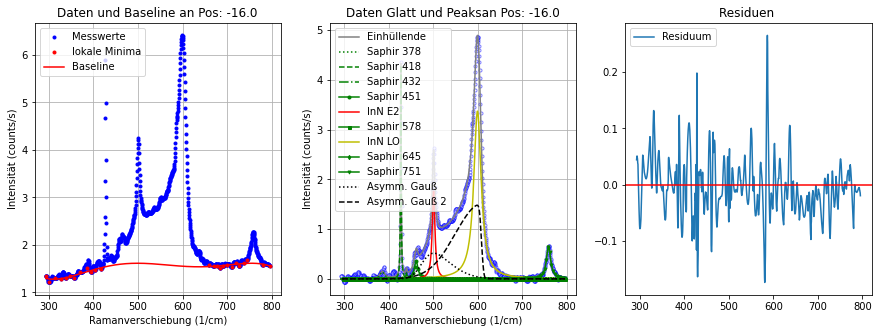

In [5]:
# Punkt/Position der messung
position = data_MEPA_D1_array_float[len(data_MEPA_D1_array_float)-1][0]
print("Position:", position) 

#daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
x=np.delete(data_MEPA_D1_array_float[0],[0])
y=np.delete(data_MEPA_D1_array_float[len(data_MEPA_D1_array_float)-1],[0])
print("x-Daten:", x)
#print(x.shape)
print("y-Daten:", y)
#print(y.shape)
        
# lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
yzw=y[argrelextrema(y, np.less,order=8)[0]]
xzw=x[argrelextrema(y, np.less,order=8)[0]]
#print(yzw)
#print(xzw)
        
#minima an problematischen stellen nicht mitnehmen
xmin=[]
ymin=[]
xmin.append(x[0])
ymin.append(y[0]) 
for j in range(len(xzw)):
    if xzw[j]<=430 or xzw[j]>=650:
        xmin.append(xzw[j])
        ymin.append(yzw[j])
xmin.append(x[len(x)-1])
ymin.append(y[len(y)-1]) 
#print(ymin)
#print(xmin)
        
# Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
print("Hintergrund Parameter: ", fitParams_base)
# Hintergrund von Messdaten entfernen --> glatt
y_glatt=y-ybase
#print(y)
#print(ybase)
#print(y_glatt)
        
#fitten 4 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 498, saphir_578, InN LO 595, saphir_645, saphir_751,
#+ 2Asymmetrischer Gauß
#L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
# 9 Lorentzpeaks + 2 Asymmetrischer gauß
#1,38,510,6, 1,18,580,2
#0,0,480,0, 0,0,0,0
#np.inf,np.inf,525,np.inf, np.inf,np.inf,585,np.inf


#1,45,470,0.03, 1,41,590,-6
#0,44,460,0, 0,40,580,-17
#np.inf,np.inf,475,np.inf, np.inf,np.inf,610,np.inf
init_vals_L_x9_AG_x2 = [1,1,378, 1,1,427, 1,1,440, 1,1,448, 1,1,498, 1,1,580, 1,1,595, 1,1,645, 1,1,751,  1,45,470,0.03, 1,41,590,-6]
param_bounds_L_x9_AG_x2= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,490, 0,0,565, 0,0,585, 0,0,635, 0,0,735, 0,44,465,0, 0,40,580,-17],
                          [np.inf,np.inf,390, np.inf,np.inf,430, np.inf,np.inf,460, np.inf,10,470, np.inf,np.inf,510, np.inf,10,590, np.inf,np.inf,610, np.inf,np.inf,655, np.inf,np.inf,760, np.inf,np.inf,475,np.inf, np.inf,np.inf,610,np.inf])
fitParams_L_x9_AG_x2, cov_L_x9_AG_x2 = curve_fit(f=L_x9_AG_x2, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x2, bounds=param_bounds_L_x9_AG_x2)
fitParams_L_Saphir_378=[fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2]]
fitParams_L_Saphir_418=[fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5]]
fitParams_L_Saphir_432=[fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8]]
fitParams_L_Saphir_451=[fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11]]
fitParams_L_InN_E2=[fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14]]
fitParams_L_Saphir_578=[fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17]]
fitParams_L_InN_LO=[fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20]]
fitParams_L_Saphir_645=[fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23]]
fitParams_L_Saphir_751=[fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26]]
fitParams_AG_1=[fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30]]
fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
print("Fitparameter InN E2:",fitParams_L_InN_E2)
print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
print("Fitparameter InN LO:",fitParams_L_InN_LO)
print("Fitparameter Saphir 645:",fitParams_L_Saphir_645)
print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
        
        
        
# plotten
fig = plt.figure(figsize=(15,5))
# Plot 1 für Daten roh und baseline
plt.subplot(1, 3, 1) 
plt.title('Daten und Baseline an Pos: '+str(position))
plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
plt.plot(x, ybase,'r', label='Baseline') 
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot für Daten glatt und peaks
plt.subplot(1, 3, 2)
plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
plt.plot(x,L_x9_AG_x2(x, fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2],fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5],fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8],fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11],fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14],fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17],fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20],fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23],fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26],fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30],fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]), color='gray'  ,markersize=2, label='Einhüllende')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_645[0],fitParams_L_Saphir_645[1],fitParams_L_Saphir_645[2]),'-d', markevery=8, color='g'  ,markersize=3, label='Saphir 645')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot Residuen Fitt
plt.subplot(1, 3, 3)
plt.title('Residuen ')
plt.plot(x,y_glatt-L_x9_AG_x2(x, fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2],fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5],fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8],fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11],fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14],fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17],fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20],fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23],fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26],fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30],fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]), label=("Residuum"))
plt.axhline(y = 0, color = 'r', linestyle = '-')
#plt.grid(True)
plt.legend(loc='upper left')

plt.savefig('Bilder_Graphen_532nm/Kalibration MEPA Amplituden Saphir Peaks nach Positionen D1 532nm')

plt.show()

In [6]:
#nutzen Peaks 418, 451, 751 da die besten ersichtlichen Peaks und am besten zu fitten
ExpWerte=[fitParams_L_Saphir_418[2],fitParams_L_Saphir_451[2],fitParams_L_Saphir_751[2]] 
Literatur=[418, 451, 751]
Abweichung=[]
print(ExpWerte)
print(Literatur)

for i in range(len(ExpWerte)):
    Abweichung.append(ExpWerte[i]-Literatur[i])

print(Abweichung)
Mittlere_Abweichung=np.mean(Abweichung)
print(Mittlere_Abweichung)

[427.06071962964745, 461.40362799159266, 758.6317796241282]
[418, 451, 751]
[9.060719629647451, 10.403627991592657, 7.631779624128171]
9.03204241512276


## Datenladen A-Plane

In [7]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "InN_a-plane L1065_Bild1_D1_2x60s.txt") as f1:
        data_aPlane_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_aPlane_array_str = np.array(data_aPlane_txt)               #in np array umwandeln um listen von listen zu entkommen
data_aPlane_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_aPlane_array_float = data_aPlane_array_str.astype(float)   #str zu float in Arrayform
print(data_aPlane_array_float)

[[ 0.0000000e+00  7.9545685e+02  7.9498438e+02 ...  2.9403482e+02
   2.9352521e+02  2.9301349e+02]
 [ 0.0000000e+00  1.4046100e+00  1.4230600e+00 ...  1.1708500e+00
   1.1773900e+00  1.1956100e+00]
 [-1.0000000e-01  1.4587800e+00  1.4613700e+00 ...  1.1816400e+00
   1.1901900e+00  1.2015000e+00]
 ...
 [-3.8000000e+00  1.2217900e+00  1.2130000e+00 ...  1.0683600e+00
   1.0756200e+00  1.0825600e+00]
 [-3.9000000e+00  1.0753900e+00  1.0773900e+00 ...  9.7143400e-01
   9.6586200e-01  9.5775300e-01]
 [-4.0000000e+00  1.0517300e+00  1.0651700e+00 ...  9.0778300e-01
   8.9254900e-01  8.9462800e-01]]


Position: -3.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [1.54258 1.68049 1.74183 ... 1.50703 1.50336 1.49982]
Hintergrund Parameter:  [-8.69165841e-13  2.39772357e-09 -2.57519892e-06  1.34005103e-03
 -3.35892506e-01  3.38704862e+01]
Fitparameter Saphir 378: [0.08967353260586859, 179.82260242714614, 394.99999999999994]
Fitparameter Saphir 418: [4.549320380049306, 1.9627729448595619, 426.929575557092]
Fitparameter Saphir 432: [0.18953209988628306, 3.3094574400191235, 440.3344324215125]
Fitparameter Saphir 451: [0.7391541409401887, 9.999999999999998, 458.577698101053]
Fitparameter InN E2: [2.781507443688716, 8.384983020224116, 500.40972822861215]
Fitparameter Saphir 578: [0.34537246839662866, 9.999999999999998, 587.3915423058523]
Fitparameter InN LO: [4.41606728053554, 13.933423444223523, 603.9690969734191]
Fitparameter Saphir 645: [0.09930772884940534, 2.2287653006939525, 652.7244347655395]
Fitparameter Saphir 751: [0.45956225785248916, 13.26822

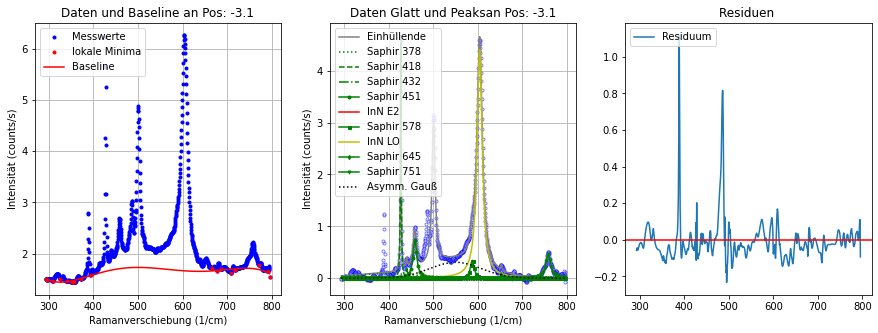

In [8]:
# Punkt/Position der messung
position = data_aPlane_array_float[len(data_aPlane_array_float)-10][0]
print("Position:", position) 

#daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
x=np.delete(data_aPlane_array_float[0],[0])
y=np.delete(data_aPlane_array_float[len(data_aPlane_array_float)-10],[0])
print("x-Daten:", x)
#print(x.shape)
print("y-Daten:", y)
#print(y.shape)
        
# lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
yzw=y[argrelextrema(y, np.less,order=8)[0]]
xzw=x[argrelextrema(y, np.less,order=8)[0]]
#print(yzw)
#print(xzw)
        
#minima an problematischen stellen nicht mitnehmen
xmin=[]
ymin=[]
xmin.append(x[0])
ymin.append(y[0]) 
for j in range(len(xzw)):
    if xzw[j]<=400 or xzw[j]>=650:
        xmin.append(xzw[j])
        ymin.append(yzw[j])
xmin.append(x[len(x)-1])
ymin.append(y[len(y)-1]) 
#print(ymin)
#print(xmin)
        
# Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
print("Hintergrund Parameter: ", fitParams_base)
# Hintergrund von Messdaten entfernen --> glatt
y_glatt=y-ybase
#print(y)
#print(ybase)
#print(y_glatt)
        
#fitten 9 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 498, saphir_578, InN LO 595, saphir_645, saphir_751,
#+ 1Asymmetrischer Gauß
#L_x9_AG_x1(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape):
# 9 Lorentzpeaks + 1 Asymmetrischer gauß
init_vals_L_x9_AG_x1 = [1,1,385, 1,1,427, 1,1,440, 1,1,448, 1,1,498, 1,1,580, 1,1,595, 1,1,650, 1,1,751, 1,60,600,0.000001]
param_bounds_L_x9_AG_x1= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,490, 0,0,565, 0,0,585, 0,0,635, 0,0,735, 0,50,550,0],
                          [np.inf,np.inf,395, np.inf,np.inf,430, np.inf,np.inf,460, np.inf,10,470, np.inf,np.inf,510, np.inf,10,590, np.inf,np.inf,610, np.inf,np.inf,655, np.inf,np.inf,760, 2,np.inf,610,np.inf])
fitParams_L_x9_AG_x1, cov_L_x9_AG_x1 = curve_fit(f=L_x9_AG_x1, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x1, bounds=param_bounds_L_x9_AG_x1)
fitParams_L_Saphir_378=[fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2]]
fitParams_L_Saphir_418=[fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5]]
fitParams_L_Saphir_432=[fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8]]
fitParams_L_Saphir_451=[fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11]]
fitParams_L_InN_E2=[fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14]]
fitParams_L_Saphir_578=[fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17]]
fitParams_L_InN_LO=[fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20]]
fitParams_L_Saphir_645=[fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23]]
fitParams_L_Saphir_751=[fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26]]
fitParams_AG_1=[fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]]
#fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
print("Fitparameter InN E2:",fitParams_L_InN_E2)
print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
print("Fitparameter InN LO:",fitParams_L_InN_LO)
print("Fitparameter Saphir 645:",fitParams_L_Saphir_645)
print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
#print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
        
        
        
# plotten
fig = plt.figure(figsize=(15,5))
# Plot 1 für Daten roh und baseline
plt.subplot(1, 3, 1) 
plt.title('Daten und Baseline an Pos: '+str(position))
plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
plt.plot(x, ybase,'r', label='Baseline') 
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot für Daten glatt und peaks
plt.subplot(1, 3, 2)
plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
plt.plot(x,L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), color='gray'  ,markersize=2, label='Einhüllende')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[0],fitParams_L_InN_E2[0]), color='r'  ,markersize=3, label='InN E2')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_645[0],fitParams_L_Saphir_645[1],fitParams_L_Saphir_645[2]),'-d', markevery=8, color='g'  ,markersize=3, label='Saphir 645')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
#plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot Residuen Fitt
plt.subplot(1, 3, 3)
plt.title('Residuen ')
plt.plot(x,y_glatt-L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), label=("Residuum"))
plt.axhline(y = 0, color = 'r', linestyle = '-')
#plt.grid(True)
plt.legend(loc='upper left')
plt.savefig('Bilder_Graphen_532nm/Kalibration A-Plane Amplituden Saphir Peaks nach Positionen D1 532nm')

plt.show()

In [9]:
#nutzen Peaks 418, 451, 751 da die besten ersichtlichen Peaks und am besten zu fitten
ExpWerte=[fitParams_L_Saphir_418[2],fitParams_L_Saphir_751[2]] 
Literatur=[418, 751]
Abweichung=[]
print(ExpWerte)
print(Literatur)

for i in range(len(ExpWerte)):
    Abweichung.append(ExpWerte[i]-Literatur[i])

print(Abweichung)
Mittlere_Abweichung=np.mean(Abweichung)
print(Mittlere_Abweichung)

[426.929575557092, 757.8739957219269]
[418, 751]
[8.929575557091994, 6.873995721926917]
7.9017856395094555


Im Endeffekt hier die Abweichung der A-Plane nehmen da am selben Tag auch MBE gemessen wurde, also alle Ramanfrequenzen minus rund 8 nehmen

In [10]:
Verschiebung_A_plane=7.9017856395094555
Verschiebung_MEPA=9.03204241512276

# MEPA Messung mit Filter D1

Probenoberfläche vor Messung
<img src="Daten/MEPA_InN_Oberfläche_2a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten/MEPA_InN_Oberfläche_2b.jpg" style="width:300px;"/>

## Datenladen MEPA D1

In [11]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "InN MEPA 1242_Bild2_D1_2x60s.txt") as f1:
        data_MEPA_D1_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MEPA_D1_array_str = np.array(data_MEPA_D1_txt)       #in np array umwandeln um listen von listen zu entkommen
data_MEPA_D1_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MEPA_D1_array_float = data_MEPA_D1_array_str.astype(float)   #str zu float in Arrayform
print(data_MEPA_D1_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_MEPA_D1_array_float[0])):
    data_MEPA_D1_array_float[0][k]=data_MEPA_D1_array_float[0][k]-Verschiebung_MEPA
print(data_MEPA_D1_array_float)

neue_null=-13.3
S=3.08
for l in range(len(data_MEPA_D1_array_float)):
    data_MEPA_D1_array_float[l][0]=data_MEPA_D1_array_float[l][0] - neue_null
    if data_MEPA_D1_array_float[l][0] <= 0:
        data_MEPA_D1_array_float[l][0]=data_MEPA_D1_array_float[l][0] * S

[[  0.       795.45685  794.98438  ... 294.03482  293.52521  293.01349 ]
 [-11.         1.13511    1.15515  ...   0.992049   0.984881   0.977452]
 [-11.1        1.27837    1.26889  ...   1.01723    1.02798    1.05248 ]
 ...
 [-15.8        1.79204    1.79065  ...   1.38039    1.37152    1.36162 ]
 [-15.9        1.72407    1.66402  ...   1.28593    1.28897    1.27572 ]
 [-16.         1.56294    1.57021  ...   1.34938    1.3477     1.34465 ]]
[[ -9.03204242 786.42480758 785.95233758 ... 285.00277758 284.49316758
  283.98144758]
 [-11.           1.13511      1.15515    ...   0.992049     0.984881
    0.977452  ]
 [-11.1          1.27837      1.26889    ...   1.01723      1.02798
    1.05248   ]
 ...
 [-15.8          1.79204      1.79065    ...   1.38039      1.37152
    1.36162   ]
 [-15.9          1.72407      1.66402    ...   1.28593      1.28897
    1.27572   ]
 [-16.           1.56294      1.57021    ...   1.34938      1.3477
    1.34465   ]]


## Fitten und Plotten MEPA D1

Position: 2.3000000000000007
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.13511  1.15515  1.15823  ... 0.992049 0.984881 0.977452]
Hintergrund Parameter:  [-4.64951381e-13  1.29409434e-09 -1.39572232e-06  7.24263000e-04
 -1.79218694e-01  1.78677360e+01]
Fitparameter Saphir 418: [0.45333243542644064, 2.04694109199805, 417.678316563222]
Fitparameter Saphir 451: [0.2606585398785609, 7.3777398796846185, 450.39964256560194]
Fitparameter InN E2: [1.2428945303059646, 6.18655559248012, 491.4045245946705]
Fitparameter InN LO: [2.3691409938033465, 17.90471631698333, 589.9620608792613]
Fitparameter Saphir 751: [0.0720203611340278, 14.246327544515811, 749.5615009139316]
Fitparameter Asymmetrischer Gauß 1:  [0.2719114522651255, 54.83471067493614, 468.1312300897815, 5.169793066454886]
Fitparameter Asymmetrischer Gauß 2:  [0.5257219817335474, 47.79344553698684, 599.6352858077712, -11.721813928827624]


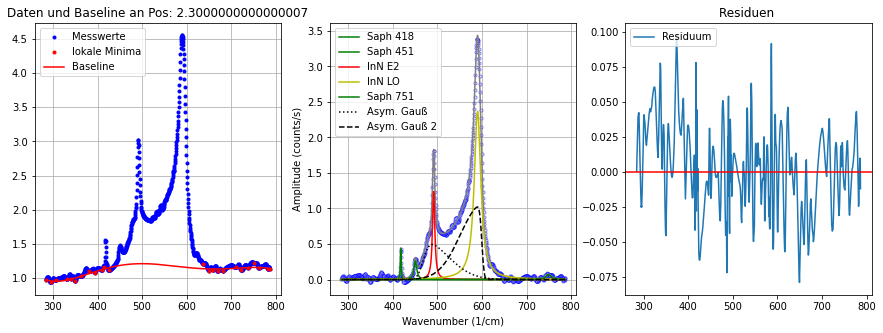

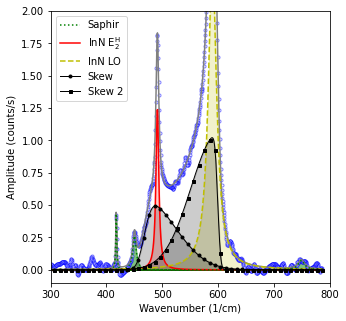

----------------------------------------------------------------------------------------------------
Position: 2.200000000000001
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.27837 1.26889 1.26262 ... 1.01723 1.02798 1.05248]
Hintergrund Parameter:  [-9.21757551e-14  3.37998227e-10 -4.44892833e-07  2.66241797e-04
 -7.22018959e-02  8.21353092e+00]
Fitparameter Saphir 418: [0.4302878171186372, 2.3377347118915606, 417.9918931936442]
Fitparameter Saphir 451: [0.00868440968328326, 171.1785147553925, 440.00000000000006]
Fitparameter InN E2: [1.4295205399448077, 6.577967009617611, 491.25981126045156]
Fitparameter InN LO: [2.3611705867491675, 17.997988823138563, 590.0816645323108]
Fitparameter Saphir 751: [0.14282273880914748, 10.191771130158765, 749.0085951042873]
Fitparameter Asymmetrischer Gauß 1:  [0.28891228070545466, 49.00000000000018, 467.82051309006135, 2.2606067930607594]
Fitparameter Asymmetrischer Gauß 2:  [0.56936003870346

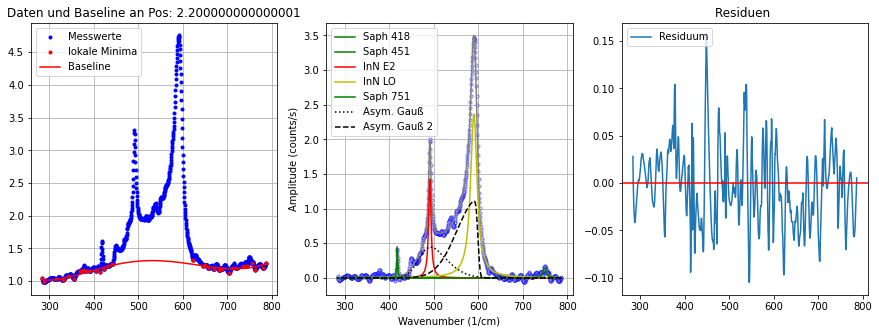

BILD an Pos:  2.200000000000001


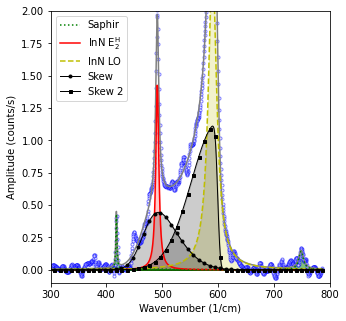

----------------------------------------------------------------------------------------------------
Position: 2.1000000000000014
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.25219  1.28695  1.30149  ... 1.12844  1.10992  0.986906]
Hintergrund Parameter:  [-9.48280267e-14  3.21883291e-10 -4.01093685e-07  2.28349652e-04
 -5.82784822e-02  6.42562917e+00]
Fitparameter Saphir 418: [0.3040973152961086, 3.9247937244565096, 417.67370326148205]
Fitparameter Saphir 451: [0.24350999332974926, 7.5966402065235155, 449.99660383006955]
Fitparameter InN E2: [1.4347958146924595, 6.3672979264645475, 491.22576317505803]
Fitparameter InN LO: [2.4991551891872743, 17.645995102570406, 589.5941065373053]
Fitparameter Saphir 751: [0.13592177293306298, 14.323868637986044, 748.1443825779719]
Fitparameter Asymmetrischer Gauß 1:  [0.3647027182892333, 49.00000000000001, 471.99999999999994, 2.6075120679214154]
Fitparameter Asymmetrischer Gauß 2:  [0.64101

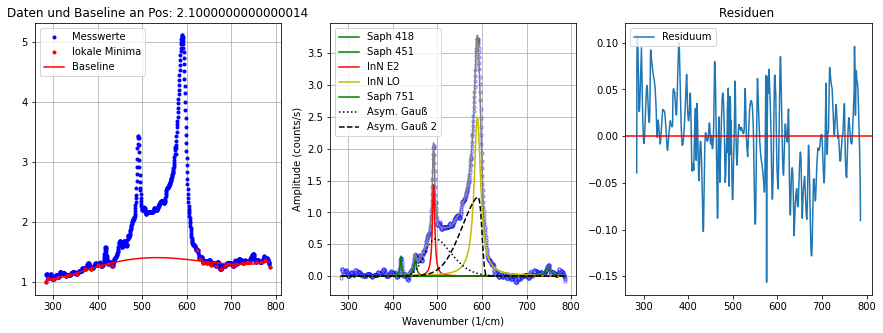

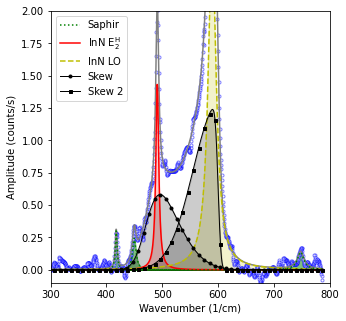

----------------------------------------------------------------------------------------------------
Position: 2.0
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.27283  1.28449  1.29699  ... 0.997362 0.997368 0.991042]
Hintergrund Parameter:  [-3.14285480e-13  9.06416180e-10 -1.00897196e-06  5.35489644e-04
 -1.33223662e-01  1.34639818e+01]
Fitparameter Saphir 418: [0.47332067378688936, 3.269988993273366, 418.0330520416825]
Fitparameter Saphir 451: [0.21555045859094082, 7.045140828578289, 449.5906636382305]
Fitparameter InN E2: [1.641180316308358, 5.9096929322995075, 491.3790001228191]
Fitparameter InN LO: [2.7131105833376523, 17.17119516375778, 589.534816769436]
Fitparameter Saphir 751: [0.15465180223104957, 11.257108384986728, 753.3942115925537]
Fitparameter Asymmetrischer Gauß 1:  [0.3320259995069822, 49.00000000000001, 471.1576491310821, 3.258728547006302]
Fitparameter Asymmetrischer Gauß 2:  [0.6646270744673181, 47.17925754

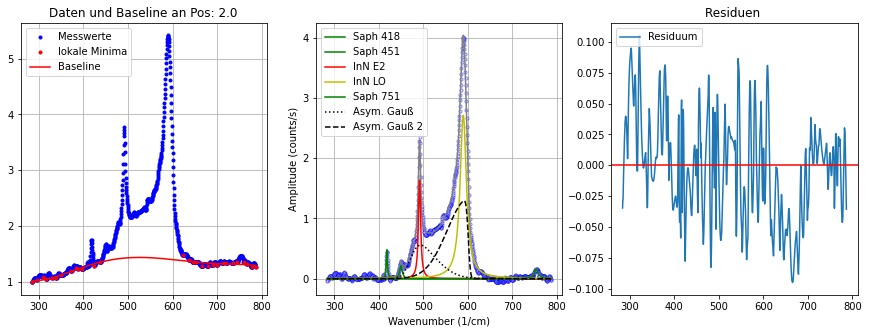

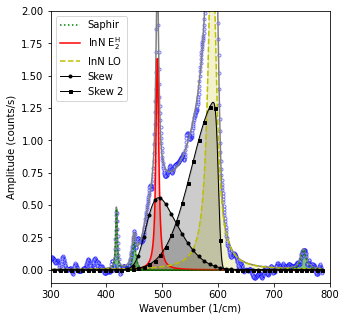

----------------------------------------------------------------------------------------------------
Position: 1.9000000000000004
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.39654 1.39775 1.39909 ... 1.18382 1.2053  1.22872]
Hintergrund Parameter:  [-6.28223923e-13  1.81011629e-09 -2.02197107e-06  1.08670247e-03
 -2.78379167e-01  2.82895226e+01]
Fitparameter Saphir 418: [0.38094487248540865, 2.635900630624899, 417.9041268352681]
Fitparameter Saphir 451: [0.2666896463219557, 8.00695687915621, 449.6140965645241]
Fitparameter InN E2: [1.65539250863143, 5.831334505778785, 491.29092271131157]
Fitparameter InN LO: [3.0242731228166826, 16.812138950560986, 589.3675159547355]
Fitparameter Saphir 751: [0.14914351193753453, 11.20216868924633, 749.8360555641342]
Fitparameter Asymmetrischer Gauß 1:  [0.3486477319728568, 49.00000000000006, 470.7038871184116, 3.4451425501849173]
Fitparameter Asymmetrischer Gauß 2:  [0.7082952770222317, 48.

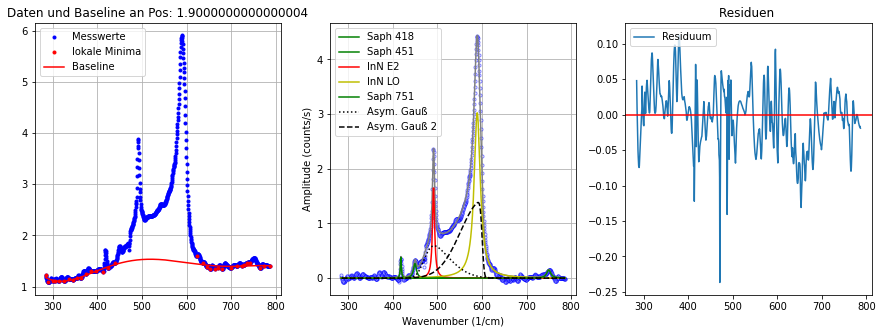

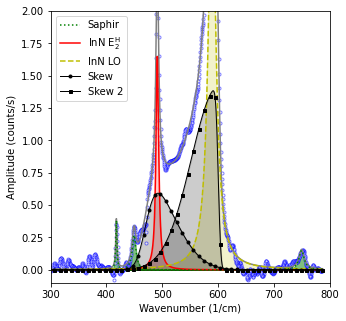

----------------------------------------------------------------------------------------------------
Position: 1.8000000000000007
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.40909 1.42403 1.43958 ... 1.13685 1.1201  1.09983]
Hintergrund Parameter:  [-2.73849023e-13  8.37948445e-10 -9.82430938e-07  5.46034699e-04
 -1.41698311e-01  1.48926881e+01]
Fitparameter Saphir 418: [0.4491866861297002, 2.9941231509860495, 417.7250125802057]
Fitparameter Saphir 451: [0.2981251545878282, 7.277649287344568, 450.0855200044046]
Fitparameter InN E2: [1.794988774715104, 6.240018596338563, 491.2437686577722]
Fitparameter InN LO: [3.368959634413309, 17.177978607805905, 589.6804985702107]
Fitparameter Saphir 751: [0.24151573000468238, 9.448584029809505, 751.8212186428723]
Fitparameter Asymmetrischer Gauß 1:  [0.33006938558604876, 50.74512832978695, 469.1443643958938, 4.359743550697603]
Fitparameter Asymmetrischer Gauß 2:  [0.727424712770308, 51.9

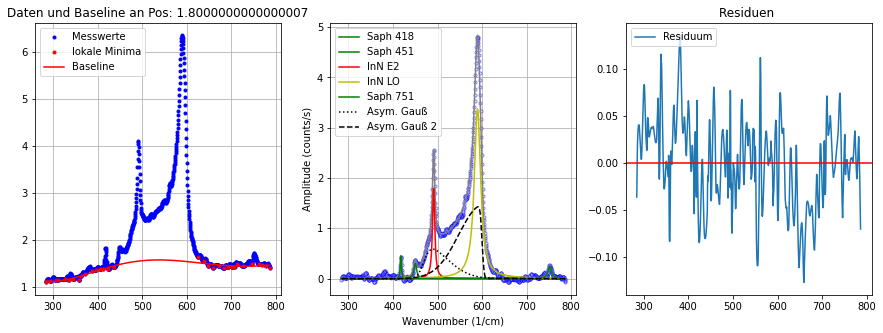

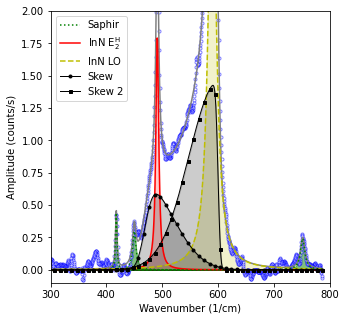

----------------------------------------------------------------------------------------------------
Position: 1.700000000000001
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.6671  1.66905 1.66452 ... 1.26535 1.24098 1.22108]
Hintergrund Parameter:  [-4.00571025e-13  1.17925660e-09 -1.33556721e-06  7.21154199e-04
 -1.83245596e-01  1.87696258e+01]
Fitparameter Saphir 418: [0.41686862682889697, 2.7548782250677704, 417.85802697610495]
Fitparameter Saphir 451: [0.2889821419894511, 8.762865666808654, 449.93602829265495]
Fitparameter InN E2: [1.979574332024933, 6.273514965168169, 491.2461231576171]
Fitparameter InN LO: [3.549829092871259, 16.82368800945946, 589.991445997149]
Fitparameter Saphir 751: [0.11745505163734994, 11.293379082515127, 748.5867508752324]
Fitparameter Asymmetrischer Gauß 1:  [0.41144368672382936, 49.00000000000001, 470.8831890030939, 3.4008187988407115]
Fitparameter Asymmetrischer Gauß 2:  [0.8070578469873052, 4

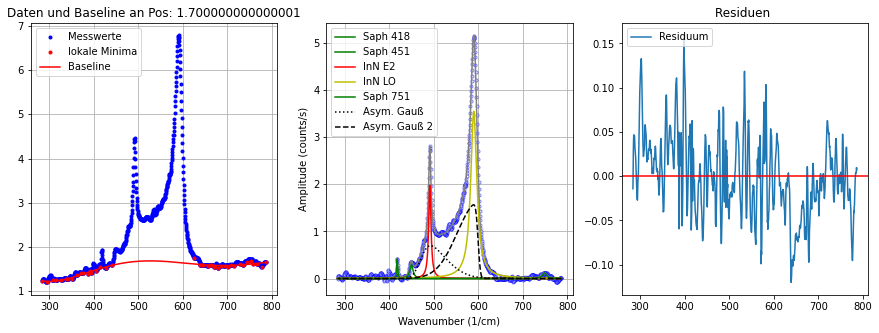

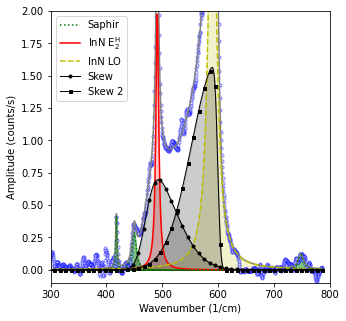

----------------------------------------------------------------------------------------------------
Position: 1.6000000000000014
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.61036 1.60529 1.6025  ... 1.17986 1.17255 1.18891]
Hintergrund Parameter:  [-2.93049938e-13  8.59064536e-10 -9.69281032e-07  5.19514799e-04
 -1.29662240e-01  1.32815287e+01]
Fitparameter Saphir 418: [0.5231638500532605, 2.168435402153111, 417.8606112225385]
Fitparameter Saphir 451: [0.2975785511609388, 9.428007728765992, 450.4162676056409]
Fitparameter InN E2: [2.22107457263434, 5.789962196692667, 491.07269228417226]
Fitparameter InN LO: [3.817957611100479, 17.369152060728325, 589.3441800639903]
Fitparameter Saphir 751: [0.1334289600419513, 11.157950401207778, 748.355866799558]
Fitparameter Asymmetrischer Gauß 1:  [0.4607742319590133, 49.00000000000001, 470.35841143604955, 3.2379202828649425]
Fitparameter Asymmetrischer Gauß 2:  [0.8317759511920875, 48.5

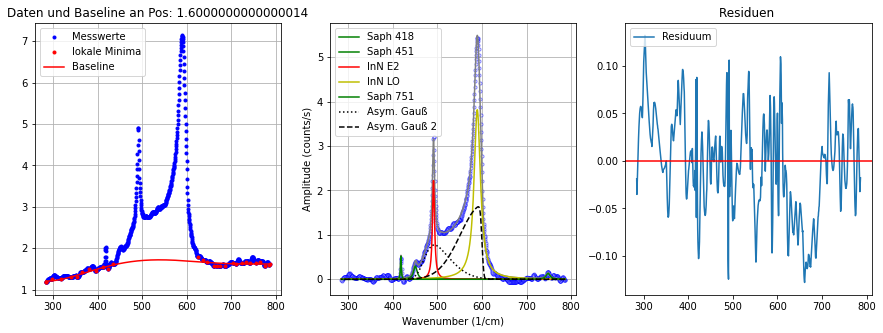

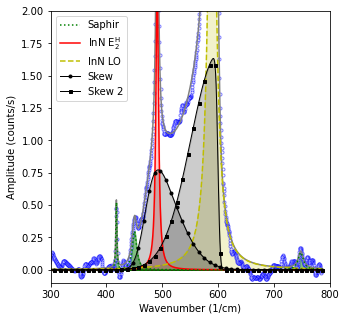

----------------------------------------------------------------------------------------------------
Position: 1.5
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.69    1.68518 1.68286 ... 1.30461 1.32249 1.34571]
Hintergrund Parameter:  [-4.16186597e-13  1.20806897e-09 -1.35221155e-06  7.20834736e-04
 -1.79840877e-01  1.81331714e+01]
Fitparameter Saphir 418: [0.43756181685898804, 2.0772536806910664, 418.0337659853447]
Fitparameter Saphir 451: [0.3324571061375317, 8.969452587053295, 450.2675005929374]
Fitparameter InN E2: [2.1535194075690494, 6.531007898608514, 491.1542029673588]
Fitparameter InN LO: [4.0957687300473395, 17.252138984728848, 589.3648223003868]
Fitparameter Saphir 751: [0.23427830003582711, 11.999009162418739, 749.4742985223221]
Fitparameter Asymmetrischer Gauß 1:  [0.4553761654806453, 49.00000000000001, 470.3896673103047, 3.9157382904247777]
Fitparameter Asymmetrischer Gauß 2:  [0.9500769007481511, 48.85601709949

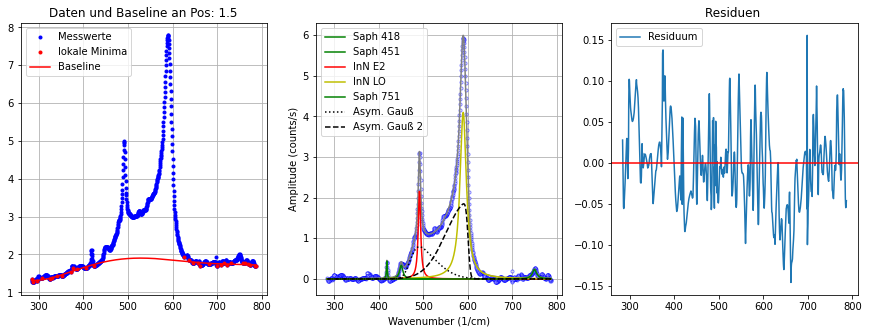

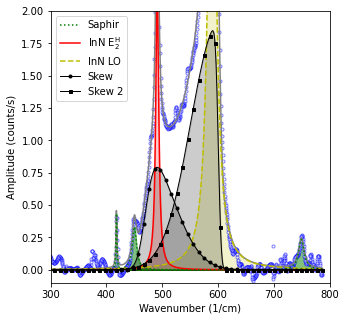

----------------------------------------------------------------------------------------------------
Position: 1.4000000000000004
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.88795 1.89643 1.90397 ... 1.4187  1.41105 1.40137]
Hintergrund Parameter:  [-3.47107515e-13  1.08279752e-09 -1.28755545e-06  7.22314499e-04
 -1.88226130e-01  1.97280885e+01]
Fitparameter Saphir 418: [0.7010065319906094, 2.1706762341876096, 417.7649882437673]
Fitparameter Saphir 451: [0.393552438473144, 6.983111359313245, 449.28299578045545]
Fitparameter InN E2: [2.5286350536850866, 6.064863070853065, 490.9854255591945]
Fitparameter InN LO: [4.604180322286302, 17.813734279015282, 589.5541243521085]
Fitparameter Saphir 751: [0.19716498917816455, 10.840393075508878, 749.5557152690953]
Fitparameter Asymmetrischer Gauß 1:  [0.5654696505291376, 49.00000000000001, 469.31097234788376, 3.099167266139668]
Fitparameter Asymmetrischer Gauß 2:  [1.0392607097515347, 4

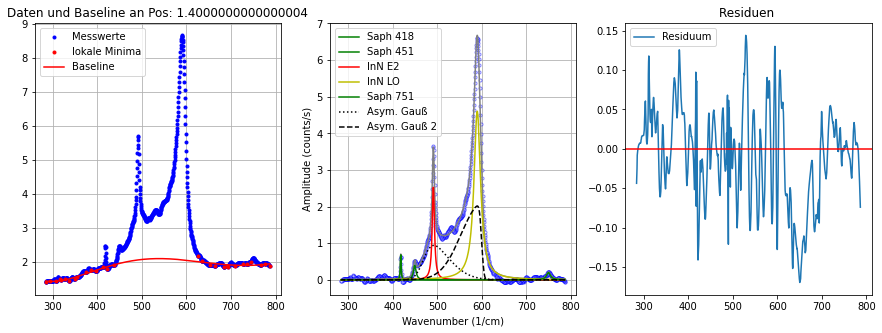

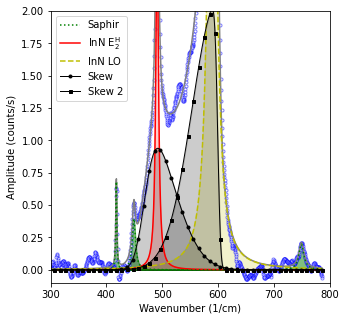

----------------------------------------------------------------------------------------------------
Position: 1.3000000000000007
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.08492 2.09717 2.11261 ... 1.58226 1.56757 1.55297]
Hintergrund Parameter:  [-6.90937799e-13  1.92154357e-09 -2.06773194e-06  1.06692166e-03
 -2.60431988e-01  2.56206785e+01]
Fitparameter Saphir 418: [0.5510124061430323, 2.0757073121227303, 418.04287857262375]
Fitparameter Saphir 451: [0.5143861365209988, 11.341873036350202, 449.57049153989936]
Fitparameter InN E2: [2.9146273474919693, 6.09939294257734, 491.15931872112594]
Fitparameter InN LO: [5.347387445019546, 17.54960551944682, 590.0040093867453]
Fitparameter Saphir 751: [0.1608714559075594, 9.652359004055366, 749.3154484253621]
Fitparameter Asymmetrischer Gauß 1:  [0.6108308158165109, 53.138156970818784, 469.37880575138445, 4.854129037573676]
Fitparameter Asymmetrischer Gauß 2:  [1.1687865535420812, 

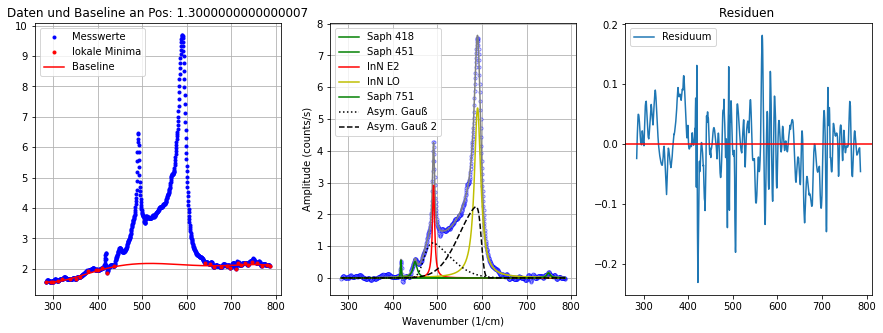

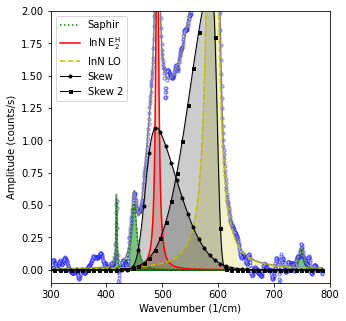

----------------------------------------------------------------------------------------------------
Position: 1.200000000000001
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.33416 2.34647 2.35866 ... 1.70185 1.64583 1.57753]
Hintergrund Parameter:  [-5.57058297e-13  1.54526850e-09 -1.65498042e-06  8.44220281e-04
 -2.00684785e-01  1.94658308e+01]
Fitparameter Saphir 418: [0.7973935595035689, 2.190364403112628, 417.9043186392128]
Fitparameter Saphir 451: [0.5692781069016671, 9.958708247178242, 449.8633426556545]
Fitparameter InN E2: [3.1116715256681395, 5.803598320727541, 491.0177043906031]
Fitparameter InN LO: [5.98154301742276, 17.661050839204872, 589.700582681094]
Fitparameter Saphir 751: [0.19443349423329356, 12.614744252005437, 751.4503216687242]
Fitparameter Asymmetrischer Gauß 1:  [0.7663010369363932, 49.00000000000001, 470.58384420674287, 3.968077748139144]
Fitparameter Asymmetrischer Gauß 2:  [1.293797705377257, 47.386

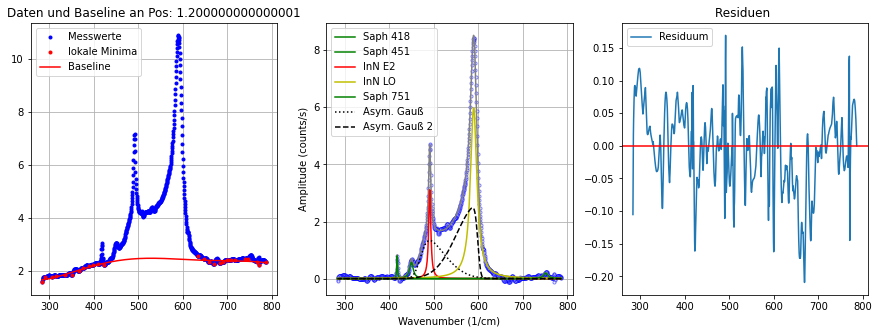

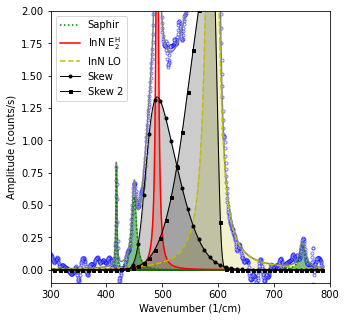

----------------------------------------------------------------------------------------------------
Position: 1.1000000000000014
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.56221 2.52106 2.48617 ... 1.75393 1.76183 1.77709]
Hintergrund Parameter:  [-6.12922975e-13  1.84394383e-09 -2.12892615e-06  1.16640771e-03
 -2.98462799e-01  3.03830204e+01]
Fitparameter Saphir 418: [1.0033378555211185, 2.1330595087130964, 417.8184052504687]
Fitparameter Saphir 451: [0.565382693619856, 6.031380796806094, 449.2766892631597]
Fitparameter InN E2: [3.575883933330387, 5.903034521848692, 491.03851173775627]
Fitparameter InN LO: [6.207947429581653, 17.964285513495216, 589.3242467131796]
Fitparameter Saphir 751: [0.22362082804535768, 15.105907837767115, 750.9364636741607]
Fitparameter Asymmetrischer Gauß 1:  [0.8530958467032727, 49.00000000000001, 470.96265011426027, 3.4575978524910145]
Fitparameter Asymmetrischer Gauß 2:  [1.4763953939223267, 4

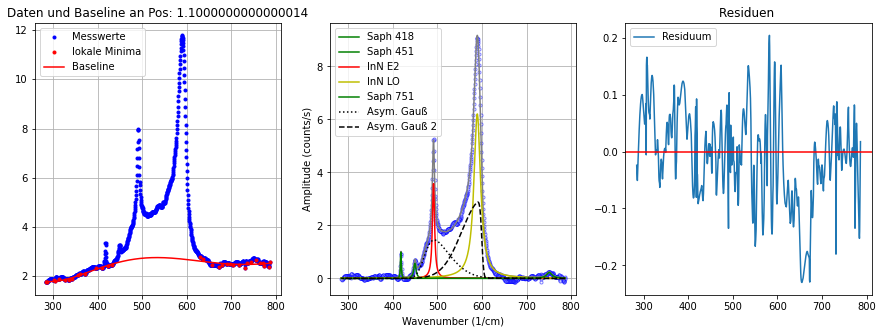

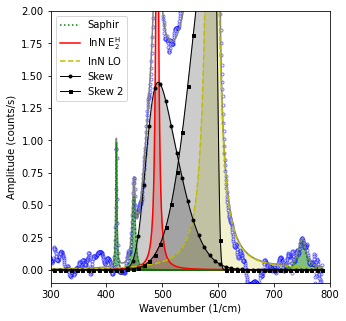

----------------------------------------------------------------------------------------------------
Position: 1.0
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.88463 2.88954 2.89462 ... 2.05157 2.05158 2.05068]
Hintergrund Parameter:  [-4.65545731e-13  1.47234404e-09 -1.76061198e-06  9.85035399e-04
 -2.53486019e-01  2.62197833e+01]
Fitparameter Saphir 418: [0.6910397970322559, 2.469603622370843, 417.76916598661495]
Fitparameter Saphir 451: [0.5907338449350925, 8.350394629978542, 449.3796746366109]
Fitparameter InN E2: [3.820511658386985, 6.367254882105286, 490.882661212032]
Fitparameter InN LO: [6.946259414727489, 17.87970815894426, 589.238003816051]
Fitparameter Saphir 751: [0.2518189698683198, 17.303050942997285, 748.6894834011804]
Fitparameter Asymmetrischer Gauß 1:  [0.8089375749456671, 49.00000000000001, 470.99703399572337, 3.811246790965168]
Fitparameter Asymmetrischer Gauß 2:  [1.5320423607987759, 48.57635175555572, 59

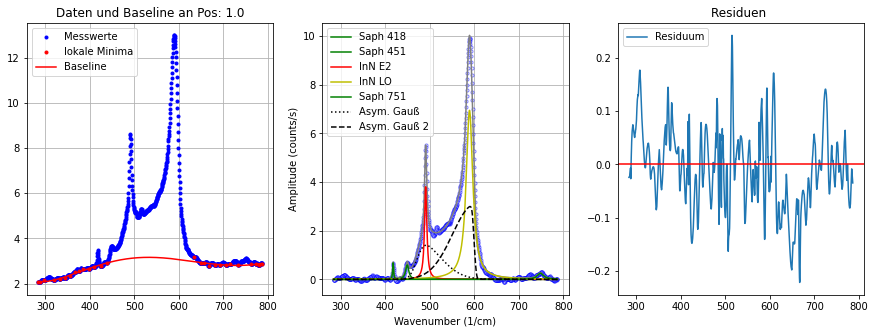

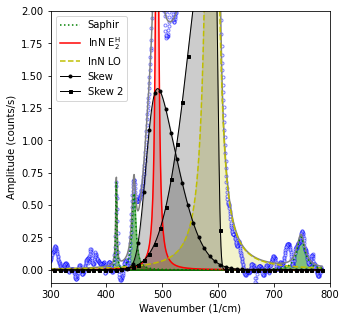

----------------------------------------------------------------------------------------------------
Position: 0.9000000000000004
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [3.19141 3.1836  3.17587 ... 2.31132 2.30995 2.33859]
Hintergrund Parameter:  [-1.12461660e-12  3.26848537e-09 -3.66697531e-06  1.96635067e-03
 -4.97243146e-01  4.97737473e+01]
Fitparameter Saphir 418: [0.6917101433653978, 2.0224643262440067, 417.64907435924175]
Fitparameter Saphir 451: [0.627135749078992, 7.705725703372547, 450.0274120825539]
Fitparameter InN E2: [4.3050859862492405, 6.052580062497853, 490.91708182570704]
Fitparameter InN LO: [7.604935967806451, 17.308183343178992, 589.1060950753774]
Fitparameter Saphir 751: [0.18482037901985438, 8.92790603714398, 746.2978856786012]
Fitparameter Asymmetrischer Gauß 1:  [0.9095916787761175, 49.00000000000001, 470.2069094420113, 3.850435835041773]
Fitparameter Asymmetrischer Gauß 2:  [1.7989981341118066, 47.

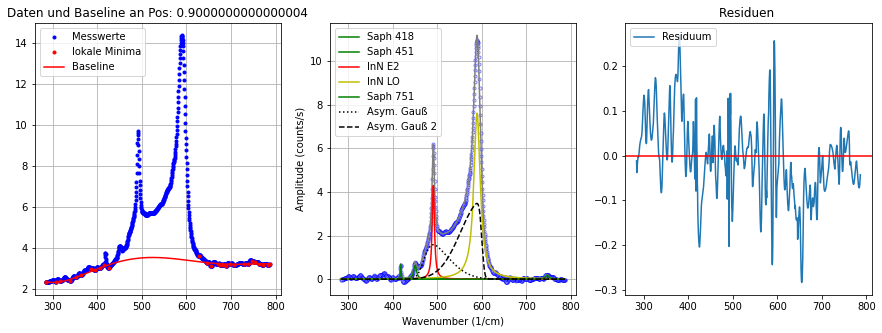

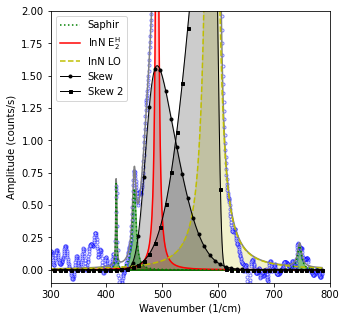

----------------------------------------------------------------------------------------------------
Position: 0.8000000000000007
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [3.55782 3.54776 3.53127 ... 2.62643 2.64111 2.67223]
Hintergrund Parameter:  [-1.45903888e-12  4.07918709e-09 -4.40973317e-06  2.28416226e-03
 -5.59898397e-01  5.45914818e+01]
Fitparameter Saphir 418: [0.9126125372148345, 1.9702667889133991, 417.8000940198851]
Fitparameter Saphir 451: [0.8177035666504183, 9.006452980052426, 449.3891059973668]
Fitparameter InN E2: [5.015565961226618, 6.02618156231183, 490.7660677934565]
Fitparameter InN LO: [8.614664612661896, 18.56981987567888, 589.0659133941128]
Fitparameter Saphir 751: [0.13827947050759323, 10.409385845206216, 746.4647589472834]
Fitparameter Asymmetrischer Gauß 1:  [1.1664667804549171, 50.89823030987415, 470.65669586427913, 4.027299629761535]
Fitparameter Asymmetrischer Gauß 2:  [2.0628966372983437, 44.8

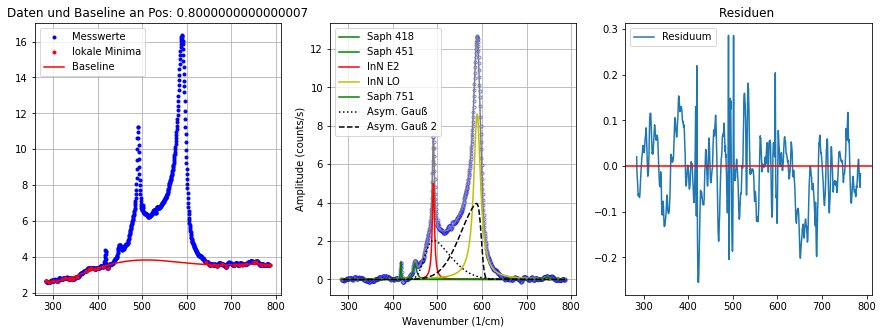

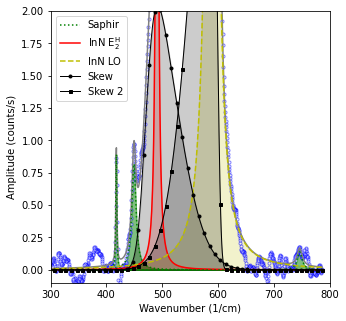

----------------------------------------------------------------------------------------------------
Position: 0.7000000000000011
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.05958 4.03387 3.98466 ... 2.94338 2.95928 2.97102]
Hintergrund Parameter:  [-9.38887187e-13  2.86586350e-09 -3.35420827e-06  1.86226735e-03
 -4.83163016e-01  4.99143954e+01]
Fitparameter Saphir 418: [0.9885800387566722, 2.2706358306697765, 417.74499419835695]
Fitparameter Saphir 451: [0.7668764844489689, 7.513401771188069, 449.5584938192778]
Fitparameter InN E2: [5.2837417699395814, 6.419405715239827, 490.55986139465574]
Fitparameter InN LO: [9.278908378574577, 17.224488811698137, 588.9389998215516]
Fitparameter Saphir 751: [0.26098877564403666, 10.959628349449085, 749.659153134392]
Fitparameter Asymmetrischer Gauß 1:  [1.2760252262680933, 49.00000000000001, 470.7267619578636, 3.323872580268998]
Fitparameter Asymmetrischer Gauß 2:  [2.3774071972063116, 4

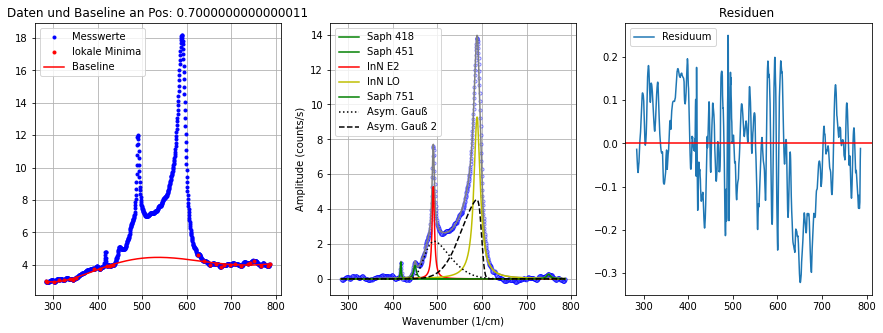

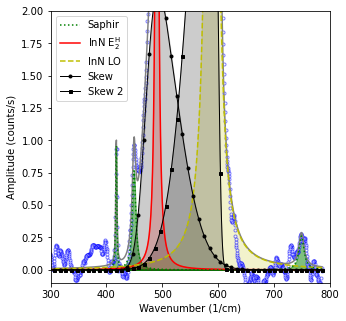

----------------------------------------------------------------------------------------------------
Position: 0.6000000000000014
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.40605 4.39715 4.39276 ... 3.0882  3.04005 2.99865]
Hintergrund Parameter:  [-1.47342967e-12  4.18336232e-09 -4.58469102e-06  2.40085294e-03
 -5.92188393e-01  5.81757993e+01]
Fitparameter Saphir 418: [0.8624998936292113, 2.1138571557854595, 417.9268220478339]
Fitparameter Saphir 451: [1.0516143271559257, 9.628312199886494, 449.63243487416435]
Fitparameter InN E2: [6.179672658064303, 6.026199540583172, 490.60509112102886]
Fitparameter InN LO: [10.57643315348679, 18.73901180968108, 588.6906584116421]
Fitparameter Saphir 751: [0.2113876414598479, 6.946183666480848, 752.2187322035345]
Fitparameter Asymmetrischer Gauß 1:  [1.2831695962297713, 49.738784662596885, 469.3753570682908, 4.471603608331654]
Fitparameter Asymmetrischer Gauß 2:  [2.2776500565149798, 49.

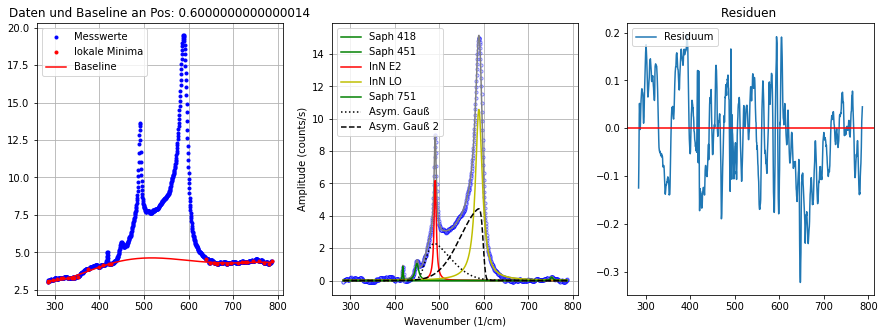

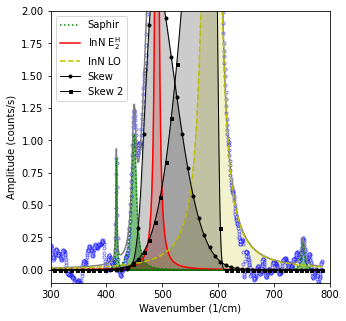

----------------------------------------------------------------------------------------------------
Position: 0.5
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.47051 4.36212 4.28828 ... 3.04801 3.02891 3.02256]
Hintergrund Parameter:  [-1.97587561e-12  5.51862298e-09 -5.95941766e-06  3.08388335e-03
 -7.55486110e-01  7.31719050e+01]
Fitparameter Saphir 418: [0.9825879575837798, 2.057440093271796, 418.0071311606634]
Fitparameter Saphir 451: [1.0084062098522513, 7.731457942738624, 449.13710577044964]
Fitparameter InN E2: [6.009197601459161, 6.716940386231691, 490.66634428998947]
Fitparameter InN LO: [11.154719429555465, 19.023296028938113, 588.7684883247744]
Fitparameter Saphir 751: [0.2883145884411701, 5.85288532119638, 749.7145281906731]
Fitparameter Asymmetrischer Gauß 1:  [1.2950792061170195, 51.70701707600131, 468.52000290392584, 4.046924533061977]
Fitparameter Asymmetrischer Gauß 2:  [2.3644204611264485, 50.70845327532514,

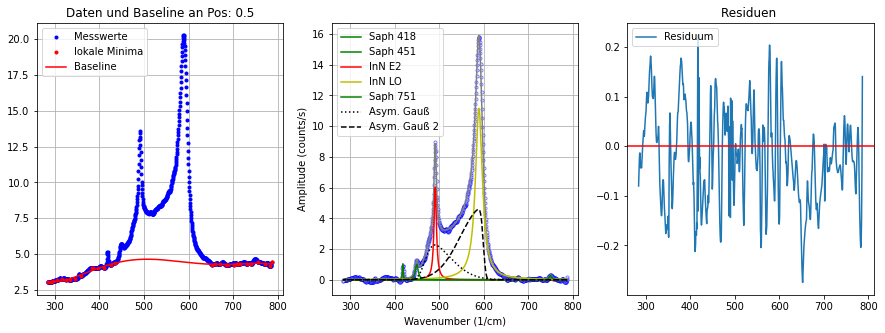

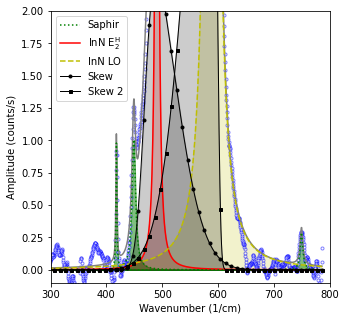

----------------------------------------------------------------------------------------------------
Position: 0.40000000000000036
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.46747 4.49959 4.51009 ... 3.30272 3.31275 3.33514]
Hintergrund Parameter:  [-2.22497838e-12  6.10718667e-09 -6.49422682e-06  3.31775641e-03
 -8.04840378e-01  7.74824136e+01]
Fitparameter Saphir 418: [1.2431122778494765, 1.6507450058328186, 418.0549818870046]
Fitparameter Saphir 451: [1.139839100540249, 8.653799461918826, 449.5971501944875]
Fitparameter InN E2: [6.528903144469479, 6.867328352605739, 490.55700064243064]
Fitparameter InN LO: [11.754144033551045, 19.201053943937147, 588.6045993488185]
Fitparameter Saphir 751: [0.2587866850631531, 9.817699123894277, 748.6224018827749]
Fitparameter Asymmetrischer Gauß 1:  [1.3144678835007022, 55.34500510182805, 467.99750570437584, 5.465705926306167]
Fitparameter Asymmetrischer Gauß 2:  [2.425883466918682, 50.

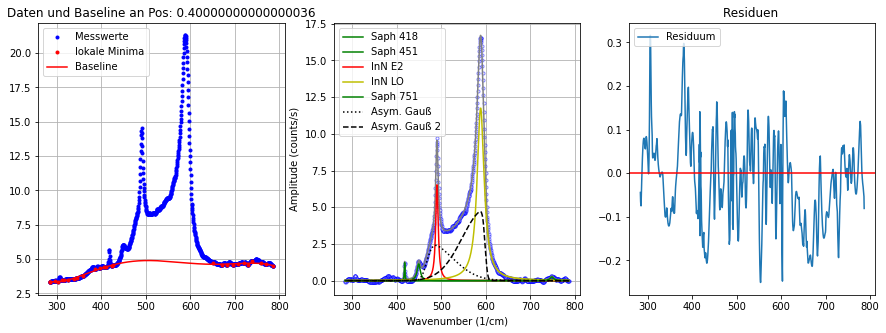

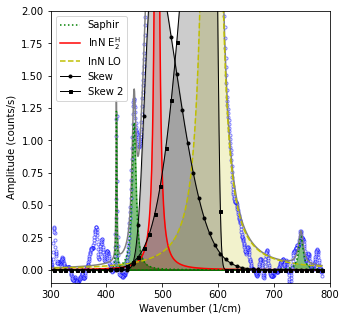

----------------------------------------------------------------------------------------------------
Position: 0.3000000000000007
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.18374 5.14647 5.13143 ... 3.73003 3.72699 3.72312]
Hintergrund Parameter:  [-1.31904384e-12  3.88804143e-09 -4.40295687e-06  2.36800021e-03
 -5.95018981e-01  5.97119729e+01]
Fitparameter Saphir 418: [1.2136883094920543, 1.75592766978646, 417.85802011578124]
Fitparameter Saphir 451: [1.1735967334953885, 10.162543003136971, 449.59303381766375]
Fitparameter InN E2: [7.340791168090048, 6.513787489817364, 490.5888169023571]
Fitparameter InN LO: [12.416253329027848, 18.514361167756743, 588.2252383648366]
Fitparameter Saphir 751: [0.35358546249687794, 14.888214884805587, 749.914651058382]
Fitparameter Asymmetrischer Gauß 1:  [1.4510968229130061, 49.17393114550227, 469.27140862748297, 4.368710461169857]
Fitparameter Asymmetrischer Gauß 2:  [2.8688636728405337, 4

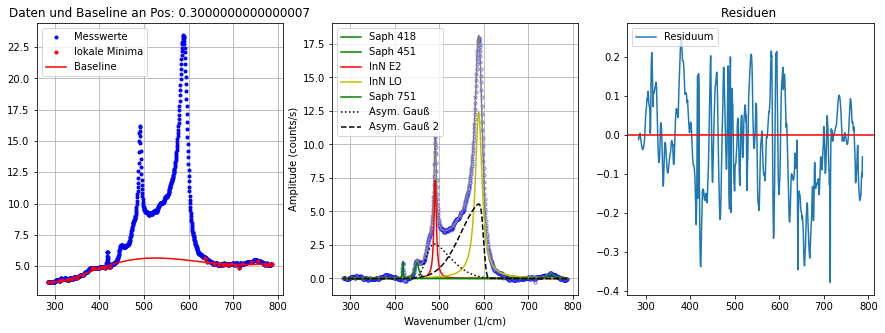

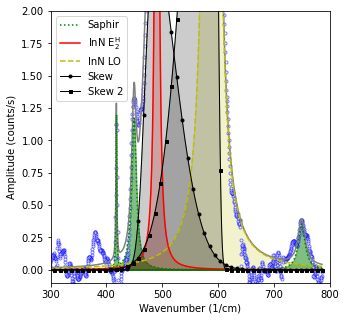

----------------------------------------------------------------------------------------------------
Position: 0.20000000000000107
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.42204 5.44676 5.45271 ... 3.9838  3.99536 3.98545]
Hintergrund Parameter:  [-1.65760629e-12  4.80169512e-09 -5.36407678e-06  2.85825464e-03
 -7.15489746e-01  7.13388775e+01]
Fitparameter Saphir 418: [1.6023875019349216, 1.5051571957873222, 417.9224981760509]
Fitparameter Saphir 451: [1.2107948814595098, 7.154378952017549, 449.2509708389998]
Fitparameter InN E2: [7.8527215881066, 6.587472503591827, 490.51364309983404]
Fitparameter InN LO: [13.033087877885096, 18.81118561578797, 588.1704568306659]
Fitparameter Saphir 751: [0.3831299876636654, 9.537937275773828, 750.8371518469346]
Fitparameter Asymmetrischer Gauß 1:  [1.6559814718822707, 50.77192203216957, 468.45884077944106, 4.197414896036316]
Fitparameter Asymmetrischer Gauß 2:  [3.024106635567931, 47.03

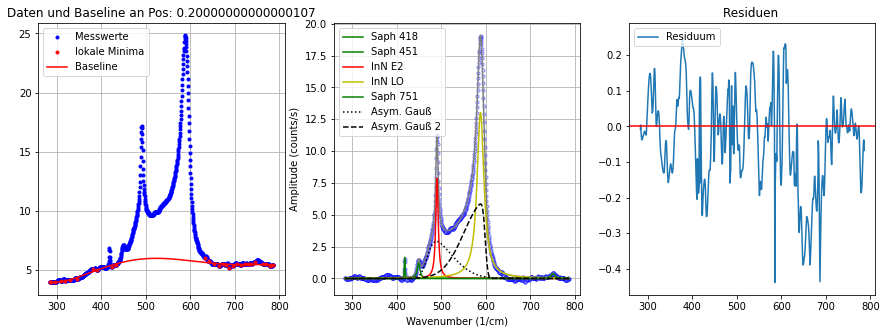

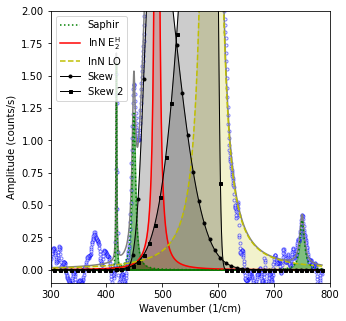

----------------------------------------------------------------------------------------------------
Position: 0.10000000000000142
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.782   5.79766 5.79018 ... 4.12386 4.09926 4.02941]
Hintergrund Parameter:  [-1.88319442e-12  5.40172145e-09 -5.97705531e-06  3.15541040e-03
 -7.82597925e-01  7.71538540e+01]
Fitparameter Saphir 418: [1.5859969147697768, 1.419458928285496, 417.8650163477907]
Fitparameter Saphir 451: [1.1893917777319114, 8.51226132073993, 449.17343637424943]
Fitparameter InN E2: [7.972199552556545, 6.297665124632857, 490.4067843008708]
Fitparameter InN LO: [13.802769576107558, 18.503341495524126, 588.3188216199849]
Fitparameter Saphir 751: [0.4176792407296149, 6.576141249234077, 749.8531117854242]
Fitparameter Asymmetrischer Gauß 1:  [1.7046272089976424, 49.72063149747654, 468.5669807070982, 4.277091104790207]
Fitparameter Asymmetrischer Gauß 2:  [3.1347476083484227, 48.3

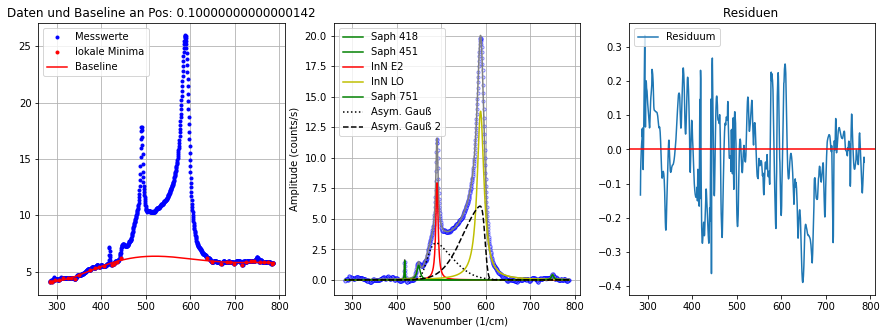

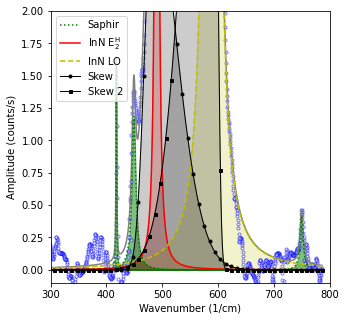

----------------------------------------------------------------------------------------------------
Position: 0.0
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.78683 5.85828 5.91012 ... 4.46731 4.49236 4.52379]
Hintergrund Parameter:  [-2.48698932e-12  6.93855864e-09 -7.50197916e-06  3.89318140e-03
 -9.56918497e-01  9.35625124e+01]
Fitparameter Saphir 418: [1.3313158347870322, 1.8230780627280627, 417.8601155621548]
Fitparameter Saphir 451: [1.395896722534813, 9.909097369152615, 449.84068112367163]
Fitparameter InN E2: [8.567432776347777, 6.2717459870987105, 490.40692757517866]
Fitparameter InN LO: [14.396136510644054, 18.30215747428908, 588.2291061097014]
Fitparameter Saphir 751: [0.3025784679008212, 9.701728185021693, 749.9522222265891]
Fitparameter Asymmetrischer Gauß 1:  [1.8760404567911597, 51.08949203114824, 469.454118504303, 4.841792792539675]
Fitparameter Asymmetrischer Gauß 2:  [3.4083275307180516, 46.86482057646974, 

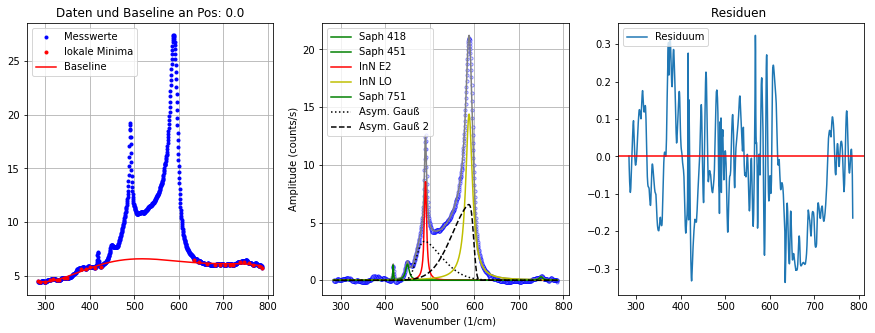

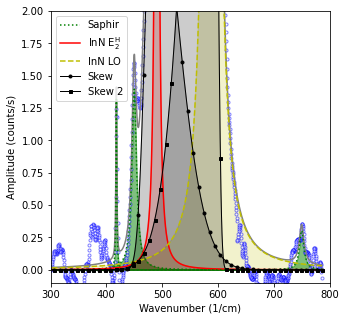

----------------------------------------------------------------------------------------------------
Position: -0.3079999999999989
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [6.14771 6.14519 6.13889 ... 4.56133 4.55387 4.53141]
Hintergrund Parameter:  [-2.85644071e-12  7.94236584e-09 -8.54389747e-06  4.40641549e-03
 -1.07612121e+00  1.04077268e+02]
Fitparameter Saphir 418: [1.7067994130913353, 1.773156899946523, 417.8469089664815]
Fitparameter Saphir 451: [1.2712596624632921, 7.532972237621988, 449.08757327678114]
Fitparameter InN E2: [9.012909177518662, 6.802470993908412, 490.5301902086072]
Fitparameter InN LO: [15.519302574201467, 19.059414725617238, 588.4353486524221]
Fitparameter Saphir 751: [0.30341282778665113, 8.935907836793644, 751.2982815511508]
Fitparameter Asymmetrischer Gauß 1:  [1.7415282449080336, 51.76127425946768, 467.7142571744963, 3.9094969376587185]
Fitparameter Asymmetrischer Gauß 2:  [3.3802317566521065, 5

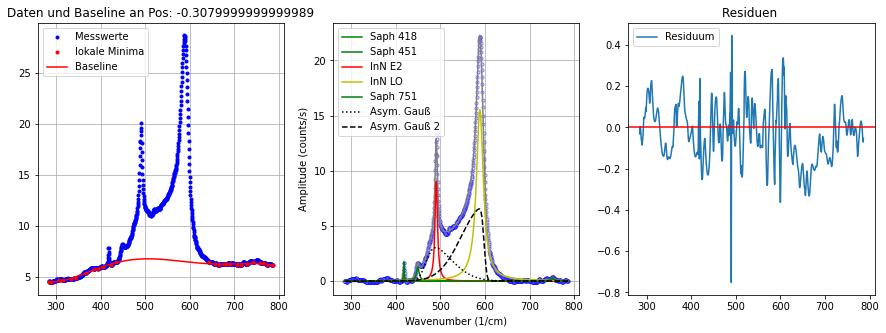

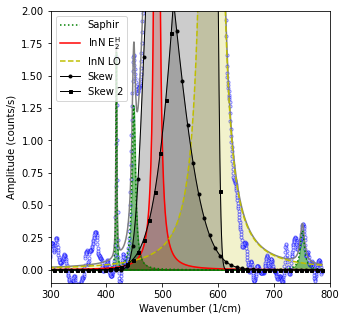

----------------------------------------------------------------------------------------------------
Position: -0.6159999999999978
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [6.45895 6.3956  6.3492  ... 4.64966 4.65324 4.67932]
Hintergrund Parameter:  [-2.20111799e-12  6.40005064e-09 -7.18554831e-06  3.85572197e-03
 -9.75265807e-01  9.77680339e+01]
Fitparameter Saphir 418: [1.5559860796119644, 2.2524256812119074, 417.9104713951795]
Fitparameter Saphir 451: [1.4736777774300378, 8.030285405541365, 448.8838236243992]
Fitparameter InN E2: [9.51403896427369, 6.128664248604524, 490.5204194766613]
Fitparameter InN LO: [15.42606958914008, 18.41924028327194, 588.2354871483801]
Fitparameter Saphir 751: [0.44716972207457156, 8.838975424919356, 750.0816860827173]
Fitparameter Asymmetrischer Gauß 1:  [1.870593365627305, 49.48312789748133, 468.48981299559324, 4.254005124306503]
Fitparameter Asymmetrischer Gauß 2:  [3.571362213866924, 48.567

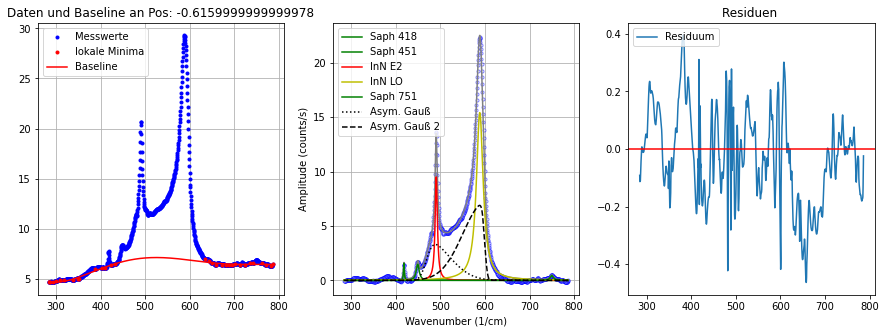

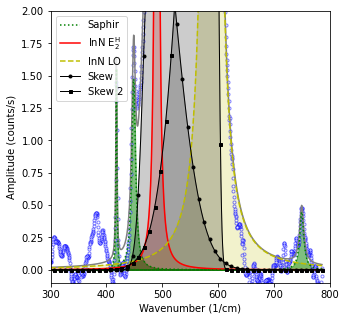

----------------------------------------------------------------------------------------------------
Position: -0.9239999999999967
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [6.40729 6.46577 6.51249 ... 4.6263  4.61621 4.6014 ]
Hintergrund Parameter:  [-1.95183767e-12  5.72742878e-09 -6.46578385e-06  3.47165206e-03
 -8.72928251e-01  8.70874855e+01]
Fitparameter Saphir 418: [2.2211200824547555, 1.5565854952585225, 417.88411832988453]
Fitparameter Saphir 451: [1.435724585416304, 9.033990277757441, 449.7032346955607]
Fitparameter InN E2: [9.064583930349919, 6.158777349698248, 490.6693658332871]
Fitparameter InN LO: [15.285859793110479, 18.211981714336996, 588.5343924530058]
Fitparameter Saphir 751: [0.520389265821568, 10.89244219647829, 749.2305241353741]
Fitparameter Asymmetrischer Gauß 1:  [1.9783051459861958, 49.00000000000001, 469.87253794271425, 4.257517238421719]
Fitparameter Asymmetrischer Gauß 2:  [3.8160421078677595, 46.

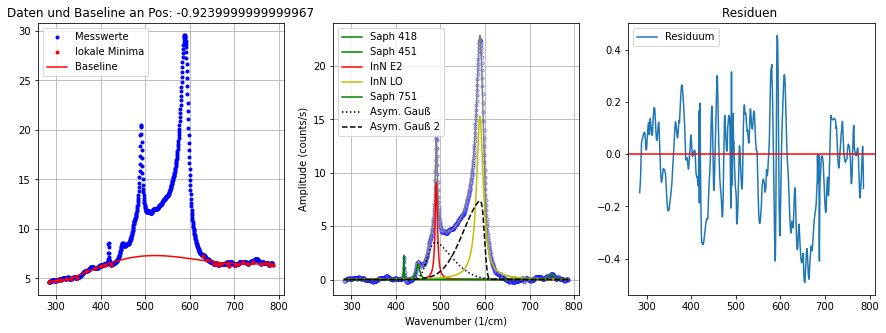

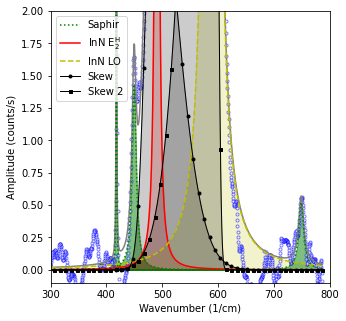

----------------------------------------------------------------------------------------------------
Position: -1.2319999999999955
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [6.36485 6.35357 6.34409 ... 4.72226 4.75898 4.80046]
Hintergrund Parameter:  [-3.24544387e-12  8.96665071e-09 -9.59674101e-06  4.93360837e-03
 -1.20437721e+00  1.16363212e+02]
Fitparameter Saphir 418: [2.4585834969366034, 1.5204902922022663, 417.9275926202441]
Fitparameter Saphir 451: [1.7331559557984106, 9.717027382682101, 449.9854075329559]
Fitparameter InN E2: [9.122397645852702, 6.184337277277596, 490.7644329458732]
Fitparameter InN LO: [15.892604979113571, 18.915220632890133, 588.8702670882708]
Fitparameter Saphir 751: [0.36626445516086736, 6.027079458683988, 749.8504669070053]
Fitparameter Asymmetrischer Gauß 1:  [2.0593578330154307, 50.445674805930196, 470.0007259248413, 4.582667666727255]
Fitparameter Asymmetrischer Gauß 2:  [3.758036403129105, 46

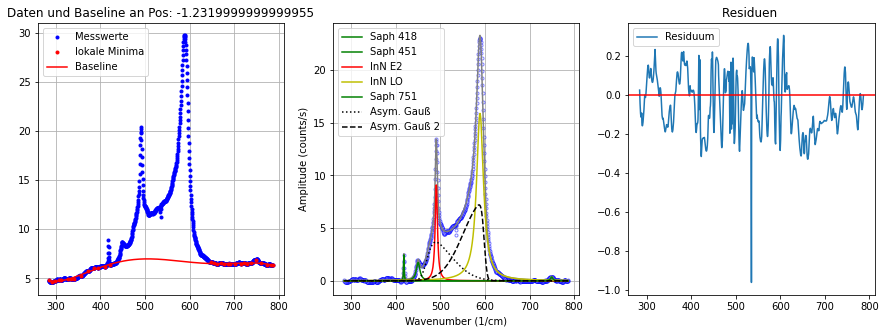

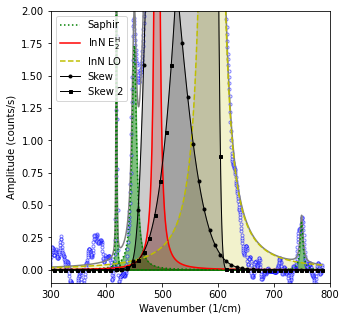

----------------------------------------------------------------------------------------------------
Position: -1.54
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [6.22243 6.20576 6.21406 ... 4.5573  4.55483 4.51968]
Hintergrund Parameter:  [-3.35048040e-12  9.20883098e-09 -9.79339911e-06  4.99661854e-03
 -1.20910339e+00  1.15565944e+02]
Fitparameter Saphir 418: [2.06218788881671, 1.7880704771830884, 417.8509138280215]
Fitparameter Saphir 451: [1.380600007279091, 9.097895166667591, 450.1397448324348]
Fitparameter InN E2: [9.305353370882205, 5.840547402240329, 490.8317420780281]
Fitparameter InN LO: [16.093830964964596, 19.165211583225837, 589.1725538231731]
Fitparameter Saphir 751: [0.35500183473677865, 5.712046564303455, 749.0084147291951]
Fitparameter Asymmetrischer Gauß 1:  [2.08531774433736, 51.12289483142773, 469.6480876998378, 4.032651775383097]
Fitparameter Asymmetrischer Gauß 2:  [3.63024192905141, 46.61860104397923, 598.

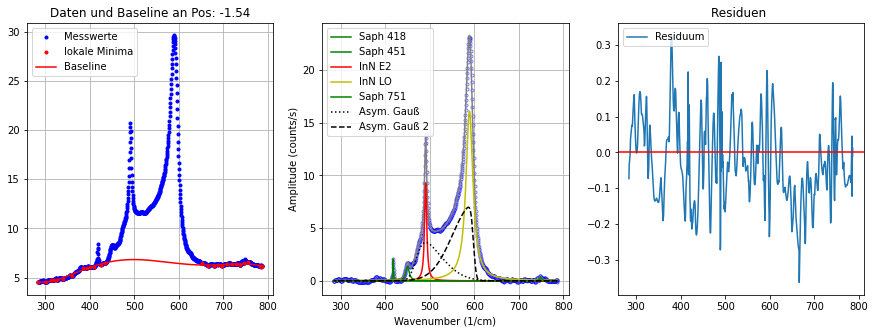

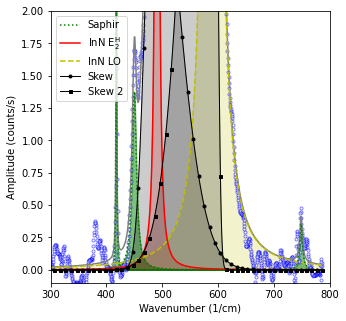

----------------------------------------------------------------------------------------------------
Position: -1.847999999999999
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [6.06023 6.04852 6.03564 ... 4.46408 4.44031 4.40764]
Hintergrund Parameter:  [-1.65154818e-12  4.90002669e-09 -5.59106038e-06  3.03201598e-03
 -7.69017437e-01  7.75230158e+01]
Fitparameter Saphir 418: [2.922113044118458, 1.2882709753546062, 417.94507538244017]
Fitparameter Saphir 451: [1.291916870880538, 9.59586917877303, 450.2624994018622]
Fitparameter InN E2: [8.855115333036064, 5.990865791372711, 490.8859832755545]
Fitparameter InN LO: [14.944155266643243, 17.897316019341105, 588.9649295876293]
Fitparameter Saphir 751: [0.6559252181928056, 8.546887406848018, 750.1354695119952]
Fitparameter Asymmetrischer Gauß 1:  [1.958383291931296, 49.00000000000001, 470.8041441784334, 3.8507242769021275]
Fitparameter Asymmetrischer Gauß 2:  [3.6187220486504437, 46.419

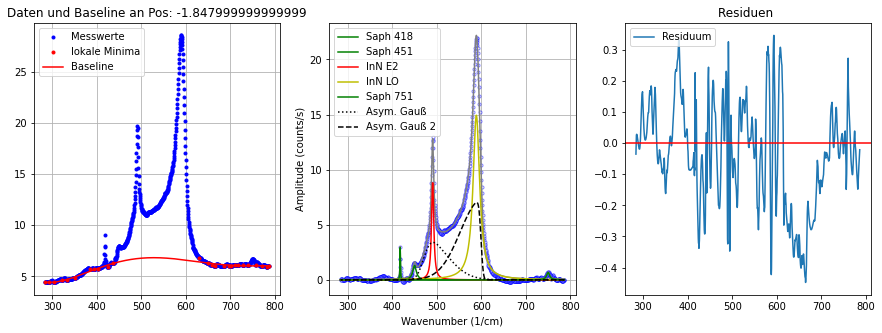

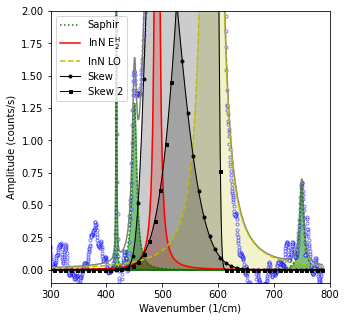

----------------------------------------------------------------------------------------------------
Position: -2.155999999999998
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.58694 5.65278 5.70662 ... 4.19226 4.17227 4.15456]
Hintergrund Parameter:  [-2.84926416e-12  7.87085314e-09 -8.41680540e-06  4.31921539e-03
 -1.05111185e+00  1.01229380e+02]
Fitparameter Saphir 418: [2.659516409254203, 1.606520803199977, 417.95814882730014]
Fitparameter Saphir 451: [1.4343021562949811, 8.264263661939674, 450.3228496955792]
Fitparameter InN E2: [8.524668094157423, 6.025802723396295, 490.98127191371475]
Fitparameter InN LO: [14.53912250689442, 18.96216757343287, 589.3241673493364]
Fitparameter Saphir 751: [0.522828536259521, 6.778483497784571, 749.2537629248402]
Fitparameter Asymmetrischer Gauß 1:  [1.739982791821217, 52.1416395421357, 469.1695072276374, 4.522677127131535]
Fitparameter Asymmetrischer Gauß 2:  [3.4008834708045343, 48.860451

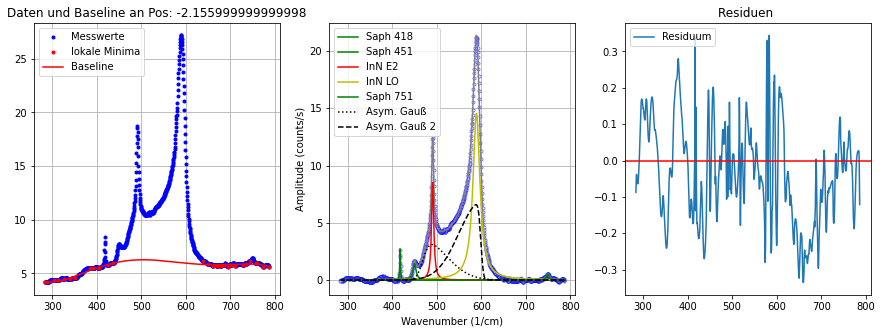

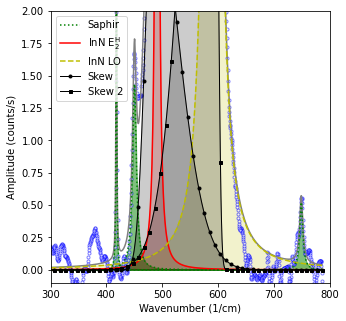

----------------------------------------------------------------------------------------------------
Position: -2.463999999999997
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.40593 5.30087 5.2335  ... 4.06211 4.08316 4.13042]
Hintergrund Parameter:  [-2.64593530e-12  7.43630116e-09 -8.09315337e-06  4.22766478e-03
 -1.04786387e+00  1.02616584e+02]
Fitparameter Saphir 418: [2.860532409088643, 1.8416863775503822, 418.0285514178123]
Fitparameter Saphir 451: [1.4003455414470365, 7.684437319655903, 450.40861043843563]
Fitparameter InN E2: [7.889200134147303, 6.189998914587219, 491.05659228732486]
Fitparameter InN LO: [14.139567058751418, 18.27653510412565, 589.3205774769905]
Fitparameter Saphir 751: [0.5935026624234474, 7.249518709531243, 750.4753657056718]
Fitparameter Asymmetrischer Gauß 1:  [1.5920306811910554, 51.15259787422436, 469.4998511157486, 4.7792661105659695]
Fitparameter Asymmetrischer Gauß 2:  [3.169504254106927, 49.5

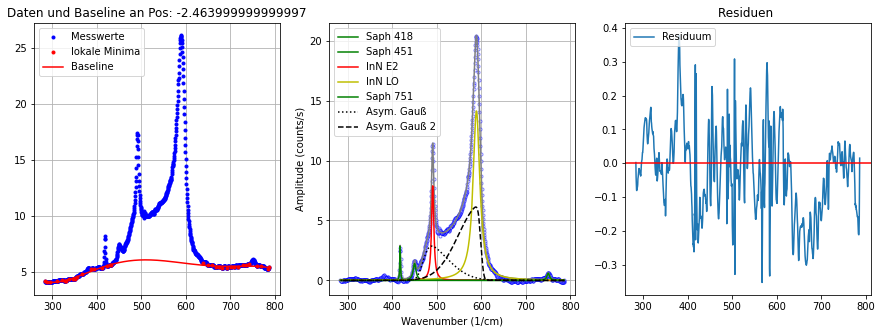

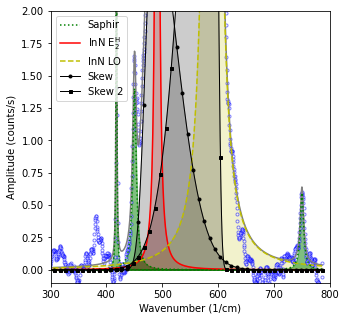

----------------------------------------------------------------------------------------------------
Position: -2.771999999999996
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [5.18794 5.17957 5.17167 ... 3.81962 3.81223 3.80532]
Hintergrund Parameter:  [-2.59183135e-12  7.16125865e-09 -7.65581832e-06  3.92666747e-03
 -9.55383119e-01  9.20888633e+01]
Fitparameter Saphir 418: [3.257943413464878, 1.6787403546157709, 417.9618649309615]
Fitparameter Saphir 451: [1.2905452199351801, 8.155791796115349, 449.3931534827841]
Fitparameter InN E2: [7.621143433794503, 5.84112916137016, 491.07647782650446]
Fitparameter InN LO: [13.250953797354581, 19.43668453168411, 589.4468723361229]
Fitparameter Saphir 751: [0.488271242813014, 8.869266336484404, 750.9609646827887]
Fitparameter Asymmetrischer Gauß 1:  [1.704709421838785, 50.476691064030476, 470.197218139773, 3.7706421118960036]
Fitparameter Asymmetrischer Gauß 2:  [3.080893170491419, 48.23061

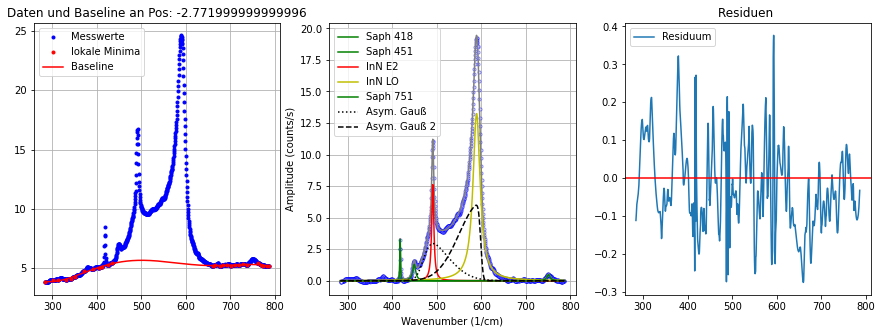

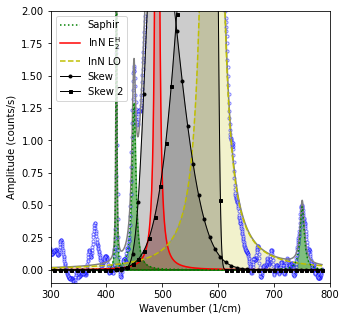

----------------------------------------------------------------------------------------------------
Position: -3.08
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.83322 4.83122 4.83071 ... 3.62375 3.67167 3.70204]
Hintergrund Parameter:  [-1.48195620e-12  4.46507091e-09 -5.16941861e-06  2.84575097e-03
 -7.34925874e-01  7.49980939e+01]
Fitparameter Saphir 418: [3.060947047607766, 1.8450914609628273, 417.95679107748515]
Fitparameter Saphir 451: [1.0844325812746938, 9.46291242053129, 450.3548593793646]
Fitparameter InN E2: [6.774100535343339, 6.002903403869654, 491.12059629045865]
Fitparameter InN LO: [11.775056720768038, 17.495919615466622, 589.5370843939845]
Fitparameter Saphir 751: [0.7112179676352393, 10.560469666394866, 749.7198967160324]
Fitparameter Asymmetrischer Gauß 1:  [1.452459316569668, 49.00000000000001, 470.9738913590625, 3.994123116551536]
Fitparameter Asymmetrischer Gauß 2:  [2.948882777428838, 45.23998222276331,

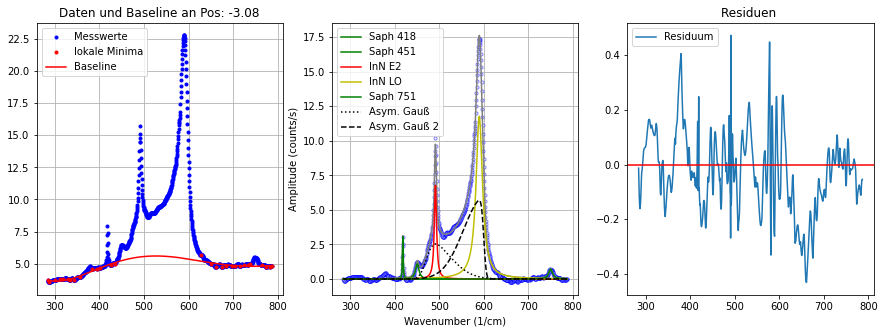

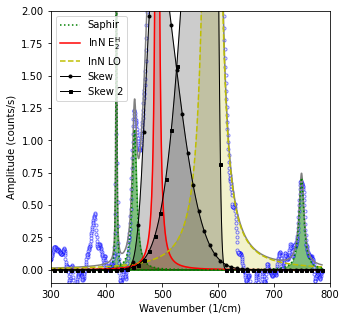

----------------------------------------------------------------------------------------------------
Position: -3.387999999999999
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.46034 4.47788 4.47941 ... 3.34723 3.33047 3.337  ]
Hintergrund Parameter:  [-2.19109480e-12  6.08002913e-09 -6.52795567e-06  3.36157561e-03
 -8.20503285e-01  7.92841437e+01]
Fitparameter Saphir 418: [3.6513447927294203, 1.589956104709263, 418.01290244832984]
Fitparameter Saphir 451: [1.2225381536573372, 8.927981118837105, 449.68082186496963]
Fitparameter InN E2: [6.562866499297994, 5.616320871472624, 491.1748866216945]
Fitparameter InN LO: [11.39626814017394, 18.89911531063794, 589.7085737494739]
Fitparameter Saphir 751: [0.5887881702872066, 7.597202605912265, 750.6214762967726]
Fitparameter Asymmetrischer Gauß 1:  [1.4182897480957388, 49.000000000010715, 470.3948112275838, 4.192589424644244]
Fitparameter Asymmetrischer Gauß 2:  [2.686798212712528, 48.00

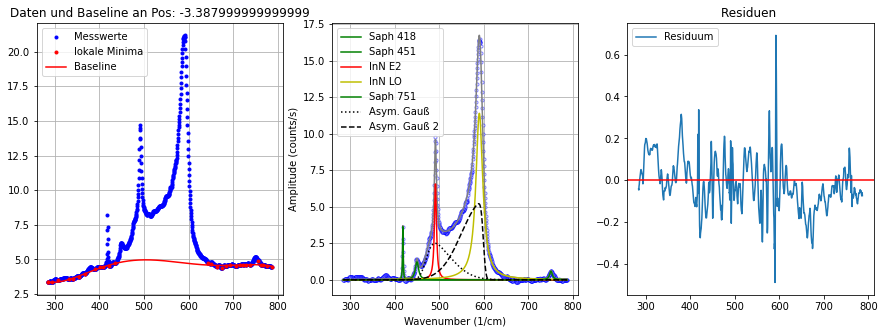

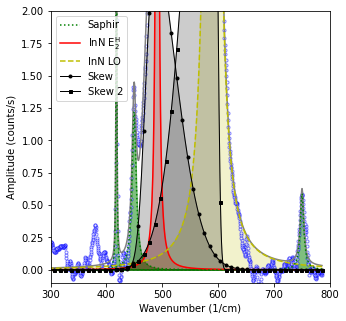

----------------------------------------------------------------------------------------------------
Position: -3.695999999999998
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [4.2137  4.16587 4.12786 ... 3.17579 3.19912 3.2263 ]
Hintergrund Parameter:  [-1.54618479e-12  4.49954780e-09 -5.05087085e-06  2.70751193e-03
 -6.84252678e-01  6.84405774e+01]
Fitparameter Saphir 418: [3.262121380721304, 1.7590012237834856, 418.0701100483658]
Fitparameter Saphir 451: [1.1490117793600076, 7.32046884778788, 449.89249626341706]
Fitparameter InN E2: [6.058626176841799, 5.746073788081285, 491.1672227678481]
Fitparameter InN LO: [10.458219261888459, 18.434333038964578, 589.4466055847611]
Fitparameter Saphir 751: [0.6719900852938018, 13.266338465399862, 748.8062832880445]
Fitparameter Asymmetrischer Gauß 1:  [1.187119863750291, 49.00000000000002, 469.49693980593537, 4.526133923791008]
Fitparameter Asymmetrischer Gauß 2:  [2.39410304182821, 48.977

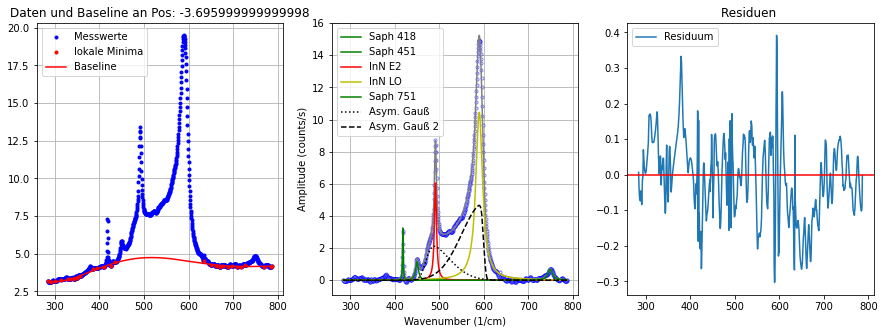

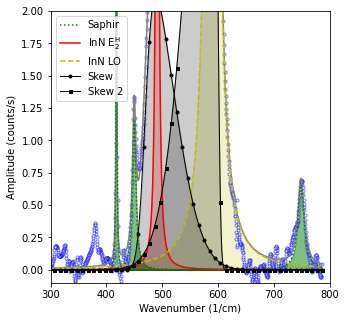

----------------------------------------------------------------------------------------------------
Position: -4.003999999999997
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [3.9127  3.90157 3.90035 ... 2.94521 2.95719 3.00498]
Hintergrund Parameter:  [-1.80088801e-12  5.07386631e-09 -5.52136278e-06  2.87579523e-03
 -7.08701080e-01  6.90638222e+01]
Fitparameter Saphir 418: [3.574181607282035, 1.7086074819845007, 417.9967539140244]
Fitparameter Saphir 451: [0.9497579312683642, 7.290513251675634, 450.0676230793346]
Fitparameter InN E2: [5.404203945440457, 5.891915347815957, 491.19327742569305]
Fitparameter InN LO: [9.76841803232198, 18.423109691372716, 589.99085324541]
Fitparameter Saphir 751: [0.688535811260162, 8.817443648553605, 750.2563818326649]
Fitparameter Asymmetrischer Gauß 1:  [1.1262942977553174, 49.00000000006488, 470.34702305075064, 3.907001793878789]
Fitparameter Asymmetrischer Gauß 2:  [2.275280814303965, 48.923444

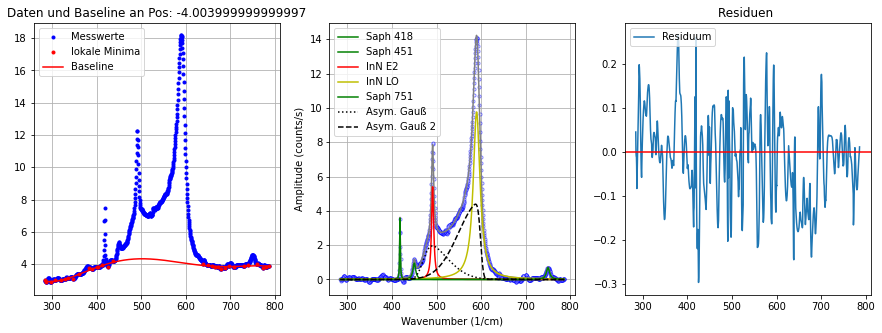

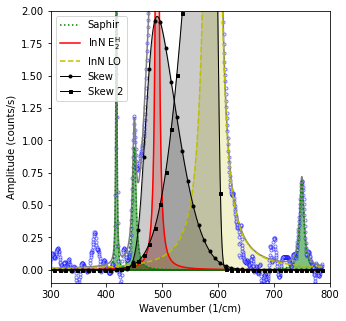

----------------------------------------------------------------------------------------------------
Position: -4.311999999999996
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [3.67267 3.67349 3.66237 ... 2.88571 2.90122 2.89934]
Hintergrund Parameter:  [-1.46412844e-12  4.19432930e-09 -4.64189929e-06  2.45841456e-03
 -6.15744726e-01  6.12259839e+01]
Fitparameter Saphir 418: [3.6785962299498887, 1.6710292911080389, 417.98169790396304]
Fitparameter Saphir 451: [0.9242922316774163, 7.276816342816522, 450.1092697781663]
Fitparameter InN E2: [4.9537074927007945, 5.860321599360018, 491.219231133541]
Fitparameter InN LO: [8.847092207295042, 18.447432244227628, 589.9111108252407]
Fitparameter Saphir 751: [0.564337690343767, 12.01608521189055, 750.5702438507595]
Fitparameter Asymmetrischer Gauß 1:  [1.0709414112969473, 49.8824380951397, 470.40162880954654, 4.046562663639435]
Fitparameter Asymmetrischer Gauß 2:  [2.060330358189168, 47.796

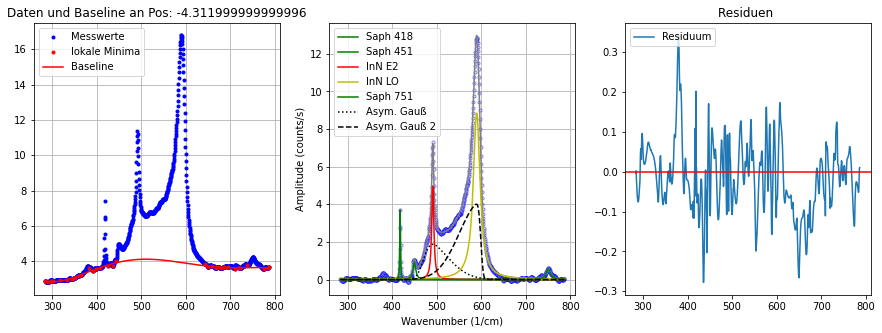

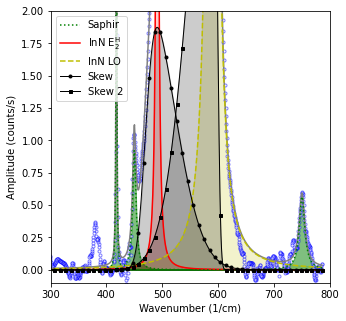

----------------------------------------------------------------------------------------------------
Position: -4.62
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [3.50602 3.45496 3.4161  ... 2.60943 2.6124  2.61385]
Hintergrund Parameter:  [-1.65325284e-12  4.65032986e-09 -5.05263959e-06  2.62938377e-03
 -6.48487249e-01  6.32658456e+01]
Fitparameter Saphir 418: [3.6367953521547887, 1.8144069777533665, 417.9892222930996]
Fitparameter Saphir 451: [0.8804899113816826, 7.7967539276590765, 450.6383827123131]
Fitparameter InN E2: [4.42754046059114, 5.977559256501727, 491.3908133474828]
Fitparameter InN LO: [8.310536372385709, 18.809970657083635, 590.1259164630236]
Fitparameter Saphir 751: [0.5724089678996265, 9.925546349254041, 749.7599923771813]
Fitparameter Asymmetrischer Gauß 1:  [0.918448233260419, 50.431507636253414, 469.9641548857629, 4.801043716579838]
Fitparameter Asymmetrischer Gauß 2:  [1.930258163804819, 48.06177337431239, 

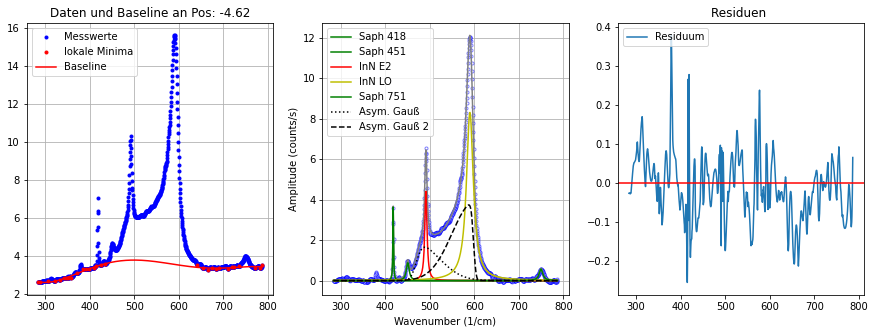

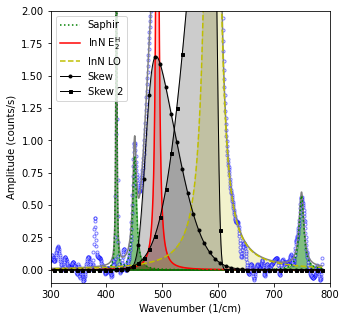

----------------------------------------------------------------------------------------------------
Position: -4.927999999999999
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.84996 2.88737 2.93353 ... 2.29027 2.26778 2.26251]
Hintergrund Parameter:  [-1.29711128e-12  3.60121685e-09 -3.86961164e-06  1.99398106e-03
 -4.86823355e-01  4.73767813e+01]
Fitparameter Saphir 418: [3.591477116855827, 1.818271204518849, 417.97591754815124]
Fitparameter Saphir 451: [0.7461301147322013, 7.0452596672748005, 449.74606254832395]
Fitparameter InN E2: [4.003252721720421, 6.333415882590841, 491.26065971453426]
Fitparameter InN LO: [7.596831702143654, 18.481004020399094, 589.8749527486599]
Fitparameter Saphir 751: [0.6379938176228275, 11.095489011531688, 750.3372700498418]
Fitparameter Asymmetrischer Gauß 1:  [0.8783660210222012, 49.00000000000001, 470.53356391828294, 3.4613136960471866]
Fitparameter Asymmetrischer Gauß 2:  [1.6476152826018355, 

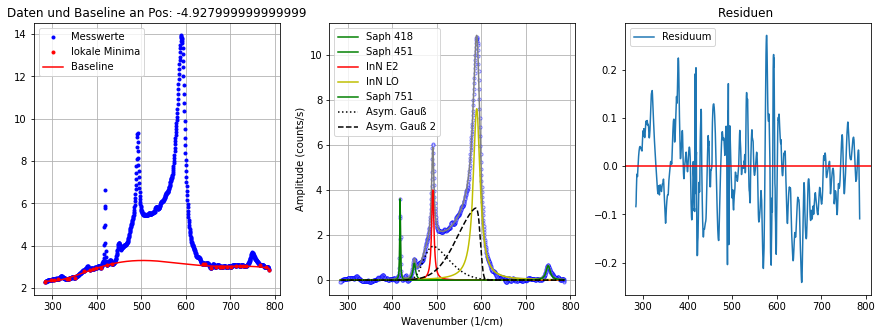

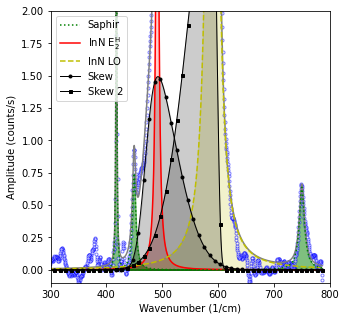

----------------------------------------------------------------------------------------------------
Position: -5.235999999999998
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.87508 2.83472 2.80281 ... 2.15039 2.12716 2.08779]
Hintergrund Parameter:  [-9.25063243e-13  2.72702240e-09 -3.08622155e-06  1.65967911e-03
 -4.18648757e-01  4.18738927e+01]
Fitparameter Saphir 418: [3.815536677032869, 1.7794933305883236, 418.08743455390936]
Fitparameter Saphir 451: [0.5808291941636582, 6.181477265386018, 449.74697195115175]
Fitparameter InN E2: [3.6710534526259657, 6.0922878002930085, 491.399687191605]
Fitparameter InN LO: [6.608282196865639, 17.91663199331508, 589.7380533813813]
Fitparameter Saphir 751: [0.6398697374608323, 11.285010400387842, 749.334900256416]
Fitparameter Asymmetrischer Gauß 1:  [0.7654594548987202, 49.00000000000001, 470.32687314268964, 3.7319327239528297]
Fitparameter Asymmetrischer Gauß 2:  [1.5769259829263675, 46

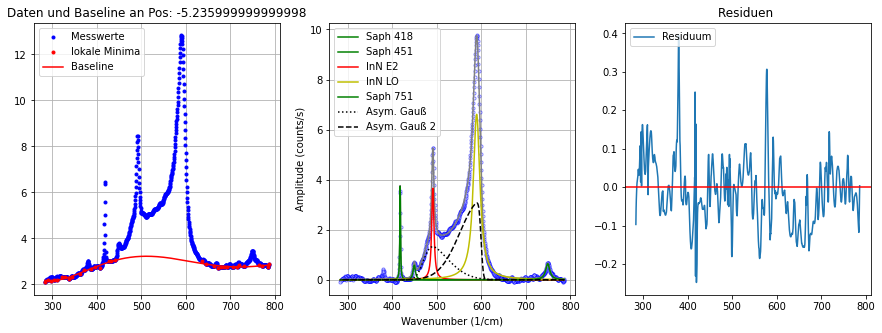

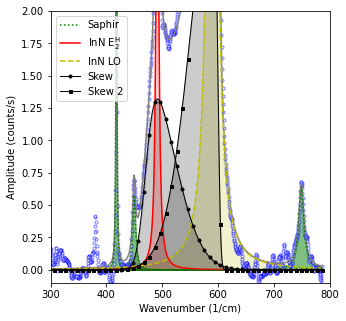

----------------------------------------------------------------------------------------------------
Position: -5.543999999999997
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.60627 2.56468 2.54024 ... 2.04381 2.06923 2.11765]
Hintergrund Parameter:  [-1.55829641e-12  4.34306424e-09 -4.68935077e-06  2.43405244e-03
 -6.01585128e-01  5.87032890e+01]
Fitparameter Saphir 418: [4.017345787328805, 1.7104434714909198, 418.0106952233621]
Fitparameter Saphir 451: [0.5956614011047191, 6.787925194810368, 450.2116568593305]
Fitparameter InN E2: [3.5584018738496344, 5.7328457335299845, 491.33711411255683]
Fitparameter InN LO: [6.089062841628401, 18.07122243206814, 589.9343164837562]
Fitparameter Saphir 751: [0.576643812659586, 8.083023860557931, 749.7044963822975]
Fitparameter Asymmetrischer Gauß 1:  [0.7449363501965259, 49.41648950626267, 471.99999999898426, 3.700037267992555]
Fitparameter Asymmetrischer Gauß 2:  [1.4942903768685636, 45.3

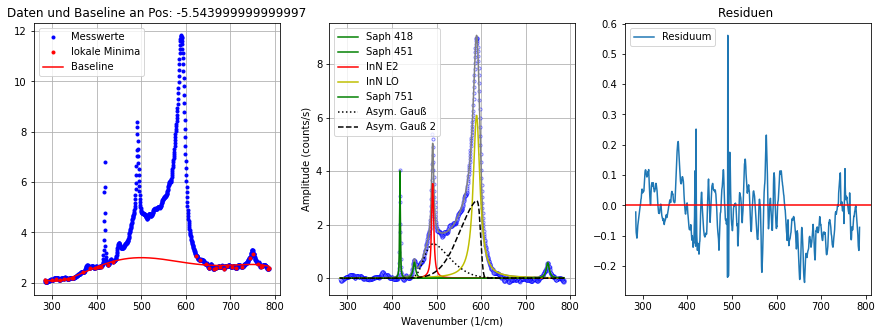

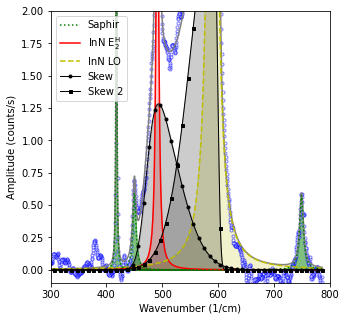

----------------------------------------------------------------------------------------------------
Position: -5.851999999999996
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.51249 2.50491 2.4783  ... 1.92915 1.94029 1.94318]
Hintergrund Parameter:  [-7.04952544e-13  2.06592280e-09 -2.32297155e-06  1.23959526e-03
 -3.09521908e-01  3.09499964e+01]
Fitparameter Saphir 418: [3.833305539018733, 1.909367789485664, 418.00451411654086]
Fitparameter Saphir 451: [0.5998244073099546, 7.036916129068048, 449.44770541055624]
Fitparameter InN E2: [3.215793345125215, 6.47082198318374, 491.3166220137711]
Fitparameter InN LO: [5.849671625550738, 18.234501208911112, 590.187694493262]
Fitparameter Saphir 751: [0.6518006907202242, 13.39140046455206, 748.6163178646144]
Fitparameter Asymmetrischer Gauß 1:  [0.5754853439465747, 49.00000000000012, 468.32077363890886, 3.947441470672855]
Fitparameter Asymmetrischer Gauß 2:  [1.3701660819707702, 51.501

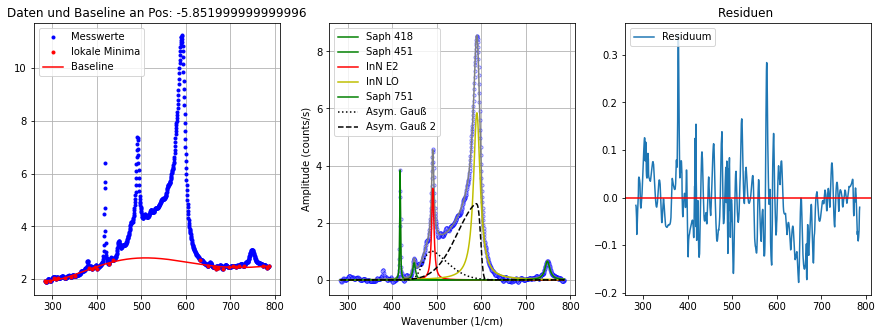

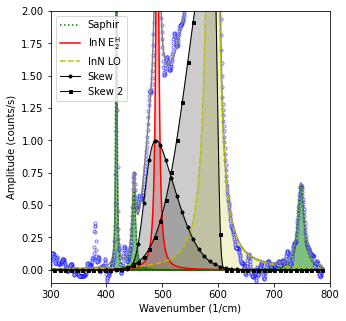

----------------------------------------------------------------------------------------------------
Position: -6.16
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.30437 2.27442 2.246   ... 1.7537  1.75561 1.75179]
Hintergrund Parameter:  [-1.05801684e-12  2.92274248e-09 -3.11746417e-06  1.59177007e-03
 -3.84882746e-01  3.70440307e+01]
Fitparameter Saphir 418: [3.962053659010743, 1.7800721488143252, 418.03940914602373]
Fitparameter Saphir 451: [0.5593070580394021, 6.7907277924408405, 449.58146820894245]
Fitparameter InN E2: [2.8858448162044725, 6.103347096543911, 491.3958635804297]
Fitparameter InN LO: [5.385630575498018, 19.306353047702547, 590.2748759346582]
Fitparameter Saphir 751: [0.5966020818311412, 11.33037629261806, 750.2196425454428]
Fitparameter Asymmetrischer Gauß 1:  [0.5849876607856156, 49.00000000006474, 469.42376195675325, 4.092249321335636]
Fitparameter Asymmetrischer Gauß 2:  [1.2063559542843658, 50.68677907350

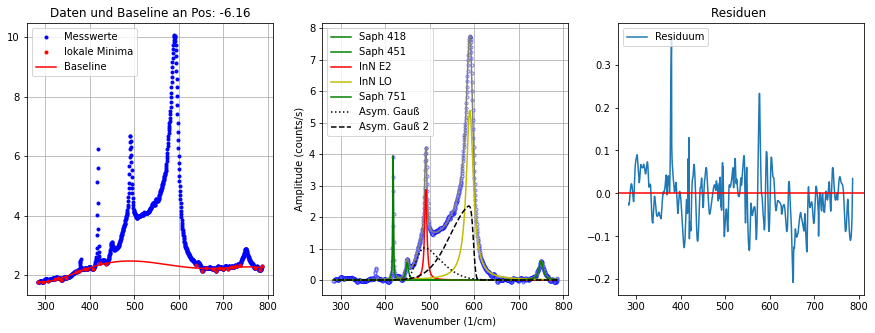

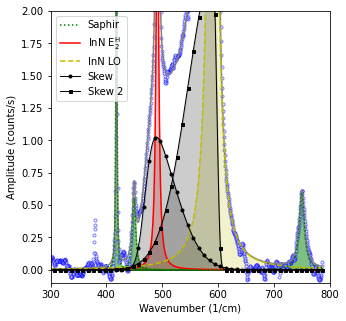

----------------------------------------------------------------------------------------------------
Position: -6.467999999999999
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.9451  1.97722 2.00612 ... 1.56839 1.56667 1.5917 ]
Hintergrund Parameter:  [-6.45589430e-13  1.82796872e-09 -1.99730165e-06  1.04202146e-03
 -2.55961242e-01  2.52996539e+01]
Fitparameter Saphir 418: [4.06238347881429, 1.969198190490444, 418.04537309954054]
Fitparameter Saphir 451: [0.5987655421744916, 5.996618430620974, 449.4201046104823]
Fitparameter InN E2: [2.6727586443186606, 5.647816844844166, 491.31238434058486]
Fitparameter InN LO: [4.494669854236733, 18.10292561668754, 589.9504861026346]
Fitparameter Saphir 751: [0.6549027391805318, 12.84081390779575, 750.052756866676]
Fitparameter Asymmetrischer Gauß 1:  [0.5926799274304156, 49.00000000000001, 471.01179705544445, 3.3855891586788296]
Fitparameter Asymmetrischer Gauß 2:  [1.1589652620766406, 47.01

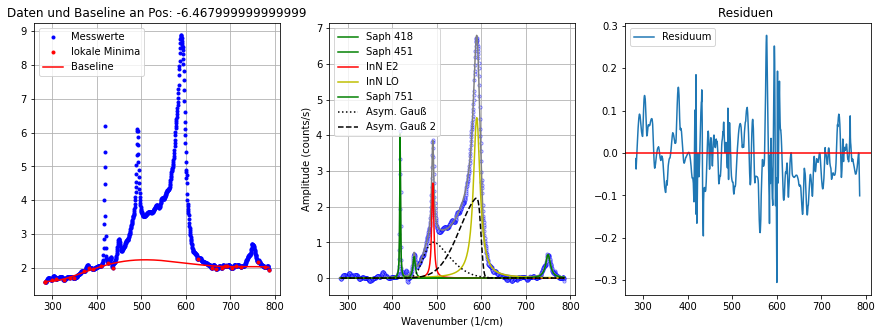

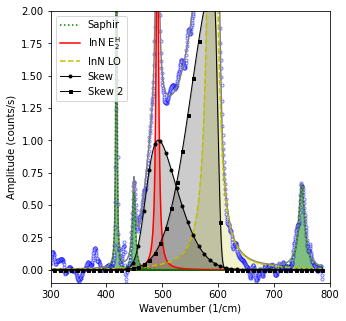

----------------------------------------------------------------------------------------------------
Position: -6.775999999999998
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.85988 1.89083 1.91938 ... 1.5697  1.57685 1.59923]
Hintergrund Parameter:  [-4.55578853e-13  1.37524655e-09 -1.59162965e-06  8.72710414e-04
 -2.23281802e-01  2.29736248e+01]
Fitparameter Saphir 418: [4.107172642024795, 1.8204564175945026, 418.0219660181786]
Fitparameter Saphir 451: [0.5131944778978814, 5.6332866195635996, 449.59673654990195]
Fitparameter InN E2: [2.3128648989869314, 6.363679355538287, 491.1994048121542]
Fitparameter InN LO: [4.052643303549082, 16.893740446276794, 590.0171461767524]
Fitparameter Saphir 751: [0.6627826647473044, 12.73270815203549, 749.8641386006669]
Fitparameter Asymmetrischer Gauß 1:  [0.56618742438068, 49.00000000000013, 471.7492034176571, 3.3538950216944743]
Fitparameter Asymmetrischer Gauß 2:  [1.1428174844539065, 42.9

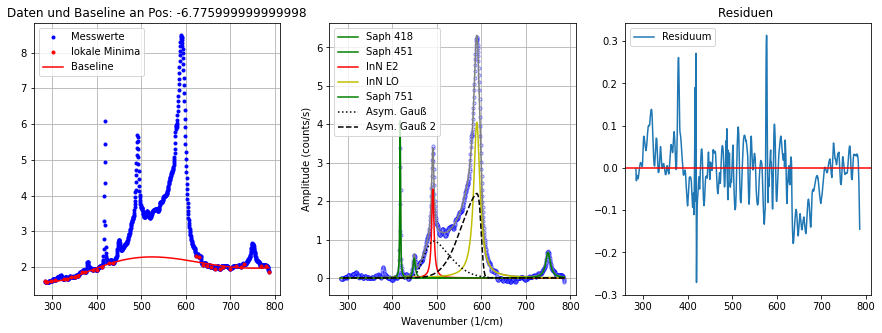

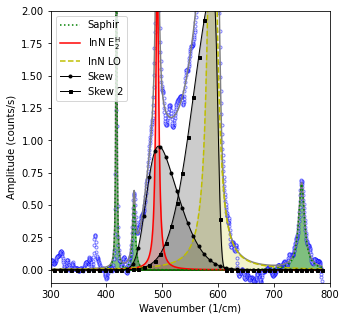

----------------------------------------------------------------------------------------------------
Position: -7.083999999999997
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [2.02755 2.04355 2.04907 ... 1.64333 1.65601 1.67065]
Hintergrund Parameter:  [-9.49858570e-13  2.66010937e-09 -2.88262491e-06  1.49931719e-03
 -3.70606273e-01  3.64655155e+01]
Fitparameter Saphir 418: [4.183443929978318, 1.7392191807844652, 418.08258433482064]
Fitparameter Saphir 451: [0.4729771439777415, 7.322822746585125, 449.7393155637472]
Fitparameter InN E2: [2.240263087721349, 6.162803977791112, 491.43313019627425]
Fitparameter InN LO: [4.352192288299091, 18.885397169211576, 590.3358604995643]
Fitparameter Saphir 751: [0.6760261540807833, 10.764001301957162, 749.7221907211655]
Fitparameter Asymmetrischer Gauß 1:  [0.4658174287746987, 50.61083773246059, 470.05770446947247, 3.8188508278029776]
Fitparameter Asymmetrischer Gauß 2:  [0.9611028527522559, 5

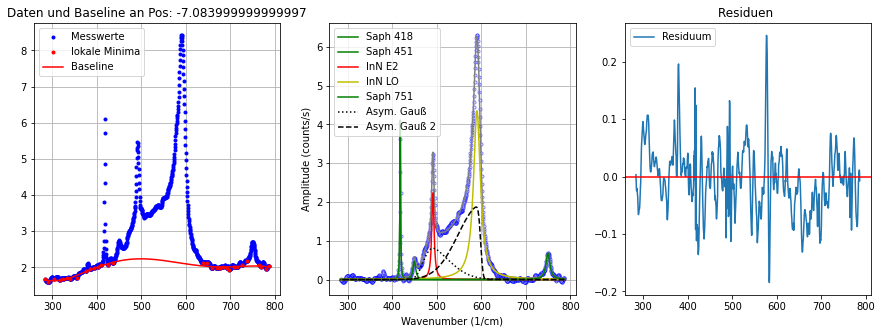

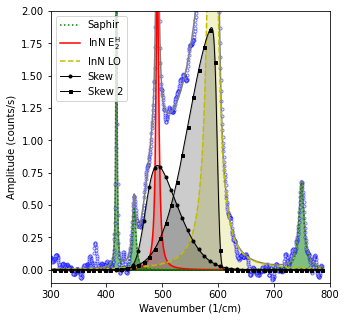

----------------------------------------------------------------------------------------------------
Position: -7.391999999999996
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.91155 1.9197  1.91404 ... 1.54039 1.56798 1.61796]
Hintergrund Parameter:  [-1.05739944e-12  2.96263498e-09 -3.21377264e-06  1.67524032e-03
 -4.15868321e-01  4.08351084e+01]
Fitparameter Saphir 418: [4.414224105096725, 1.691827408341615, 418.06632915233683]
Fitparameter Saphir 451: [0.522443821927796, 5.82723542514997, 450.0317865362282]
Fitparameter InN E2: [2.328948936645999, 5.771490321254988, 491.24306367686256]
Fitparameter InN LO: [4.280836916735321, 18.984820935194875, 589.8652601477447]
Fitparameter Saphir 751: [0.6157296802435441, 10.940011396673082, 749.9887862185427]
Fitparameter Asymmetrischer Gauß 1:  [0.5055607663003359, 49.45171325882844, 471.4873450315152, 3.787975448613939]
Fitparameter Asymmetrischer Gauß 2:  [0.9924799411857158, 46.731

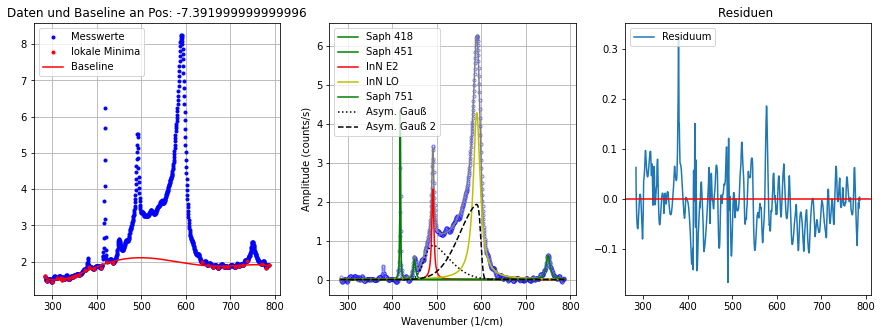

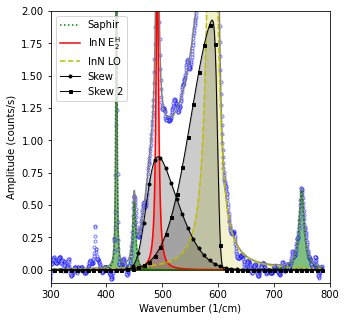

----------------------------------------------------------------------------------------------------
Position: -7.7
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.79204 1.79065 1.78721 ... 1.38039 1.37152 1.36162]
Hintergrund Parameter:  [-5.88823686e-13  1.70881201e-09 -1.90850200e-06  1.01626468e-03
 -2.54932933e-01  2.55304972e+01]
Fitparameter Saphir 418: [4.692153664774614, 1.58555483335579, 417.98250262885773]
Fitparameter Saphir 451: [0.45524390536167275, 5.6786223091591195, 449.50681891412495]
Fitparameter InN E2: [2.2005374307420156, 6.014332589115495, 491.38905618245747]
Fitparameter InN LO: [3.819126544824933, 19.1135700428154, 589.8285528042016]
Fitparameter Saphir 751: [0.6586314954316078, 11.610032421992573, 749.2713189495574]
Fitparameter Asymmetrischer Gauß 1:  [0.4044456080391572, 49.00000000000001, 469.5717783544812, 4.45058446547386]
Fitparameter Asymmetrischer Gauß 2:  [0.9124786245686501, 48.473911915489396

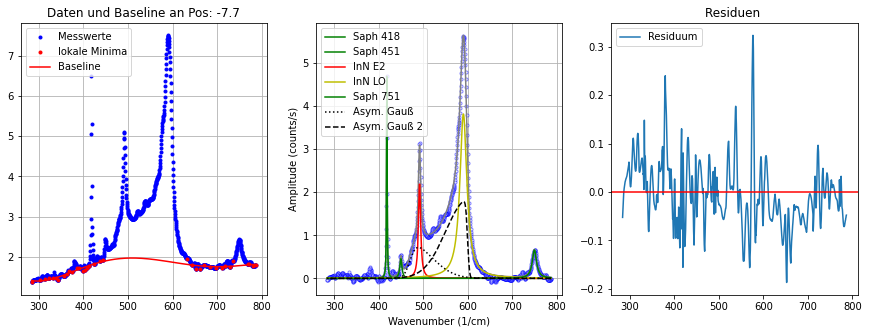

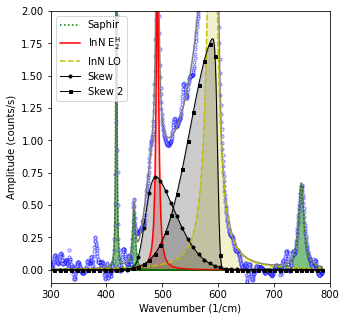

----------------------------------------------------------------------------------------------------
Position: -8.008
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.72407 1.66402 1.63109 ... 1.28593 1.28897 1.27572]
Hintergrund Parameter:  [-2.38441703e-13  8.49531805e-10 -1.10123049e-06  6.54313341e-04
 -1.77645029e-01  1.91000519e+01]
Fitparameter Saphir 418: [4.332781987637814, 1.7609493873289086, 418.03063548746144]
Fitparameter Saphir 451: [0.4517190771784851, 5.4060207956309245, 449.6715698901885]
Fitparameter InN E2: [1.9357934092259235, 5.63781468055361, 491.3615810948879]
Fitparameter InN LO: [3.220674247900952, 16.99966034561511, 590.0586104104023]
Fitparameter Saphir 751: [0.6779681649770529, 13.414910432525296, 749.5233472105433]
Fitparameter Asymmetrischer Gauß 1:  [0.4319973930081467, 49.000000000683855, 471.99999999999994, 3.6829741932943163]
Fitparameter Asymmetrischer Gauß 2:  [0.9396488693970342, 40.5081128946

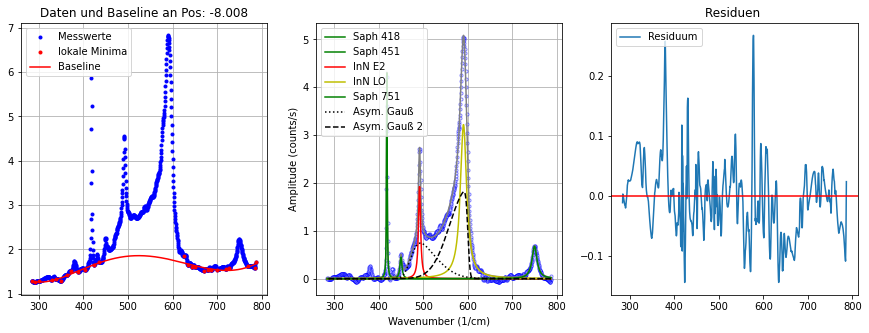

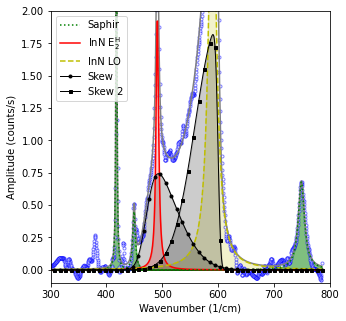

----------------------------------------------------------------------------------------------------
Position: -8.315999999999997
x-Daten: [786.42480758 785.95233758 785.48180758 ... 285.00277758 284.49316758
 283.98144758]
y-Daten: [1.56294 1.57021 1.57392 ... 1.34938 1.3477  1.34465]
Hintergrund Parameter:  [-6.62905076e-13  1.92558927e-09 -2.16171200e-06  1.16265340e-03
 -2.96472033e-01  2.99567477e+01]
Fitparameter Saphir 418: [4.304205619609, 1.7073702691271027, 418.02776776921917]
Fitparameter Saphir 451: [0.3601802736542665, 11.505235303082097, 453.421619510257]
Fitparameter InN E2: [1.7199561254585607, 6.7571283160634525, 491.46428091421257]
Fitparameter InN LO: [3.14444353359141, 17.626205906917757, 589.7733048113644]
Fitparameter Saphir 751: [0.6848497168252057, 12.602236401341994, 749.493342848652]
Fitparameter Asymmetrischer Gauß 1:  [0.3401773987595148, 49.00000000014658, 471.99999999999994, 3.3389806539981746]
Fitparameter Asymmetrischer Gauß 2:  [0.8125158224563841, 46.5

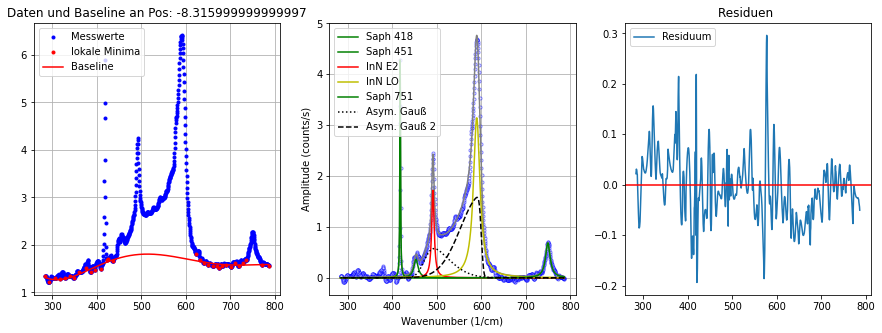

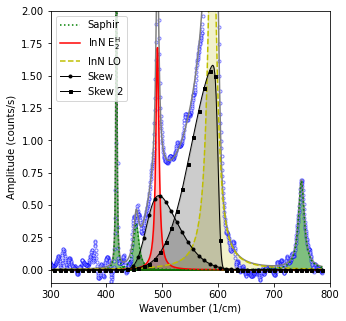

----------------------------------------------------------------------------------------------------


In [12]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Asymm_Gauß_1_Liste=[]
Asymm_Gauß_2_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_MEPA_D1_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_MEPA_D1_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_MEPA_D1_array_float[0],[0])
        y=np.delete(data_MEPA_D1_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=4)[0]]
        xzw=x[argrelextrema(y, np.less,order=4)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for j in range(len(xzw)):
            if xzw[j]<=450 or xzw[j]>=620:
                xmin.append(xzw[j])
                ymin.append(yzw[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1]) 
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)

        
        #fitten 5 lorentz in saphir_418, saphir_451, InN E2 498, InN LO 595, saphir_751 + 2Asymmetrischer Gauß
        #L_x5_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
        # 5 Lorentzpeaks + 2 Asymmetrischer gauß
        #return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)
        init_vals_L_x5_AG_x2 = [1,1,418, 1,1,451, 5,1,491, 1,1,595, 1,1,751, 1,53,469,3, 1,41,599,-6]
        param_bounds_L_x5_AG_x2= ([0,0,410, 0,0,440, 1,1,485, 0,0,585, 0,0,740, 0,49,460,0, 0,40,580,-30],
                                  [np.inf,np.inf,430, np.inf,np.inf,460, np.inf,8,505, np.inf,50,605, np.inf,np.inf,760, np.inf,np.inf,472,np.inf, np.inf,np.inf,610,np.inf])
        fitParams_L_x5_AG_x2, cov_L_x5_AG_x2 = curve_fit(f=L_x5_AG_x2, xdata=x, ydata=y_glatt, p0=init_vals_L_x5_AG_x2, bounds=param_bounds_L_x5_AG_x2)
        fitParams_L_Saphir_418=[fitParams_L_x5_AG_x2[0],fitParams_L_x5_AG_x2[1],fitParams_L_x5_AG_x2[2]]
        fitParams_L_Saphir_451=[fitParams_L_x5_AG_x2[3],fitParams_L_x5_AG_x2[4],fitParams_L_x5_AG_x2[5]]
        fitParams_L_InN_E2=[fitParams_L_x5_AG_x2[6],fitParams_L_x5_AG_x2[7],fitParams_L_x5_AG_x2[8]]
        fitParams_L_InN_LO=[fitParams_L_x5_AG_x2[9],fitParams_L_x5_AG_x2[10],fitParams_L_x5_AG_x2[11]]
        fitParams_L_Saphir_751=[fitParams_L_x5_AG_x2[12],fitParams_L_x5_AG_x2[13],fitParams_L_x5_AG_x2[14]]
        fitParams_AG_1=[fitParams_L_x5_AG_x2[15],fitParams_L_x5_AG_x2[16],fitParams_L_x5_AG_x2[17],fitParams_L_x5_AG_x2[18]]
        fitParams_AG_2=[fitParams_L_x5_AG_x2[19],fitParams_L_x5_AG_x2[20],fitParams_L_x5_AG_x2[21],fitParams_L_x5_AG_x2[22]]
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
        print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
        print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
        
        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        #plt.xlabel('Ramanverschiebung (1/cm)')
        #plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        #plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x5_AG_x2(x, fitParams_L_x5_AG_x2[0],fitParams_L_x5_AG_x2[1],fitParams_L_x5_AG_x2[2],fitParams_L_x5_AG_x2[3],fitParams_L_x5_AG_x2[4],fitParams_L_x5_AG_x2[5],fitParams_L_x5_AG_x2[6],fitParams_L_x5_AG_x2[7],fitParams_L_x5_AG_x2[8],fitParams_L_x5_AG_x2[9],fitParams_L_x5_AG_x2[10],fitParams_L_x5_AG_x2[11],fitParams_L_x5_AG_x2[12],fitParams_L_x5_AG_x2[13],fitParams_L_x5_AG_x2[14],fitParams_L_x5_AG_x2[15],fitParams_L_x5_AG_x2[16],fitParams_L_x5_AG_x2[17],fitParams_L_x5_AG_x2[18],fitParams_L_x5_AG_x2[19],fitParams_L_x5_AG_x2[20],fitParams_L_x5_AG_x2[21],fitParams_L_x5_AG_x2[22]), color='gray'  ,markersize=2)#, label='Einhüllende'
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]), color='g'  ,markersize=3, label='Saph 418')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]), color='g'  ,markersize=3, label='Saph 451')
        plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
        plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]), color='g'  ,markersize=3, label='Saph 751')
        plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asym. Gauß')
        plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asym. Gauß 2')
        plt.xlabel('Wavenumber (1/cm)')
        plt.ylabel('Amplitude (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        plt.plot(x,y_glatt-L_x5_AG_x2(x, fitParams_L_x5_AG_x2[0],fitParams_L_x5_AG_x2[1],fitParams_L_x5_AG_x2[2],fitParams_L_x5_AG_x2[3],fitParams_L_x5_AG_x2[4],fitParams_L_x5_AG_x2[5],fitParams_L_x5_AG_x2[6],fitParams_L_x5_AG_x2[7],fitParams_L_x5_AG_x2[8],fitParams_L_x5_AG_x2[9],fitParams_L_x5_AG_x2[10],fitParams_L_x5_AG_x2[11],fitParams_L_x5_AG_x2[12],fitParams_L_x5_AG_x2[13],fitParams_L_x5_AG_x2[14],fitParams_L_x5_AG_x2[15],fitParams_L_x5_AG_x2[16],fitParams_L_x5_AG_x2[17],fitParams_L_x5_AG_x2[18],fitParams_L_x5_AG_x2[19],fitParams_L_x5_AG_x2[20],fitParams_L_x5_AG_x2[21],fitParams_L_x5_AG_x2[22]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
    
        #if i == data_MEPA_D1_array_float.shape[0]/2-1:
        #    print("BILD an Pos: ", position)
        #    plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D1 532nm Position '+ str(position) + '.png')
        #if i == 2:
        #    print("BILD an Pos: ", position)
        #    plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D1 532nm Position '+ str(position) + '.png')
        #if i == data_MEPA_D1_array_float.shape[0]-1:
        #    print("BILD an Pos: ", position)
        #    plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D1 532nm Position '+ str(position) + '.png')
        plt.show()
        
        
        fig = plt.figure(figsize=(5,5))
        #plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x5_AG_x2(x, fitParams_L_x5_AG_x2[0],fitParams_L_x5_AG_x2[1],fitParams_L_x5_AG_x2[2],fitParams_L_x5_AG_x2[3],fitParams_L_x5_AG_x2[4],fitParams_L_x5_AG_x2[5],fitParams_L_x5_AG_x2[6],fitParams_L_x5_AG_x2[7],fitParams_L_x5_AG_x2[8],fitParams_L_x5_AG_x2[9],fitParams_L_x5_AG_x2[10],fitParams_L_x5_AG_x2[11],fitParams_L_x5_AG_x2[12],fitParams_L_x5_AG_x2[13],fitParams_L_x5_AG_x2[14],fitParams_L_x5_AG_x2[15],fitParams_L_x5_AG_x2[16],fitParams_L_x5_AG_x2[17],fitParams_L_x5_AG_x2[18],fitParams_L_x5_AG_x2[19],fitParams_L_x5_AG_x2[20],fitParams_L_x5_AG_x2[21],fitParams_L_x5_AG_x2[22]), color='gray'  ,markersize=2)#, label='Einhüllende'
        
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),':', color='g'  ,markersize=3, label='Saphir')#, label='Saph 418'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]), color='g', alpha=.5)
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),':', color='g'  ,markersize=3)#, label='Saph 451'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]), color='g', alpha=.5)
        plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN $\mathregular{E_2^H}$')
        plt.fill_between(x,0,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r', alpha=.2)
        plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), '--', color='y'  ,markersize=3, label='InN LO')
        plt.fill_between(x,0,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y', alpha=.2)
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),':', color='g'  ,markersize=3)#, label='Saph 751'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]), color='g', alpha=.5)
        
        plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),'-o',markevery=20, linewidth=1  ,markersize=3, color='black'  , label='Skew')
        plt.fill_between(x,0,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]), color='black', alpha=.2)
        plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'-s',markevery=20, linewidth=1  ,markersize=3, color='black'  , label='Skew 2')
        plt.fill_between(x,0,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]), color='black', alpha=.2)
        plt.xlabel('Wavenumber (1/cm)')
        plt.ylabel('Amplitude (counts/s)')
        #plt.grid(True)
        plt.legend(loc='upper left')
        plt.xlim(300,800)
        plt.ylim(-0.1,2)
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D1 532nm Position '+ str(position) + '.png')
        plt.show()
        
        
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Saphir_418_Peaks_Liste.append([position, fitParams_L_Saphir_418])
        Asymm_Gauß_1_Liste.append([position,fitParams_AG_1])
        Asymm_Gauß_2_Liste.append([position,fitParams_AG_2])
        Baseline_Liste.append([position,fitParams_base])
        
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

asymm gauß 1
asymm gauß 2


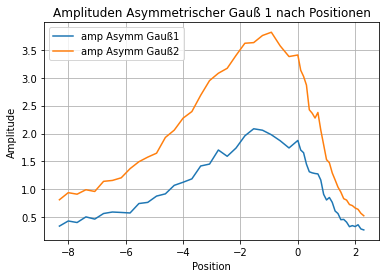

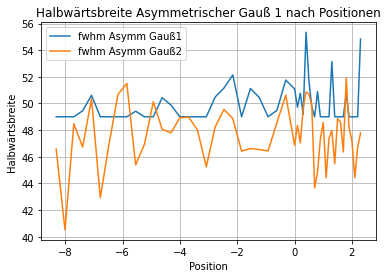

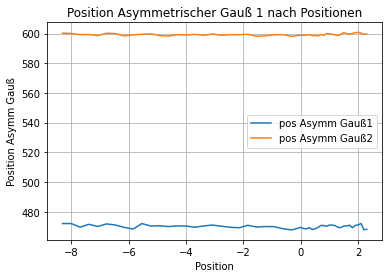

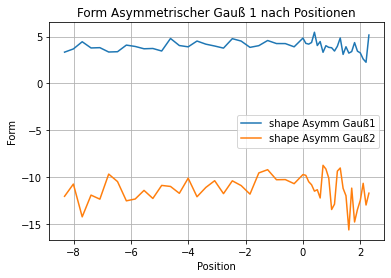

---------------------------------------------------------------------------------


In [13]:
# Verhalten Asymmetrischer Gauß und Baseline
# mittlung der Asymm Gauß parameter und abweichungen

print("asymm gauß 1")
Positionen=[]
Asymm_Gauß_1_Liste_Amp=[]
Asymm_Gauß_1_Liste_fwhm=[]
Asymm_Gauß_1_Liste_pos=[]
Asymm_Gauß_1_Liste_shape=[]
for i in range(len(Asymm_Gauß_1_Liste)):
    Positionen.append(Asymm_Gauß_1_Liste[i][0])
    Asymm_Gauß_1_Liste_Amp.append(Asymm_Gauß_1_Liste[i][1][0])
    Asymm_Gauß_1_Liste_fwhm.append(Asymm_Gauß_1_Liste[i][1][1])
    Asymm_Gauß_1_Liste_pos.append(Asymm_Gauß_1_Liste[i][1][2])
    Asymm_Gauß_1_Liste_shape.append(Asymm_Gauß_1_Liste[i][1][3])
    
#print("Asymmetrischer Gauß 1 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_Amp), "\nMin: ", min(Asymm_Gauß_1_Liste_Amp))

#print("Asymmetrischer Gauß 1 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_1_Liste_fwhm))

#print("Asymmetrischer Gauß 1 Position:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_pos), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_pos), "\nMin: ", min(Asymm_Gauß_1_Liste_pos))

#print("Asymmetrischer Gauß 1 Form:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_shape), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_shape), "\nMin: ", min(Asymm_Gauß_1_Liste_shape))

print("asymm gauß 2")
Positionen=[]
Asymm_Gauß_2_Liste_Amp=[]
Asymm_Gauß_2_Liste_fwhm=[]
Asymm_Gauß_2_Liste_pos=[]
Asymm_Gauß_2_Liste_shape=[]
for j in range(len(Asymm_Gauß_2_Liste)):
    Positionen.append(Asymm_Gauß_2_Liste[j][0])
    Asymm_Gauß_2_Liste_Amp.append(Asymm_Gauß_2_Liste[j][1][0])
    Asymm_Gauß_2_Liste_fwhm.append(Asymm_Gauß_2_Liste[j][1][1])
    Asymm_Gauß_2_Liste_pos.append(Asymm_Gauß_2_Liste[j][1][2])
    Asymm_Gauß_2_Liste_shape.append(Asymm_Gauß_2_Liste[j][1][3])
    
#print("Asymmetrischer Gauß 2 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_2_Liste_Amp), "\nMin: ", min(Asymm_Gauß_2_Liste_Amp))

#print("Asymmetrischer Gauß 2 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_2_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_2_Liste_fwhm))

#print("Asymmetrischer Gauß 2 Position:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_pos), 
 #     "\nMax: ", max(Asymm_Gauß_2_Liste_pos), "\nMin: ", min(Asymm_Gauß_2_Liste_pos))

#print("Asymmetrischer Gauß 2 Form:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_shape), 
 #     "\nMax: ", max(Asymm_Gauß_2_Liste_shape), "\nMin: ", min(Asymm_Gauß_2_Liste_shape))
    
    
#Plotten
plt.title('Amplituden Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_Amp ,markersize=2, label='amp Asymm Gauß1') 
plt.plot(Positionen, Asymm_Gauß_2_Liste_Amp ,markersize=2, label='amp Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Halbwärtsbreite Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß1') 
plt.plot(Positionen, Asymm_Gauß_2_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Halbwärtsbreite')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Position Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_pos ,markersize=2, label='pos Asymm Gauß1')
plt.plot(Positionen, Asymm_Gauß_2_Liste_pos ,markersize=2, label='pos Asymm Gauß2')
plt.xlabel('Position')
plt.ylabel('Position Asymm Gauß')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Form Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_shape ,markersize=2, label='shape Asymm Gauß1') 
plt.plot(Positionen, Asymm_Gauß_2_Liste_shape ,markersize=2, label='shape Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Form')
plt.grid(True)
plt.legend()
plt.show()

#---------------------------------------------------------------------------------
print("---------------------------------------------------------------------------------")
#---------------------------------------------------------------------------------

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
#    Base_Para_3.append(Baseline_Liste[k][1][2])
 #   Base_Para_4.append(Baseline_Liste[k][1][3])
 #   Base_Para_5.append(Baseline_Liste[k][1][4])
 #   Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [-3.59866054e+10 -1.08002483e+09  1.27594225e+10  1.17617989e+10
  4.75285307e+00]
Asym Gauß LO Parameter Amp-R: [ 1.00000000e+00 -2.48017305e+09 -1.17244544e+10  7.86576915e+09
  8.31489919e+00]
Gauß E2 Parameter Amp-R: [ 2.41565036e+01  1.78899861e-01 -6.11736150e+02  4.75297861e+00]
Gauß LO Parameter Amp-R: [-6.48573366 -2.48051001 -7.55741784  9.42178035]


c:\users\f.h\appdata\local\programs\python\python39\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


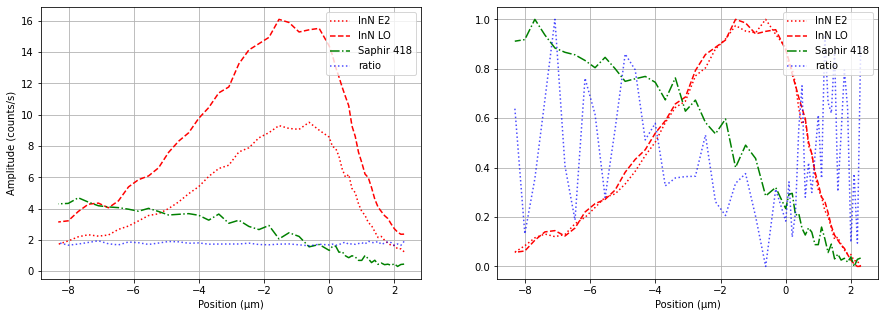

<Figure size 1080x1080 with 0 Axes>

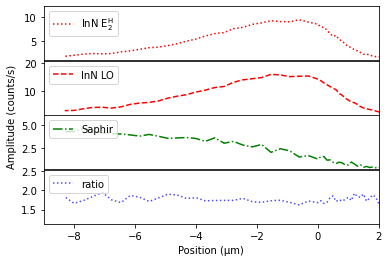

In [14]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_Saphir_418_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])
 
    
Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    

#Fitten Asym Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,-13,-0.8,2]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,-13,-0.8,1]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 

    
    
#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,-13,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,-13,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 
    
    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
#plt.title('Amplituden Peaks 532nm nach Positionen MEPA D1')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_Amp,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp, ':', alpha=0.7, color='b'  ,markersize=2, label='ratio') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='InN E2 Fitt Asym')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='InN LO Fitt Asym')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.annotate('InN',xy=(fitParams_G_E2[2],0), xytext=(fitParams_G_E2[2],0))
#plt.annotate('Saphir',xy=(fitParams_G_E2[2]-fitParams_G_E2[1],0), xytext=(fitParams_G_E2[2]-fitParams_G_E2[1],0))
#plt.text(x=fitParams_G_E2[2],y=0,s='InN')
#plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.xlabel('Position (\u03bcm)')
plt.ylabel('Amplitude (counts/s)')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
#plt.title('Amplituden Peaks 532nm nach Positionen Normiert MEPA D1')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2, label='ratio') #, markerfacecolor='w', alpha=0.5

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=0,s='InN')
#plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.xlabel('Position (\u03bcm)')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

#plt.savefig('Bilder_Graphen_532nm/MEPA Amplituden Peaks nach Positionen D1 532nm')
plt.show()



fig = plt.figure(figsize=(15,15))
fig, axs = plt.subplots(4)
#ax = fig.add_subplot(111)

axs[0].plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN $\mathregular{E_2^H}$') #, markerfacecolor='w', alpha=0.5
axs[0].legend(loc='upper left')
axs[0].get_xaxis().set_ticks([])
axs[0].set_xlim([-9, 2])
axs[0].set_ylim([min(Peak_InN_E2_Amp)*0.7, max(Peak_InN_E2_Amp)*1.3])

axs[1].plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
axs[1].legend(loc='upper left')
axs[1].get_xaxis().set_ticks([])
axs[1].set_xlim([-9, 2])
axs[1].set_ylim([min(Peak_InN_LO_Amp)*0.7, max(Peak_InN_LO_Amp)*1.3])

#axs[2].set(ylabel='Amplitude (counts/s)')
axs[2].plot(Positionen, Peak_Saphir_418_Amp,'-.', color='g'  ,markersize=2, label='Saphir') #, markerfacecolor='w', alpha=0.5
axs[2].legend(loc='upper left')
axs[2].get_xaxis().set_ticks([])
axs[2].set_xlim([-9, 2])
axs[2].set_ylim([min(Peak_Saphir_418_Amp)*0.7, max(Peak_Saphir_418_Amp)*1.3])

axs[3].plot(Positionen, Verhältnis_InN_LO_E2_Amp, ':', alpha=0.7, color='b'  ,markersize=2, label='ratio') #, markerfacecolor='w', alpha=0.5
axs[3].legend(loc='upper left')
axs[3].set(xlabel='Position (\u03bcm)')
axs[3].set_xlim([-9, 2])
axs[3].set_ylim([min(Verhältnis_InN_LO_E2_Amp)*0.7, max(Verhältnis_InN_LO_E2_Amp)*1.3])

#plt.axvline(x=4, ymin=0, ymax=0.1, color='gray')
#plt.axvline(x=2.6, ymin=0, ymax=0.1, color='gray')
#axs[3].text(6.1,0, 'textstr')
plt.subplots_adjust(wspace=0.1, hspace=0.01)
fig.text(0.04, 0.5, 'Amplitude (counts/s)', va='center', rotation='vertical')
plt.savefig('Bilder_Graphen_532nm/MEPA Amplituden Peaks nach Positionen D1 532nm')
plt.show()

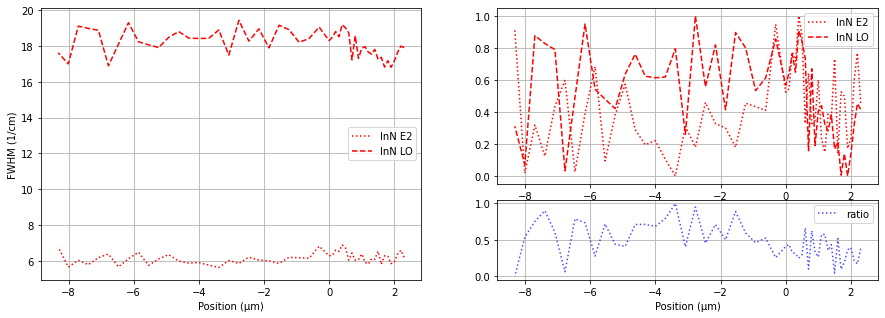

In [15]:
# Halbwärtsbreiten fwhm nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_Saphir_418_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
    
#Plotten
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position (\u03bcm)')
plt.ylabel('FWHM (1/cm)')
plt.grid(True)
plt.legend(loc='center right')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm)-0.5,s='InN')
#ax1.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_InN_E2_fwhm)-0.5,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
#ax1.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen MEPA D1")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax2.text(x=fitParams_G_E2[2],y=0,s='InN')
#ax2.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

#ax2.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen Normiert MEPA D1")
ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='ratio') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position (\u03bcm)')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.text(x=fitParams_G_E2[2],y=0,s='InN')
#ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.savefig('Bilder_Graphen_532nm/MEPA Halbwärtsbreite fwhm Peaks nach Positionen D1 532nm')
plt.show()

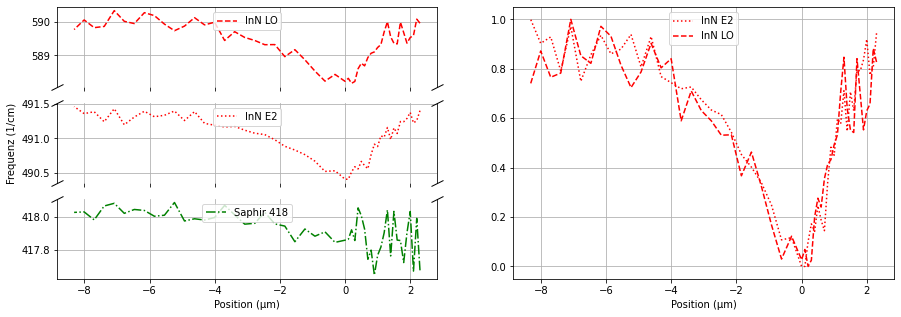

In [16]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_Saphir_418_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
 
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_Saphir_418_w,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5

#ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_w),s='InN')
#ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_Saphir_418_w),s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz (1/cm)')
ax3.set_xlabel('Position (\u03bcm)')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
#ax1.set_title("Raman-Frequenz 532nm Peaks nach Positionen MEPA D1")



# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_w),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position (\u03bcm)')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
#ax4.set_title("Raman-Frequenz 532nm Peaks nach Positionen Normiert MEPA D1")
#ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax4.text(x=fitParams_G_E2[2],y=0,s='InN')
#ax4.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.savefig('Bilder_Graphen_532nm/MEPA Raman-Frequenz Peaks nach Positionen D1 532nm')
plt.show()






# Filename to write
filename = "frequenz_data_MEPA_Positionen.txt"
# Open the file with writing permission
myfile = open(filename, 'w')
# Write a line to the file
for pos in Positionen:
    myfile.write(str(pos)+"\n")#Peak_InN_E2_w
# Close the file
myfile.close()


# Filename to write
filename = "frequenz_data_MEPA.txt"
# Open the file with writing permission
myfile = open(filename, 'w')
# Write a line to the file
for w in Peak_InN_E2_w:
    myfile.write(str(w)+"\n")#Peak_InN_E2_w
# Close the file
myfile.close()

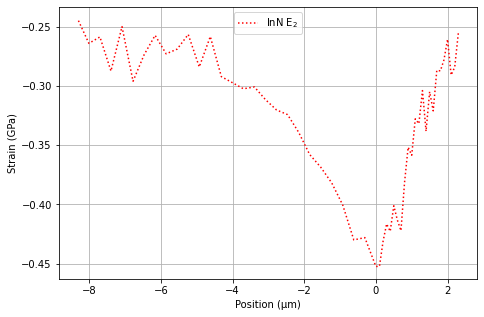

In [17]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
#plt.title('Strain InN 532nm nach Positionen MEPA D1')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN $\mathregular{E_2}$') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')
#plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Strain_InN_E2_Liste),s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
plt.xlabel('Position (\u03bcm)')
plt.ylabel('Strain (GPa)')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_532nm/MEPA Strain nach Positionen D1 532nm')
plt.show()

# MEPA Messung ohne Filter

Probenoberfläche vor Messung
<img src="Daten/MEPA_InN_Oberfläche_1a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten/MEPA_InN_Oberfläche_1b.jpg" style="width:300px;"/>

## Datenladen MEPA D0

In [35]:
#Path zu daten definieren
path = "./Daten//"  

In [36]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "InN MEPA 1242_2x60s_Bild1.txt") as f1:
        data_MEPA_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MEPA_array_str = np.array(data_MEPA_txt)               #in np array umwandeln um listen von listen zu entkommen
data_MEPA_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MEPA_array_float = data_MEPA_array_str.astype(float)   #str zu float in Arrayform
print(data_MEPA_array_float)

[[  0.      795.45685 794.98438 ... 294.03482 293.52521 293.01349]
 [-10.       10.6394   10.6404  ...   9.0886    9.13068   9.18228]
 [-10.1      10.913    10.951   ...   9.51881   9.4776    9.43683]
 ...
 [-16.8       9.55985   9.52779 ...   7.97717   7.98513   7.99217]
 [-16.9       9.21469   9.20016 ...   7.53597   7.50555   7.478  ]
 [-17.        8.50244   8.57358 ...   7.3226    7.30742   7.27603]]


## Fitten und Plotten MEPA D0 

Position: -10.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [10.6394  10.6404  10.6096  ...  9.0886   9.13068  9.18228]
Hintergrund Parameter:  [-2.61699024e-12  7.67607036e-09 -8.63131081e-06  4.61042165e-03
 -1.15791748e+00  1.18893421e+02]
Fitparameter Saphir 418: [6.7778414485605625, 1.8541335087164117, 426.79725382282516]
Fitparameter InN E2: [5.783930547435857, 8.83448039895635, 498.4596938927936]
Fitparameter InN LO: [15.583864629643891, 19.12480747707765, 597.4806033671067]
Fitparameter Asymmetrischer Gauß 1:  [5.893611120706146, 38.86636190550863, 524.828257261647, 0.05619258750243175]
Fitparameter Asymmetrischer Gauß 2:  [6.5434105850529285, 18.337341135307643, 580.3211657648507, 0.011442637477933261]


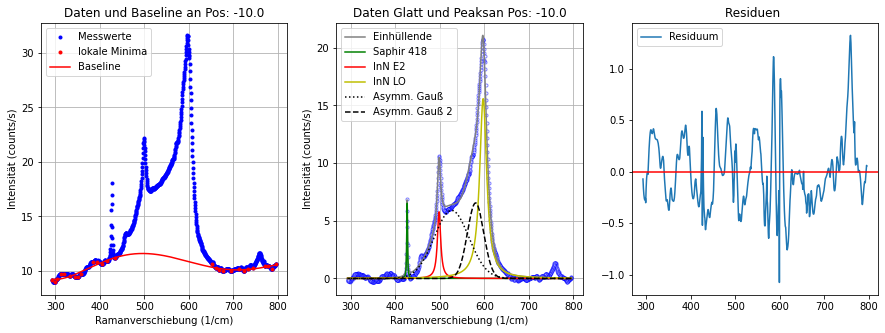

----------------------------------------------------------------------------------------------------
Position: -10.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [10.913   10.951   10.9551  ...  9.51881  9.4776   9.43683]
Hintergrund Parameter:  [-2.13048317e-12  6.48256886e-09 -7.52112218e-06  4.12092040e-03
 -1.05457291e+00  1.10907501e+02]
Fitparameter Saphir 418: [7.510997553792994, 1.7535737591496001, 426.64614981986165]
Fitparameter InN E2: [5.9359182484885515, 8.34334179712163, 498.5415952545063]
Fitparameter InN LO: [15.726055330986306, 17.9396522328724, 597.5760138677517]
Fitparameter Asymmetrischer Gauß 1:  [6.00805865434603, 38.47531604513245, 526.8443567663029, 0.015638361075317048]
Fitparameter Asymmetrischer Gauß 2:  [7.220154881683573, 18.02108570781709, 581.3937452464057, 0.01822226171953848]
BILD an Pos:  -10.1


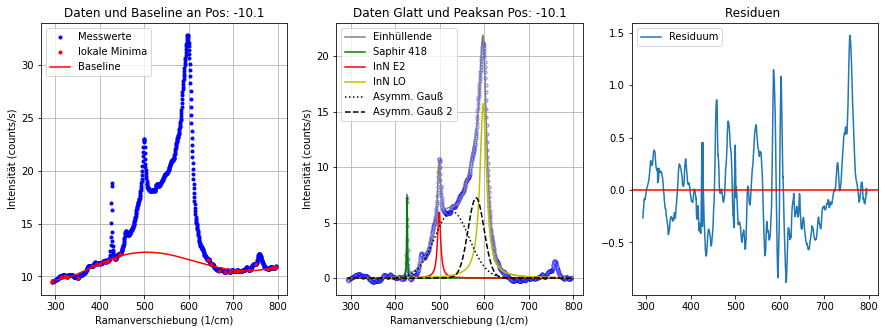

----------------------------------------------------------------------------------------------------
Position: -10.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [11.179   11.1456  11.1161  ...  9.62066  9.63664  9.65922]
Hintergrund Parameter:  [-4.50276216e-12  1.26034644e-08 -1.36053037e-05  7.03012814e-03
 -1.72500896e+00  1.70755969e+02]
Fitparameter Saphir 418: [7.391955721659973, 1.801930310289878, 426.7566663368062]
Fitparameter InN E2: [6.019227987603918, 9.433703555415429, 498.4457371815787]
Fitparameter InN LO: [17.035516688711304, 19.956125155723672, 597.493641973143]
Fitparameter Asymmetrischer Gauß 1:  [6.544670458563191, 39.57732370734364, 525.7548919292835, 0.05631341486009701]
Fitparameter Asymmetrischer Gauß 2:  [6.801293698512824, 18.260714658599497, 579.7137729490955, 0.003995140149733534]


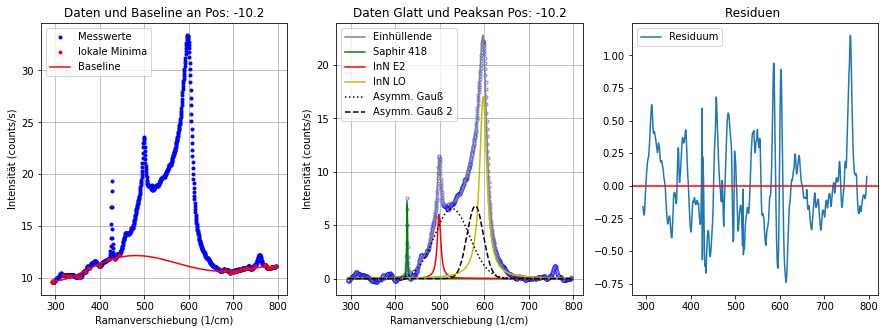

----------------------------------------------------------------------------------------------------
Position: -10.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [11.5665 11.591  11.6064 ... 10.1014 10.0906 10.1254]
Hintergrund Parameter:  [-2.98287872e-12  8.76339583e-09 -9.87832184e-06  5.28955301e-03
 -1.33018580e+00  1.36231244e+02]
Fitparameter Saphir 418: [7.535417485626509, 1.8151584227879214, 426.74533182577096]
Fitparameter InN E2: [6.1203299492073695, 9.360762184552554, 498.2191667061082]
Fitparameter InN LO: [17.15674012361413, 18.529168349497603, 597.5052947933063]
Fitparameter Asymmetrischer Gauß 1:  [6.580250916849204, 38.42644086399257, 525.1930514711989, 0.04339923915471701]
Fitparameter Asymmetrischer Gauß 2:  [7.765389767175049, 18.2700203795361, 580.7175979769236, 0.010347788967053203]


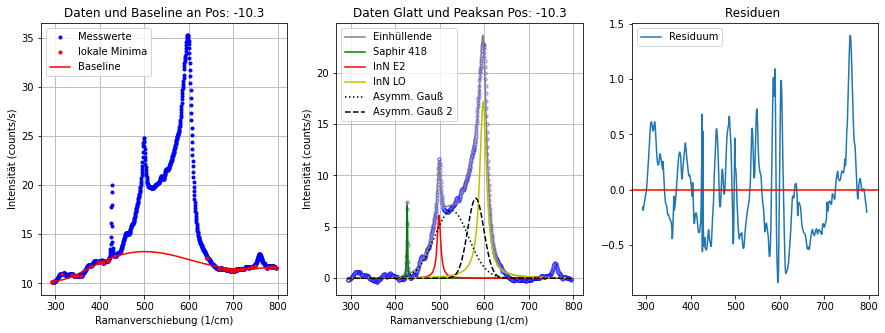

----------------------------------------------------------------------------------------------------
Position: -10.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [12.1201 12.0404 11.9918 ... 10.4584 10.3176 10.3144]
Hintergrund Parameter:  [-4.67730026e-12  1.28046436e-08 -1.34886649e-05  6.77785572e-03
 -1.60831029e+00  1.54827020e+02]
Fitparameter Saphir 418: [8.704502072902148, 1.7035731636312712, 426.70329557101024]
Fitparameter InN E2: [6.432946783636026, 8.97552079511485, 498.4568322522342]
Fitparameter InN LO: [18.71631379145081, 20.93308593437972, 597.1980346950394]
Fitparameter Asymmetrischer Gauß 1:  [6.948258095683359, 40.81562613221381, 512.4743644098172, 0.3874876037629019]
Fitparameter Asymmetrischer Gauß 2:  [7.671968913372336, 19.51254863663648, 578.197015285419, 0.004151171180055863]


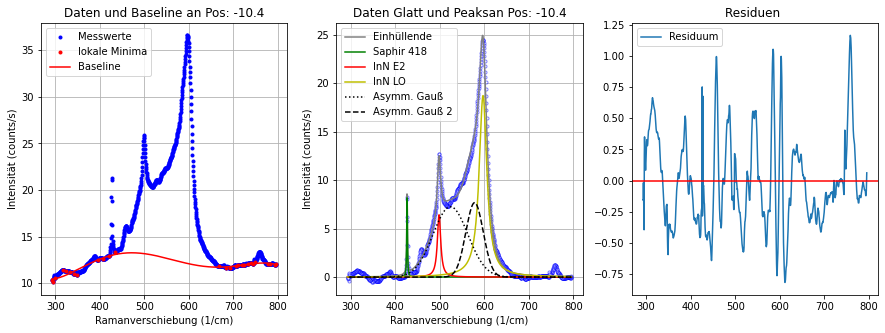

----------------------------------------------------------------------------------------------------
Position: -10.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [12.6256 12.6045 12.5826 ... 10.8097 10.7407 10.6153]
Hintergrund Parameter:  [-2.41499678e-12  7.22407274e-09 -8.22972989e-06  4.41352548e-03
 -1.09843611e+00  1.12767485e+02]
Fitparameter Saphir 418: [8.654141644475098, 1.8423974428575403, 426.7087816165472]
Fitparameter InN E2: [5.9897828553256565, 10.577899067070815, 498.24107525650555]
Fitparameter InN LO: [18.275378654485717, 18.868539064577252, 597.5147021277636]
Fitparameter Asymmetrischer Gauß 1:  [7.149979311642365, 38.77990129698316, 525.0521817613595, 0.05456268048573155]
Fitparameter Asymmetrischer Gauß 2:  [8.33751967972298, 18.40451813288379, 580.5288804969417, 0.006460465021973138]


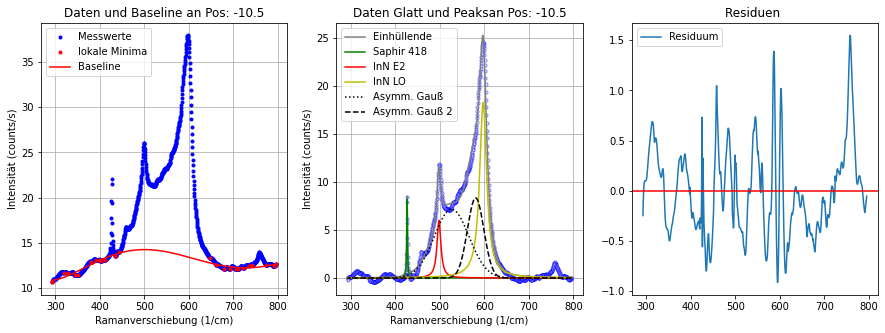

----------------------------------------------------------------------------------------------------
Position: -10.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [12.9258 12.9364 12.9246 ... 11.1985 11.2018 11.198 ]
Hintergrund Parameter:  [-5.17648882e-12  1.44950105e-08 -1.56438760e-05  8.06915283e-03
 -1.97060741e+00  1.93850286e+02]
Fitparameter Saphir 418: [9.1284239073613, 1.7115080593486387, 426.77917989586524]
Fitparameter InN E2: [6.329955169688229, 9.529843035958251, 498.2078286681505]
Fitparameter InN LO: [19.700467827455235, 20.68323362666716, 597.1681727245358]
Fitparameter Asymmetrischer Gauß 1:  [7.1108968911587995, 40.39381269522914, 510.94928403122714, 0.479278650728493]
Fitparameter Asymmetrischer Gauß 2:  [8.31532955398881, 19.449401275569777, 578.573696541248, 0.004919909890849479]


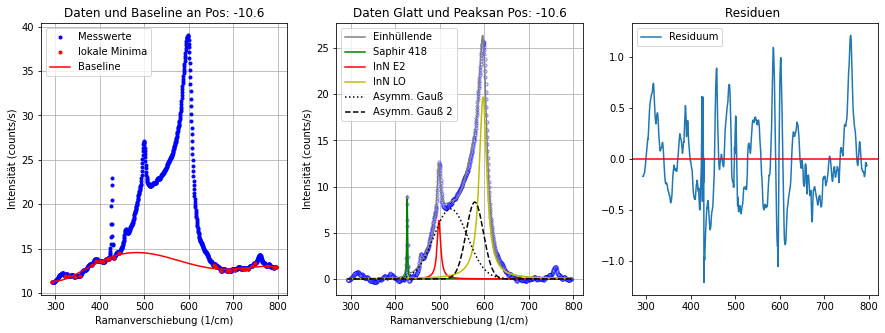

----------------------------------------------------------------------------------------------------
Position: -10.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [13.4867 13.4131 13.3895 ... 11.7765 11.7945 11.8228]
Hintergrund Parameter:  [-4.55498779e-12  1.28447322e-08 -1.39410205e-05  7.21302599e-03
 -1.75987318e+00  1.74196386e+02]
Fitparameter Saphir 418: [9.145539652121236, 1.7407755535110254, 426.66586306199844]
Fitparameter InN E2: [6.62850229197385, 9.66031042980935, 498.4226134258412]
Fitparameter InN LO: [20.785529607148955, 20.853362921946786, 597.088166581927]
Fitparameter Asymmetrischer Gauß 1:  [7.996825821505437, 37.828781181517975, 521.2702962781044, 0.08048962444381699]
Fitparameter Asymmetrischer Gauß 2:  [8.754415730780845, 19.47936199672089, 577.9630462642818, 0.013181801685550394]


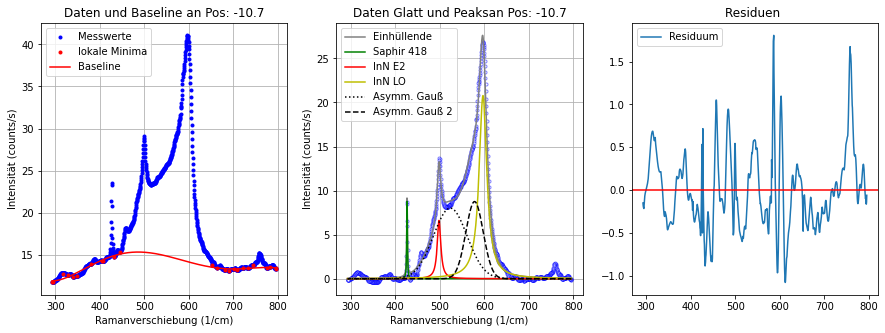

----------------------------------------------------------------------------------------------------
Position: -10.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [14.8028 14.6122 14.6325 ... 12.9378 12.9396 12.9885]
Hintergrund Parameter:  [-4.60569855e-12  1.33821282e-08 -1.49562213e-05  7.96240415e-03
 -1.99728234e+00  2.02157857e+02]
Fitparameter Saphir 418: [9.480967469529638, 1.8543013817691716, 426.73052803594095]
Fitparameter InN E2: [6.797163399844516, 9.455190066221142, 498.25063953905914]
Fitparameter InN LO: [21.22184936790743, 19.294424732116294, 597.2722245098311]
Fitparameter Asymmetrischer Gauß 1:  [8.369038937137386, 37.92374866577729, 523.8878261730541, 0.00034679519780985986]
Fitparameter Asymmetrischer Gauß 2:  [10.109936981924633, 19.183027691112986, 579.2910362433848, 0.01781788193736483]


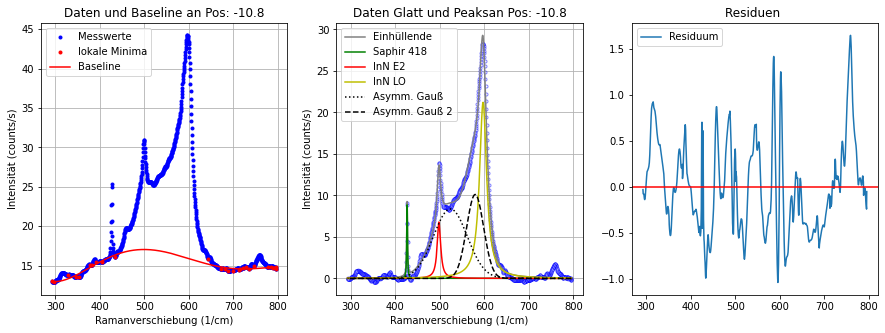

----------------------------------------------------------------------------------------------------
Position: -10.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [15.7276 15.6612 15.6382 ... 13.7122 13.7113 13.7297]
Hintergrund Parameter:  [-5.01113368e-12  1.45337163e-08 -1.62255260e-05  8.64024473e-03
 -2.17240725e+00  2.20399353e+02]
Fitparameter Saphir 418: [10.786304699402987, 1.8929409193124778, 426.67443447543184]
Fitparameter InN E2: [7.585524338302036, 9.662882781638206, 498.2731932181144]
Fitparameter InN LO: [22.143793995368217, 19.48530780311781, 597.3890326661766]
Fitparameter Asymmetrischer Gauß 1:  [9.258772793134657, 39.13252190344953, 523.5438784400493, 0.05715005330883989]
Fitparameter Asymmetrischer Gauß 2:  [10.817703860689187, 18.6682005290628, 580.120371772268, 0.006301131745589831]


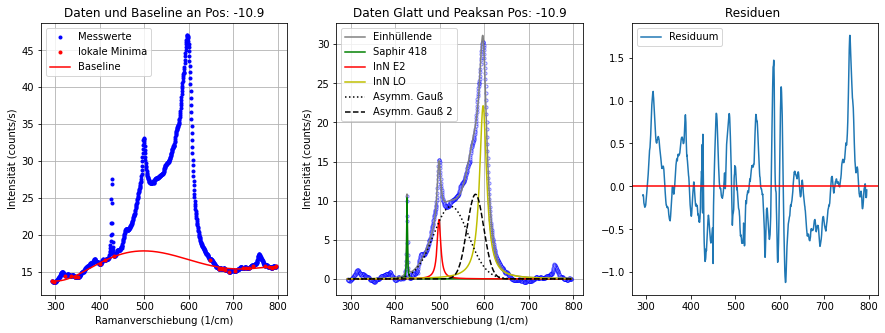

----------------------------------------------------------------------------------------------------
Position: -11.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [16.8398 16.8915 16.9218 ... 14.6761 14.6576 14.6351]
Hintergrund Parameter:  [-7.58473416e-12  2.14040578e-08 -2.33103854e-05  1.21532740e-02
 -3.00774249e+00  2.98042330e+02]
Fitparameter Saphir 418: [11.578372601579517, 1.6879194026194215, 426.7010378456129]
Fitparameter InN E2: [7.7267232840379885, 8.951068574252304, 498.2303925498796]
Fitparameter InN LO: [24.8958554334835, 21.366581143730002, 596.9576108438056]
Fitparameter Asymmetrischer Gauß 1:  [8.48082267413377, 42.567026650808636, 502.38639345045374, 0.7505605013197489]
Fitparameter Asymmetrischer Gauß 2:  [11.175946473521151, 19.859309564475126, 577.5914369322057, 0.0073148222170387875]


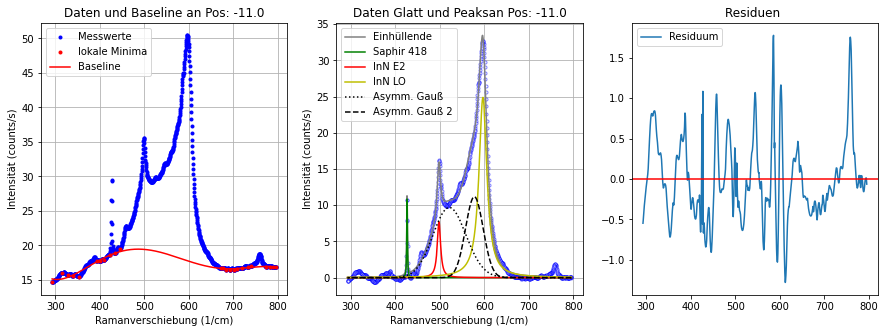

----------------------------------------------------------------------------------------------------
Position: -11.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [17.5389 17.6092 17.657  ... 15.2677 15.261  15.2427]
Hintergrund Parameter:  [-8.67692701e-12  2.39366860e-08 -2.54645273e-05  1.29601024e-02
 -3.12885824e+00  3.02660442e+02]
Fitparameter Saphir 418: [11.688424841943053, 1.8243599146693594, 426.69720071724913]
Fitparameter InN E2: [7.836907354967355, 8.462409808914193, 498.23213089531623]
Fitparameter InN LO: [28.00172242302921, 22.59863365810269, 596.7518874376821]
Fitparameter Asymmetrischer Gauß 1:  [9.289103709774512, 39.878318998005, 500.00000197764393, 0.7081474429732477]
Fitparameter Asymmetrischer Gauß 2:  [12.081534108611338, 20.97221833368483, 574.6927403122862, 0.0030679717587842777]


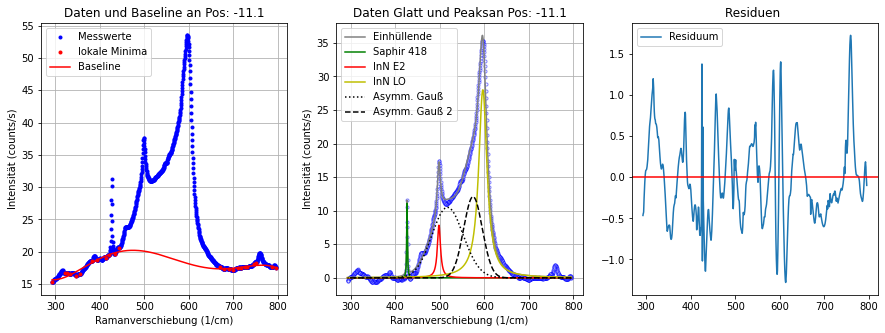

----------------------------------------------------------------------------------------------------
Position: -11.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [19.1421 19.0844 19.0404 ... 16.366  16.4027 16.436 ]
Hintergrund Parameter:  [-6.59248641e-12  1.86491252e-08 -2.02989784e-05  1.05340447e-02
 -2.57972095e+00  2.55513893e+02]
Fitparameter Saphir 418: [13.179489301698291, 1.67898203314416, 426.6974707657505]
Fitparameter InN E2: [8.430003676277586, 10.65750938901382, 497.725686118071]
Fitparameter InN LO: [27.567947770295582, 21.608287626463298, 596.8655135800112]
Fitparameter Asymmetrischer Gauß 1:  [11.677914334412755, 41.083628196110155, 526.8273783999003, 0.011654582286726008]
Fitparameter Asymmetrischer Gauß 2:  [11.043444865064092, 18.54243542877273, 578.6742414799456, 1.0053220306920825e-05]


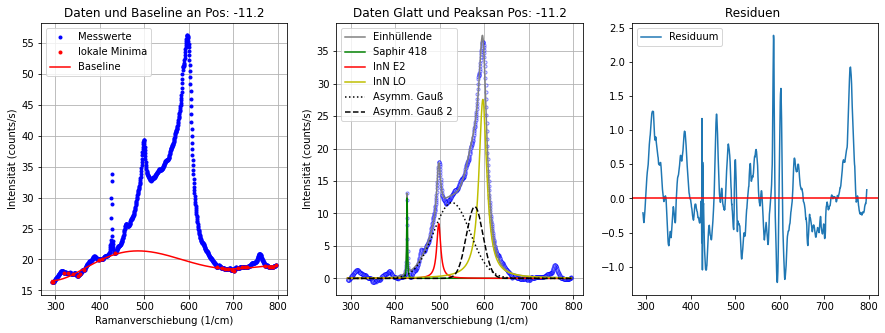

----------------------------------------------------------------------------------------------------
Position: -11.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [20.8674 20.9159 20.898  ... 18.1319 18.0561 17.9665]
Hintergrund Parameter:  [-7.51947788e-12  2.13876294e-08 -2.33900732e-05  1.21756608e-02
 -2.98240172e+00  2.93670507e+02]
Fitparameter Saphir 418: [13.071233470477491, 1.6676706132034016, 426.6931220087972]
Fitparameter InN E2: [9.215207719600466, 11.101567138630113, 497.87975877663837]
Fitparameter InN LO: [28.88236390820069, 20.452956556550724, 596.9137321258426]
Fitparameter Asymmetrischer Gauß 1:  [11.75434272338642, 38.83973564921941, 522.4099221975612, 0.14477269774755275]
Fitparameter Asymmetrischer Gauß 2:  [13.366499090614026, 19.05675689862609, 579.361614815864, 0.00014832888401912058]


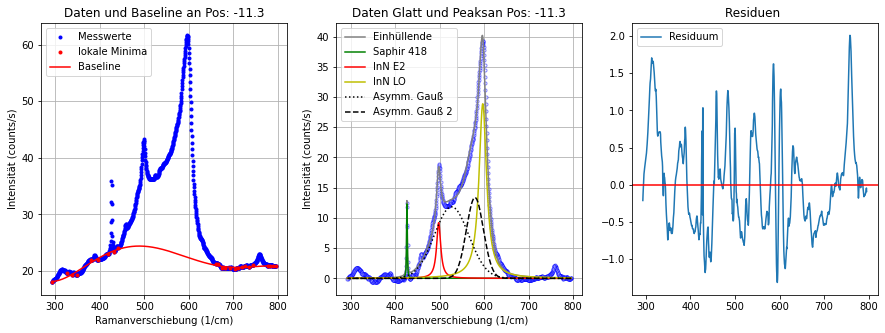

----------------------------------------------------------------------------------------------------
Position: -11.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [21.7849 21.881  21.9463 ... 19.2803 19.248  19.2116]
Hintergrund Parameter:  [-1.67297268e-12  6.74734991e-09 -9.35410719e-06  5.74636943e-03
 -1.57137555e+00  1.75791432e+02]
Fitparameter Saphir 418: [14.309901234995936, 1.7197170712671923, 426.72170120481616]
Fitparameter InN E2: [9.689565004757894, 10.562208579877481, 497.7286734608986]
Fitparameter InN LO: [27.229733282591386, 18.209843688960927, 596.9593624360266]
Fitparameter Asymmetrischer Gauß 1:  [11.660847184517802, 38.20849357022928, 525.1879266968637, 0.03261485365658268]
Fitparameter Asymmetrischer Gauß 2:  [15.493993128082858, 18.457830837848245, 581.4225343601378, 0.010142041395172843]


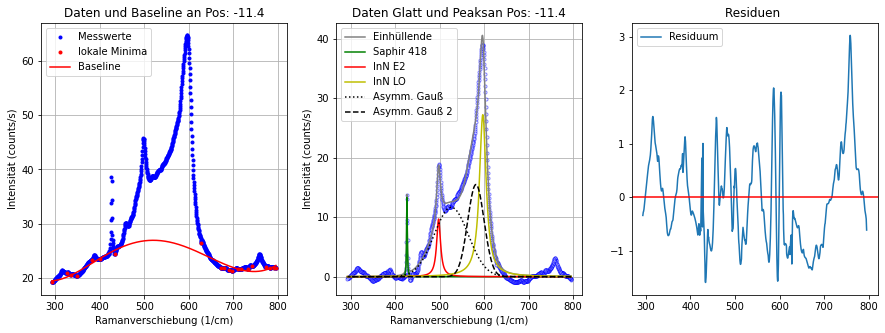

----------------------------------------------------------------------------------------------------
Position: -11.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [24.0012 23.9246 23.801  ... 21.02   20.9951 20.9168]
Hintergrund Parameter:  [-6.36247875e-12  1.82740720e-08 -2.01045768e-05  1.04775196e-02
 -2.55417132e+00  2.54992478e+02]
Fitparameter Saphir 418: [14.856995148179253, 1.840455507569804, 426.73183552173276]
Fitparameter InN E2: [10.15981068541624, 10.061377595173669, 497.6272715425349]
Fitparameter InN LO: [32.84969386724257, 21.97522800059931, 596.3770137012269]
Fitparameter Asymmetrischer Gauß 1:  [12.049362984928486, 41.63663712433232, 501.90137617147263, 0.6416325262363117]
Fitparameter Asymmetrischer Gauß 2:  [15.773138766248143, 20.984073949425305, 576.3319602499433, 0.00821169385584907]


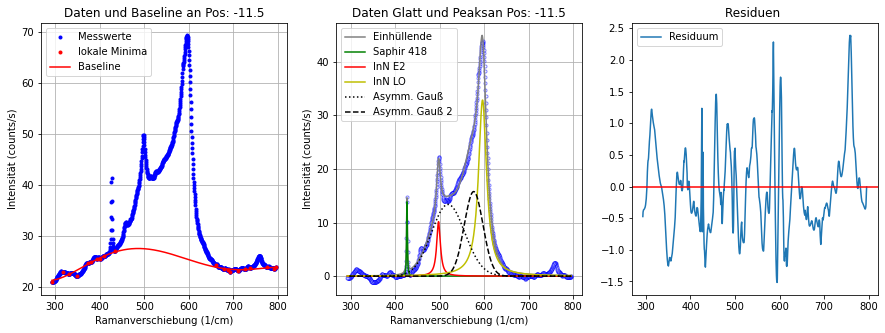

----------------------------------------------------------------------------------------------------
Position: -11.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [25.7802 25.822  25.798  ... 22.9505 22.9502 22.9408]
Hintergrund Parameter:  [-6.04130745e-12  1.80739006e-08 -2.06374204e-05  1.11217719e-02
 -2.79391318e+00  2.85970678e+02]
Fitparameter Saphir 418: [15.399250621248889, 1.7761459061804064, 426.7444658448675]
Fitparameter InN E2: [10.79024544659808, 11.472548807523543, 497.41261350284884]
Fitparameter InN LO: [33.18060854711037, 21.032681536052493, 596.2482193148431]
Fitparameter Asymmetrischer Gauß 1:  [13.977440197490962, 37.71675423050878, 520.0101641378419, 0.11187179884862589]
Fitparameter Asymmetrischer Gauß 2:  [16.369310951066474, 19.670556181075302, 578.585687102706, 0.004110482721511633]


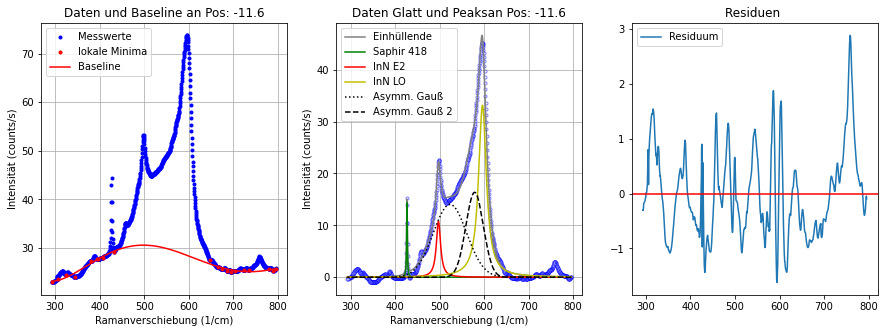

----------------------------------------------------------------------------------------------------
Position: -11.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [27.3654 27.3194 27.2688 ... 24.0562 24.0246 23.9734]
Hintergrund Parameter:  [-9.47265162e-12  2.72573752e-08 -3.01144070e-05  1.58167463e-02
 -3.90717539e+00  3.88233255e+02]
Fitparameter Saphir 418: [16.109236998686423, 1.839417448234872, 426.7084356919184]
Fitparameter InN E2: [11.123546411269157, 10.440457717961621, 497.2490028837114]
Fitparameter InN LO: [37.42234395990339, 22.938853530397424, 595.8265516919275]
Fitparameter Asymmetrischer Gauß 1:  [12.928674853142882, 40.89441317615392, 500.0000097074631, 0.7074101578252653]
Fitparameter Asymmetrischer Gauß 2:  [16.673405590089875, 20.78199476825686, 574.9805210210466, 0.00026830592309538544]


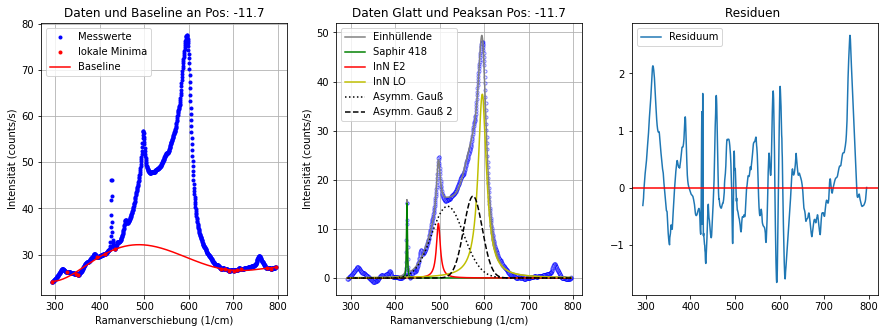

----------------------------------------------------------------------------------------------------
Position: -11.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [29.9057 30.1151 30.1809 ... 27.2338 27.1902 27.1541]
Hintergrund Parameter:  [-1.12805421e-11  3.20275471e-08 -3.49846729e-05  1.82089836e-02
 -4.47013321e+00  4.42297640e+02]
Fitparameter Saphir 418: [17.356810477411432, 1.801338569048376, 426.7844991691923]
Fitparameter InN E2: [12.20441197729077, 10.639771632990055, 497.2351297995822]
Fitparameter InN LO: [39.732944351958466, 23.675084965857863, 595.4902020173207]
Fitparameter Asymmetrischer Gauß 1:  [14.080175800201628, 40.50083253999048, 500.0000003126085, 0.6611471174734965]
Fitparameter Asymmetrischer Gauß 2:  [17.715932110277745, 21.13800314671876, 574.3372486793386, 0.0001449877051003858]


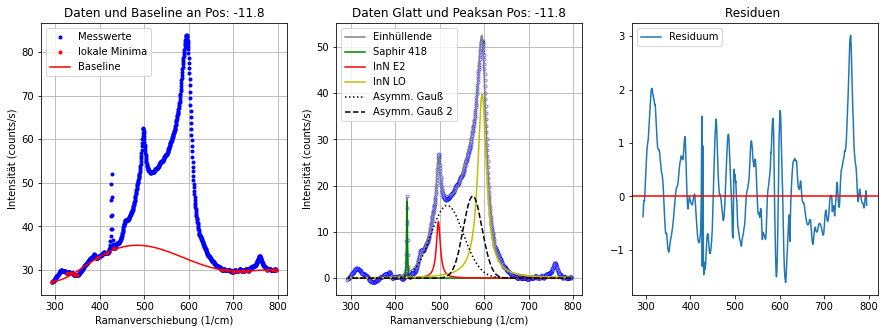

----------------------------------------------------------------------------------------------------
Position: -11.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [33.6902 33.4904 33.3555 ... 30.6202 30.6241 30.6453]
Hintergrund Parameter:  [-1.10969964e-11  3.15800737e-08 -3.45108222e-05  1.79226945e-02
 -4.37508442e+00  4.33576134e+02]
Fitparameter Saphir 418: [17.86051180528265, 1.8393019992802835, 426.69937826192734]
Fitparameter InN E2: [12.983502012943678, 11.185006079142429, 496.8383431493374]
Fitparameter InN LO: [41.82957905816576, 23.382208458708934, 595.0203203230575]
Fitparameter Asymmetrischer Gauß 1:  [15.660395149241632, 37.24705049131289, 500.0000077899139, 0.5422892676667466]
Fitparameter Asymmetrischer Gauß 2:  [20.85895583060097, 22.266070965196768, 573.58829191049, 7.745822988611445e-05]


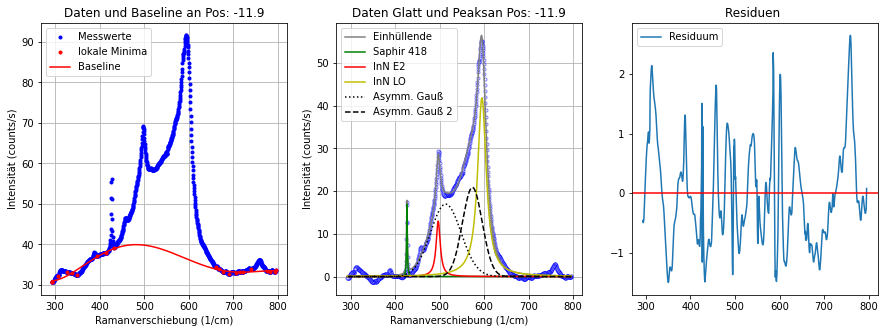

----------------------------------------------------------------------------------------------------
Position: -12.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [37.7971 37.8757 37.8912 ... 35.6682 35.6546 35.8203]
Hintergrund Parameter:  [-1.68242488e-11  4.75950516e-08 -5.18673103e-05  2.69848490e-02
 -6.64325912e+00  6.55869137e+02]
Fitparameter Saphir 418: [17.938439752141583, 1.8604693419553175, 426.65943403548994]
Fitparameter InN E2: [14.249216694911523, 10.18231827359579, 496.7861786447579]
Fitparameter InN LO: [45.13146341647741, 24.484119438405223, 594.3700138456722]
Fitparameter Asymmetrischer Gauß 1:  [17.333684521723477, 34.01618726119265, 500.0000000203649, 0.4033708587765558]
Fitparameter Asymmetrischer Gauß 2:  [23.45598251851103, 22.987830565257237, 571.3403809252284, 0.00044229193036470085]


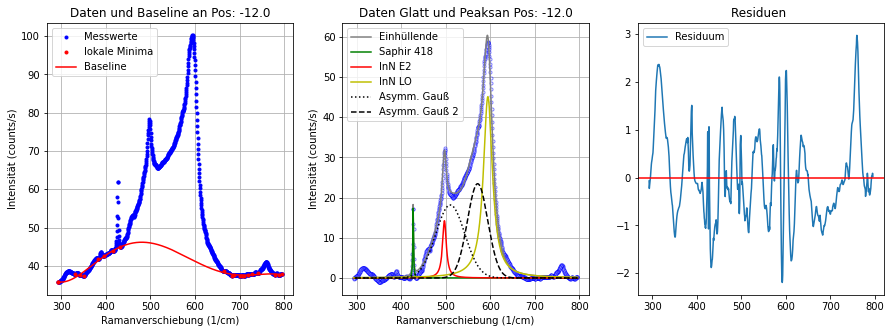

----------------------------------------------------------------------------------------------------
Position: -12.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [43.5346 43.5052 43.4748 ... 42.2013 42.3041 42.2992]
Hintergrund Parameter:  [-1.79054880e-11  4.95307869e-08 -5.27197616e-05  2.67533528e-02
 -6.41521350e+00  6.25040924e+02]
Fitparameter Saphir 418: [18.65083972251922, 1.8802632896395082, 426.66081972667024]
Fitparameter InN E2: [14.51517566294288, 10.760742349722557, 496.4124525163086]
Fitparameter InN LO: [47.72440651251293, 25.3149511786283, 593.8287651334239]
Fitparameter Asymmetrischer Gauß 1:  [19.8224099489393, 30.484825155948375, 500.00000028590216, 0.19797130552029008]
Fitparameter Asymmetrischer Gauß 2:  [27.294949436447386, 25.017680624410556, 568.7898820935441, 2.7283820328379816e-05]


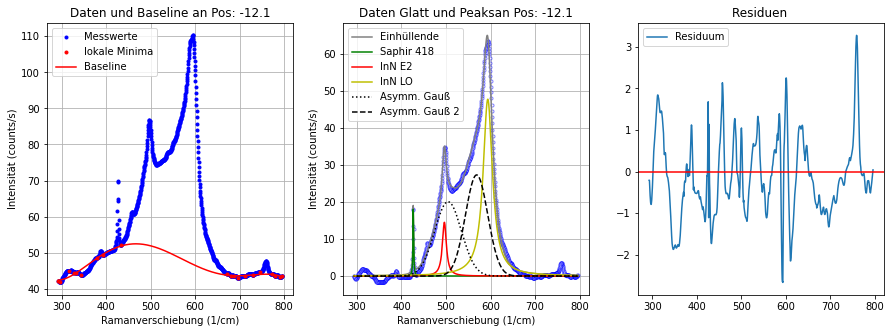

----------------------------------------------------------------------------------------------------
Position: -12.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [49.0142 48.8206 48.721  ... 48.0935 48.0003 47.9248]
Hintergrund Parameter:  [-2.00643564e-11  5.57908900e-08 -5.97007139e-05  3.04647159e-02
 -7.35107561e+00  7.21517220e+02]
Fitparameter Saphir 418: [21.075424040403067, 1.749637526749125, 426.6691826913866]
Fitparameter InN E2: [15.898977985271507, 11.348052355002636, 496.1599049979322]
Fitparameter InN LO: [50.8675578509113, 26.130693860468774, 593.1636711756488]
Fitparameter Asymmetrischer Gauß 1:  [21.755932111047116, 31.022349860929996, 500.00000000474006, 0.1877394538737958]
Fitparameter Asymmetrischer Gauß 2:  [29.266875585687508, 24.938155932189257, 568.2155248380878, 0.0019027740715251032]


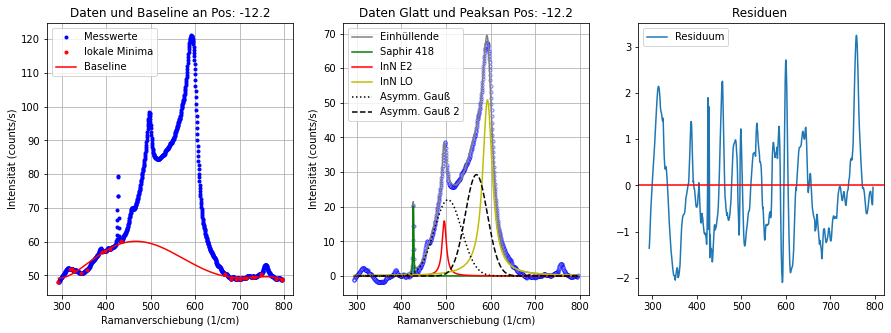

----------------------------------------------------------------------------------------------------
Position: -12.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [49.1877 49.1433 49.0439 ... 50.041  49.8704 49.542 ]
Hintergrund Parameter:  [-2.18720200e-11  6.06101417e-08 -6.46490600e-05  3.28935798e-02
 -7.91935258e+00  7.73570011e+02]
Fitparameter Saphir 418: [21.893447777896977, 2.122775997013307, 426.62038777833345]
Fitparameter InN E2: [15.992277165799988, 11.22200531265553, 496.7691616473895]
Fitparameter InN LO: [54.68373897935599, 26.933992480926516, 593.490278410322]
Fitparameter Asymmetrischer Gauß 1:  [21.36876695481791, 28.32158515767456, 500.00003893031635, 0.04950624464201933]
Fitparameter Asymmetrischer Gauß 2:  [29.75983076148477, 26.66843771906332, 565.8613458029656, 0.004812958046850093]


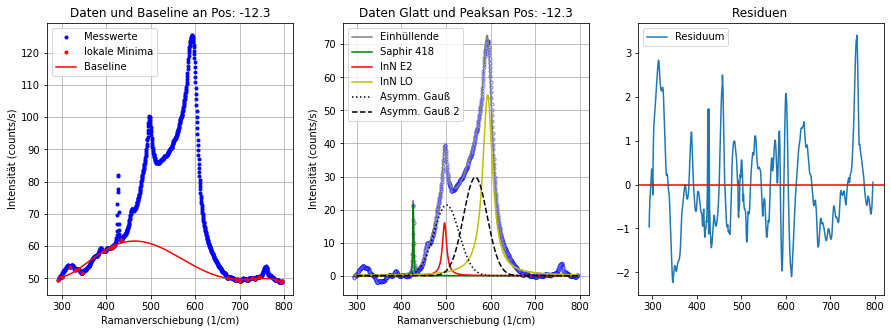

----------------------------------------------------------------------------------------------------
Position: -12.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [53.2461 53.3958 53.6365 ... 56.148  56.0463 55.9464]
Hintergrund Parameter:  [-3.03642142e-11  8.41608020e-08 -8.98966610e-05  4.58937543e-02
 -1.11203358e+01  1.08148192e+03]
Fitparameter Saphir 418: [24.451996206201017, 1.7723514435005345, 426.6446033571155]
Fitparameter InN E2: [20.47400347812413, 15.649458129482515, 495.96889072281823]
Fitparameter InN LO: [56.927991734936796, 26.36512892459497, 594.1421434063284]
Fitparameter Asymmetrischer Gauß 1:  [19.296045525608122, 54.60705665708451, 500.00000000035413, 1.1330267741553244]
Fitparameter Asymmetrischer Gauß 2:  [19.070625221091536, 19.269954534280668, 573.7716823535362, 0.011165266193253295]


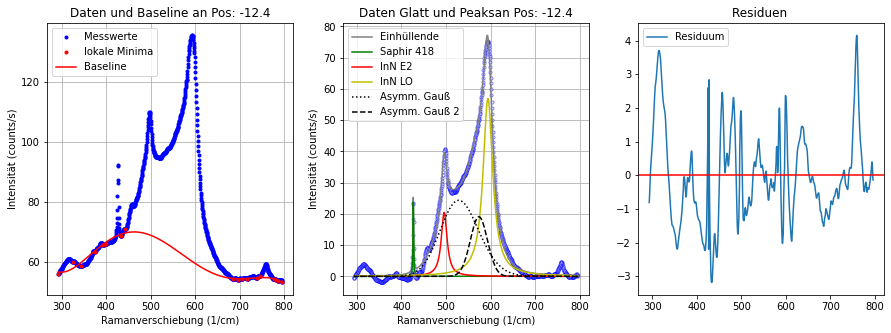

----------------------------------------------------------------------------------------------------
Position: -12.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [56.047  55.7908 55.6841 ... 59.4082 59.0668 58.3976]
Hintergrund Parameter:  [-3.50840102e-11  9.65244937e-08 -1.02308692e-04  5.18333733e-02
 -1.24714736e+01  1.20095127e+03]
Fitparameter Saphir 418: [25.80445853373367, 1.8099955646042316, 426.65421111013995]
Fitparameter InN E2: [21.06370075168233, 16.386347813963546, 496.0500236933929]
Fitparameter InN LO: [57.33185004290503, 26.173002993775935, 594.1544003743018]
Fitparameter Asymmetrischer Gauß 1:  [19.636276655430915, 60.922543959406404, 500.0000000001165, 1.3103722483818987]
Fitparameter Asymmetrischer Gauß 2:  [17.911384854818316, 18.893748698847574, 574.278863562395, 0.013019239740284193]


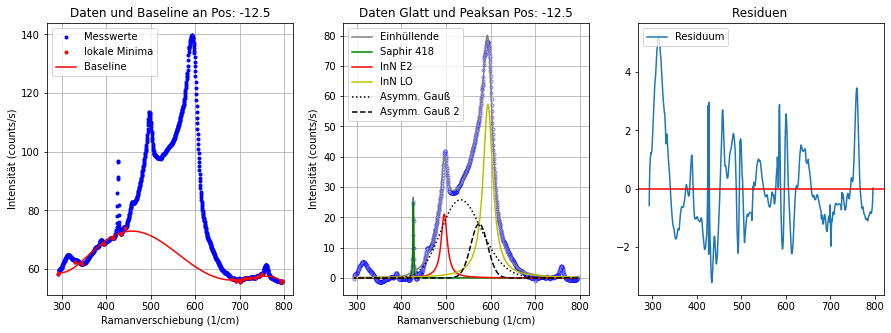

----------------------------------------------------------------------------------------------------
Position: -12.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [55.9868 56.0408 56.0221 ... 61.5672 61.5408 61.529 ]
Hintergrund Parameter:  [-3.36068525e-11  9.38675146e-08 -1.01104968e-04  5.20970951e-02
 -1.27610092e+01  1.25184168e+03]
Fitparameter Saphir 418: [28.51997902482882, 2.145320227814227, 426.6501011733672]
Fitparameter InN E2: [17.717207601494323, 11.422185510746882, 496.99753319133544]
Fitparameter InN LO: [64.40581723071014, 29.483693039696636, 593.628997711567]
Fitparameter Asymmetrischer Gauß 1:  [22.17118526428299, 28.456923957871506, 500.0000000987873, 0.15661579262318603]
Fitparameter Asymmetrischer Gauß 2:  [28.967256066564477, 24.455792757968336, 564.5499079992404, 5.202736585056345e-06]


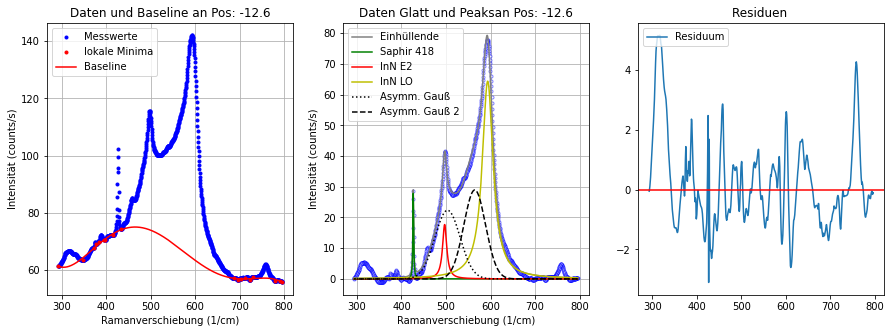

----------------------------------------------------------------------------------------------------
Position: -12.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [57.6604 57.638  57.5197 ... 63.5945 63.5256 63.4493]
Hintergrund Parameter:  [-2.58350222e-11  7.36071330e-08 -8.06666526e-05  4.21272334e-02
 -1.04077820e+01  1.03936094e+03]
Fitparameter Saphir 418: [31.341047076003488, 1.945415113325664, 426.6838696293473]
Fitparameter InN E2: [18.127671888088148, 11.587590034715967, 497.1414441433127]
Fitparameter InN LO: [60.1087362510734, 26.952102895711082, 593.8821449879042]
Fitparameter Asymmetrischer Gauß 1:  [21.349330996755384, 28.088836825628356, 500.000000015847, 0.17278896073254654]
Fitparameter Asymmetrischer Gauß 2:  [30.87659010034923, 25.393265613170747, 567.4889028716436, 0.0002167554026632689]


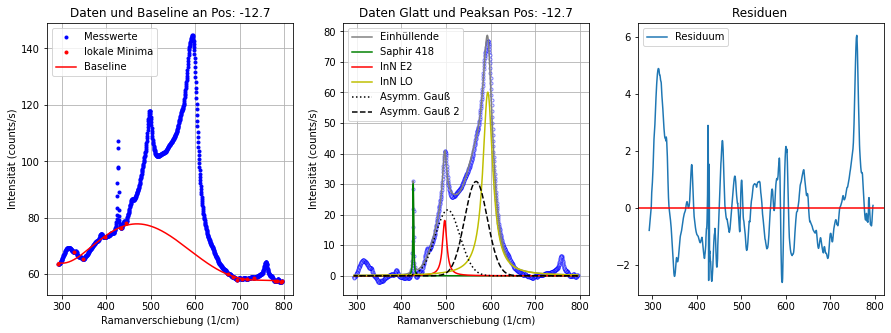

----------------------------------------------------------------------------------------------------
Position: -12.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [57.8356 57.6835 57.5942 ... 65.6186 65.5967 65.5424]
Hintergrund Parameter:  [-3.97670634e-11  1.11324576e-07 -1.20343787e-04  6.23540078e-02
 -1.53968315e+01  1.51629899e+03]
Fitparameter Saphir 418: [36.23841332290478, 2.0763735781303865, 426.6330135258211]
Fitparameter InN E2: [18.391271557602312, 12.724306222293933, 497.1134475152377]
Fitparameter InN LO: [66.18672391230484, 29.588043075676744, 593.735389505042]
Fitparameter Asymmetrischer Gauß 1:  [21.16603312815317, 28.156507227917096, 500.00000000013097, 0.19416953241469195]
Fitparameter Asymmetrischer Gauß 2:  [28.932096372642288, 24.35286696378397, 565.2971621531858, 0.00034623368287515013]


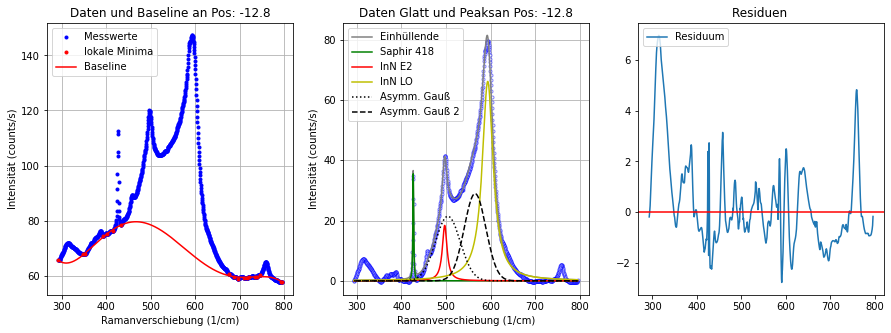

----------------------------------------------------------------------------------------------------
Position: -12.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [56.5891 56.5913 56.654  ... 64.8853 64.5838 64.1473]
Hintergrund Parameter:  [-3.74502641e-11  1.05450944e-07 -1.14601779e-04  5.96433558e-02
 -1.47754429e+01  1.45947031e+03]
Fitparameter Saphir 418: [36.452946943714394, 2.0843456116206536, 426.65034913619627]
Fitparameter InN E2: [18.814377476306092, 12.551692063318411, 497.3357434475276]
Fitparameter InN LO: [64.40954511147466, 28.615748544404344, 593.9718174387027]
Fitparameter Asymmetrischer Gauß 1:  [19.61733923233892, 27.39775066471963, 500.0000013721273, 0.17889504106525034]
Fitparameter Asymmetrischer Gauß 2:  [28.843050281472493, 24.59391593831442, 565.6569032028262, 0.0001669513008602055]


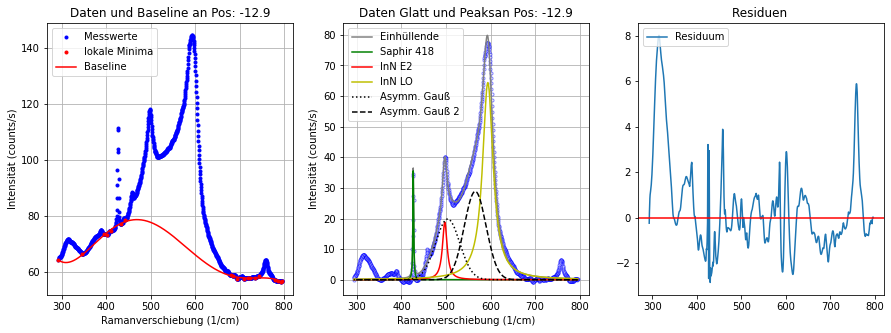

----------------------------------------------------------------------------------------------------
Position: -13.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [56.0369 55.9997 55.9681 ... 63.9987 63.744  63.5549]
Hintergrund Parameter:  [-2.33380986e-11  6.53604627e-08 -7.03746597e-05  3.60851832e-02
 -8.75154176e+00  8.69842372e+02]
Fitparameter Saphir 418: [41.18852185509558, 2.0630201493850735, 426.6466180691123]
Fitparameter InN E2: [19.557620342583558, 12.750070011023551, 497.0196806806311]
Fitparameter InN LO: [63.01217468349672, 28.651227761089025, 593.7828550790981]
Fitparameter Asymmetrischer Gauß 1:  [21.86674414601728, 29.61652674902988, 500.0000054092539, 0.18690873318642637]
Fitparameter Asymmetrischer Gauß 2:  [28.1051536554431, 24.598500277530402, 567.0418663931589, 1.3206018232759034e-05]


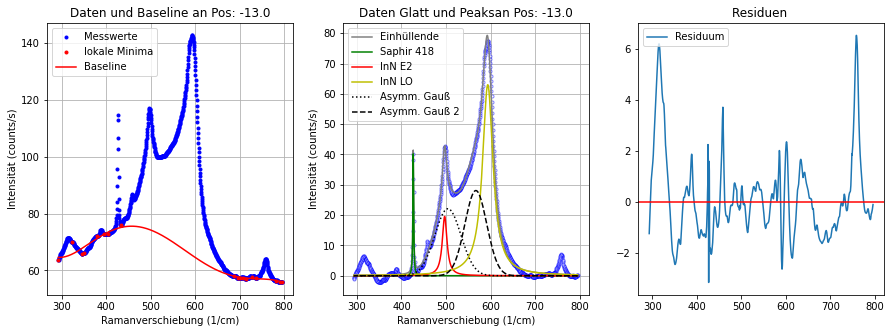

----------------------------------------------------------------------------------------------------
Position: -13.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [55.038  55.3071 55.472  ... 64.3531 64.2969 64.1642]
Hintergrund Parameter:  [-3.92339857e-11  1.09194566e-07 -1.17411782e-04  6.05502255e-02
 -1.48960650e+01  1.46389058e+03]
Fitparameter Saphir 418: [43.216357593207434, 1.9998581871723509, 426.6626303903892]
Fitparameter InN E2: [20.935149786053397, 12.85018383302657, 497.0949339932092]
Fitparameter InN LO: [68.08480113655258, 29.58090912716704, 593.3933408249638]
Fitparameter Asymmetrischer Gauß 1:  [19.621100851774155, 26.462462425061783, 502.82802781718743, 0.009127973890500025]
Fitparameter Asymmetrischer Gauß 2:  [26.714233594559584, 24.47373625317134, 563.0980057223882, 0.0028362213447555118]


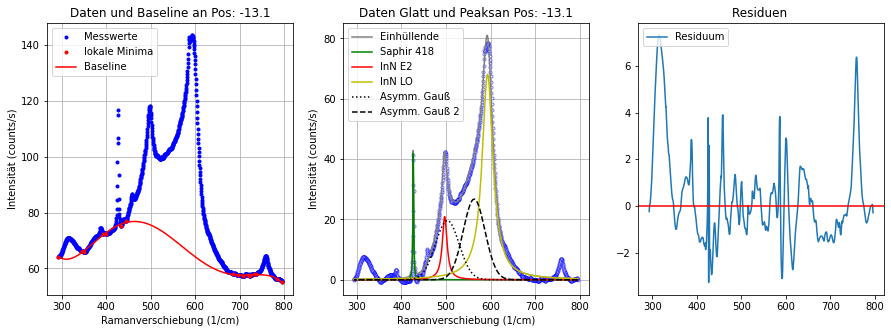

----------------------------------------------------------------------------------------------------
Position: -13.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [55.7697 55.8308 55.9352 ... 64.5935 64.4507 64.2145]
Hintergrund Parameter:  [-1.85208026e-11  5.41639683e-08 -6.08279630e-05  3.24758106e-02
 -8.18299711e+00  8.45520852e+02]
Fitparameter Saphir 418: [44.97011608998742, 2.049485359690603, 426.64623694701095]
Fitparameter InN E2: [22.593763270824212, 13.292492921861413, 496.876976277739]
Fitparameter InN LO: [60.52272467833062, 25.221389636317316, 593.7993578190602]
Fitparameter Asymmetrischer Gauß 1:  [19.793653759813292, 34.65314672145715, 500.00000062500465, 0.4633608817457773]
Fitparameter Asymmetrischer Gauß 2:  [27.52117753521489, 22.50377004645082, 573.0171395414426, 1.9885690214990095e-05]


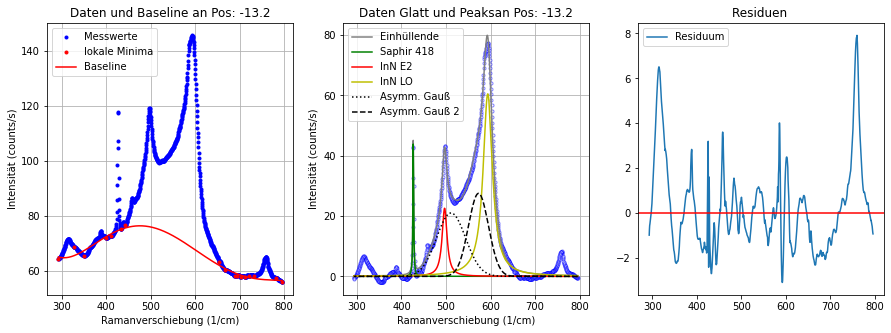

----------------------------------------------------------------------------------------------------
Position: -13.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [56.6205 56.6088 56.5783 ... 63.4897 63.4845 63.5307]
Hintergrund Parameter:  [-2.94939679e-11  8.37672539e-08 -9.18548762e-05  4.82274662e-02
 -1.20440892e+01  1.20898741e+03]
Fitparameter Saphir 418: [46.97347679153925, 2.0485402688098584, 426.64150370410624]
Fitparameter InN E2: [24.374472316641437, 12.661667950372523, 496.9264847672924]
Fitparameter InN LO: [66.84002913127145, 26.458547411460437, 593.3448062741782]
Fitparameter Asymmetrischer Gauß 1:  [19.61283242154293, 29.612570560426608, 500.0000204456953, 0.2643563636334846]
Fitparameter Asymmetrischer Gauß 2:  [27.545395749779857, 23.879565054691664, 567.622728606712, 4.34240243267722e-05]


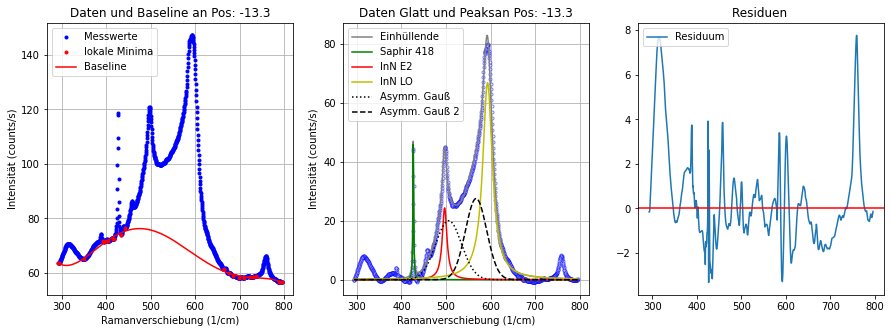

----------------------------------------------------------------------------------------------------
Position: -13.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [56.3194 56.2466 56.2156 ... 62.5648 62.2635 61.8508]
Hintergrund Parameter:  [-3.68797509e-11  1.01645424e-07 -1.08182484e-04  5.51982416e-02
 -1.34241026e+01  1.30810361e+03]
Fitparameter Saphir 418: [47.605954962554904, 1.9512275981869889, 426.6381312532926]
Fitparameter InN E2: [24.84775507104578, 11.987805041680156, 496.98280069518324]
Fitparameter InN LO: [76.28339846288932, 28.878071424034808, 593.1168571332677]
Fitparameter Asymmetrischer Gauß 1:  [21.75215956274759, 26.89525044791601, 500.00061653256284, 0.15309918687270377]
Fitparameter Asymmetrischer Gauß 2:  [27.96524506703249, 23.722122241442143, 562.1395414658462, 0.000740231722138419]
BILD an Pos:  -13.4


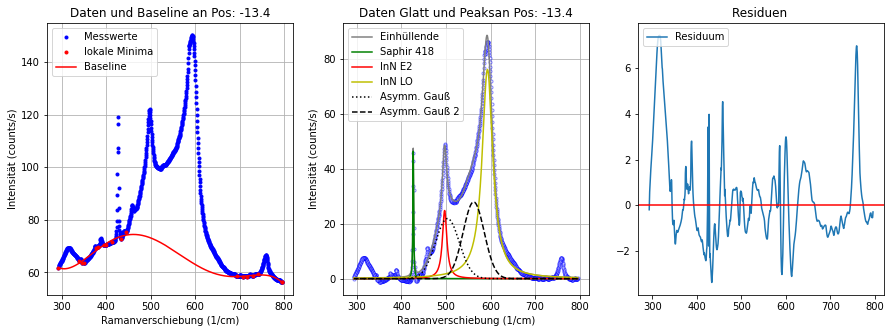

----------------------------------------------------------------------------------------------------
Position: -13.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [58.2678 58.259  58.2464 ... 62.5021 62.5042 62.5328]
Hintergrund Parameter:  [-3.22249715e-11  9.06796264e-08 -9.86253559e-05  5.14471298e-02
 -1.27875967e+01  1.27477537e+03]
Fitparameter Saphir 418: [48.967396827897176, 1.9794816473270929, 426.62256956139765]
Fitparameter InN E2: [28.37405112049213, 11.654737992345465, 496.7512048487849]
Fitparameter InN LO: [74.40655527797168, 25.988064831919466, 593.240994772531]
Fitparameter Asymmetrischer Gauß 1:  [21.387944274762262, 29.8718407252758, 500.0000159397708, 0.3296750005892711]
Fitparameter Asymmetrischer Gauß 2:  [28.678992223342348, 23.07572447410696, 567.4857601154145, 0.0058994599616618675]


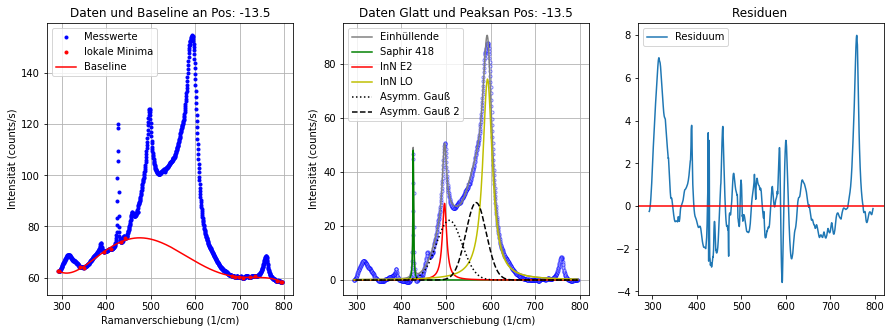

----------------------------------------------------------------------------------------------------
Position: -13.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [58.4614 58.6021 58.7112 ... 61.7888 61.6628 61.7332]
Hintergrund Parameter:  [-2.36403782e-11  6.68369665e-08 -7.29225737e-05  3.80504928e-02
 -9.42177728e+00  9.49623287e+02]
Fitparameter Saphir 418: [49.77116909940193, 1.9885974455928435, 426.64342292897175]
Fitparameter InN E2: [30.814969395263326, 11.368714777455835, 496.58420648733517]
Fitparameter InN LO: [76.19485708979771, 24.904501702269542, 593.2039775426188]
Fitparameter Asymmetrischer Gauß 1:  [23.276099586666692, 31.681200990825424, 500.00000072756285, 0.3469142829117736]
Fitparameter Asymmetrischer Gauß 2:  [30.18146541595964, 22.641247943885453, 569.3007112532534, 9.626709478218972e-05]


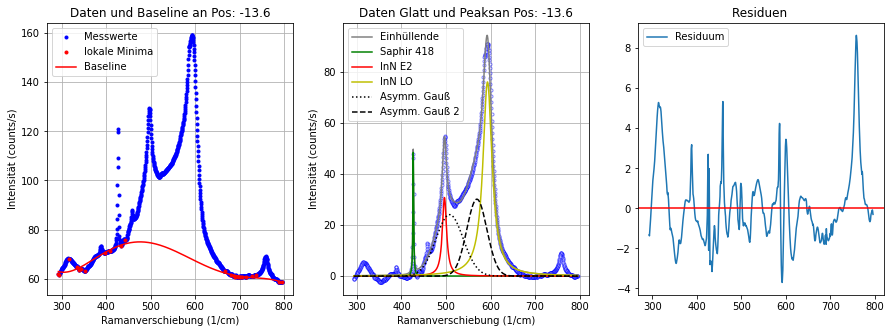

----------------------------------------------------------------------------------------------------
Position: -13.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [58.4946 58.5427 58.6646 ... 60.7483 60.6576 60.5743]
Hintergrund Parameter:  [-2.74830917e-11  7.54647147e-08 -7.99676064e-05  4.05625797e-02
 -9.77885278e+00  9.59628685e+02]
Fitparameter Saphir 418: [49.62984685940983, 2.0035995482900053, 426.64500119484]
Fitparameter InN E2: [31.21546406696482, 11.000755919000298, 496.68663194787104]
Fitparameter InN LO: [80.73456301159665, 25.916259152550705, 592.9748101007302]
Fitparameter Asymmetrischer Gauß 1:  [24.940185959205134, 28.759242913864615, 500.0000035729216, 0.17789777797582831]
Fitparameter Asymmetrischer Gauß 2:  [32.18799305599575, 24.15840655211534, 565.7546254307362, 0.005028315946940648]


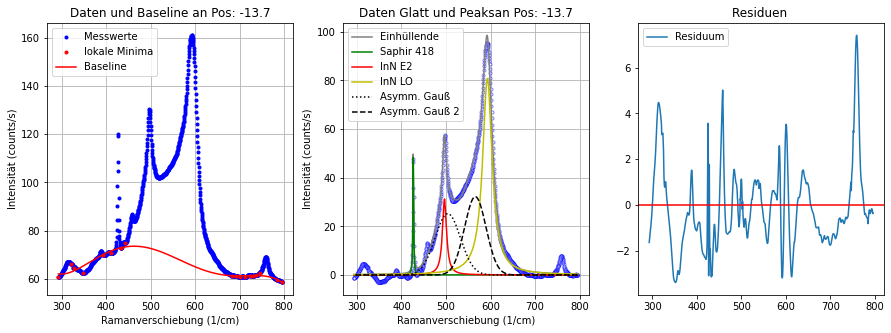

----------------------------------------------------------------------------------------------------
Position: -13.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [58.4596 58.5021 58.6408 ... 59.982  59.9314 59.9477]
Hintergrund Parameter:  [-3.61624306e-11  1.00965076e-07 -1.09004531e-04  5.64788005e-02
 -1.39467656e+01  1.37351721e+03]
Fitparameter Saphir 418: [48.947527037240555, 1.967236669925587, 426.63970197103214]
Fitparameter InN E2: [33.461955498572095, 11.223933282253304, 496.5164466819885]
Fitparameter InN LO: [82.38290933005273, 25.163955657938907, 593.1624905098674]
Fitparameter Asymmetrischer Gauß 1:  [22.716909631024834, 31.48459635402649, 500.00000000036533, 0.40792637861271464]
Fitparameter Asymmetrischer Gauß 2:  [30.448535685540726, 22.203238411791766, 568.49703815451, 0.0002641929866089384]


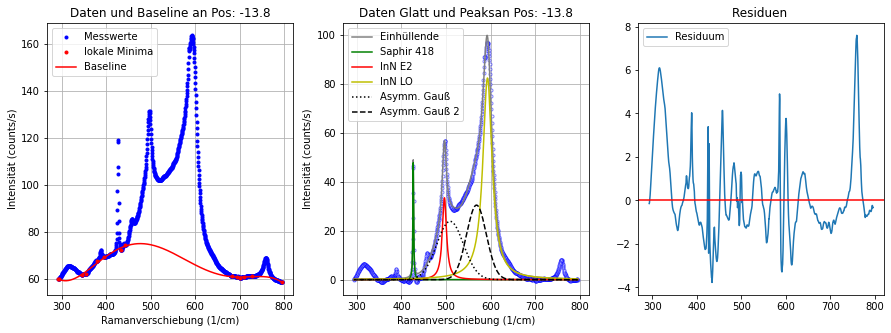

----------------------------------------------------------------------------------------------------
Position: -13.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [57.896  58.0079 58.0508 ... 58.4979 58.4435 58.4224]
Hintergrund Parameter:  [-2.73438776e-11  7.75904323e-08 -8.50428190e-05  4.46278972e-02
 -1.11182996e+01  1.11128801e+03]
Fitparameter Saphir 418: [50.73748367136964, 1.931694862996074, 426.66480048798553]
Fitparameter InN E2: [34.65118556165232, 10.96171333918875, 496.529771669285]
Fitparameter InN LO: [80.48885936932258, 23.686958970172256, 593.272046079283]
Fitparameter Asymmetrischer Gauß 1:  [24.726603684005227, 31.610149191467357, 510.79872322100806, 0.002188170876249489]
Fitparameter Asymmetrischer Gauß 2:  [31.550811798581734, 21.67344898406826, 570.9460956930653, 0.015344124684501493]


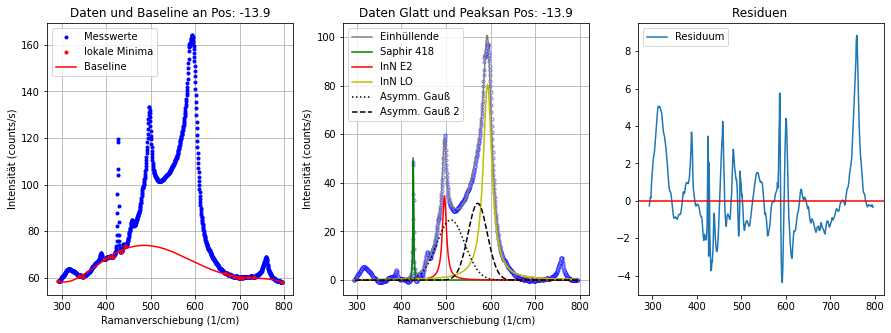

----------------------------------------------------------------------------------------------------
Position: -14.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [57.3325 57.2026 57.0413 ... 56.5154 56.505  56.5075]
Hintergrund Parameter:  [-3.22274651e-11  9.08645308e-08 -9.90868110e-05  5.18415918e-02
 -1.29110188e+01  1.28125963e+03]
Fitparameter Saphir 418: [49.61377819789666, 1.9507403770327996, 426.6548585167926]
Fitparameter InN E2: [35.32262704646753, 10.918967700405805, 496.50004738472404]
Fitparameter InN LO: [80.95065355066403, 23.30270464700683, 593.3017709573498]
Fitparameter Asymmetrischer Gauß 1:  [24.064474570427656, 31.78350140655002, 512.2378486515145, 0.00018957920339874863]
Fitparameter Asymmetrischer Gauß 2:  [31.272946095467034, 21.718128505006725, 571.6266441111317, 0.005074417119291102]


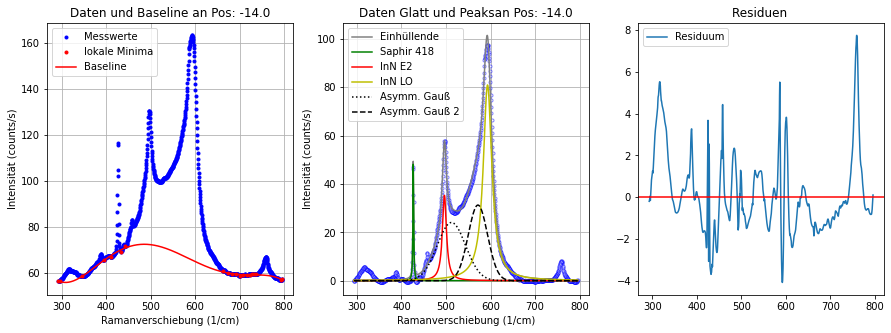

----------------------------------------------------------------------------------------------------
Position: -14.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [55.1207 55.2708 55.2739 ... 53.9216 53.7452 53.5591]
Hintergrund Parameter:  [-3.07948959e-11  8.56890848e-08 -9.21373907e-05  4.74854787e-02
 -1.16355062e+01  1.13896719e+03]
Fitparameter Saphir 418: [49.91922434606581, 1.93813446235584, 426.6423660552226]
Fitparameter InN E2: [34.76158396429575, 11.01530469081478, 496.58147905298375]
Fitparameter InN LO: [82.32123767230216, 23.97682143703418, 593.3395601275571]
Fitparameter Asymmetrischer Gauß 1:  [22.91834407420241, 34.30666926313615, 500.0000042670475, 0.48127485599445347]
Fitparameter Asymmetrischer Gauß 2:  [30.5349373225732, 21.833069532899092, 570.5597261470865, 0.0018724768999627873]


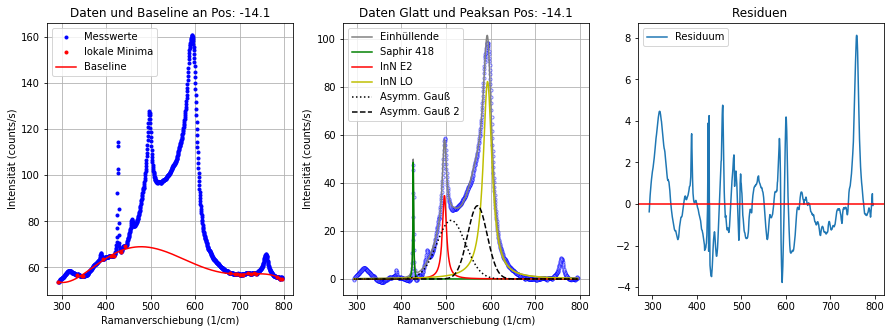

----------------------------------------------------------------------------------------------------
Position: -14.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [53.5024 53.3919 53.4587 ... 53.6484 52.588  51.4681]
Hintergrund Parameter:  [-3.10183853e-11  8.69801631e-08 -9.43398607e-05  4.91037293e-02
 -1.21696023e+01  1.20119543e+03]
Fitparameter Saphir 418: [49.34871289590098, 2.01630336768088, 426.6608979743871]
Fitparameter InN E2: [34.89734979063275, 10.468239884571942, 496.57388226041024]
Fitparameter InN LO: [80.50083345760996, 23.458029790142664, 593.4144041894041]
Fitparameter Asymmetrischer Gauß 1:  [22.16258946806075, 34.65860926629846, 500.0000457387406, 0.5163744945710061]
Fitparameter Asymmetrischer Gauß 2:  [29.832917892916683, 21.663190514475076, 570.9940052441563, 0.002839877294485518]


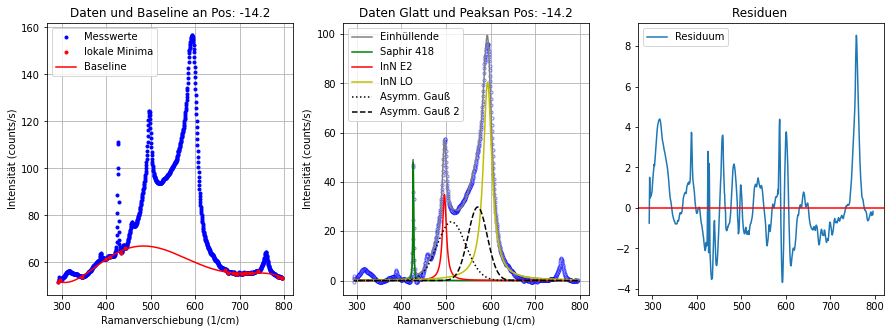

----------------------------------------------------------------------------------------------------
Position: -14.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [49.8937 49.9191 49.9479 ... 47.5251 47.4083 47.4048]
Hintergrund Parameter:  [-2.71532085e-11  7.56658935e-08 -8.14747255e-05  4.20450654e-02
 -1.03122495e+01  1.01031914e+03]
Fitparameter Saphir 418: [51.42989127148322, 1.9185927901471624, 426.675514634503]
Fitparameter InN E2: [33.51684478707107, 10.65081207431013, 496.7201526176819]
Fitparameter InN LO: [77.32952822114649, 23.27484440242889, 593.6031412624155]
Fitparameter Asymmetrischer Gauß 1:  [21.705010936879198, 36.971670881164094, 500.00001844380574, 0.5893362011416894]
Fitparameter Asymmetrischer Gauß 2:  [28.194085385212453, 21.236781217594093, 572.2520568482934, 0.002234748451408879]


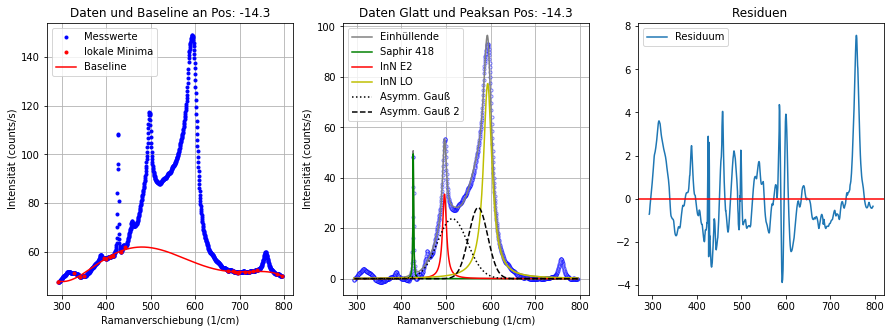

----------------------------------------------------------------------------------------------------
Position: -14.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [48.0764 48.1043 48.1983 ... 46.0042 46.1028 46.2169]
Hintergrund Parameter:  [-2.40747083e-11  6.74905022e-08 -7.31232497e-05  3.79711394e-02
 -9.37072685e+00  9.26459003e+02]
Fitparameter Saphir 418: [49.50485170901727, 1.9130808133939188, 426.6705536956493]
Fitparameter InN E2: [31.765577231085338, 10.564866358264156, 496.7514310188092]
Fitparameter InN LO: [73.53224733796455, 22.625646279332834, 593.8334491921195]
Fitparameter Asymmetrischer Gauß 1:  [22.95194294209923, 34.19674233361084, 515.633503544629, 0.0003087599755330655]
Fitparameter Asymmetrischer Gauß 2:  [27.701010089243994, 20.820885303512842, 573.2434671988466, 0.013551399489739331]


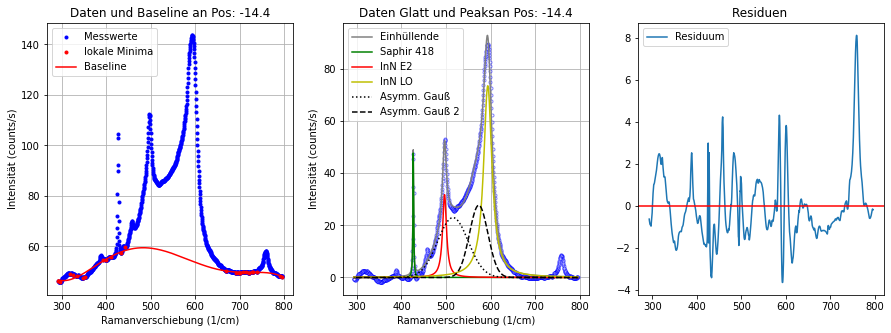

----------------------------------------------------------------------------------------------------
Position: -14.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [44.5508 44.1577 44.2685 ... 42.4914 42.4856 42.5447]
Hintergrund Parameter:  [-2.02331994e-11  5.74223431e-08 -6.29527224e-05  3.30260379e-02
 -8.20950109e+00  8.16797446e+02]
Fitparameter Saphir 418: [50.416769588310046, 1.925517296215633, 426.7159089919495]
Fitparameter InN E2: [30.789653822990974, 10.657274748916329, 496.8172711195315]
Fitparameter InN LO: [67.77775396365861, 21.495463722373884, 594.0468865544036]
Fitparameter Asymmetrischer Gauß 1:  [20.778457208037395, 36.98574378591154, 509.49159730549434, 0.3502614592000501]
Fitparameter Asymmetrischer Gauß 2:  [26.213018273043133, 20.150604531461333, 575.6760449266046, 0.005705442919019132]


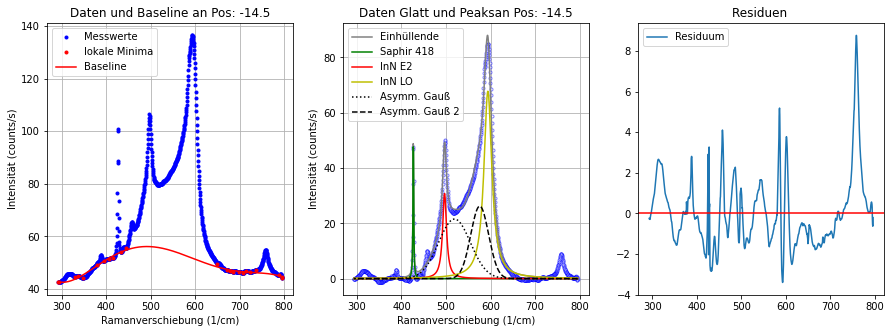

----------------------------------------------------------------------------------------------------
Position: -14.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [41.7671 41.7046 41.7036 ... 38.7684 38.7364 38.7777]
Hintergrund Parameter:  [-2.26256958e-11  6.39498764e-08 -6.98596068e-05  3.65751015e-02
 -9.09697913e+00  8.99201964e+02]
Fitparameter Saphir 418: [49.664572433145146, 1.9112533110175478, 426.72333307760266]
Fitparameter InN E2: [28.61319212665593, 10.623397858739366, 496.996282714224]
Fitparameter InN LO: [65.41286396851122, 21.945327228472884, 594.2743615252764]
Fitparameter Asymmetrischer Gauß 1:  [20.454095061580727, 35.957351672824515, 520.9219033928392, 3.942464216011203e-06]
Fitparameter Asymmetrischer Gauß 2:  [23.67205386585604, 19.620453394579975, 575.5637708735854, 0.018724534821700212]


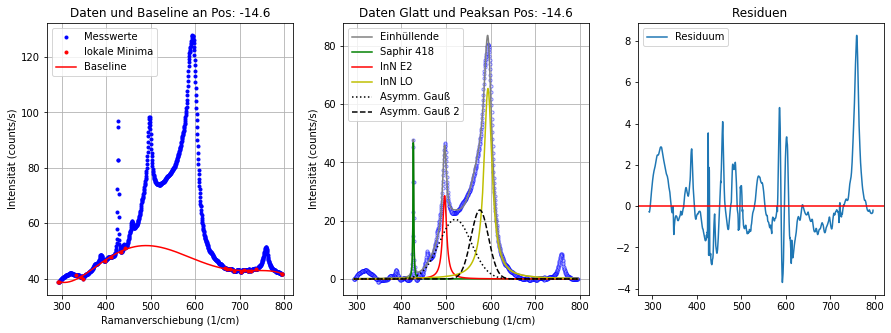

----------------------------------------------------------------------------------------------------
Position: -14.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [38.934  38.6936 38.5703 ... 35.7206 35.7083 35.7489]
Hintergrund Parameter:  [-2.06617661e-11  5.80362546e-08 -6.29861652e-05  3.27602640e-02
 -8.09738849e+00  7.97345540e+02]
Fitparameter Saphir 418: [50.23474130907246, 1.8702281376569694, 426.7489344334765]
Fitparameter InN E2: [27.256469381536743, 10.089696883141334, 497.1116563547111]
Fitparameter InN LO: [62.83800701989704, 22.013647669639617, 594.4129779713492]
Fitparameter Asymmetrischer Gauß 1:  [19.226829160894674, 35.18881230753819, 518.5328722940802, 8.934747121714189e-06]
Fitparameter Asymmetrischer Gauß 2:  [23.240306565868284, 20.344040411997693, 574.8001479291436, 0.0012203248594147475]


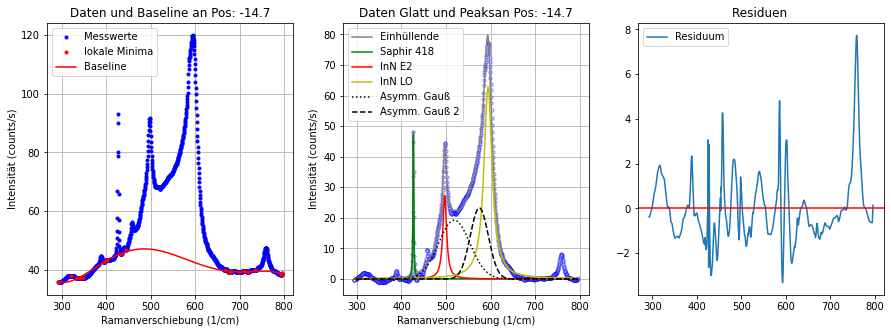

----------------------------------------------------------------------------------------------------
Position: -14.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [34.7924 34.8669 34.9447 ... 32.4112 32.421  32.4326]
Hintergrund Parameter:  [-1.95458756e-11  5.51293613e-08 -6.01083222e-05  3.14151964e-02
 -7.80141082e+00  7.69194384e+02]
Fitparameter Saphir 418: [49.16090978940032, 1.952599743385149, 426.73713339755074]
Fitparameter InN E2: [25.251629405193437, 10.027773627917597, 497.32380730386365]
Fitparameter InN LO: [58.93057288139177, 21.70421626345119, 594.676506731014]
Fitparameter Asymmetrischer Gauß 1:  [17.707028112407894, 35.680279364745225, 519.1575804946943, 0.04821125055206326]
Fitparameter Asymmetrischer Gauß 2:  [21.10256301029904, 19.603328360008582, 575.4495032244504, 0.011284717937966666]


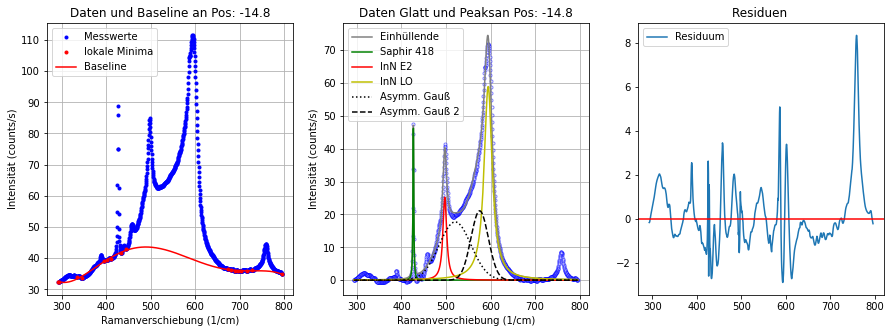

----------------------------------------------------------------------------------------------------
Position: -14.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [31.3722 31.447  31.4516 ... 28.5777 28.4373 28.2194]
Hintergrund Parameter:  [-1.66680223e-11  4.65361658e-08 -5.01901598e-05  2.59376703e-02
 -6.36832718e+00  6.23501416e+02]
Fitparameter Saphir 418: [50.19539105951501, 1.9165822124506797, 426.7399799900403]
Fitparameter InN E2: [23.365572288583355, 9.714888490083023, 497.508151989897]
Fitparameter InN LO: [54.45660397404645, 21.797389168578803, 594.9149423217042]
Fitparameter Asymmetrischer Gauß 1:  [16.804684557195053, 36.03008519714954, 520.5020935576363, 0.005870487219451674]
Fitparameter Asymmetrischer Gauß 2:  [18.95032749673529, 19.897174489943186, 575.6026718059121, 0.011637031608860123]


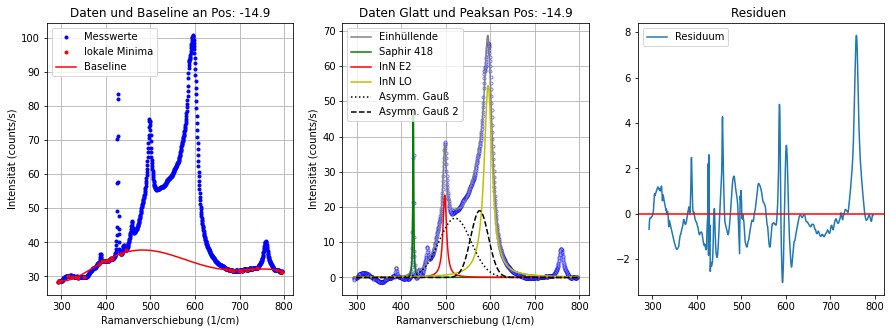

----------------------------------------------------------------------------------------------------
Position: -15.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [28.2221 28.3086 28.3922 ... 25.5173 25.5146 25.372 ]
Hintergrund Parameter:  [-1.50116780e-11  4.21630348e-08 -4.57737726e-05  2.38293489e-02
 -5.89921098e+00  5.82006910e+02]
Fitparameter Saphir 418: [51.730931254053196, 1.8874000429055084, 426.76056898168304]
Fitparameter InN E2: [21.303726998891438, 9.38025673006352, 497.669830622865]
Fitparameter InN LO: [50.16070009324344, 21.308920688732808, 595.2055070959727]
Fitparameter Asymmetrischer Gauß 1:  [15.637145283623717, 36.74923182681464, 521.578599126705, 0.0007021162079650351]
Fitparameter Asymmetrischer Gauß 2:  [17.662789966125775, 19.20937990651614, 576.5700525131423, 0.009050823053297095]


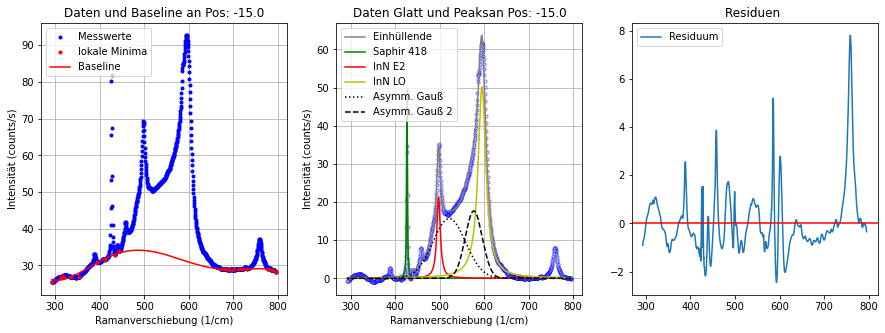

----------------------------------------------------------------------------------------------------
Position: -15.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [26.5952 26.6283 26.6641 ... 23.9594 23.9661 23.971 ]
Hintergrund Parameter:  [-1.05971851e-11  3.07699267e-08 -3.44453295e-05  1.84137625e-02
 -4.65237826e+00  4.69146504e+02]
Fitparameter Saphir 418: [51.049107409533505, 1.9050278892176538, 426.7752333325679]
Fitparameter InN E2: [20.344198567386076, 9.580067474417472, 497.7030845631071]
Fitparameter InN LO: [45.461795215372796, 20.089026161492132, 595.3549330593611]
Fitparameter Asymmetrischer Gauß 1:  [14.100758631091363, 37.54280943792807, 523.5537576078551, 0.00809960266391121]
Fitparameter Asymmetrischer Gauß 2:  [16.920328084992523, 18.534839437855684, 578.8609903869503, 8.662024455797875e-05]


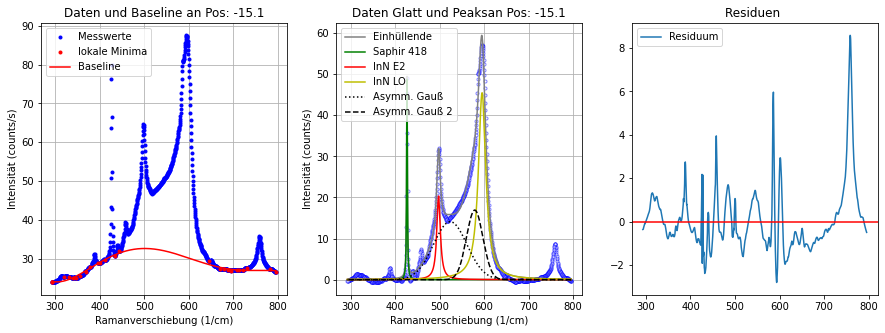

----------------------------------------------------------------------------------------------------
Position: -15.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [25.283  25.2241 25.1778 ... 22.2002 22.1139 22.077 ]
Hintergrund Parameter:  [-1.29474315e-11  3.70345057e-08 -4.09285741e-05  2.16799443e-02
 -5.45827103e+00  5.45208230e+02]
Fitparameter Saphir 418: [51.10420204834679, 1.90561036392277, 426.7766011995224]
Fitparameter InN E2: [19.462028034807904, 9.073968759253177, 497.8552495568771]
Fitparameter InN LO: [43.01114552523515, 20.41047097927838, 595.7093586871259]
Fitparameter Asymmetrischer Gauß 1:  [13.839114168096234, 38.05178578559184, 526.1815452086557, 0.00030521471445435695]
Fitparameter Asymmetrischer Gauß 2:  [15.87853541642432, 17.897847366157563, 579.1741089442314, 0.01687868937109447]


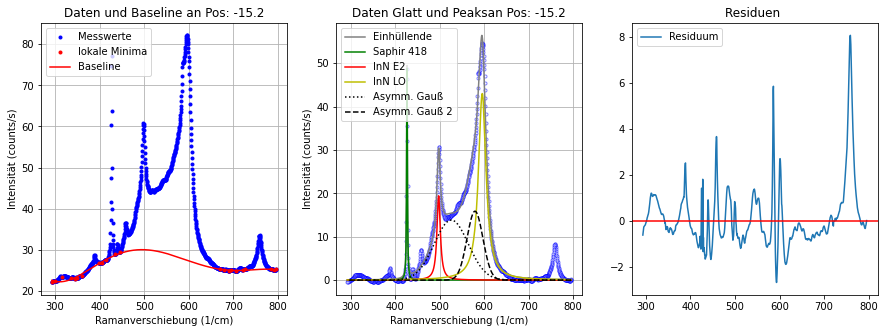

----------------------------------------------------------------------------------------------------
Position: -15.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [22.5656 22.5749 22.5854 ... 19.8598 19.8685 19.9476]
Hintergrund Parameter:  [-1.43059847e-11  3.99910134e-08 -4.32147346e-05  2.24083714e-02
 -5.53277291e+00  5.40678848e+02]
Fitparameter Saphir 418: [50.03843498834064, 1.8957569306797581, 426.7942573790125]
Fitparameter InN E2: [18.284346378364095, 8.702733390052321, 497.9317711311095]
Fitparameter InN LO: [42.09047609451245, 21.06091106319269, 595.7226949835335]
Fitparameter Asymmetrischer Gauß 1:  [12.736028351839312, 37.28865721090065, 524.2304311723678, 0.037122304665657545]
Fitparameter Asymmetrischer Gauß 2:  [13.59706039314498, 18.451664371377873, 577.4213340642054, 0.021386602446145316]


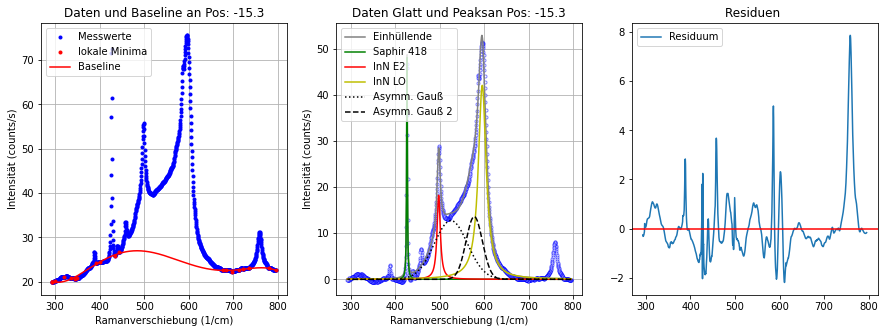

----------------------------------------------------------------------------------------------------
Position: -15.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [20.6414 20.5212 20.5071 ... 17.9424 17.8859 17.8126]
Hintergrund Parameter:  [-1.05247342e-11  2.99357750e-08 -3.28577263e-05  1.72566811e-02
 -4.29709243e+00  4.24093007e+02]
Fitparameter Saphir 418: [50.330351505247606, 1.879229704970187, 426.77581143237046]
Fitparameter InN E2: [16.627548501538534, 8.892564828731317, 498.02244424772636]
Fitparameter InN LO: [36.811466638892796, 20.153081729983064, 596.197658066082]
Fitparameter Asymmetrischer Gauß 1:  [11.389830193538925, 37.72695701886003, 525.2524874223323, 0.04440595055747607]
Fitparameter Asymmetrischer Gauß 2:  [13.480109584510796, 17.83047036472952, 579.3704458615125, 0.00860733666459991]


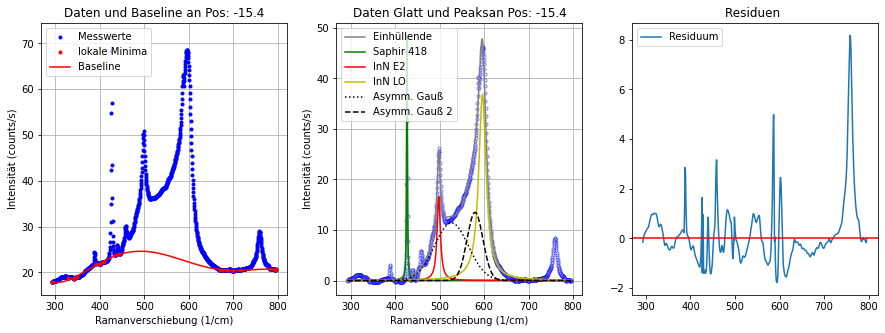

----------------------------------------------------------------------------------------------------
Position: -15.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [19.3147 19.2234 19.2005 ... 17.0625 17.0865 17.0548]
Hintergrund Parameter:  [-1.04851904e-11  2.95866107e-08 -3.22593215e-05  1.68610540e-02
 -4.18876722e+00  4.12971698e+02]
Fitparameter Saphir 418: [49.60986632391559, 1.9376160917498861, 426.7976211917223]
Fitparameter InN E2: [15.114918608346363, 9.146145007039518, 498.18911303513994]
Fitparameter InN LO: [35.006205011011915, 20.268463008555106, 596.132113707416]
Fitparameter Asymmetrischer Gauß 1:  [10.618749407706066, 37.88474970455611, 526.0747702893166, 0.0018606016630131415]
Fitparameter Asymmetrischer Gauß 2:  [12.405237974809072, 18.021548083479534, 579.1896879575515, 0.007309944623241223]


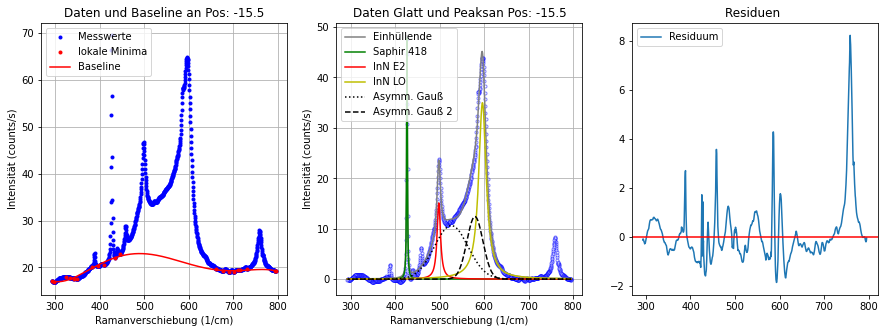

----------------------------------------------------------------------------------------------------
Position: -15.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [18.2742 18.2886 18.3322 ... 15.8924 16.0172 16.0995]
Hintergrund Parameter:  [-1.09554145e-11  3.06841723e-08 -3.32186139e-05  1.72517185e-02
 -4.26351911e+00  4.17411791e+02]
Fitparameter Saphir 418: [50.80784024038204, 1.871071419209754, 426.8001454418558]
Fitparameter InN E2: [14.386094376477953, 8.899061574194432, 498.25938750323945]
Fitparameter InN LO: [33.69168067592441, 20.702803487127955, 596.0432818281284]
Fitparameter Asymmetrischer Gauß 1:  [9.972614067603049, 36.99433208647512, 525.8898310780423, 7.492502083733238e-05]
Fitparameter Asymmetrischer Gauß 2:  [11.341641451034606, 18.217674230182602, 578.7851433105017, 0.016803088272643447]


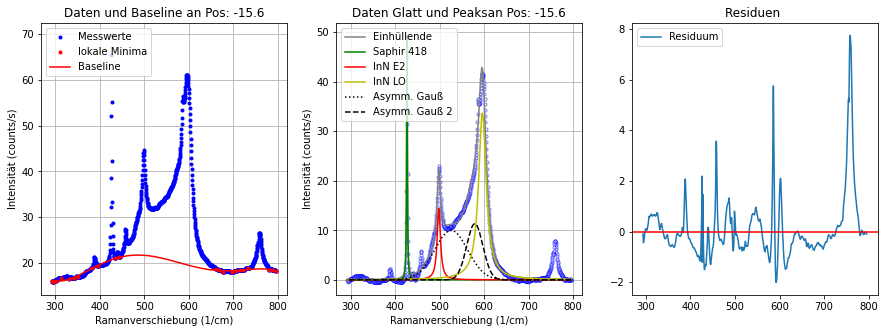

----------------------------------------------------------------------------------------------------
Position: -15.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [17.7418 17.7525 17.7624 ... 15.3533 15.3033 15.1304]
Hintergrund Parameter:  [-9.16254348e-12  2.58220496e-08 -2.80957787e-05  1.46423018e-02
 -3.62386275e+00  3.56430042e+02]
Fitparameter Saphir 418: [50.76493525388858, 1.9110073594325026, 426.81546389871266]
Fitparameter InN E2: [13.900681413704788, 8.952827123738375, 498.24174509107354]
Fitparameter InN LO: [31.853667308011286, 20.367328194982033, 596.2721635377342]
Fitparameter Asymmetrischer Gauß 1:  [10.315250876223212, 38.74430067338831, 528.4927256831687, 7.841842759877147e-05]
Fitparameter Asymmetrischer Gauß 2:  [11.334262796720475, 17.245323868087336, 580.8959027264433, 0.0035468212068163127]


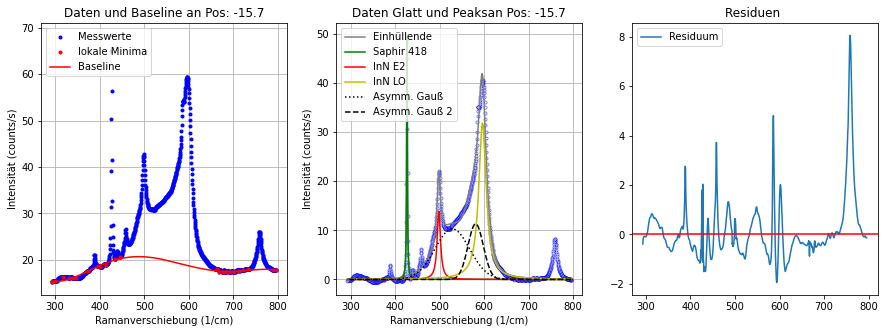

----------------------------------------------------------------------------------------------------
Position: -15.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [16.1678 16.1447 16.1692 ... 13.9182 13.9309 13.9491]
Hintergrund Parameter:  [-9.81898466e-12  2.76772607e-08 -3.01535054e-05  1.57633743e-02
 -3.92430713e+00  3.86425619e+02]
Fitparameter Saphir 418: [49.937605208332016, 1.9297169520554731, 426.81581332517504]
Fitparameter InN E2: [12.480499776438325, 8.526129257973224, 498.5265461458832]
Fitparameter InN LO: [29.408674639860934, 20.23757208762002, 596.4282945426048]
Fitparameter Asymmetrischer Gauß 1:  [9.30530619869224, 38.31467530947819, 528.1188666358128, 0.0007794364564599335]
Fitparameter Asymmetrischer Gauß 2:  [10.791708648960345, 17.250507062204708, 580.5047245171419, 0.008400228356074794]


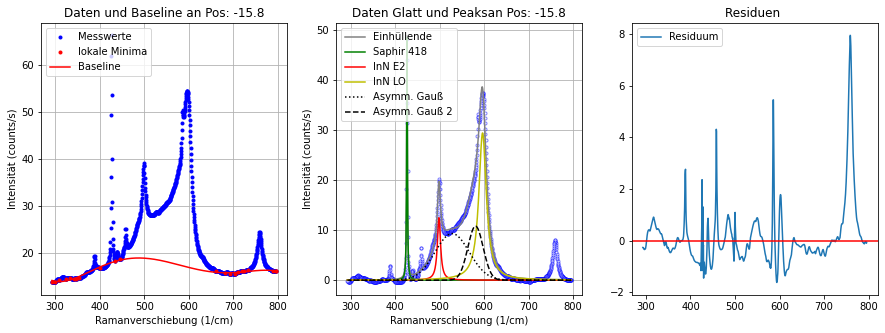

----------------------------------------------------------------------------------------------------
Position: -15.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [14.1916 14.2868 14.3141 ... 12.3048 12.3045 12.2441]
Hintergrund Parameter:  [-8.18157209e-12  2.28675817e-08 -2.47032448e-05  1.28049686e-02
 -3.16090003e+00  3.10106843e+02]
Fitparameter Saphir 418: [50.169173934334886, 1.9221552784946214, 426.8136959035714]
Fitparameter InN E2: [11.284915023353093, 8.189996470615565, 498.6589345426458]
Fitparameter InN LO: [28.011781248120744, 20.865858849976842, 596.3938390684692]
Fitparameter Asymmetrischer Gauß 1:  [8.29066361561093, 37.835344521260566, 524.436444171356, 0.001832641791495724]
Fitparameter Asymmetrischer Gauß 2:  [9.082539700469686, 18.172346304714626, 578.0688687236744, 0.022574336028722084]


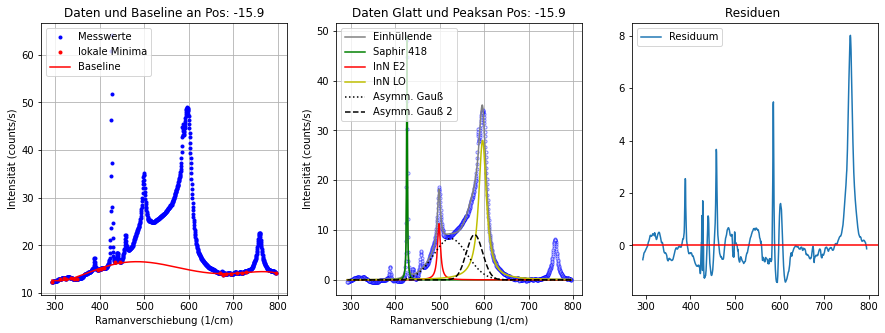

----------------------------------------------------------------------------------------------------
Position: -16.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [13.6038 13.5437 13.5099 ... 11.7231 11.7206 11.7235]
Hintergrund Parameter:  [-7.52349503e-12  2.14352218e-08 -2.35969157e-05  1.24556507e-02
 -3.12696993e+00  3.10599194e+02]
Fitparameter Saphir 418: [50.150941947536666, 1.927776579524444, 426.8317592238469]
Fitparameter InN E2: [11.078700328002553, 8.992908282433536, 498.5765861646557]
Fitparameter InN LO: [22.749353557215244, 18.75186179367114, 597.1677494366907]
Fitparameter Asymmetrischer Gauß 1:  [7.823344807768912, 39.66229382462044, 529.9999899781905, 0.1305154018003241]
Fitparameter Asymmetrischer Gauß 2:  [9.994972655948589, 15.632998305926405, 583.8356881949537, 0.014282326000504797]


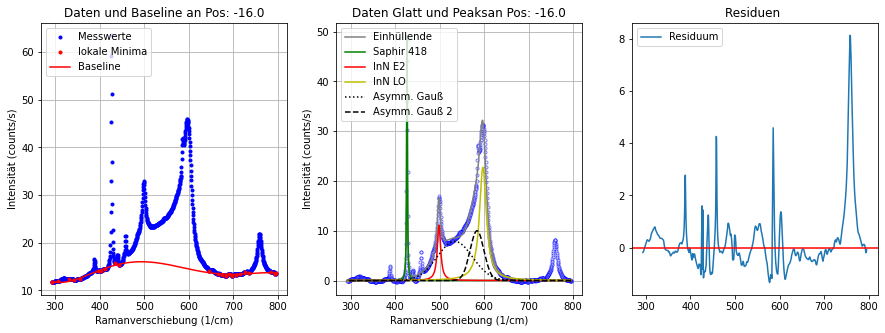

----------------------------------------------------------------------------------------------------
Position: -16.1
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [12.9249 12.9536 12.9794 ... 11.114  11.1573 11.2112]
Hintergrund Parameter:  [-7.90553713e-12  2.24396419e-08 -2.46311023e-05  1.29845693e-02
 -3.26373401e+00  3.24157624e+02]
Fitparameter Saphir 418: [50.547706872899866, 1.907244065196745, 426.8310845983243]
Fitparameter InN E2: [10.57934105823829, 8.467810198780972, 498.63844630691614]
Fitparameter InN LO: [19.160663279401202, 17.123143605725044, 597.9380453859116]
Fitparameter Asymmetrischer Gauß 1:  [7.807366569534307, 43.30568700341112, 529.9999436418512, 0.288011885455624]
Fitparameter Asymmetrischer Gauß 2:  [10.938945923644955, 13.757089953490253, 584.9999972871825, 0.1847045161346469]


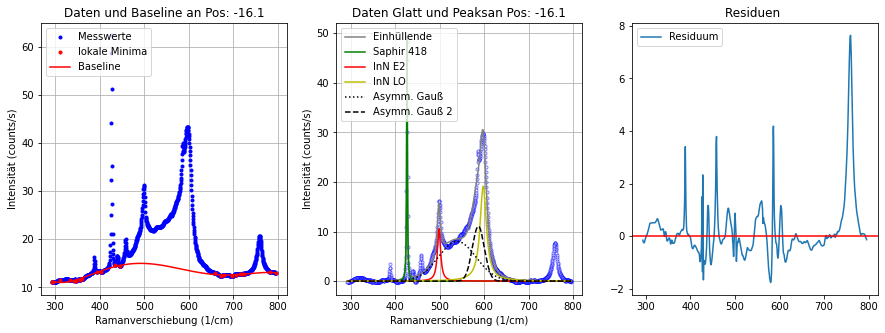

----------------------------------------------------------------------------------------------------
Position: -16.2
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [12.3454 12.2497 12.2022 ... 10.5201 10.5359 10.5721]
Hintergrund Parameter:  [-6.76706983e-12  1.91069129e-08 -2.08496745e-05  1.09190322e-02
 -2.72430304e+00  2.69777595e+02]
Fitparameter Saphir 418: [48.9863492816999, 1.981025544332053, 426.8431916082575]
Fitparameter InN E2: [9.635538131055725, 7.631476373983044, 498.7811859123906]
Fitparameter InN LO: [22.723707553733647, 20.33471291189353, 596.6997267903196]
Fitparameter Asymmetrischer Gauß 1:  [6.911631260556161, 38.95305812337079, 527.4444271628796, 0.00016108856674209142]
Fitparameter Asymmetrischer Gauß 2:  [7.712467371178637, 17.120327473674084, 580.4749151484864, 0.013106299285903662]


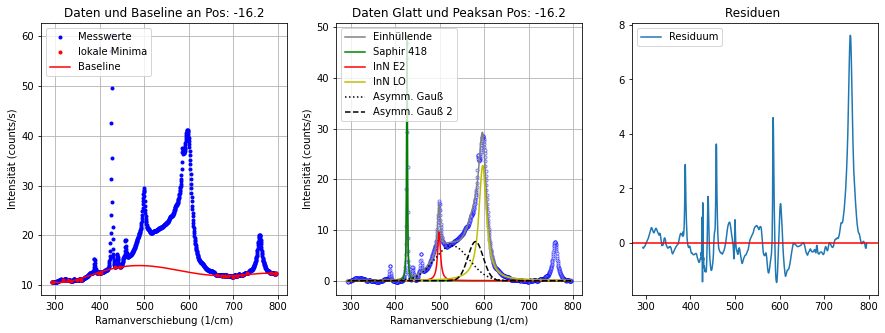

----------------------------------------------------------------------------------------------------
Position: -16.3
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [11.9395 11.886  11.8368 ... 10.0177 10.0606 10.1293]
Hintergrund Parameter:  [-7.77059305e-12  2.16552349e-08 -2.33264752e-05  1.20684438e-02
 -2.97967956e+00  2.91186800e+02]
Fitparameter Saphir 418: [49.42563674852645, 1.9430255413565576, 426.82975633099477]
Fitparameter InN E2: [9.401069482333696, 8.880874151621763, 498.5890320497844]
Fitparameter InN LO: [15.933380208258761, 16.856314072251422, 598.4171229691295]
Fitparameter Asymmetrischer Gauß 1:  [7.517366799704782, 46.49820468121085, 529.999994232382, 0.40030270771943466]
Fitparameter Asymmetrischer Gauß 2:  [10.426960627102805, 12.9468083669549, 584.9999996292833, 0.32250403484458245]


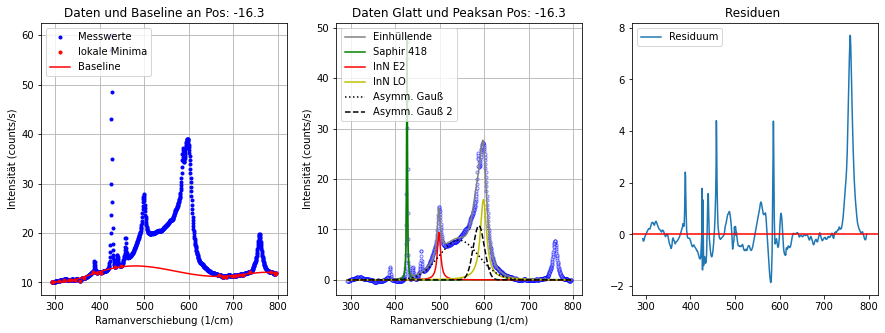

----------------------------------------------------------------------------------------------------
Position: -16.4
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [11.1454  11.2264  11.2516  ...  9.4566   9.47449  9.52214]
Hintergrund Parameter:  [-5.26112275e-12  1.50755558e-08 -1.66701124e-05  8.82859510e-03
 -2.22140576e+00  2.22200808e+02]
Fitparameter Saphir 418: [49.47071070566777, 1.9350914802024393, 426.85040050797517]
Fitparameter InN E2: [8.787091698602628, 8.825928266222697, 498.72891582619536]
Fitparameter InN LO: [13.218326596672169, 14.956575187703239, 599.0277945094155]
Fitparameter Asymmetrischer Gauß 1:  [6.807405106990121, 45.54737673617633, 529.9999917173294, 0.4130197882775013]
Fitparameter Asymmetrischer Gauß 2:  [11.106371166666564, 12.938347506309267, 584.9999999988902, 0.4832608725823692]


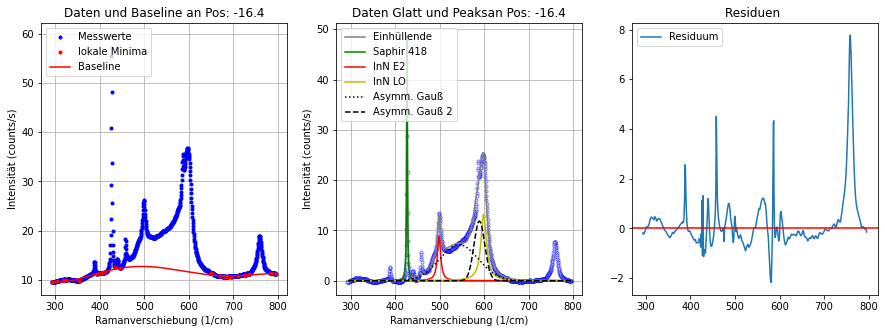

----------------------------------------------------------------------------------------------------
Position: -16.5
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [10.6735  10.6991  10.7239  ...  9.10106  9.05766  9.01869]
Hintergrund Parameter:  [-5.38249901e-12  1.54862921e-08 -1.71818994e-05  9.12371849e-03
 -2.30031911e+00  2.29502649e+02]
Fitparameter Saphir 418: [49.63563336106835, 1.920422147053908, 426.8548055156714]
Fitparameter InN E2: [8.71415631630156, 9.25565657688405, 498.6776466581967]
Fitparameter InN LO: [12.895656659598941, 15.769201811209697, 598.8911209155768]
Fitparameter Asymmetrischer Gauß 1:  [6.239439621480947, 44.864988397286666, 529.9999973883438, 0.4834855473599966]
Fitparameter Asymmetrischer Gauß 2:  [10.183638015770457, 12.846563200323299, 584.999999034211, 0.4650039451105387]


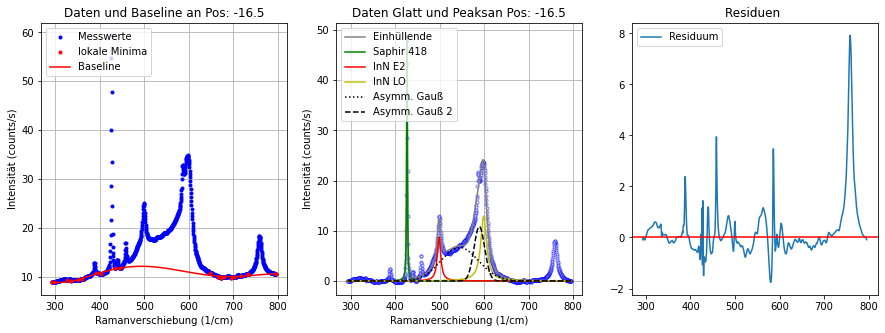

----------------------------------------------------------------------------------------------------
Position: -16.6
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [10.079   10.0592  10.0611  ...  8.63791  8.65879  8.68387]
Hintergrund Parameter:  [-5.25524951e-12  1.50789023e-08 -1.66956025e-05  8.85411388e-03
 -2.23155926e+00  2.22673456e+02]
Fitparameter Saphir 418: [49.29792208655269, 1.9312918008001603, 426.8531295564571]
Fitparameter InN E2: [8.027741394385872, 9.592418036394369, 498.8331274537535]
Fitparameter InN LO: [12.876122140601158, 15.953758785002579, 598.7559279415408]
Fitparameter Asymmetrischer Gauß 1:  [5.802153010486411, 43.79233676448365, 529.9999999999901, 0.48493575492759006]
Fitparameter Asymmetrischer Gauß 2:  [9.428551582015844, 12.968898230670872, 584.9999999987817, 0.43841945610238353]


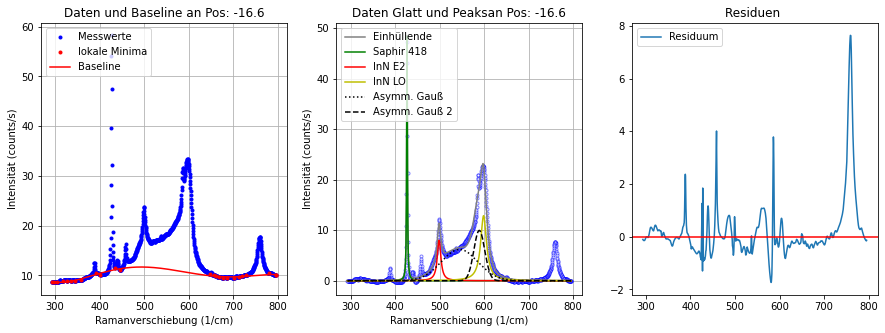

----------------------------------------------------------------------------------------------------
Position: -16.7
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [9.99448 9.92795 9.87257 ... 8.14646 8.14911 8.15362]
Hintergrund Parameter:  [-5.00743103e-12  1.43874465e-08 -1.59440547e-05  8.46104966e-03
 -2.13382257e+00  2.12990015e+02]
Fitparameter Saphir 418: [48.76075122168119, 1.953088231190443, 426.86029183967366]
Fitparameter InN E2: [7.614154731449119, 9.538432157460894, 498.8694031411097]
Fitparameter InN LO: [10.880883277757746, 15.370055214101615, 599.3508099982724]
Fitparameter Asymmetrischer Gauß 1:  [5.620097925415317, 45.29800141686946, 529.9999999966416, 0.5383134405569474]
Fitparameter Asymmetrischer Gauß 2:  [9.712856733818972, 12.622466182348, 584.9999999999229, 0.5451991493013204]


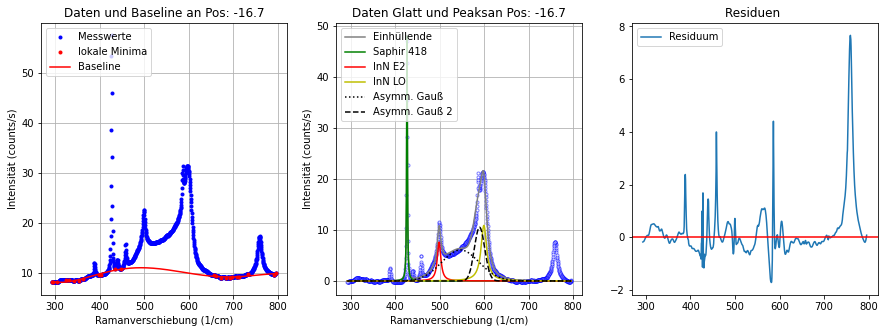

----------------------------------------------------------------------------------------------------
Position: -16.8
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [9.55985 9.52779 9.52966 ... 7.97717 7.98513 7.99217]
Hintergrund Parameter:  [-3.14873574e-12  9.33478627e-09 -1.06184547e-05  5.74905105e-03
 -1.46852005e+00  1.49963221e+02]
Fitparameter Saphir 418: [48.71117520809362, 1.9669036004542706, 426.8574842160682]
Fitparameter InN E2: [7.1097213286884084, 8.453048333863642, 498.94468747309196]
Fitparameter InN LO: [10.735670723396819, 15.09591614925313, 599.2015435727275]
Fitparameter Asymmetrischer Gauß 1:  [5.466397641955139, 44.63821125686417, 529.9995944562972, 0.3584399184500827]
Fitparameter Asymmetrischer Gauß 2:  [9.403415463970962, 13.133382649162563, 584.999999986875, 0.4951919009914639]


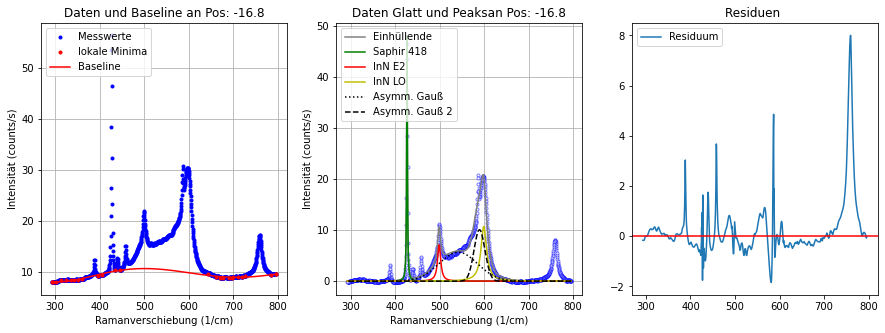

----------------------------------------------------------------------------------------------------
Position: -16.9
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [9.21469 9.20016 9.18192 ... 7.53597 7.50555 7.478  ]
Hintergrund Parameter:  [-4.69376567e-12  1.33522613e-08 -1.46540318e-05  7.70552784e-03
 -1.92729984e+00  1.91345983e+02]
Fitparameter Saphir 418: [48.90928884263988, 1.9429722527783613, 426.8677035062812]
Fitparameter InN E2: [7.306321801709414, 8.12624114842402, 498.97374503837165]
Fitparameter InN LO: [11.262905116995872, 15.450300803233164, 599.1316118961912]
Fitparameter Asymmetrischer Gauß 1:  [5.364627771382471, 45.82505820915365, 529.9995234586723, 0.41855119191205137]
Fitparameter Asymmetrischer Gauß 2:  [8.609483295228715, 12.692653981672228, 584.9999999926804, 0.4547048139323419]


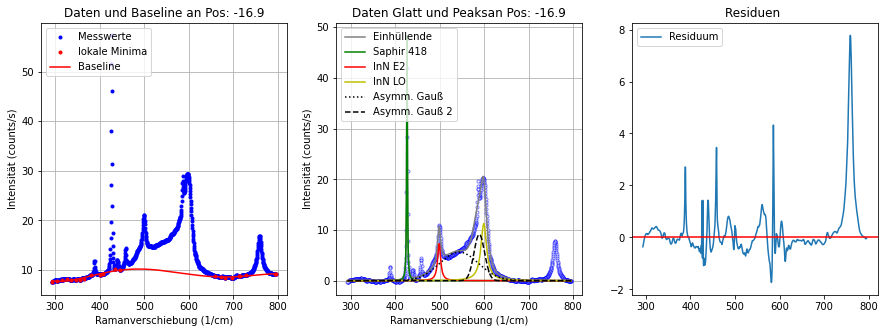

----------------------------------------------------------------------------------------------------
Position: -17.0
x-Daten: [795.45685 794.98438 794.51385 ... 294.03482 293.52521 293.01349]
y-Daten: [8.50244 8.57358 8.65044 ... 7.3226  7.30742 7.27603]
Hintergrund Parameter:  [-3.98317843e-12  1.16343942e-08 -1.31017117e-05  7.05775548e-03
 -1.80413201e+00  1.82748940e+02]
Fitparameter Saphir 418: [49.47494671941952, 1.8869536128364794, 426.8500222844364]
Fitparameter InN E2: [6.9264387856838345, 8.629146066800352, 498.8683557323207]
Fitparameter InN LO: [10.12248934461844, 14.597077186147787, 599.3255719663695]
Fitparameter Asymmetrischer Gauß 1:  [4.757142945921851, 44.11051285580115, 529.9999999999529, 0.459442830537469]
Fitparameter Asymmetrischer Gauß 2:  [8.83488579434112, 12.764945052061384, 584.9999999999815, 0.5068316071815491]
BILD an Pos:  -17.0


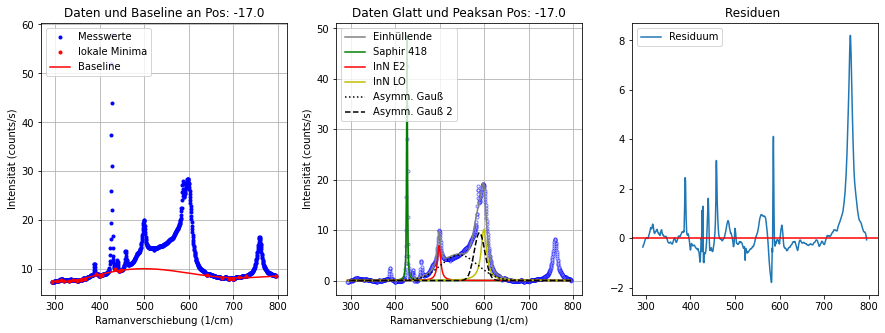

----------------------------------------------------------------------------------------------------


In [37]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Asymm_Gauß_1_Liste=[]
Asymm_Gauß_2_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_MEPA_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_MEPA_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_MEPA_array_float[0],[0])
        y=np.delete(data_MEPA_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=4)[0]]
        xzw=x[argrelextrema(y, np.less,order=4)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for j in range(len(xzw)):
            if xzw[j]<=450 or xzw[j]>=620:
                xmin.append(xzw[j])
                ymin.append(yzw[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1]) 
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        #fitten 4 lorentz in saphir_418, InN E2 498, InN LO 595 + 2Asymmetrischer Gauß
        #L_x3_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2)
        init_vals_L_x3_AG_x2 = [1,1,426, 5,1,498, 1,1,595, 20,38,524,0.09, 20,18,580,0.008]
        param_bounds_L_x3_AG_x2= ([0,0,410, 0,0,485, 0,0,585, 0,0,500,0, 0,0,540,0],[np.inf,np.inf,430, np.inf,20,505, np.inf,50,605, np.inf,np.inf,530,np.inf, np.inf,np.inf,585,np.inf])
        fitParams_L_x3_AG_x2, cov_L_x3_AG_x2 = curve_fit(f=L_x3_AG_x2, xdata=x, ydata=y_glatt, p0=init_vals_L_x3_AG_x2, bounds=param_bounds_L_x3_AG_x2)
        fitParams_L_Saphir_418=[fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2]]
        fitParams_L_InN_E2=[fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5]]
        fitParams_L_InN_LO=[fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8]]
        fitParams_AG_1=[fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12]]
        fitParams_AG_2=[fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]]
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
        print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
        
        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x3_AG_x2(x, fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2], fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5],fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8],fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12],fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]), color='gray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,Lorentz(x, fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2]), color='g'  ,markersize=3, label='Saphir 418')
        plt.plot(x,Lorentz(x, fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5]), color='r'  ,markersize=3, label='InN E2')
        plt.plot(x,Lorentz(x, fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8]), color='y'  ,markersize=3, label='InN LO')
        plt.plot(x,asymmgauss(x, fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
        plt.plot(x,asymmgauss(x, fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        plt.plot(x,y_glatt-L_x3_AG_x2(x, fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2], fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5],fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8],fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12],fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
    
        if i == data_MEPA_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D0 532nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D0 532nm Position '+ str(position) + '.png')
        if i == data_MEPA_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MEPA Auswertung D0 532nm Position '+ str(position) + '.png')
        
        plt.show()
     
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Saphir_418_Peaks_Liste.append([position, fitParams_L_Saphir_418])
        Asymm_Gauß_1_Liste.append([position,fitParams_AG_1])
        Asymm_Gauß_2_Liste.append([position,fitParams_AG_2])
        Baseline_Liste.append([position,fitParams_base])
        
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

asymm gauß 1


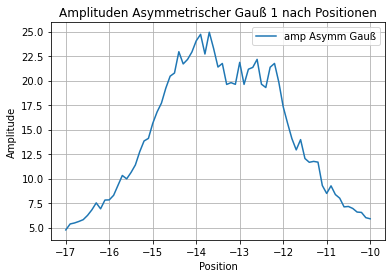

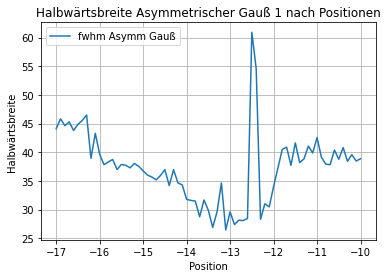

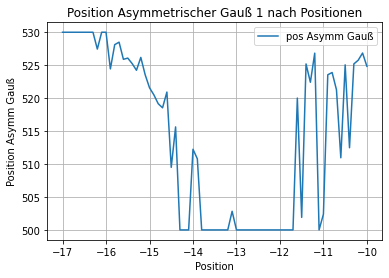

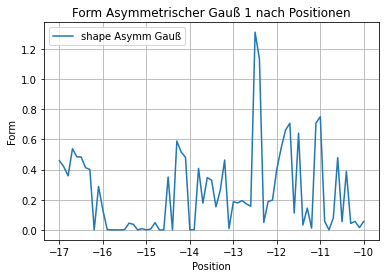

---------------------------------------------------------------------------------
asymm gauß 2


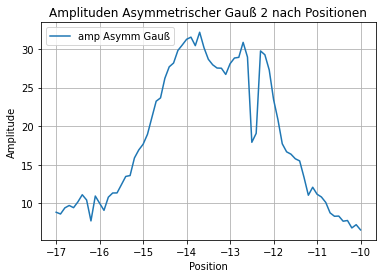

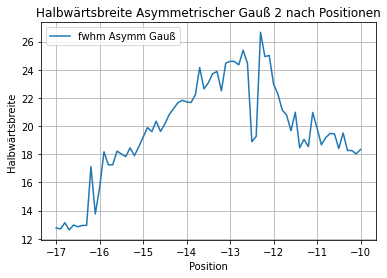

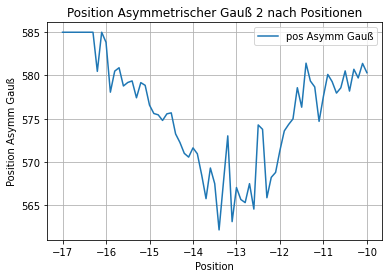

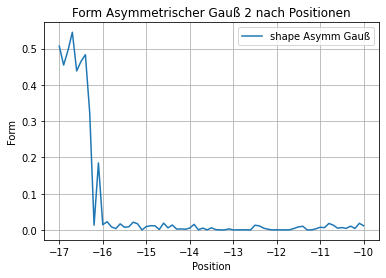

---------------------------------------------------------------------------------
Baseline:


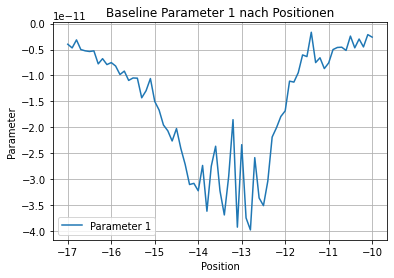

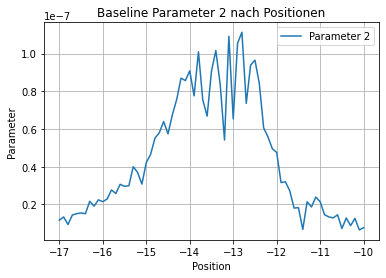

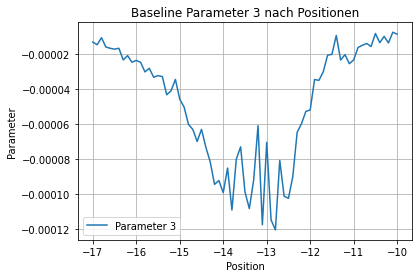

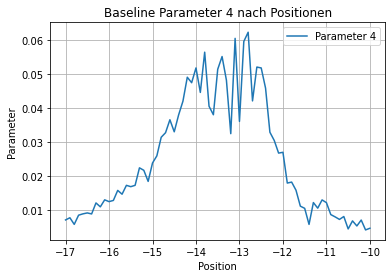

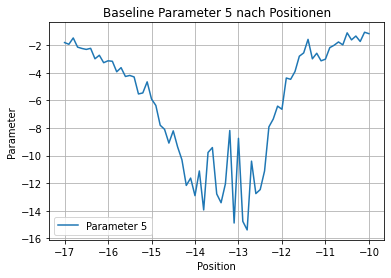

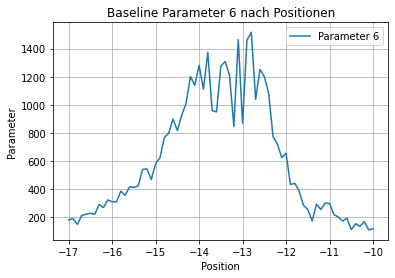

In [38]:
# Verhalten Asymmetrischer Gauß und Baseline
# mittlung der Asymm Gauß parameter und abweichungen

print("asymm gauß 1")
Positionen=[]
Asymm_Gauß_1_Liste_Amp=[]
Asymm_Gauß_1_Liste_fwhm=[]
Asymm_Gauß_1_Liste_pos=[]
Asymm_Gauß_1_Liste_shape=[]
for i in range(len(Asymm_Gauß_1_Liste)):
    Positionen.append(Asymm_Gauß_1_Liste[i][0])
    Asymm_Gauß_1_Liste_Amp.append(Asymm_Gauß_1_Liste[i][1][0])
    Asymm_Gauß_1_Liste_fwhm.append(Asymm_Gauß_1_Liste[i][1][1])
    Asymm_Gauß_1_Liste_pos.append(Asymm_Gauß_1_Liste[i][1][2])
    Asymm_Gauß_1_Liste_shape.append(Asymm_Gauß_1_Liste[i][1][3])
    
#print("Asymmetrischer Gauß 1 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_Amp), "\nMin: ", min(Asymm_Gauß_1_Liste_Amp))

#print("Asymmetrischer Gauß 1 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_1_Liste_fwhm))

#print("Asymmetrischer Gauß 1 Position:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_pos), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_pos), "\nMin: ", min(Asymm_Gauß_1_Liste_pos))

#print("Asymmetrischer Gauß 1 Form:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_shape), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_shape), "\nMin: ", min(Asymm_Gauß_1_Liste_shape))


#Plotten
plt.title('Amplituden Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_Amp ,markersize=2, label='amp Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Halbwärtsbreite Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Halbwärtsbreite')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Position Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_pos ,markersize=2, label='pos Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Position Asymm Gauß')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Form Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_shape ,markersize=2, label='shape Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Form')
plt.grid(True)
plt.legend()
plt.show()

print("---------------------------------------------------------------------------------")
#---------------------------------------------------------------------------------

print("asymm gauß 2")
Positionen=[]
Asymm_Gauß_2_Liste_Amp=[]
Asymm_Gauß_2_Liste_fwhm=[]
Asymm_Gauß_2_Liste_pos=[]
Asymm_Gauß_2_Liste_shape=[]
for j in range(len(Asymm_Gauß_2_Liste)):
    Positionen.append(Asymm_Gauß_2_Liste[j][0])
    Asymm_Gauß_2_Liste_Amp.append(Asymm_Gauß_2_Liste[j][1][0])
    Asymm_Gauß_2_Liste_fwhm.append(Asymm_Gauß_2_Liste[j][1][1])
    Asymm_Gauß_2_Liste_pos.append(Asymm_Gauß_2_Liste[j][1][2])
    Asymm_Gauß_2_Liste_shape.append(Asymm_Gauß_2_Liste[j][1][3])
    
#print("Asymmetrischer Gauß 2 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_2_Liste_Amp), "\nMin: ", min(Asymm_Gauß_2_Liste_Amp))

#print("Asymmetrischer Gauß 2 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_2_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_2_Liste_fwhm))

#print("Asymmetrischer Gauß 2 Position:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_pos), 
 #     "\nMax: ", max(Asymm_Gauß_2_Liste_pos), "\nMin: ", min(Asymm_Gauß_2_Liste_pos))

#print("Asymmetrischer Gauß 2 Form:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_shape), 
 #     "\nMax: ", max(Asymm_Gauß_2_Liste_shape), "\nMin: ", min(Asymm_Gauß_2_Liste_shape))


#Plotten
plt.title('Amplituden Asymmetrischer Gauß 2 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_2_Liste_Amp ,markersize=2, label='amp Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Halbwärtsbreite Asymmetrischer Gauß 2 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_2_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Halbwärtsbreite')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Position Asymmetrischer Gauß 2 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_2_Liste_pos ,markersize=2, label='pos Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Position Asymm Gauß')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Form Asymmetrischer Gauß 2 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_2_Liste_shape ,markersize=2, label='shape Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Form')
plt.grid(True)
plt.legend()
plt.show()

#---------------------------------------------------------------------------------
print("---------------------------------------------------------------------------------")
#---------------------------------------------------------------------------------

print("Baseline:")
Positionen=[]
Base_Para_1=[]
Base_Para_2=[]
Base_Para_3=[]
Base_Para_4=[]
Base_Para_5=[]
Base_Para_6=[]
for k in range(len(Baseline_Liste)):
    Positionen.append(Baseline_Liste[k][0])
    Base_Para_1.append(Baseline_Liste[k][1][0])
    Base_Para_2.append(Baseline_Liste[k][1][1])
    Base_Para_3.append(Baseline_Liste[k][1][2])
    Base_Para_4.append(Baseline_Liste[k][1][3])
    Base_Para_5.append(Baseline_Liste[k][1][4])
    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
plt.title('Baseline Parameter 1 nach Positionen')
plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
plt.xlabel('Position')
plt.ylabel('Parameter')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Baseline Parameter 2 nach Positionen')
plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
plt.xlabel('Position')
plt.ylabel('Parameter')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Baseline Parameter 3 nach Positionen')
plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
plt.xlabel('Position')
plt.ylabel('Parameter')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Baseline Parameter 4 nach Positionen')
plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
plt.xlabel('Position')
plt.ylabel('Parameter')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Baseline Parameter 5 nach Positionen')
plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
plt.xlabel('Position')
plt.ylabel('Parameter')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Baseline Parameter 6 nach Positionen')
plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
plt.xlabel('Position')
plt.ylabel('Parameter')
plt.grid(True)
plt.legend()
plt.show()

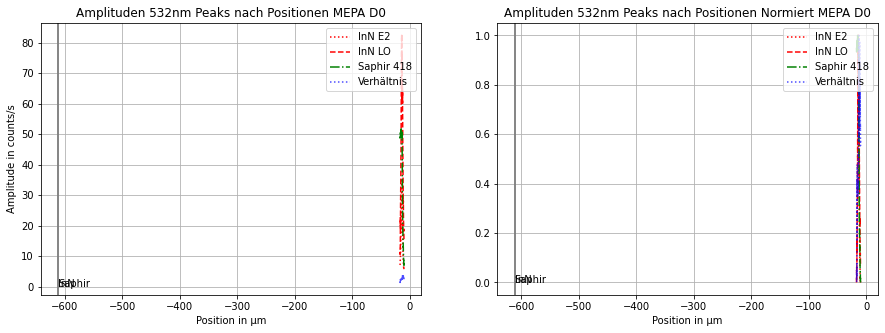

In [39]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_Saphir_418_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])

Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    
    
    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden 532nm Peaks nach Positionen MEPA D0')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_Amp,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp,':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
   
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden 532nm Peaks nach Positionen Normiert MEPA D0')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_532nm/MEPA Amplituden Peaks nach Positionen D0 532nm')
plt.show()

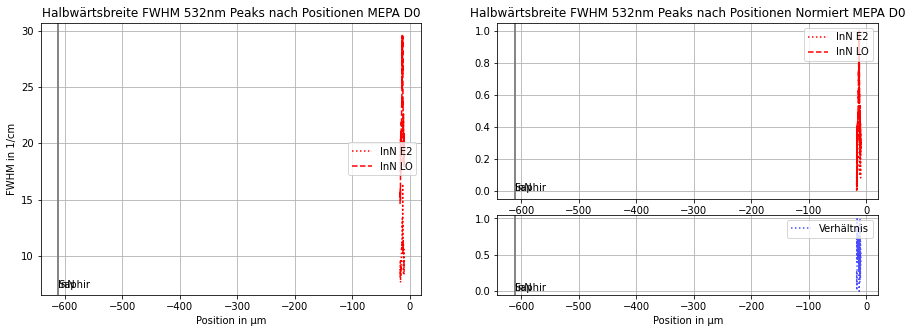

In [40]:
# Halbwärtsbreiten fwhm nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_Saphir_418_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
    
#Plotten
#fig = plt.figure(figsize=(15,5))

#plt.subplot(1, 2, 1) 
#plt.title('Halbwärtsbreite FWHM 532nm Peaks nach Positionen MEPA D0')
#plt.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5#
#plt.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alp#ha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_fwhm, ':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

#plt.xlabel('Position')
#plt.ylabel('Halbwärtsbreite fwhm')
#plt.grid(True)
#plt.legend(loc='upper right')


#plt.subplot(1, 2, 2) 
#plt.title('Halbwärtsbreite FWHM 532nm Peaks nach Positionen Normiert MEPA D0')
#plt.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

#plt.xlabel('Position')
#plt.ylabel('Amplitude')
#plt.grid(True)
#plt.legend(loc='upper right')

#plt.savefig('Bilder_Graphen_532nm/MEPA Halbwärtsbreite fwhm Peaks nach Positionen D0 532nm')
#plt.show()


#Plotten
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='center right')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm)-0.5,s='InN')
ax1.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_InN_E2_fwhm)-0.5,s='Saphir')

ax1.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen MEPA D0")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.text(x=fitParams_G_E2[2],y=0,s='InN')
ax2.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

ax2.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen Normiert MEPA D0")
ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position in \u03bcm')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=0,s='InN')
ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

plt.savefig('Bilder_Graphen_532nm/MEPA Halbwärtsbreite fwhm Peaks nach Positionen D0 532nm')
plt.show()

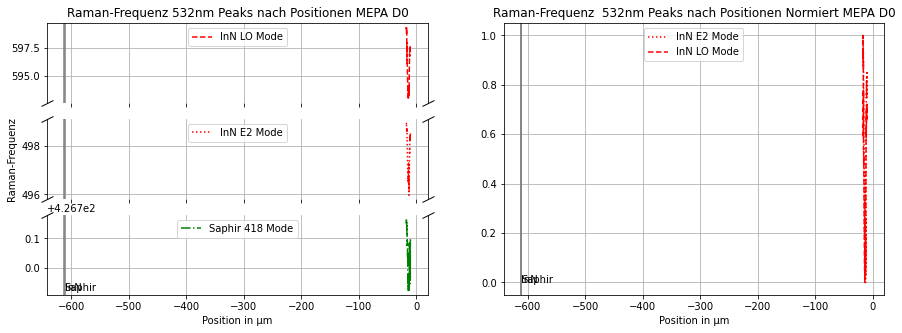

In [41]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_Saphir_418_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
 
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
   
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_Saphir_418_w,'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_w),s='InN')
ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_Saphir_418_w),s='Saphir')


# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Raman-Frequenz')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 532nm Peaks nach Positionen MEPA D0")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_w),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz  532nm Peaks nach Positionen Normiert MEPA D0")
ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2],y=0,s='InN')
ax4.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

plt.savefig('Bilder_Graphen_532nm/MEPA Raman-Frequenz Peaks nach Positionen D0 532nm')
plt.show()

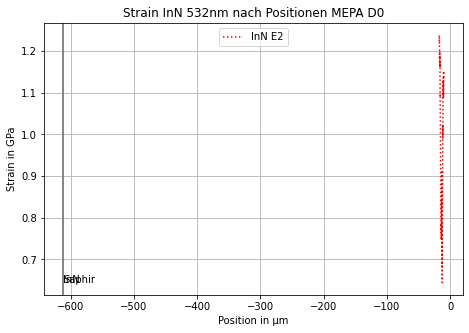

In [42]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain InN 532nm nach Positionen MEPA D0')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Strain_InN_E2_Liste),s='Saphir')
plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_532nm/MEPA Strain nach Positionen D0 532nm')
plt.show()

# A-plane Auswertung D1

Probenoberfläche vor Messung
<img src="Daten/a-plane_InN_Oberfläche_1a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten/a-plane_InN_Oberfläche_1b.jpg" style="width:300px;"/>

## Datenladen A-Plane

In [18]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "InN_a-plane L1065_Bild1_D1_2x60s.txt") as f1:
        data_aPlane_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_aPlane_array_str = np.array(data_aPlane_txt)               #in np array umwandeln um listen von listen zu entkommen
data_aPlane_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_aPlane_array_float = data_aPlane_array_str.astype(float)   #str zu float in Arrayform
print(data_aPlane_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_aPlane_array_float[0])):
    data_aPlane_array_float[0][k]=data_aPlane_array_float[0][k]-Verschiebung_A_plane
print(data_aPlane_array_float)

#kalibrieren der Positionen und skalieren der Tiefenachse
neue_null=-1.5
S=3.08
for l in range(len(data_aPlane_array_float)):
    data_aPlane_array_float[l][0]=data_aPlane_array_float[l][0] - neue_null
    if data_aPlane_array_float[l][0] <= 0:
        data_aPlane_array_float[l][0]=data_aPlane_array_float[l][0] * S

[[ 0.0000000e+00  7.9545685e+02  7.9498438e+02 ...  2.9403482e+02
   2.9352521e+02  2.9301349e+02]
 [ 0.0000000e+00  1.4046100e+00  1.4230600e+00 ...  1.1708500e+00
   1.1773900e+00  1.1956100e+00]
 [-1.0000000e-01  1.4587800e+00  1.4613700e+00 ...  1.1816400e+00
   1.1901900e+00  1.2015000e+00]
 ...
 [-3.8000000e+00  1.2217900e+00  1.2130000e+00 ...  1.0683600e+00
   1.0756200e+00  1.0825600e+00]
 [-3.9000000e+00  1.0753900e+00  1.0773900e+00 ...  9.7143400e-01
   9.6586200e-01  9.5775300e-01]
 [-4.0000000e+00  1.0517300e+00  1.0651700e+00 ...  9.0778300e-01
   8.9254900e-01  8.9462800e-01]]
[[-7.90178564e+00  7.87555064e+02  7.87082594e+02 ...  2.86133034e+02
   2.85623424e+02  2.85111704e+02]
 [ 0.00000000e+00  1.40461000e+00  1.42306000e+00 ...  1.17085000e+00
   1.17739000e+00  1.19561000e+00]
 [-1.00000000e-01  1.45878000e+00  1.46137000e+00 ...  1.18164000e+00
   1.19019000e+00  1.20150000e+00]
 ...
 [-3.80000000e+00  1.22179000e+00  1.21300000e+00 ...  1.06836000e+00
   1.07562

## Fitten und plotten A-Plane

Position: 1.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.40461 1.42306 1.43709 ... 1.17085 1.17739 1.19561]
Hintergrund Parameter:  [-5.86696117e-13  1.56531482e-09 -1.62748454e-06  8.22090323e-04
 -2.00526453e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.13324836256876002, 3.9267287488816076, 380.4599966570111]
Fitparameter Saphir 418: [0.5744529326932055, 2.2515028095922065, 418.6912541811236]
Fitparameter Saphir 432: [0.07330354562404903, 2.3828412766246174, 440.56714797334365]
Fitparameter Saphir 451: [0.2562011755676454, 7.645410217727414, 449.8082174105819]
Fitparameter InN E2: [0.9434740077429675, 8.116340600991139, 492.36859891208786]
Fitparameter Saphir 578: [9.331106115036326e-06, 2.5634812111936103e-07, 578.3629343156417]
Fitparameter InN LO: [1.6762098853563325, 18.292806884143964, 596.2953697047153]
Fitparameter Schulter 480: [0.2597414451501256, 10.721672440339459, 476.1452166724941]
Fitparameter Saphir 751

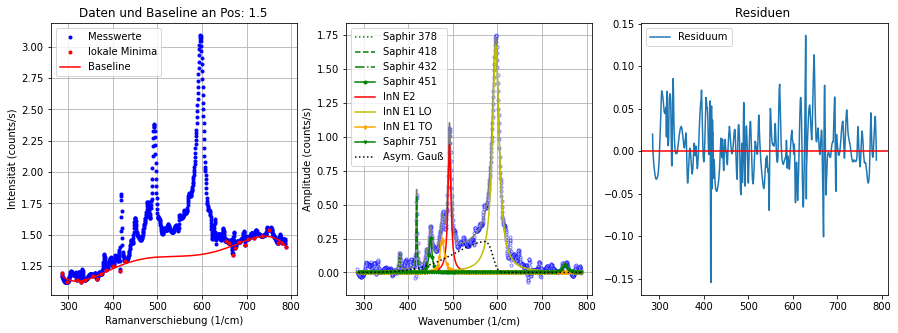

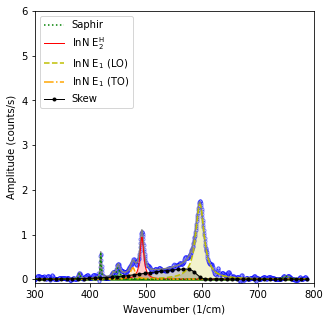

----------------------------------------------------------------------------------------------------
Position: 1.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.45878 1.46137 1.46407 ... 1.18164 1.19019 1.2015 ]
Hintergrund Parameter:  [-4.03145018e-13  1.09443073e-09 -1.15692267e-06  5.92091731e-04
 -1.45157529e-01  1.47891576e+01]
Fitparameter Saphir 378: [0.22472693116154285, 3.2405612286660874, 380.5724291766394]
Fitparameter Saphir 418: [0.6519527557164551, 2.1861746559058735, 418.451458907043]
Fitparameter Saphir 432: [0.030255014089845805, 0.5712491462305226, 428.7934760536935]
Fitparameter Saphir 451: [0.26213486291399446, 7.977713033541181, 449.7879632706847]
Fitparameter InN E2: [1.028535460837718, 8.321659167026336, 492.8768628856658]
Fitparameter Saphir 578: [0.05457260616949347, 3.863125427285555, 566.8437753521811]
Fitparameter InN LO: [1.915526108006914, 16.76421890755459, 596.0961922798841]
Fitparameter Schulte

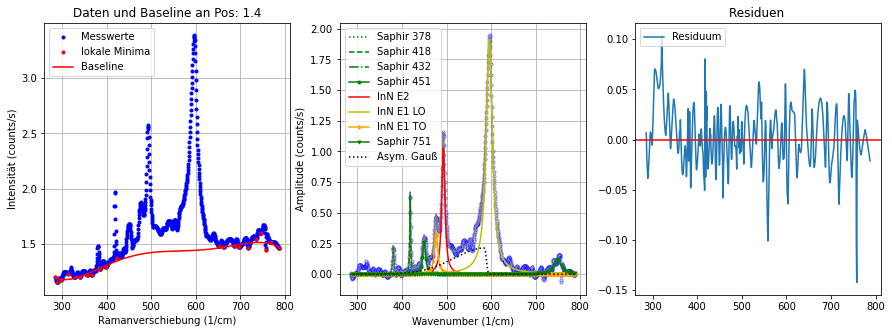

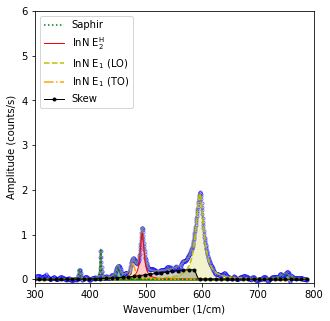

----------------------------------------------------------------------------------------------------
Position: 1.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.66161 1.64048 1.62186 ... 1.22432 1.20257 1.18023]
Hintergrund Parameter:  [-5.89148132e-14  2.21861055e-10 -2.96872872e-07  1.79293417e-04
 -4.82170704e-02  5.88242409e+00]
Fitparameter Saphir 378: [0.15036457697377548, 3.2778649902384656, 381.14362101469663]
Fitparameter Saphir 418: [0.6752691320549769, 1.7751218026389126, 418.3906864731545]
Fitparameter Saphir 432: [0.12462935796166487, 1.7550784962067725, 420.00057592362697]
Fitparameter Saphir 451: [0.31983317355868174, 8.606829065345268, 450.46844594786944]
Fitparameter InN E2: [1.087864845652391, 8.1749253050455, 492.8180299957745]
Fitparameter Saphir 578: [0.08365520533891017, 3.1053450798861624, 578.9876545608205]
Fitparameter InN LO: [1.9266236434049797, 15.817798481497372, 596.0573180418445]
Fitparameter Sch

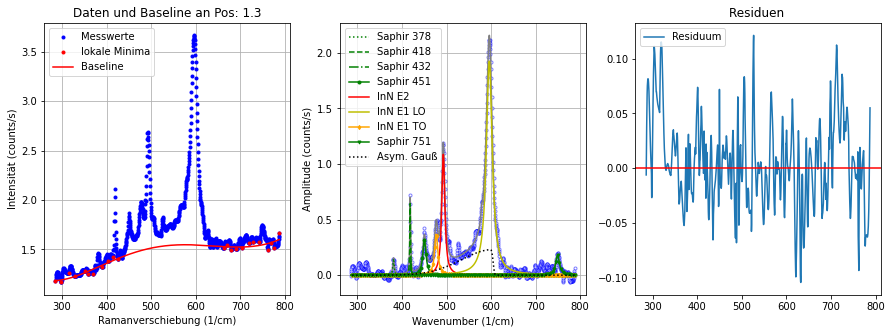

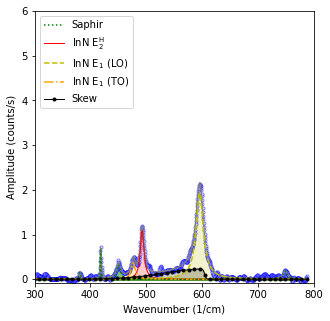

----------------------------------------------------------------------------------------------------
Position: 1.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.75972 1.74827 1.72444 ... 1.239   1.23808 1.2386 ]
Hintergrund Parameter:  [-1.40621909e-13  4.23585504e-10 -4.88712694e-07  2.66813850e-04
 -6.72807539e-02  7.54890722e+00]
Fitparameter Saphir 378: [0.03565922750178872, 357.68459659366465, 370.00000000000006]
Fitparameter Saphir 418: [0.7661658815817421, 1.63220883568652, 418.84995483475495]
Fitparameter Saphir 432: [0.05616059421685881, 2.908747195975953, 430.5962622498737]
Fitparameter Saphir 451: [0.39665055219601997, 8.037093871567055, 450.66135373645676]
Fitparameter InN E2: [1.2733991777354876, 8.303076942466362, 492.57926572138877]
Fitparameter Saphir 578: [14.304228225820037, 0.005915564934100933, 579.0405256375394]
Fitparameter InN LO: [2.166650790520949, 16.403664437110827, 596.1826775075231]
Fitparameter Sc

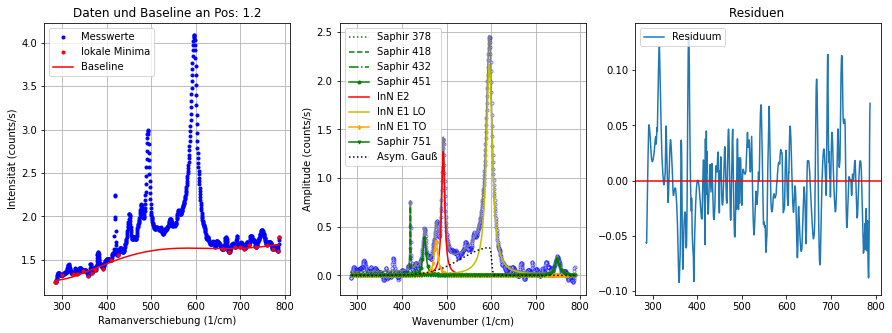

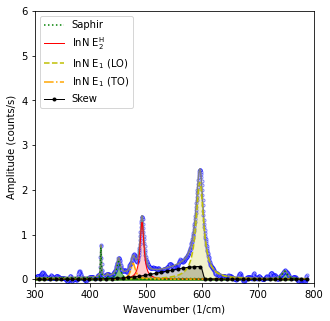

----------------------------------------------------------------------------------------------------
Position: 1.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.62996 1.69051 1.71021 ... 1.34155 1.34516 1.34245]
Hintergrund Parameter:  [-5.14067022e-13  1.41276076e-09 -1.51448648e-06  7.86781080e-04
 -1.95964065e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.2060785653437991, 3.236039951701799, 380.40762455333766]
Fitparameter Saphir 418: [0.8971169159158724, 1.9586520292675211, 418.79151820295306]
Fitparameter Saphir 432: [0.1158842675221493, 0.972378688105267, 420.59881767121783]
Fitparameter Saphir 451: [0.3976636786175767, 8.142635790083666, 450.0790327186712]
Fitparameter InN E2: [1.5652368522516154, 7.3938832244053305, 492.78581264106265]
Fitparameter Saphir 578: [0.16693294566102054, 9.015019352554123, 578.1312752554257]
Fitparameter InN LO: [2.528925812031001, 15.546091434254546, 595.7847183877919]
Fitparameter Schul

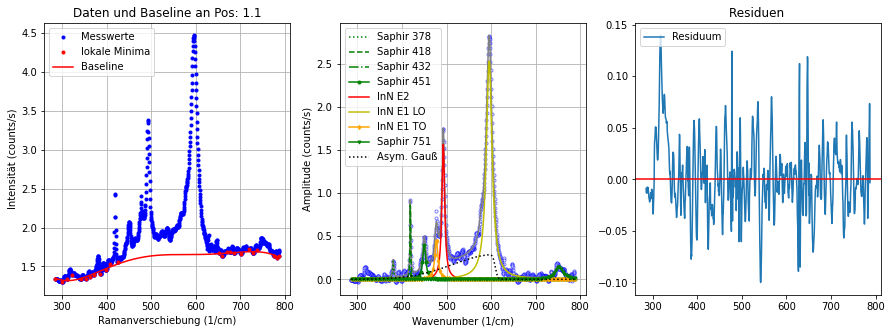

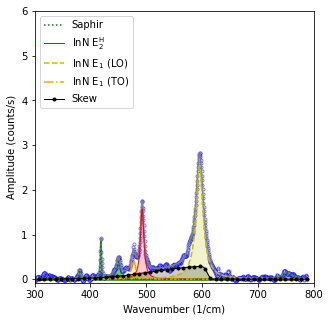

----------------------------------------------------------------------------------------------------
Position: 1.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.70695 1.69566 1.70566 ... 1.4384  1.44648 1.44254]
Hintergrund Parameter:  [-4.90387336e-13  1.36654052e-09 -1.48435579e-06  7.79237763e-04
 -1.95106597e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.19783980673889454, 6.85523328803774, 380.8673445151587]
Fitparameter Saphir 418: [0.7925754334417875, 2.5486103491291523, 418.5626833786621]
Fitparameter Saphir 432: [0.12758335772542967, 2.7883784993301517, 430.0729834708292]
Fitparameter Saphir 451: [0.42989202987996855, 8.736079992071037, 450.18806112211416]
Fitparameter InN E2: [1.7025272964959957, 8.288712234029823, 492.62615337433266]
Fitparameter Saphir 578: [0.11948252308246504, 9.999999999999998, 581.6162193681434]
Fitparameter InN LO: [2.774784362518092, 15.77203852531954, 595.997062235728]
Fitparameter Schulte

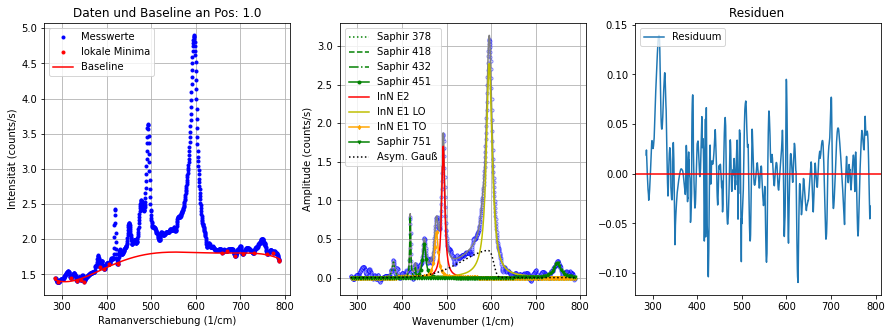

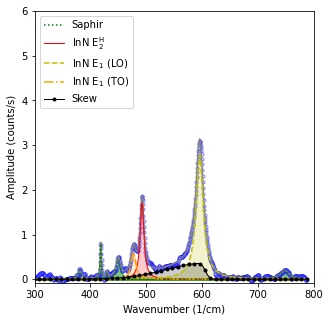

----------------------------------------------------------------------------------------------------
Position: 0.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.91648 1.87882 1.82404 ... 1.48175 1.43053 1.36681]
Hintergrund Parameter:  [-2.64548480e-13  6.81537420e-10 -6.74336386e-07  3.15714079e-04
 -6.76418250e-02  6.66894272e+00]
Fitparameter Saphir 378: [3.115559790909938e-08, 2.290458265549061e-08, 376.93815311170124]
Fitparameter Saphir 418: [1.0006905009786928, 1.835955357684371, 418.69451297318653]
Fitparameter Saphir 432: [0.022234080401195552, 0.032940628312320516, 431.6102346443079]
Fitparameter Saphir 451: [0.4976202284353298, 9.514409303422646, 450.06087886655115]
Fitparameter InN E2: [1.9202697569660692, 7.815291554722203, 492.60149813955906]
Fitparameter Saphir 578: [0.04088279812012954, 9.99994147322219, 581.9999999999999]
Fitparameter InN LO: [3.2728233587409052, 16.939190263249152, 596.1138755056402]
Fitparam

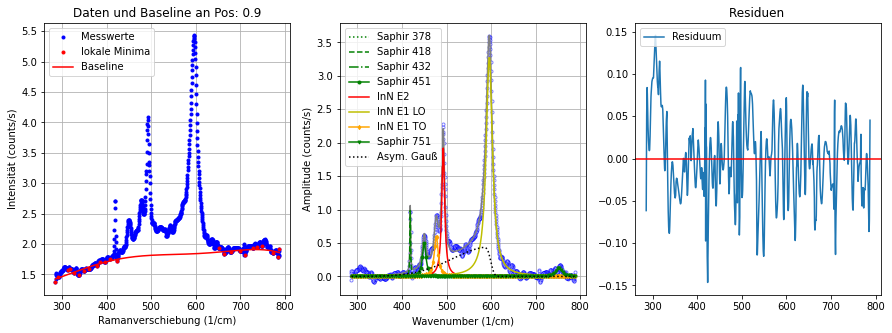

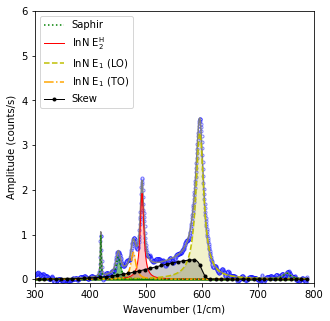

----------------------------------------------------------------------------------------------------
Position: 0.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.04147 2.06901 2.07602 ... 1.63747 1.65141 1.70382]
Hintergrund Parameter:  [-5.58539399e-13  1.51537908e-09 -1.59818762e-06  8.14006559e-04
 -1.97958560e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.15664116691788685, 5.295627374976537, 380.65277424006246]
Fitparameter Saphir 418: [1.1184417518353587, 2.27705347142651, 418.62014795260325]
Fitparameter Saphir 432: [0.059238077803581354, 4.7709031808408655, 435.38203398135147]
Fitparameter Saphir 451: [0.518905806420207, 9.97783023298587, 450.2387612307422]
Fitparameter InN E2: [2.138012116601075, 7.714219684769227, 492.4426498406581]
Fitparameter Saphir 578: [0.12004228050556648, 3.195536098308648, 574.0911572130904]
Fitparameter InN LO: [3.5307578525792964, 18.023190765070787, 595.6801109777746]
Fitparameter Schulte

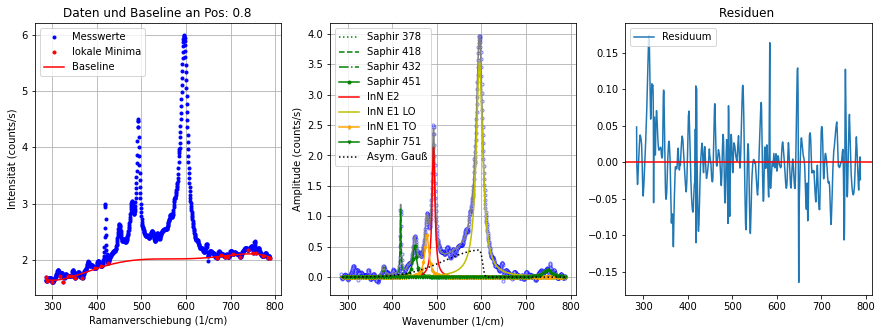

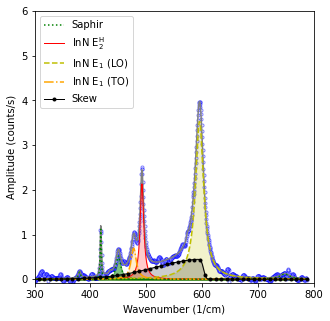

----------------------------------------------------------------------------------------------------
Position: 0.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.2582  2.2599  2.24601 ... 1.80345 1.83935 1.87421]
Hintergrund Parameter:  [-3.53058691e-13  1.07193288e-09 -1.25453506e-06  7.00691198e-04
 -1.84061934e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.1901289657945002, 6.4026791668140985, 380.34801483064774]
Fitparameter Saphir 418: [0.9632360955307637, 2.5190054209277006, 418.64674268772325]
Fitparameter Saphir 432: [0.039189055716810514, 0.06439094409590941, 428.983456967172]
Fitparameter Saphir 451: [0.6058017159187947, 9.999999999999998, 450.005125305097]
Fitparameter InN E2: [2.43230029259226, 7.743187271013163, 492.6228012478412]
Fitparameter Saphir 578: [0.21295919113411055, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [3.9193562242508726, 15.296934733691385, 595.6569874139805]
Fitparameter Schult

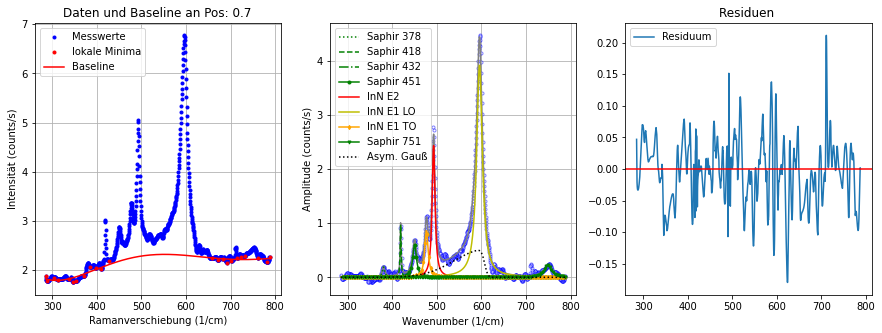

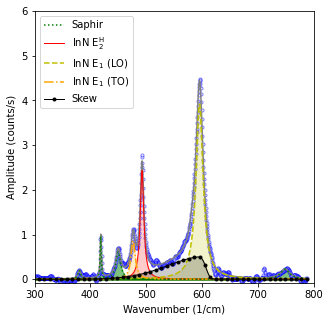

----------------------------------------------------------------------------------------------------
Position: 0.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.40719 2.39363 2.38402 ... 1.91449 1.90578 1.97368]
Hintergrund Parameter:  [-4.66731603e-13  1.31674060e-09 -1.44472115e-06  7.63283344e-04
 -1.91057281e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.14461465420699016, 3.25553748005749, 380.22662392045936]
Fitparameter Saphir 418: [1.2850738523633478, 2.161517002034377, 418.90759829154865]
Fitparameter Saphir 432: [0.11198015069519777, 4.471044156875703, 433.03840895535797]
Fitparameter Saphir 451: [0.7412577976539682, 9.360351304347379, 449.7133252973394]
Fitparameter InN E2: [2.814806195530512, 7.687273866222894, 492.6088078089056]
Fitparameter Saphir 578: [0.2680211269254097, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [4.333205839902992, 15.519786217379243, 595.7438894005414]
Fitparameter Schulter 

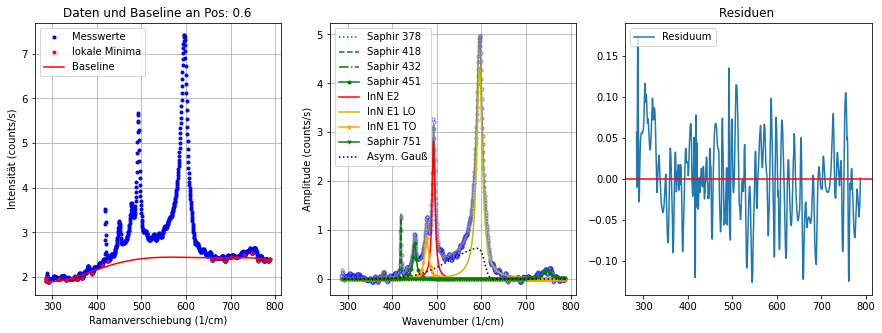

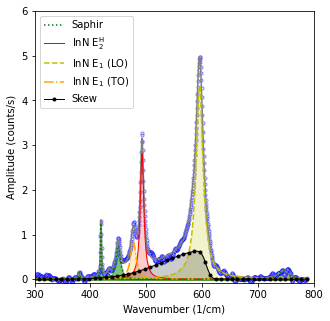

----------------------------------------------------------------------------------------------------
Position: 0.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.57129 2.56808 2.56982 ... 2.10872 2.09606 2.04598]
Hintergrund Parameter:  [-6.72661736e-13  1.78285992e-09 -1.82565103e-06  8.94921333e-04
 -2.06687068e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.16055662827980524, 2.899855226053322, 380.89369826615444]
Fitparameter Saphir 418: [1.0945925551176126, 2.6165893554518256, 418.71405819169394]
Fitparameter Saphir 432: [0.5008452682683638, 6.218180089223448, 447.2302288238618]
Fitparameter Saphir 451: [0.48522907429131124, 7.500071669627, 451.0192603640942]
Fitparameter InN E2: [3.1006657535788937, 8.140083662880954, 492.14838079314836]
Fitparameter Saphir 578: [0.11188136663639649, 9.999999999999998, 578.0046933101005]
Fitparameter InN LO: [4.818886698202522, 18.245795873977336, 595.6025843753573]
Fitparameter Schulter

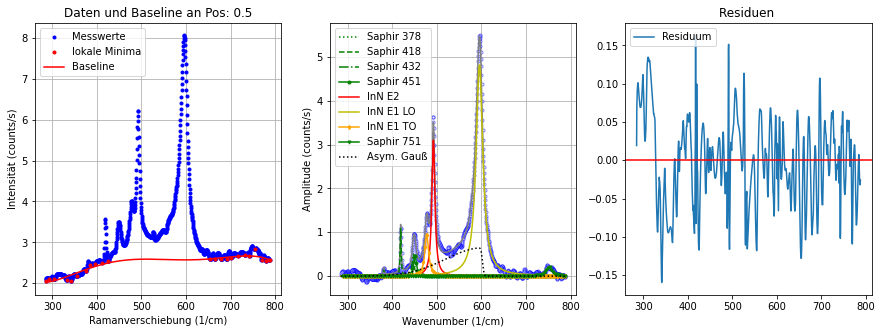

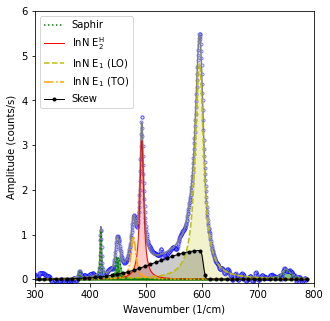

----------------------------------------------------------------------------------------------------
Position: 0.3999999999999999
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.86159 2.84196 2.84387 ... 2.37296 2.35419 2.31806]
Hintergrund Parameter:  [-6.45349459e-13  1.71385732e-09 -1.76077187e-06  8.67489525e-04
 -2.01726858e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.41863097201265187, 2.374187646513424, 380.55356390415744]
Fitparameter Saphir 418: [1.3404954151846897, 1.8774166772278602, 418.7095790416394]
Fitparameter Saphir 432: [0.10167390585908946, 0.6388854068569643, 430.8606871541726]
Fitparameter Saphir 451: [0.8699480543586707, 9.039997539080902, 449.06072762978886]
Fitparameter InN E2: [3.411122695336918, 7.90437377327001, 492.38061477027605]
Fitparameter Saphir 578: [0.17841333440156962, 9.999999999999998, 571.9340953720115]
Fitparameter InN LO: [6.1081298547292935, 16.400710618298152, 595.5778692490504]
Fit

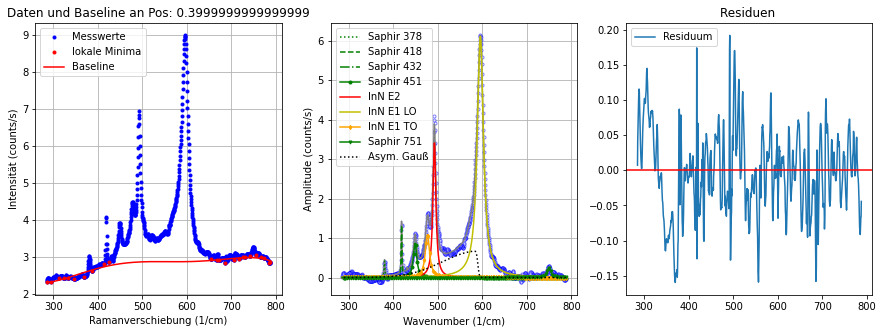

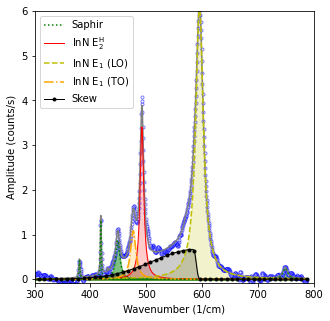

----------------------------------------------------------------------------------------------------
Position: 0.30000000000000004
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.20742 3.19799 3.19481 ... 2.46747 2.47389 2.46533]
Hintergrund Parameter:  [-3.71347469e-13  1.12132660e-09 -1.30032407e-06  7.15783624e-04
 -1.83457215e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.3352226459380384, 2.5940537663797145, 380.3620380533521]
Fitparameter Saphir 418: [1.5338728667807449, 2.479588717906747, 418.78076388301827]
Fitparameter Saphir 432: [0.04619316241784294, 3.142391530661434, 433.98507085616103]
Fitparameter Saphir 451: [1.0668122647211598, 9.999999999999998, 449.66249078209415]
Fitparameter InN E2: [3.6647742830029593, 8.361419842769148, 492.34690190752576]
Fitparameter Saphir 578: [0.43672303251084194, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [5.541615522307049, 15.73308550603992, 595.4255531643084]
Fit

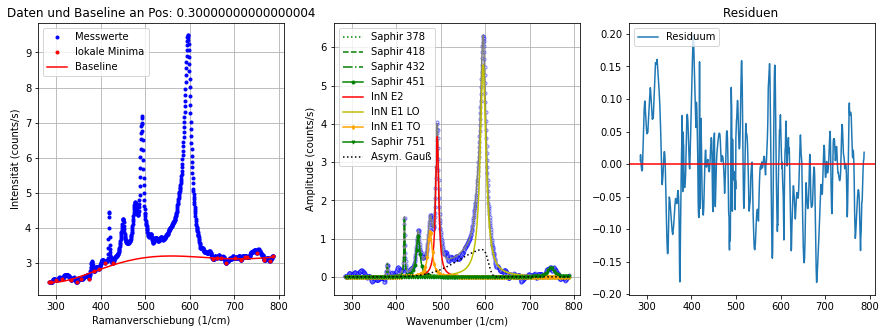

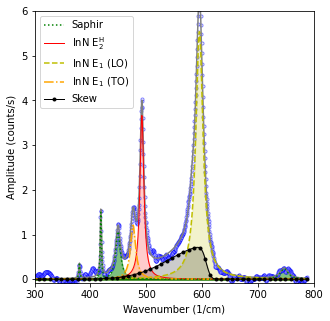

----------------------------------------------------------------------------------------------------
Position: 0.19999999999999996
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.28706 3.33365 3.35718 ... 2.69135 2.68974 2.70123]
Hintergrund Parameter:  [-5.95750844e-13  1.60731930e-09 -1.67808264e-06  8.38803385e-04
 -1.96809297e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.26626247273274717, 2.0428263714115573, 380.952115179952]
Fitparameter Saphir 418: [1.7827859837157343, 1.9211775288218358, 418.8042404092481]
Fitparameter Saphir 432: [0.9298118874846959, 0.06556844010788691, 420.73461348256274]
Fitparameter Saphir 451: [1.0211047806437061, 9.501171502345668, 449.622988030158]
Fitparameter InN E2: [3.883687347872998, 7.840207893517873, 492.39991637161916]
Fitparameter Saphir 578: [0.1780911253584619, 9.999999999999124, 576.5060506601093]
Fitparameter InN LO: [6.043751885141249, 17.11310716709694, 595.0685191133709]
Fitpar

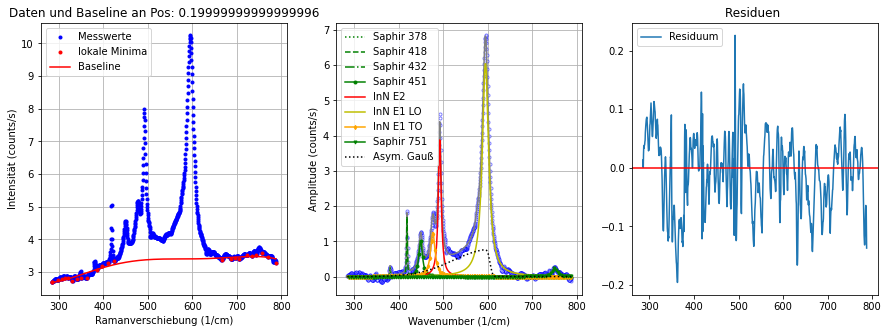

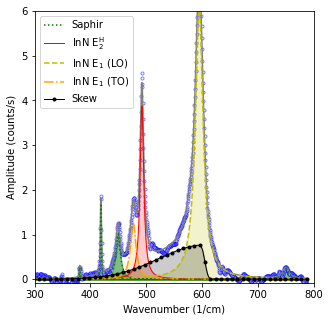

----------------------------------------------------------------------------------------------------
Position: 0.10000000000000009
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.72056 3.42383 3.44741 ... 2.80103 2.82696 2.93409]
Hintergrund Parameter:  [-5.91996679e-13  1.59137812e-09 -1.65985213e-06  8.30531239e-04
 -1.95024448e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.31184078081607475, 2.504482593487662, 380.5109220885851]
Fitparameter Saphir 418: [1.8707908886486457, 2.0416414531463456, 418.80982527627873]
Fitparameter Saphir 432: [0.11917823753517974, 2.831447596304538, 433.57791379063053]
Fitparameter Saphir 451: [1.2740488616755983, 9.999999999999998, 449.2979852833485]
Fitparameter InN E2: [4.3480017475028, 8.291254461321776, 492.1003822729134]
Fitparameter Saphir 578: [0.3183998710374303, 9.999999999999998, 581.2865441768898]
Fitparameter InN LO: [6.4644366192119245, 16.227774701136106, 594.9045344104455]
Fitpar

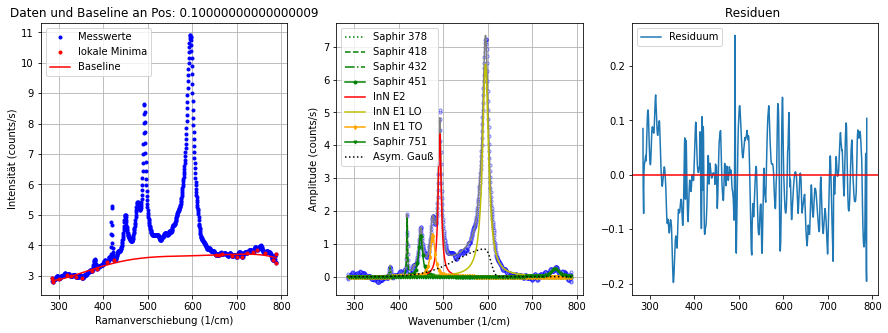

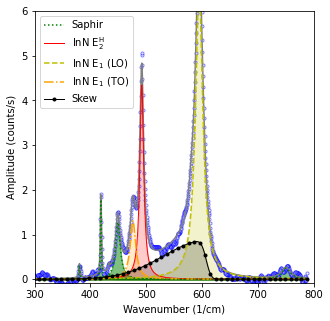

----------------------------------------------------------------------------------------------------
Position: 0.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.80656 3.85657 3.9591  ... 3.09566 3.09894 3.10381]
Hintergrund Parameter:  [-5.60217385e-13  1.52995045e-09 -1.61854030e-06  8.18413494e-04
 -1.92921170e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.4740955239452848, 2.0268399520016307, 380.45033685848426]
Fitparameter Saphir 418: [2.2843460963317663, 1.9192838194723338, 418.86348673056244]
Fitparameter Saphir 432: [0.06883642238302991, 1.626349187634842, 431.8424998627339]
Fitparameter Saphir 451: [1.2098982604561126, 8.929818586785883, 449.28454642984696]
Fitparameter InN E2: [4.501779951809287, 8.299030750243213, 492.0711215412396]
Fitparameter Saphir 578: [0.27739301749017375, 9.999999999999996, 581.9999999999999]
Fitparameter InN LO: [6.855405557925014, 15.870883075137176, 594.7355682114131]
Fitparameter Schult

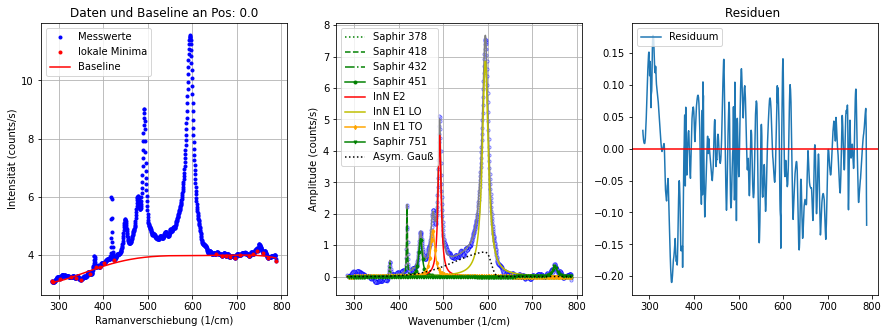

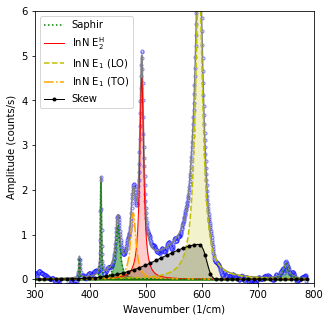

----------------------------------------------------------------------------------------------------
Position: -0.3080000000000003
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.89152 3.88758 3.90806 ... 3.07312 3.06079 3.08531]
Hintergrund Parameter:  [-5.52714513e-13  1.51147694e-09 -1.60329827e-06  8.13604721e-04
 -1.92416733e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.6806730237844012, 2.2534669218526955, 380.5745944848543]
Fitparameter Saphir 418: [1.7817463184393627, 2.676081539419175, 418.76742654025173]
Fitparameter Saphir 432: [0.17429847264221732, 7.261183281321626, 436.00947453659546]
Fitparameter Saphir 451: [1.3827312526059523, 7.936877357816814, 449.83165867500406]
Fitparameter InN E2: [4.881362612284963, 7.88499388400041, 492.32566009110775]
Fitparameter Saphir 578: [0.19847483845651107, 9.999999999999998, 570.9118401607865]
Fitparameter InN LO: [7.133528018408679, 16.94264695132633, 594.7581225240215]
Fitpa

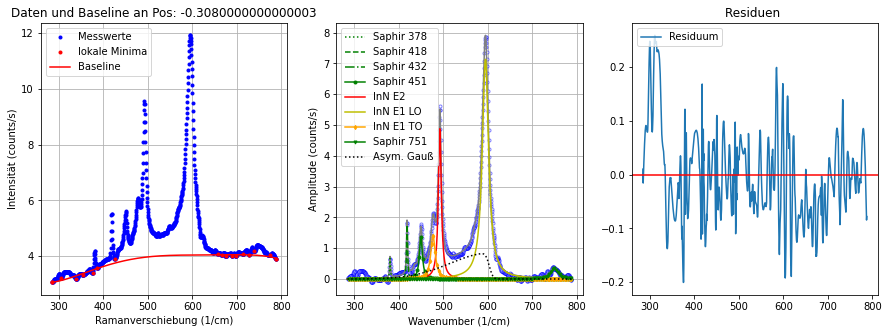

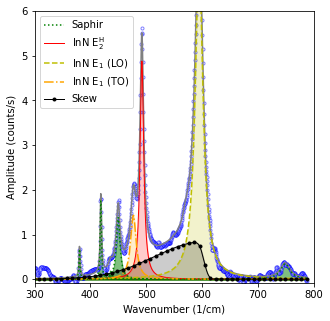

----------------------------------------------------------------------------------------------------
Position: -0.6159999999999999
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.84492 3.87116 3.90083 ... 3.33054 3.32324 3.3308 ]
Hintergrund Parameter:  [-4.63942017e-13  1.29404164e-09 -1.40969992e-06  7.39214934e-04
 -1.81776963e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.09894158590345109, 20.832206559200717, 394.99999999999994]
Fitparameter Saphir 418: [2.6028647135729073, 1.8214743621099696, 418.8451312623129]
Fitparameter Saphir 432: [0.11276338433335581, 3.6001776788037514, 433.0200227682636]
Fitparameter Saphir 451: [1.39567904442405, 9.999999999999998, 448.9637455060449]
Fitparameter InN E2: [5.08419465425094, 8.27689013536075, 492.1244651465425]
Fitparameter Saphir 578: [0.36755737884242506, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [7.3221987882566095, 15.431340706242601, 595.0166190292382]
Fitpar

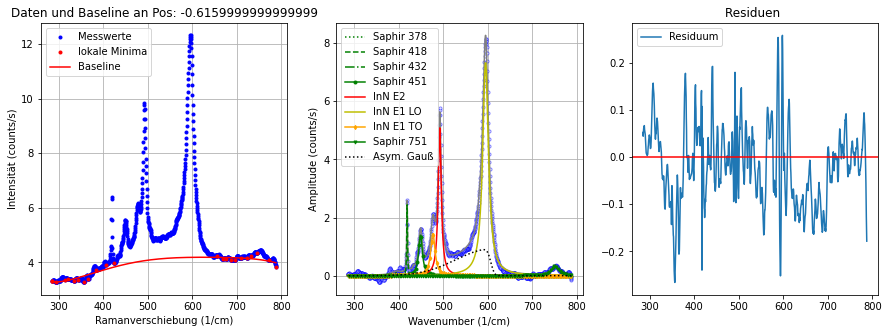

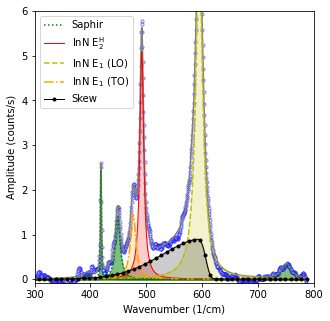

----------------------------------------------------------------------------------------------------
Position: -0.9240000000000002
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.11717 4.06483 4.01622 ... 3.26239 3.27932 3.304  ]
Hintergrund Parameter:  [-5.54543321e-13  1.51963881e-09 -1.60887289e-06  8.12759949e-04
 -1.91352994e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.07094195716614302, 15.009514405944513, 394.99999999999994]
Fitparameter Saphir 418: [2.824368464236132, 1.878599507950994, 418.8872448156936]
Fitparameter Saphir 432: [0.22280637846023577, 3.838592151108652, 432.66707653132005]
Fitparameter Saphir 451: [1.5325348269404182, 9.267361875895315, 449.31108292806357]
Fitparameter InN E2: [5.159427180774756, 8.185290933258855, 492.2357145915768]
Fitparameter Saphir 578: [0.21980381317199935, 6.504267153387081, 577.2627222865125]
Fitparameter InN LO: [7.620890008295136, 17.220069378332823, 594.8280929238541]
Fitp

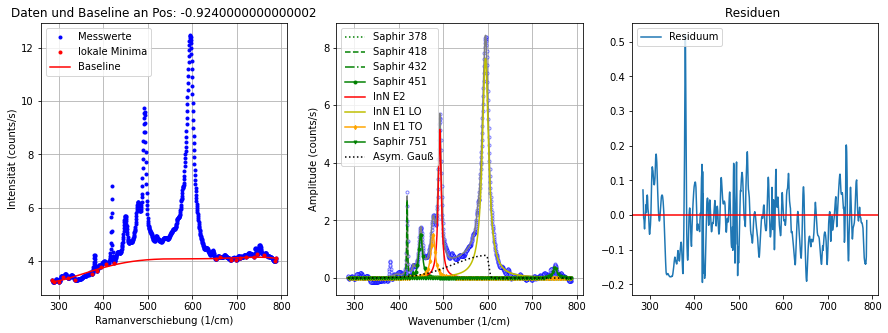

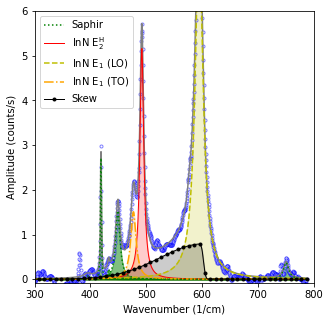

----------------------------------------------------------------------------------------------------
Position: -1.2319999999999998
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.79342 4.10009 4.08104 ... 3.06896 3.05115 3.0307 ]
Hintergrund Parameter:  [-3.62609286e-13  1.10349789e-09 -1.29132820e-06  7.13570244e-04
 -1.81143212e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.5924322058168411, 2.8649245657140994, 380.5271164642578]
Fitparameter Saphir 418: [2.768355425094585, 2.1068346997552125, 418.84032519906964]
Fitparameter Saphir 432: [0.1809949543473559, 6.883489182642445, 435.7080681602923]
Fitparameter Saphir 451: [1.4145256916575548, 9.955184726777828, 449.71829785561283]
Fitparameter InN E2: [5.335588745558533, 7.8814996866245055, 492.23594427859183]
Fitparameter Saphir 578: [0.40859518256702104, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [7.585675973721921, 15.119155595695055, 595.030534428898]
Fitpa

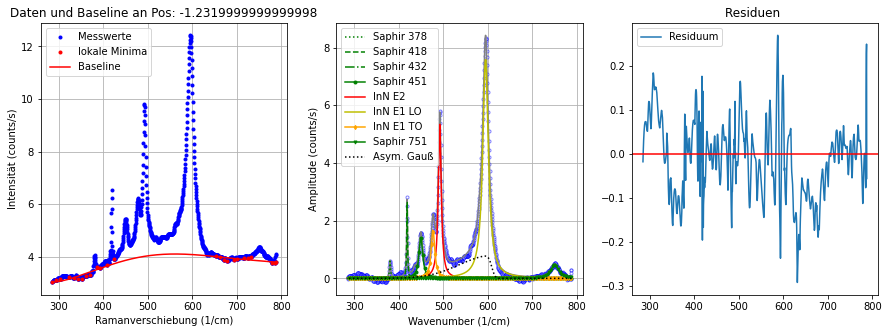

BILD an Pos:  -1.2319999999999998


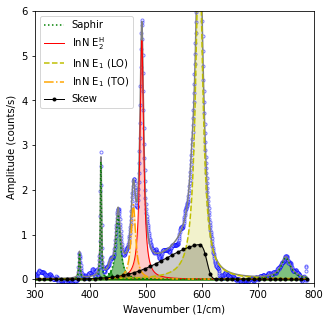

----------------------------------------------------------------------------------------------------
Position: -1.54
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.78624 3.75955 3.76065 ... 3.05129 3.03027 3.00624]
Hintergrund Parameter:  [-3.09796686e-13  1.00227090e-09 -1.22150702e-06  6.92904690e-04
 -1.79043127e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.5773005991139678, 2.6025849522679656, 380.3407183612103]
Fitparameter Saphir 418: [3.3523256435242925, 1.858806760522448, 418.96218942382086]
Fitparameter Saphir 432: [0.11371916481145676, 4.1649939126586055, 431.71798656581024]
Fitparameter Saphir 451: [1.5170696571283222, 9.20869342109168, 449.78928749861524]
Fitparameter InN E2: [5.590773736937289, 7.564284741660903, 492.26099799190524]
Fitparameter Saphir 578: [0.3266276656095201, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [7.738955707136334, 15.062851754033339, 595.1567081662289]
Fitparameter Schul

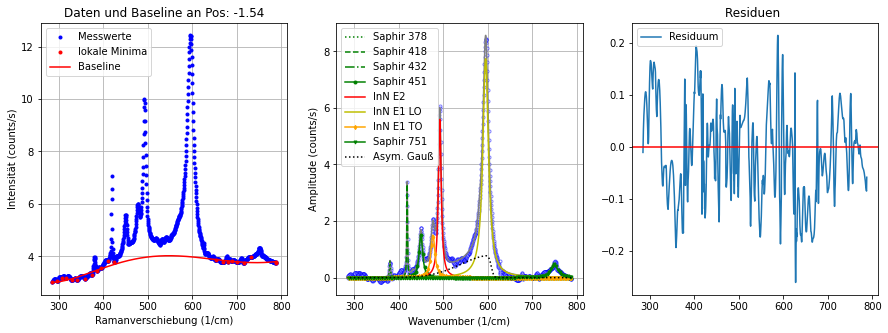

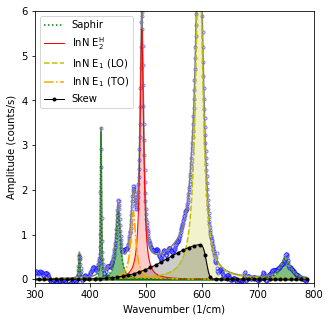

----------------------------------------------------------------------------------------------------
Position: -1.8480000000000003
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.45471 3.44468 3.44219 ... 2.79787 2.80639 2.81596]
Hintergrund Parameter:  [-5.97023041e-13  1.62097912e-09 -1.70195455e-06  8.52382792e-04
 -1.98780107e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.5629455217578166, 2.7758985277204555, 380.4292998390702]
Fitparameter Saphir 418: [2.911778080583168, 2.3817446223279943, 418.88103456823694]
Fitparameter Saphir 432: [0.20050799929950364, 2.4064084386196942, 431.1559134066783]
Fitparameter Saphir 451: [1.4425843315109441, 9.934031541156923, 449.32750528639025]
Fitparameter InN E2: [5.544108959321403, 7.6767188183297375, 492.45560613052464]
Fitparameter Saphir 578: [0.3449893794693806, 9.999999999999998, 581.9999999999998]
Fitparameter InN LO: [7.6865097813127, 15.429007947308495, 595.3690410658132]
Fitpa

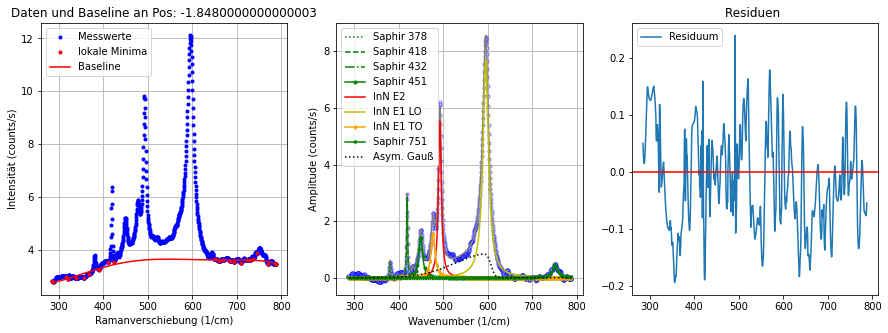

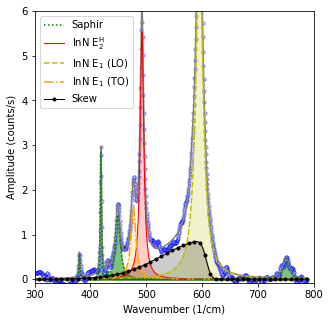

----------------------------------------------------------------------------------------------------
Position: -2.1560000000000006
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.19196 3.24866 3.31324 ... 2.71355 2.73745 2.78631]
Hintergrund Parameter:  [-5.06885997e-13  1.42387136e-09 -1.54509258e-06  7.98937776e-04
 -1.92624392e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.0681267371525415, 21.945090241247083, 394.99999999999983]
Fitparameter Saphir 418: [3.4874454112622915, 1.857527022919455, 418.85143864832764]
Fitparameter Saphir 432: [0.14126485483386841, 4.0461871214704255, 432.21398314558314]
Fitparameter Saphir 451: [1.5246372602373683, 8.67363366307197, 449.81595469804097]
Fitparameter InN E2: [5.507307114475512, 7.499878454885932, 492.4568527926665]
Fitparameter Saphir 578: [0.36209196401875293, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [7.826366305759063, 14.746052590341225, 595.4583682702656]
Fit

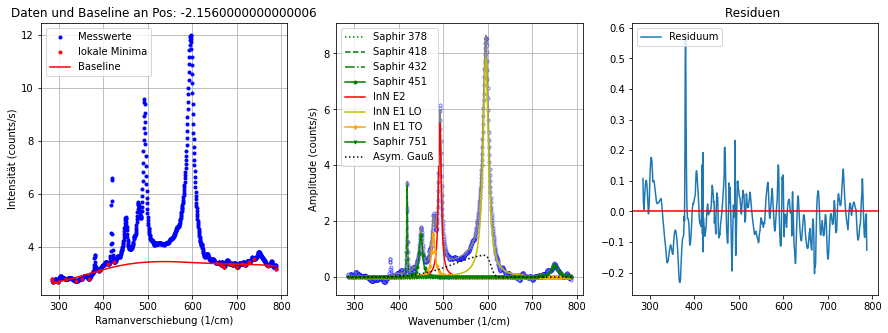

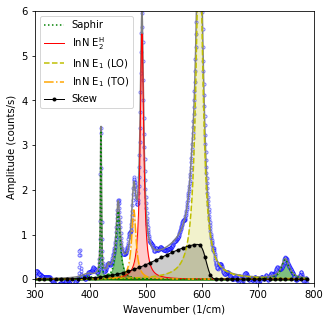

----------------------------------------------------------------------------------------------------
Position: -2.4639999999999995
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.00862 2.97889 2.96924 ... 2.48984 2.49609 2.52179]
Hintergrund Parameter:  [-6.87063681e-13  1.81191388e-09 -1.84556569e-06  8.98183123e-04
 -2.04978236e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.870479001873274, 1.9896408666659888, 380.5404199017972]
Fitparameter Saphir 418: [3.966842637439062, 1.8482916702582863, 418.9709299537895]
Fitparameter Saphir 432: [0.1272857807055431, 8.413938252472237, 435.9354292001199]
Fitparameter Saphir 451: [1.5156127064344762, 8.807060750054974, 449.80944884787624]
Fitparameter InN E2: [5.2778838313949485, 7.2683610456498995, 492.6005942164294]
Fitparameter Saphir 578: [0.2141687727903762, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [7.43538881451882, 15.438680574859445, 595.7096979255971]
Fitparam

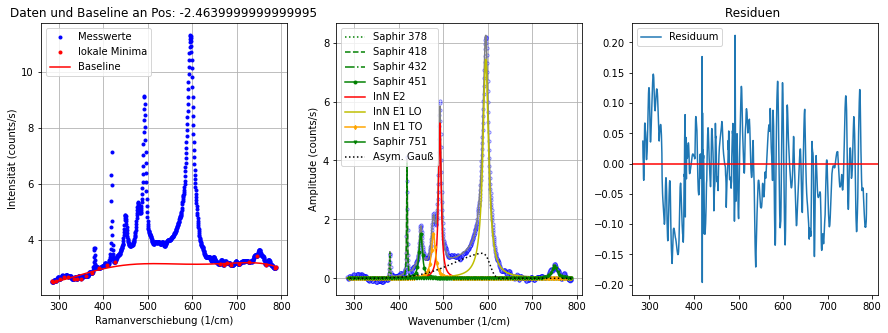

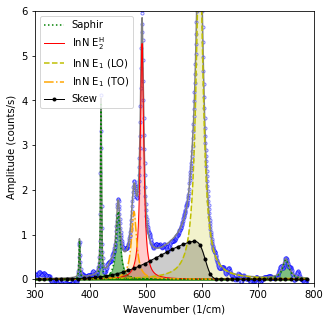

----------------------------------------------------------------------------------------------------
Position: -2.772
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.7196  2.7624  2.79744 ... 2.37059 2.39213 2.41462]
Hintergrund Parameter:  [-4.20773997e-13  1.23390416e-09 -1.39381571e-06  7.48872915e-04
 -1.87969998e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.8081644304244324, 2.19192798288898, 380.42025939848577]
Fitparameter Saphir 418: [3.6282388872314524, 2.13023128510438, 418.9100923572863]
Fitparameter Saphir 432: [0.23529222235376912, 27.052573441549658, 446.12052487741414]
Fitparameter Saphir 451: [1.2613324334580267, 6.820034763564966, 450.56657678000363]
Fitparameter InN E2: [5.047851872930904, 7.663534344624707, 492.59587449686455]
Fitparameter Saphir 578: [0.3312437230895318, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [6.997748073165528, 14.754496955393133, 595.8460060544039]
Fitparameter Schult

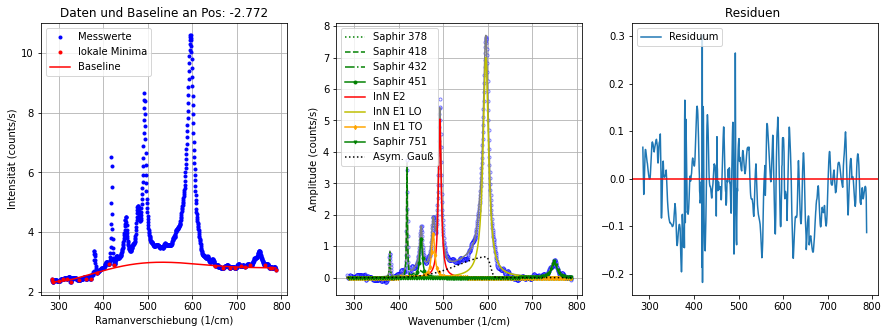

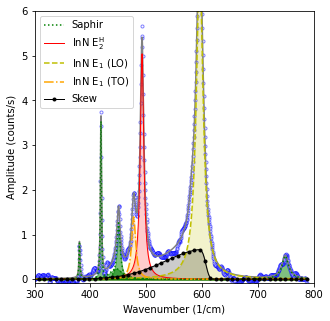

----------------------------------------------------------------------------------------------------
Position: -3.08
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.51924 2.50906 2.49927 ... 2.13925 2.10408 2.09902]
Hintergrund Parameter:  [-5.36407970e-13  1.49271546e-09 -1.60606583e-06  8.25076846e-04
 -1.98622808e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.9390579336975925, 2.258845489977028, 380.438297374668]
Fitparameter Saphir 418: [3.8319301164338118, 2.0158829700725285, 418.91549815088376]
Fitparameter Saphir 432: [0.173990887643693, 2.33510023734917, 432.33166236870176]
Fitparameter Saphir 451: [1.2602762805600543, 9.896412035638274, 449.7236662657754]
Fitparameter InN E2: [4.819162228427044, 7.1481876236697675, 492.69084495877985]
Fitparameter Saphir 578: [0.24463982949042373, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [6.586863378187615, 14.765448622856416, 595.6930367219273]
Fitparameter Schulter

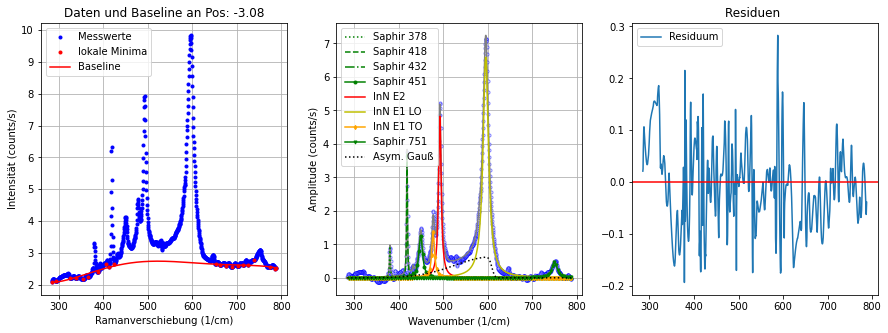

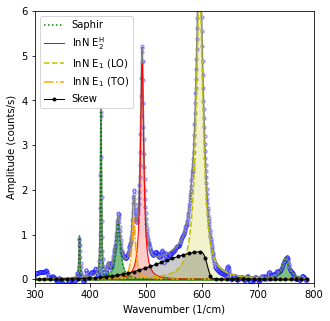

----------------------------------------------------------------------------------------------------
Position: -3.3880000000000003
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.29497 2.3119  2.32635 ... 2.05886 2.10751 2.15999]
Hintergrund Parameter:  [-3.07938032e-13  9.90373612e-10 -1.20902608e-06  6.92240365e-04
 -1.83024364e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.9674683431931915, 2.121237256860234, 380.71580659844165]
Fitparameter Saphir 418: [4.107306059488377, 2.0201418867915857, 418.9656585903066]
Fitparameter Saphir 432: [0.15748397283959514, 4.891392637200622, 432.7795994844944]
Fitparameter Saphir 451: [1.1705512870600998, 9.619547998080433, 449.7100872845133]
Fitparameter InN E2: [4.494473612446306, 7.635307932380036, 492.7370012026944]
Fitparameter Saphir 578: [0.16783714180784015, 9.999999999999998, 581.9999999999994]
Fitparameter InN LO: [6.240417605640168, 13.555754861911256, 595.7753959551512]
Fitpara

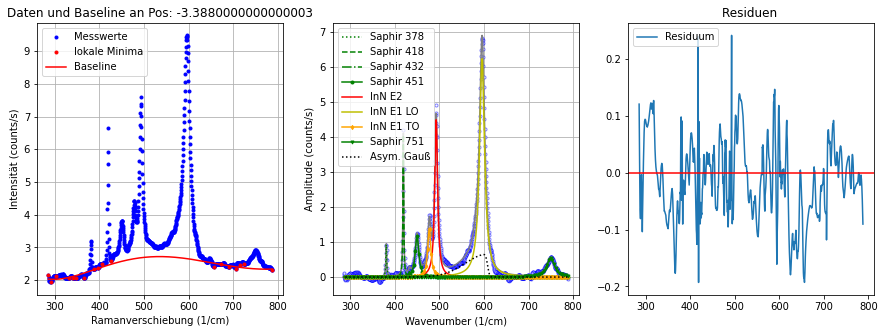

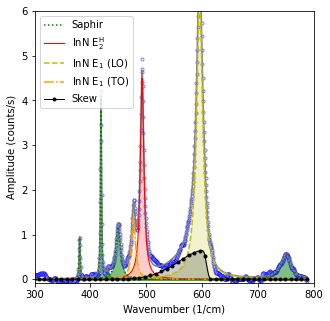

----------------------------------------------------------------------------------------------------
Position: -3.6960000000000006
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.19061 2.20475 2.21661 ... 1.98844 2.01267 2.04156]
Hintergrund Parameter:  [-4.16244344e-13  1.22815359e-09 -1.39549732e-06  7.53910503e-04
 -1.90546971e-01  2.00000000e+01]
Fitparameter Saphir 378: [0.7806534808464485, 1.8103146216110197, 380.58233138671676]
Fitparameter Saphir 418: [4.147156307124075, 1.9520586956199193, 418.96488044686856]
Fitparameter Saphir 432: [0.13795674313435297, 4.120817777466694, 432.5661910032564]
Fitparameter Saphir 451: [1.1408799655003623, 9.348443755140005, 450.1200722196942]
Fitparameter InN E2: [4.4037783263133, 7.181611094657067, 492.7343871007381]
Fitparameter Saphir 578: [0.16915027785435957, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [5.872018059549009, 14.363287331673755, 595.8764702187108]
Fitpara

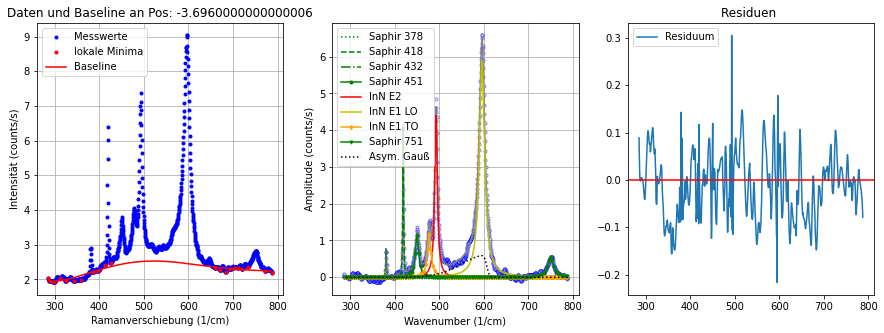

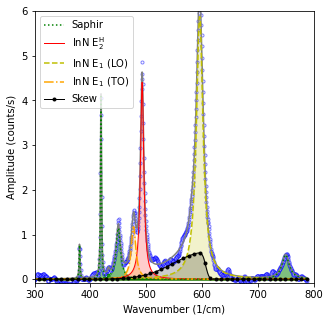

----------------------------------------------------------------------------------------------------
Position: -4.004
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.09675 2.09359 2.09042 ... 1.84222 1.85891 1.86419]
Hintergrund Parameter:  [-4.83676719e-13  1.37084549e-09 -1.50275019e-06  7.88149795e-04
 -1.94916375e-01  2.00000000e+01]
Fitparameter Saphir 378: [2.7863513880709267e-06, 3.2266569162554956e-06, 370.5820981384594]
Fitparameter Saphir 418: [4.544827452822745, 1.7327397339902293, 419.02439146766864]
Fitparameter Saphir 432: [0.11381141688828329, 9.578987528982449, 437.13264570033846]
Fitparameter Saphir 451: [1.0419094936012028, 7.406910907872568, 450.0036175760272]
Fitparameter InN E2: [4.08559805026127, 6.769344216235199, 492.7690106899811]
Fitparameter Saphir 578: [0.4086178002969677, 9.999996869179919, 581.976642013803]
Fitparameter InN LO: [5.62946744419374, 13.869509796816274, 596.0385606058687]
Fitparameter S

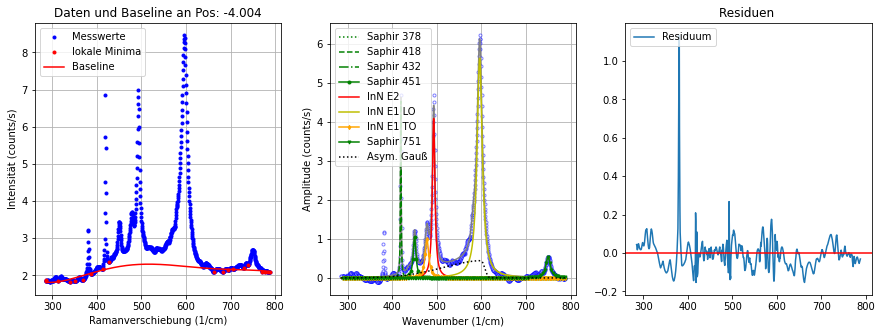

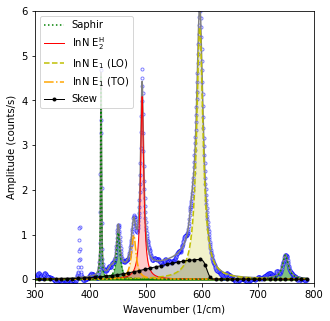

----------------------------------------------------------------------------------------------------
Position: -4.311999999999999
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.87438 1.91213 1.94648 ... 1.75728 1.73942 1.71982]
Hintergrund Parameter:  [-5.13848643e-13  1.44018093e-09 -1.56312002e-06  8.11910071e-04
 -1.98674413e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.0568957854616965, 2.3257664456909213, 380.5561724342503]
Fitparameter Saphir 418: [4.357907668190499, 1.9416661866886895, 419.0012075875975]
Fitparameter Saphir 432: [0.17537340135274376, 3.488398855818945, 431.57213242157064]
Fitparameter Saphir 451: [1.1108454804305803, 8.64640846065388, 450.06767403584587]
Fitparameter InN E2: [3.7292856716833733, 6.9961778084283655, 492.896840337494]
Fitparameter Saphir 578: [0.20761878727701152, 9.999999999999998, 579.4525173585818]
Fitparameter InN LO: [5.074625670853679, 13.865557429708876, 596.1128695528455]
Fitpar

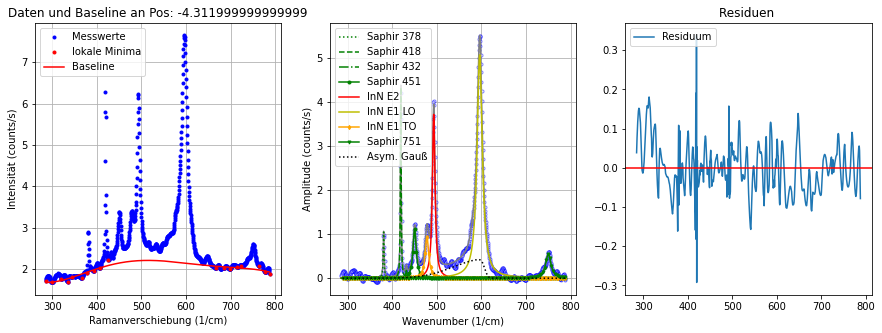

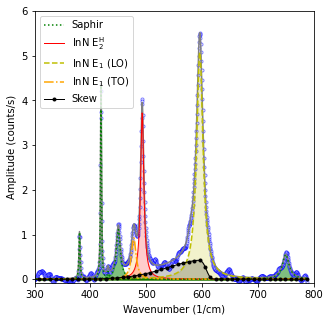

----------------------------------------------------------------------------------------------------
Position: -4.62
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.79365 1.80724 1.80754 ... 1.62006 1.63079 1.6158 ]
Hintergrund Parameter:  [-4.92691002e-13  1.39420784e-09 -1.52427548e-06  7.97512895e-04
 -1.97265154e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.1666450802315858, 2.476324908561818, 380.57279254314335]
Fitparameter Saphir 418: [4.848957640119583, 1.839362957435544, 418.9732785252657]
Fitparameter Saphir 432: [0.15945953474448324, 5.459204970813479, 432.8300646390624]
Fitparameter Saphir 451: [0.9523163173686799, 7.789389503381005, 450.08370953695277]
Fitparameter InN E2: [3.2388226992093663, 7.339387270572337, 492.75794619990273]
Fitparameter Saphir 578: [0.15600846902132925, 9.999999999999998, 581.0330658544026]
Fitparameter InN LO: [4.583364675757697, 14.319776471598804, 596.1031899270805]
Fitparameter Schult

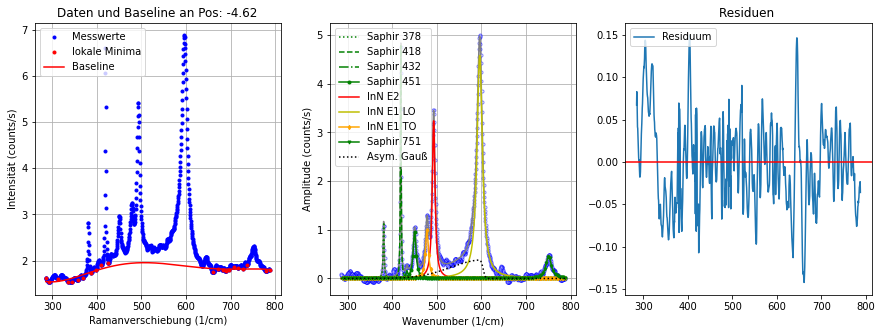

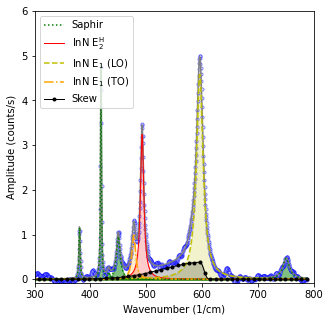

----------------------------------------------------------------------------------------------------
Position: -4.928000000000001
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.54258 1.68049 1.74183 ... 1.50703 1.50336 1.49982]
Hintergrund Parameter:  [-4.09668502e-13  1.20911854e-09 -1.37661229e-06  7.48051654e-04
 -1.91646923e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.2357191340454998, 1.935208928249817, 380.7865076027644]
Fitparameter Saphir 418: [4.5588984555993735, 1.9911700851771728, 419.02771371436825]
Fitparameter Saphir 432: [0.2139952317891866, 4.1893448560580655, 432.5417054486499]
Fitparameter Saphir 451: [0.7892868926396391, 8.99379293806684, 450.5543325034396]
Fitparameter InN E2: [2.9251123203289353, 7.510671856920037, 492.71442252572353]
Fitparameter Saphir 578: [0.12818500359457366, 9.999999999999998, 581.4301023669506]
Fitparameter InN LO: [4.088522730356443, 13.64606173472462, 596.0842710046668]
Fitpara

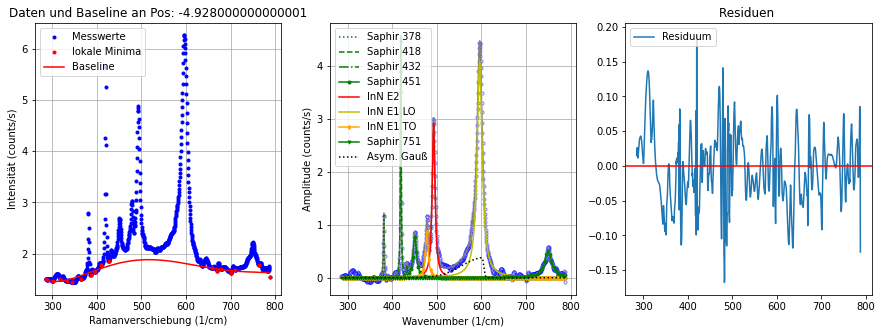

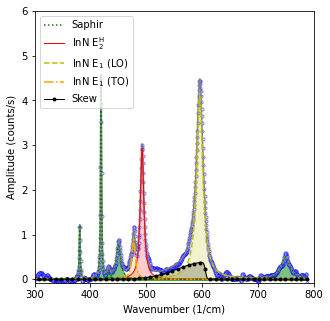

----------------------------------------------------------------------------------------------------
Position: -5.236000000000001
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.55673 1.56344 1.57951 ... 1.36178 1.33855 1.30251]
Hintergrund Parameter:  [-6.18048951e-13  1.66735617e-09 -1.73790366e-06  8.68922769e-04
 -2.06488143e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.243602901560022, 2.1347060849213313, 380.54116329234773]
Fitparameter Saphir 418: [4.785821381255496, 1.8950641678096518, 419.0523799140037]
Fitparameter Saphir 432: [0.240024262420055, 3.5167992377352224, 432.6964616857171]
Fitparameter Saphir 451: [0.7260534165853655, 8.390827606176703, 450.5383256577775]
Fitparameter InN E2: [2.7837360777769797, 6.820098234004832, 492.7907755769903]
Fitparameter Saphir 578: [0.13331147284102265, 2.478038369727978, 577.624025802069]
Fitparameter InN LO: [3.698266776562726, 15.719247510011279, 596.1997323841902]
Fitparame

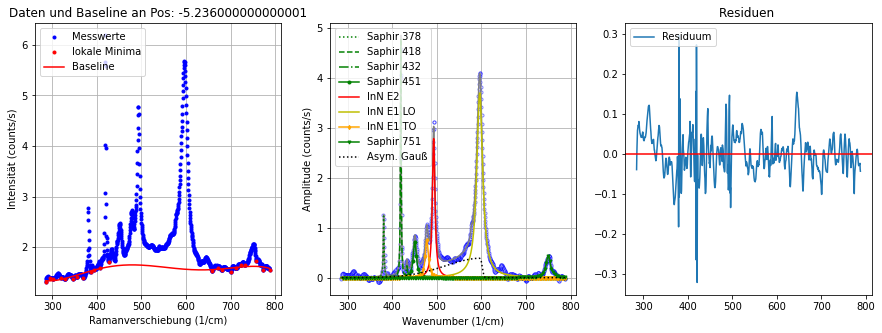

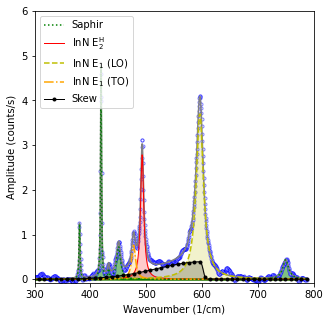

----------------------------------------------------------------------------------------------------
Position: -5.544
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.46253 1.46045 1.45942 ... 1.27849 1.25437 1.19016]
Hintergrund Parameter:  [-3.46828325e-13  1.07798683e-09 -1.27831530e-06  7.17840535e-04
 -1.89145776e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.3341502408055457, 2.039538490883132, 380.54335615223863]
Fitparameter Saphir 418: [4.870742955620669, 1.8681346423956355, 419.0397477956031]
Fitparameter Saphir 432: [0.1404776341005234, 3.6928539559525997, 431.70670045730776]
Fitparameter Saphir 451: [0.6688156529548019, 8.460272910277439, 450.4302682380211]
Fitparameter InN E2: [2.456880037201931, 6.8971929816425375, 493.00613687661587]
Fitparameter Saphir 578: [0.18954645561826827, 6.280259643886998, 579.0342865506913]
Fitparameter InN LO: [3.3755710475478455, 13.765751304136518, 596.2308499373181]
Fitparameter Sch

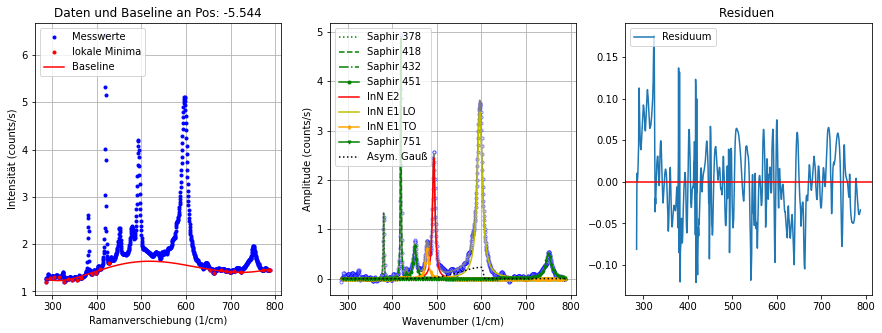

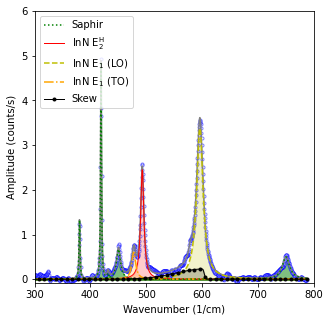

----------------------------------------------------------------------------------------------------
Position: -5.851999999999999
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.35018 1.35234 1.35846 ... 1.17935 1.18958 1.20289]
Hintergrund Parameter:  [-4.75237016e-13  1.30391293e-09 -1.38898271e-06  7.14003017e-04
 -1.75793186e-01  1.77919264e+01]
Fitparameter Saphir 378: [1.2859910240657082, 2.2681668556160735, 380.51370083946506]
Fitparameter Saphir 418: [5.150856472163185, 1.9839357813403442, 419.0481136629936]
Fitparameter Saphir 432: [0.2199008730152906, 4.548561139440356, 433.4175969036512]
Fitparameter Saphir 451: [0.6529512212039749, 7.776579480893954, 450.0140203355871]
Fitparameter InN E2: [2.2765731666124953, 6.487445124438757, 492.93887709710356]
Fitparameter Saphir 578: [0.22987130373984765, 2.5183951801152373, 577.5246751958556]
Fitparameter InN LO: [2.957537480759284, 15.547664445187817, 596.4418392861242]
Fitpa

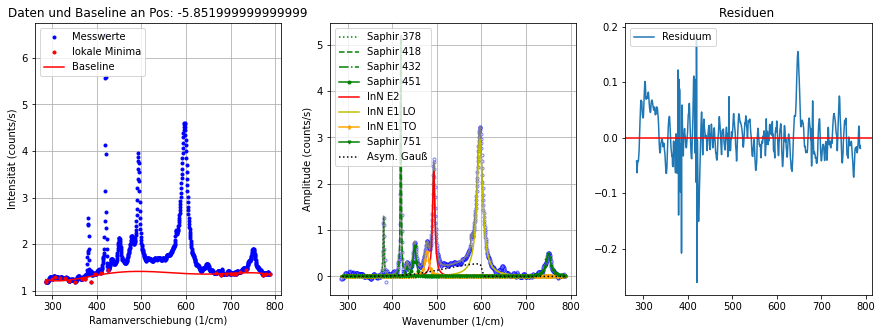

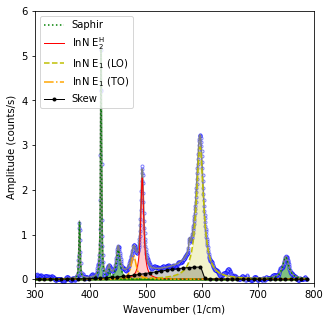

----------------------------------------------------------------------------------------------------
Position: -6.16
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.30158 1.29789 1.29485 ... 1.16118 1.13528 1.12902]
Hintergrund Parameter:  [-4.60958451e-13  1.32783928e-09 -1.47578646e-06  7.84628659e-04
 -1.97613167e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.2510190696808479, 2.229237286829673, 380.6700354715161]
Fitparameter Saphir 418: [5.0004777451327715, 1.8819927294373864, 419.0652776980463]
Fitparameter Saphir 432: [0.1084843905800896, 2.0822396349964185, 431.915703780733]
Fitparameter Saphir 451: [0.5681658570558924, 6.288834444038517, 450.23787660111265]
Fitparameter InN E2: [1.9621931053538029, 6.522987713246256, 492.81453057461584]
Fitparameter Saphir 578: [0.14233141574365887, 9.999999999999998, 581.9999999999999]
Fitparameter InN LO: [2.6061346743802414, 12.861315734407377, 596.2382441097486]
Fitparameter Schul

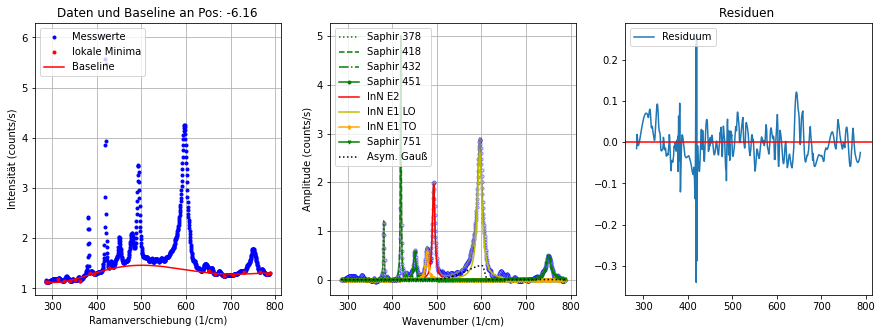

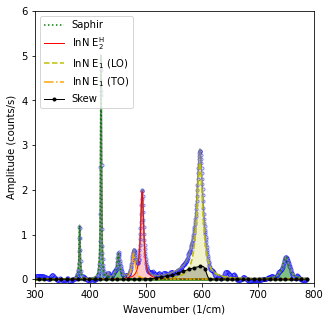

----------------------------------------------------------------------------------------------------
Position: -6.468000000000001
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.20652 1.2096  1.21164 ... 1.17811 1.17374 1.16141]
Hintergrund Parameter:  [-5.65416249e-13  1.53693899e-09 -1.62131159e-06  8.25587726e-04
 -2.01659645e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.279008817072395, 2.2857334525583055, 380.67940635880564]
Fitparameter Saphir 418: [5.206030751725066, 1.8228850065424493, 419.04528238289714]
Fitparameter Saphir 432: [0.26588619757698234, 4.042900791131536, 432.4751877873448]
Fitparameter Saphir 451: [0.4930920278340425, 7.904580407615625, 450.6258379378556]
Fitparameter InN E2: [1.7164543109544044, 7.203901621148579, 492.931411475492]
Fitparameter Saphir 578: [0.14643433334843056, 6.641157444334978, 577.126493385995]
Fitparameter InN LO: [2.659258482010218, 14.635172442811566, 596.3603694100691]
Fitparam

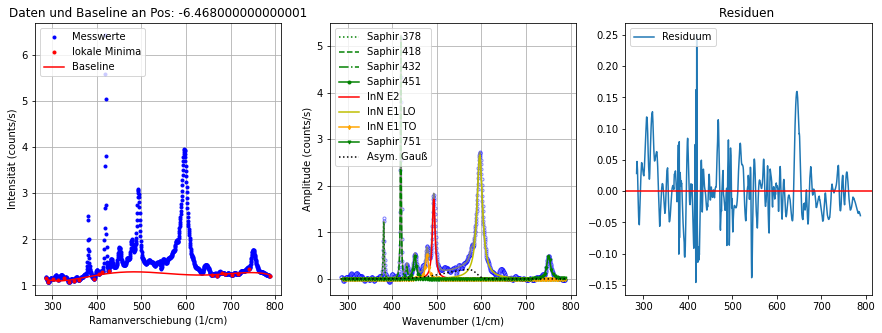

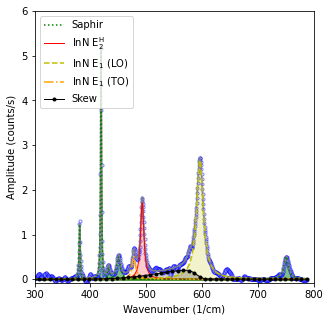

----------------------------------------------------------------------------------------------------
Position: -6.776000000000001
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.1888  1.16714 1.1648  ... 1.05707 1.0562  1.05619]
Hintergrund Parameter:  [-4.76822705e-13  1.34841529e-09 -1.47816186e-06  7.80063645e-04
 -1.96655224e-01  2.00000000e+01]
Fitparameter Saphir 378: [1.2878736282303251, 2.0265975377196073, 380.62346896313267]
Fitparameter Saphir 418: [5.37769693710137, 1.7437146459243673, 419.0985292140014]
Fitparameter Saphir 432: [0.2439007378159501, 4.264012216326844, 432.16877888735473]
Fitparameter Saphir 451: [0.5796530441594342, 6.284942172068924, 450.066968141282]
Fitparameter InN E2: [1.6865480169861669, 7.299198267084699, 492.94679101398987]
Fitparameter Saphir 578: [0.1035949708776577, 3.0451907018730977, 577.5349070475911]
Fitparameter InN LO: [2.33188021444264, 14.353427430592113, 596.4527198098701]
Fitparam

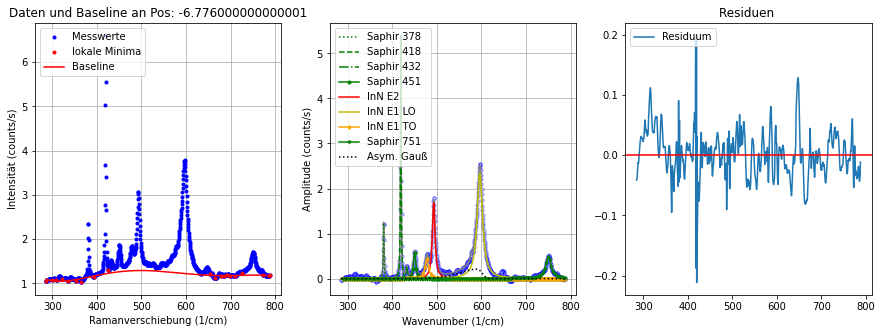

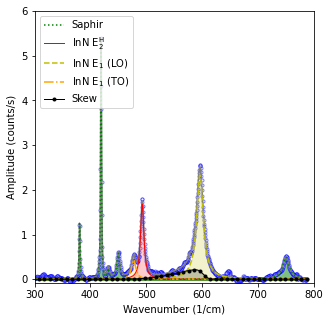

----------------------------------------------------------------------------------------------------
Position: -7.084
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.22179 1.213   1.20494 ... 1.06836 1.07562 1.08256]
Hintergrund Parameter:  [-3.46564240e-13  1.06355106e-09 -1.24927529e-06  6.97743572e-04
 -1.83975726e-01  1.93943324e+01]
Fitparameter Saphir 378: [1.5178108103533996, 1.8882839232203754, 380.7098193311853]
Fitparameter Saphir 418: [5.056613177279718, 1.9090614974145927, 419.05146048432977]
Fitparameter Saphir 432: [0.13433002972759964, 3.3203318316852233, 433.2352821057786]
Fitparameter Saphir 451: [0.46106138253909157, 4.8120276127755055, 450.70588120807105]
Fitparameter InN E2: [1.628871913968108, 6.2786238136212775, 493.2092023788264]
Fitparameter Saphir 578: [0.22543915325983485, 4.6875912227748335, 577.8485001868465]
Fitparameter InN LO: [2.178399632560156, 13.278151634180698, 596.3047939418177]
Fitparameter 

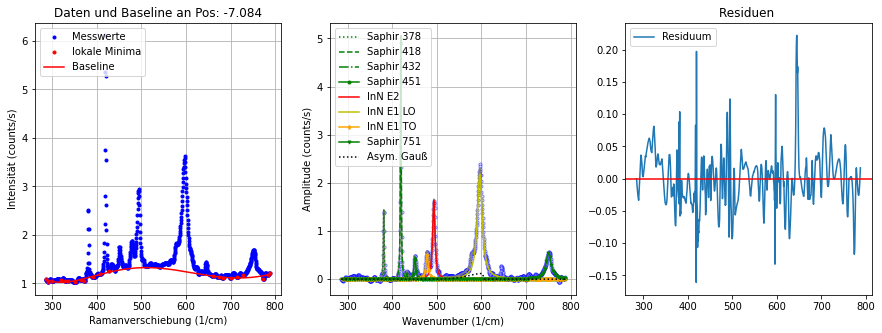

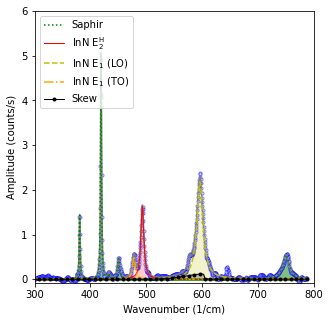

----------------------------------------------------------------------------------------------------
Position: -7.3919999999999995
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.07539  1.07739  1.07972  ... 0.971434 0.965862 0.957753]
Hintergrund Parameter:  [-5.37511632e-13  1.48084508e-09 -1.57885620e-06  8.09692098e-04
 -1.98428006e-01  1.95585658e+01]
Fitparameter Saphir 378: [1.4670653540090928, 1.9155339284772432, 380.55079401861144]
Fitparameter Saphir 418: [5.19743412798863, 1.8820008465960467, 419.0491223997394]
Fitparameter Saphir 432: [0.24511365517280762, 3.4400341787027284, 432.59000979177915]
Fitparameter Saphir 451: [0.4289350091765001, 7.400922640316712, 450.358759464582]
Fitparameter InN E2: [1.4749467696555039, 6.054741234930231, 492.9141063529313]
Fitparameter Saphir 578: [0.19987866194283802, 5.1783598521647125, 578.8664103530083]
Fitparameter InN LO: [2.0508321350199497, 13.608711589706052, 596.236886998407

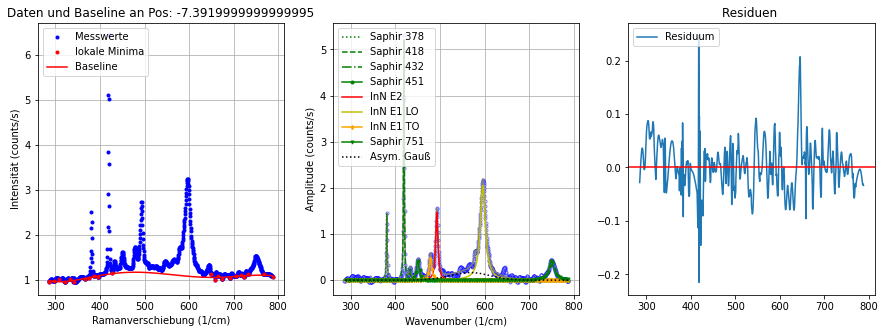

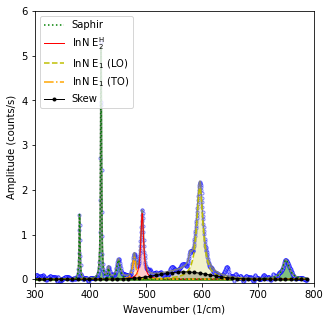

----------------------------------------------------------------------------------------------------
Position: -7.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [1.05173  1.06517  1.07827  ... 0.907783 0.892549 0.894628]
Hintergrund Parameter:  [-3.44718057e-13  9.08610050e-10 -9.21208359e-07  4.45658155e-04
 -1.01828198e-01  9.72099331e+00]
Fitparameter Saphir 378: [1.4307598463417994, 1.9735809748353519, 380.6348604974637]
Fitparameter Saphir 418: [5.23350485336277, 1.919801551008264, 419.0059517965729]
Fitparameter Saphir 432: [0.31938557018277725, 2.781807220122038, 431.77990679378433]
Fitparameter Saphir 451: [0.49165621350967337, 5.382882403386717, 450.129960721967]
Fitparameter InN E2: [1.2702705905577678, 6.949741628047767, 492.99004599836763]
Fitparameter Saphir 578: [0.1251438871155635, 3.181750320405859, 577.6789467514279]
Fitparameter InN LO: [1.796149107046369, 15.342964217977396, 597.0377593334835]
Fitparameter Sch

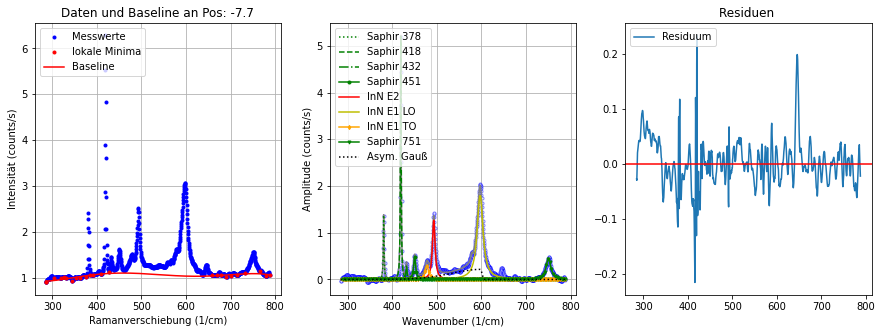

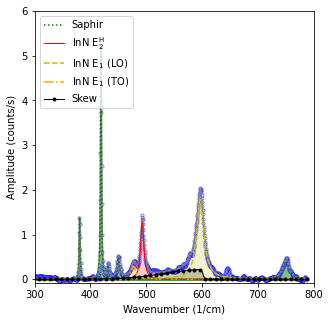

----------------------------------------------------------------------------------------------------


In [19]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Saphir_575_Peaks_Liste=[]
Asymm_Gauß_1_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_aPlane_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_aPlane_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_aPlane_array_float[0],[0])
        y=np.delete(data_aPlane_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=9)[0]]
        xzw=x[argrelextrema(y, np.less,order=9)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for j in range(len(xzw)):
            if xzw[j]<=430 or xzw[j]>=650:
                xmin.append(xzw[j])
                ymin.append(yzw[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1]) 
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [-0.1, 0.1, 0.1, 0.1, -0.1, 14]
        param_bounds_base = ([-1,0,-np.inf,-np.inf,-np.inf,0],[0,1,np.inf,np.inf,0,20])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        #fitten 4 lorentz in saphir_418, InN E2 498, Saphir_575, InN LO 595 + AG 
        #def L_x4_AG(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4,amp,fwhm, pos, shape):
        #init_vals_L_x4_AG = [1,1,426, 5,1,498, 1,1,575, 1,1,595, 1,70,550,19]
        #param_bounds_L_x4_AG= ([0,0,410, 0,0,485, 0,0,565, 0,0,585, 0,50,525,0],
        #                       [np.inf,np.inf,430, np.inf,12,505, np.inf,30,685, np.inf,30,605, 100,100,600,100])
        #fitParams_L_x4_AG, cov_L_x4_AG = curve_fit(f=L_x4_AG, xdata=x, ydata=y_glatt, p0=init_vals_L_x4_AG, bounds=param_bounds_L_x4_AG)
        #fitParams_L_Saphir_418=[fitParams_L_x4_AG[0],fitParams_L_x4_AG[1],fitParams_L_x4_AG[2]]
        #fitParams_L_InN_E2=[fitParams_L_x4_AG[3],fitParams_L_x4_AG[4],fitParams_L_x4_AG[5]]
        #fitParams_L_Saphir_575=[fitParams_L_x4_AG[6],fitParams_L_x4_AG[7],fitParams_L_x4_AG[8]]
        #fitParams_L_InN_LO=[fitParams_L_x4_AG[9],fitParams_L_x4_AG[10],fitParams_L_x4_AG[11]]
        #fitParams_AG=[fitParams_L_x4_AG[12],fitParams_L_x4_AG[13],fitParams_L_x4_AG[14],fitParams_L_x4_AG[15]]
        #print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        #print("Fitparameter InN E2:",fitParams_L_InN_E2)
        #print("Fitparameter InN LO:",fitParams_L_InN_LO)
        #print("Fitparameter Saphir 575: ", fitParams_L_Saphir_575)
        #print("Fitparameter Asymmetrischer Gauß: ", fitParams_AG)
        
        #fitten 9 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 498, saphir_578, InN LO 595, Schulter 580, saphir_751,
        #+ 1Asymmetrischer Gauß
        #L_x9_AG_x1(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape):
        # 9 Lorentzpeaks + 1 Asymmetrischer gauß
        init_vals_L_x9_AG_x1 = [1,1,378, 1,1,418, 1,1,432, 1,1,451, 1,1,498, 1,1,578, 1,1,595, 1,1,475, 1,1,751, 1,100,608,-14]
        param_bounds_L_x9_AG_x1= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,490, 0,0,565, 0,0,585, 0,0,470, 0,0,735, 0,0,590,-30],
                          [np.inf,np.inf,395, np.inf,np.inf,430, np.inf,np.inf,460, np.inf,10,470, np.inf,np.inf,510, np.inf,10,582, np.inf,np.inf,610, np.inf,np.inf,485, np.inf,np.inf,760, 20,np.inf,635,np.inf])
        fitParams_L_x9_AG_x1, cov_L_x9_AG_x1 = curve_fit(f=L_x9_AG_x1, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x1, bounds=param_bounds_L_x9_AG_x1)
        fitParams_L_Saphir_378=[fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2]]
        fitParams_L_Saphir_418=[fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5]]
        fitParams_L_Saphir_432=[fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8]]
        fitParams_L_Saphir_451=[fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11]]
        fitParams_L_InN_E2=[fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14]]
        fitParams_L_Saphir_578=[fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17]]
        fitParams_L_InN_LO=[fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20]]
        fitParams_L_Schulter_480=[fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23]]
        fitParams_L_Saphir_751=[fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26]]
        fitParams_AG_1=[fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]]
        #fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
        print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
        print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter Schulter 480:",fitParams_L_Schulter_480)
        print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
        print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
            
            

        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        

            # Plot für Daten glatt und peaks
        #plt.subplot(1, 3, 2)
        #plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        #plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        #plt.plot(x,L_x4_AG(x, fitParams_L_x4_AG[0],fitParams_L_x4_AG[1],fitParams_L_x4_AG[2], fitParams_L_x4_AG[3],fitParams_L_x4_AG[4],fitParams_L_x4_AG[5],fitParams_L_x4_AG[6],fitParams_L_x4_AG[7],fitParams_L_x4_AG[8],fitParams_L_x4_AG[9],fitParams_L_x4_AG[10],fitParams_L_x4_AG[11],fitParams_L_x4_AG[12],fitParams_L_x4_AG[13],fitParams_L_x4_AG[14],fitParams_L_x4_AG[15]), color='dimgray'  ,markersize=1, label='Einhüllende')
        #plt.plot(x,L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), color='gray'  ,markersize=2, label='Einhüllende')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0], fitParams_L_Saphir_418[1], fitParams_L_Saphir_418[2]), color='g'  ,markersize=3, label='Saphir 418')
        #plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0], fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_575[0], fitParams_L_Saphir_575[1], fitParams_L_Saphir_575[2]),':', color='g'  ,markersize=3, label='Saphir 575')
        #plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0], fitParams_L_InN_LO[1], fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
        #plt.plot(x,asymmgauss(x, fitParams_AG[0], fitParams_AG[1], fitParams_AG[2], fitParams_AG[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
        #plt.xlabel('Ramanverschiebung (1/cm)')
        #plt.ylabel('Intensität (counts/s)')
        #plt.grid(True)
        #plt.legend(loc='upper left')
        
        # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        #plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), color='gray'  ,markersize=2) #, label='Einhüllende'
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
        plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
        plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN E1 LO')
        plt.plot(x,Lorentz(x, fitParams_L_Schulter_480[0],fitParams_L_Schulter_480[1],fitParams_L_Schulter_480[2]),'-d', markevery=8, color='orange'  ,markersize=3, label='InN E1 TO')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
        plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asym. Gauß')
        plt.xlabel('Wavenumber (1/cm)')
        plt.ylabel('Amplitude (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        #plt.plot(x,y_glatt-L_x4_AG(x, fitParams_L_x4_AG[0],fitParams_L_x4_AG[1],fitParams_L_x4_AG[2], fitParams_L_x4_AG[3],fitParams_L_x4_AG[4],fitParams_L_x4_AG[5],fitParams_L_x4_AG[6],fitParams_L_x4_AG[7],fitParams_L_x4_AG[8],fitParams_L_x4_AG[9],fitParams_L_x4_AG[10],fitParams_L_x4_AG[11],fitParams_L_x4_AG[12],fitParams_L_x4_AG[13],fitParams_L_x4_AG[14],fitParams_L_x4_AG[15]), label=("a-plane Residuum"))
        plt.plot(x,y_glatt-L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
        
        #if i == data_aPlane_array_float.shape[0]/2-1:
        #    print("BILD an Pos: ", position)
        #    plt.savefig('Bilder_Graphen_532nm/A-Plane Auswertung D1 532nm Position '+ str(position) + '.png')
        #if i == 2:
        #    print("BILD an Pos: ", position)
        #    plt.savefig('Bilder_Graphen_532nm/A-Plane Auswertung D1 532nm Position '+ str(position) + '.png')
        #if i == data_aPlane_array_float.shape[0]-1:
        #    print("BILD an Pos: ", position)
        #    plt.savefig('Bilder_Graphen_532nm/A-Plane Auswertung D1 532nm Position '+ str(position) + '.png')   
        plt.show()
        
        
        fig = plt.figure(figsize=(5,5))
        #plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), color='gray'  ,markersize=2) #, label='Einhüllende'
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir')#, label='Saphir 378'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]), color='g', alpha=.5)
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),':', color='g'  ,markersize=3)#, label='Saphir 418'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]), color='g', alpha=.5)
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),':', color='g'  ,markersize=3)#, label='Saphir 432'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]), color='g', alpha=.5)
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),':', color='g'  ,markersize=3)#, label='Saphir 451'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]), color='g', alpha=.5)
        
        plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  , linewidth=1  ,markersize=3, label='InN $\mathregular{E_2^H}$')
        plt.fill_between(x,0,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r', alpha=.2)
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
        plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]),'--', color='y'  ,markersize=3, label='InN $\mathregular{E_1}$ (LO)')
        plt.fill_between(x,0,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y', alpha=.2)
        plt.plot(x,Lorentz(x, fitParams_L_Schulter_480[0],fitParams_L_Schulter_480[1],fitParams_L_Schulter_480[2]),'-.', markevery=8, color='orange'  ,markersize=3, label='InN $\mathregular{E_1}$ (TO)')
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Schulter_480[0],fitParams_L_Schulter_480[1],fitParams_L_Schulter_480[2]), color='orange', alpha=.2)
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),':', markevery=8, color='g'  ,markersize=3)#, label='Saphir 751'
        plt.fill_between(x,0,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]), color='g', alpha=.5)
        
        plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),'-o',markevery=20, linewidth=1  ,markersize=3, color='black'  , label='Skew')
        plt.fill_between(x,0,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]), color='black', alpha=.2)
        
        plt.xlabel('Wavenumber (1/cm)')
        plt.ylabel('Amplitude (counts/s)')
        #plt.grid(True)
        plt.legend(loc='upper left')
        plt.xlim(300,800)
        plt.ylim(-0.08,6)
        if i == data_aPlane_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/A-Plane Auswertung D1 532nm Position '+ str(position) + '.png')
        plt.show()
     
    
    
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Saphir_418_Peaks_Liste.append([position, fitParams_L_Saphir_418])
        #Saphir_575_Peaks_Liste.append([position, fitParams_L_Saphir_575])
        Asymm_Gauß_1_Liste.append([position,fitParams_AG_1])
        Baseline_Liste.append([position,fitParams_base])
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

asymm gauß 1


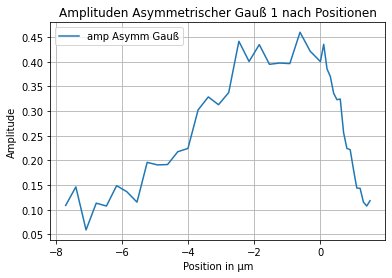

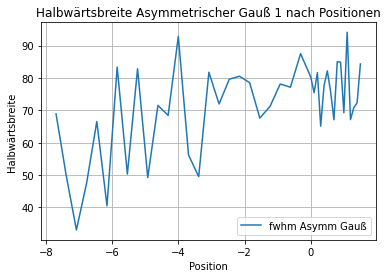

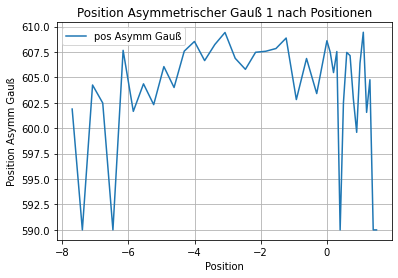

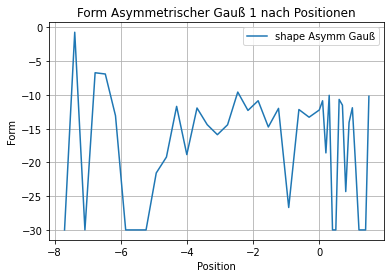

---------------------------------------------------------------------------------


In [20]:
# Verhalten Asymmetrischer Gauß und Baseline
# mittlung der Asymm Gauß parameter und abweichungen

print("asymm gauß 1")
Positionen=[]
Asymm_Gauß_1_Liste_Amp=[]
Asymm_Gauß_1_Liste_fwhm=[]
Asymm_Gauß_1_Liste_pos=[]
Asymm_Gauß_1_Liste_shape=[]
for i in range(len(Asymm_Gauß_1_Liste)):
    Positionen.append(Asymm_Gauß_1_Liste[i][0])
    Asymm_Gauß_1_Liste_Amp.append(Asymm_Gauß_1_Liste[i][1][0])
    Asymm_Gauß_1_Liste_fwhm.append(Asymm_Gauß_1_Liste[i][1][1])
    Asymm_Gauß_1_Liste_pos.append(Asymm_Gauß_1_Liste[i][1][2])
    Asymm_Gauß_1_Liste_shape.append(Asymm_Gauß_1_Liste[i][1][3])
    
#print("Asymmetrischer Gauß 1 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_Amp), "\nMin: ", min(Asymm_Gauß_1_Liste_Amp))

#print("Asymmetrischer Gauß 1 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_1_Liste_fwhm))

#print("Asymmetrischer Gauß 1 Position:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_pos), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_pos), "\nMin: ", min(Asymm_Gauß_1_Liste_pos))

#print("Asymmetrischer Gauß 1 Form:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_shape), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_shape), "\nMin: ", min(Asymm_Gauß_1_Liste_shape))


#Plotten
plt.title('Amplituden Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_Amp ,markersize=2, label='amp Asymm Gauß') 
plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Halbwärtsbreite Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Halbwärtsbreite')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Position Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_pos ,markersize=2, label='pos Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Position Asymm Gauß')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Form Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_shape ,markersize=2, label='shape Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Form')
plt.grid(True)
plt.legend()
plt.show()

print("---------------------------------------------------------------------------------")

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
 #   Base_Para_3.append(Baseline_Liste[k][1][2])
 #   Base_Para_4.append(Baseline_Liste[k][1][3])
#    Base_Para_5.append(Baseline_Liste[k][1][4])
#    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()##

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')#
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()
#
#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [   3.25904799    4.03502941 -327.34925542  408.30359402    3.22433325]
Asym Gauß LO Parameter Amp-R: [   4.27820087    5.3954302   324.09674132 -407.36674239    4.70618685]
Gauß E2 Parameter Amp-R: [ 6.58512207 -6.4225649  -2.20478326 -0.89699447]
Gauß LO Parameter Amp-R: [ 8.7503677   6.12383668 -2.00000655 -0.66408879]


c:\users\f.h\appdata\local\programs\python\python39\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


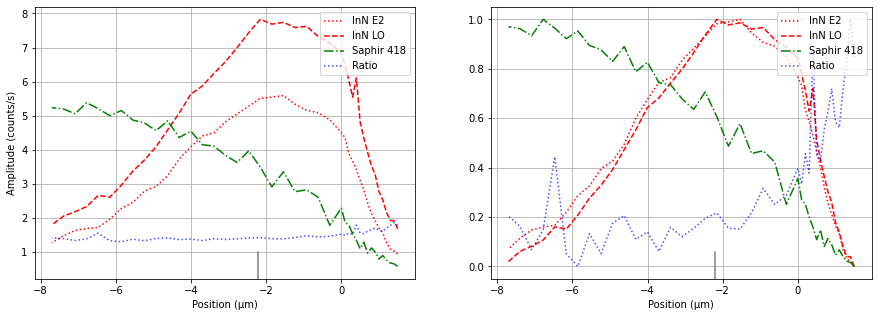

<Figure size 1080x1080 with 0 Axes>

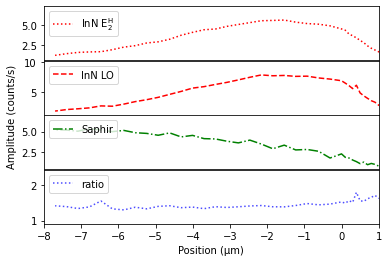

In [21]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_Saphir_418_Amp=[]
Peak_Saphir_575_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])
    #Peak_Saphir_575_Amp.append(Saphir_575_Peaks_Liste[i][1][0])
 
    
Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    
#Fitten Asym Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,-2,0,1]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,-2,0,1]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 

    
    
#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,-2,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,-2,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 

    
    
    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
#plt.title('Amplituden 532nm Peaks nach Positionen A-Plane D1')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_Amp, '-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp,':', alpha=0.7, color='b'  ,markersize=2, label='Ratio') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='InN E2 Fitt Asym')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='InN LO Fitt Asym')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO lorentz')

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_Amp),s='InN')
#plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Peak_Saphir_418_Amp),s='Saphir')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.xlabel('Position (\u03bcm)')
plt.ylabel('Amplitude (counts/s)')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
#plt.title('Amplituden 532nm Peaks nach Positionen Normiert A-Plane D1')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp), '-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2, label='Ratio') #, markerfacecolor='w', alpha=0.5

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=0,s='InN')
#plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.xlabel('Position (\u03bcm)')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

# plt.savefig('Bilder_Graphen_532nm/A-Plane Amplituden Peaks nach Positionen D1 532nm')
plt.show()



fig = plt.figure(figsize=(15,15))
fig, axs = plt.subplots(4)

axs[0].plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN $\mathregular{E_2^H}$') #, markerfacecolor='w', alpha=0.5
axs[0].legend(loc='upper left')
axs[0].get_xaxis().set_ticks([])
axs[0].set_xlim([-8, 1])
axs[0].set_ylim([min(Peak_InN_E2_Amp)*0.7, max(Peak_InN_E2_Amp)*1.3])
axs[1].plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
axs[1].legend(loc='upper left')
axs[1].get_xaxis().set_ticks([])
axs[1].set_xlim([-8, 1])
axs[1].set_ylim([min(Peak_InN_LO_Amp)*0.7, max(Peak_InN_LO_Amp)*1.3])
#axs[2].set(ylabel='Amplitude (counts/s)')
axs[2].plot(Positionen, Peak_Saphir_418_Amp,'-.', color='g'  ,markersize=2, label='Saphir') #, markerfacecolor='w', alpha=0.5
axs[2].legend(loc='upper left')
axs[2].get_xaxis().set_ticks([])
axs[2].set_xlim([-8, 1])
axs[2].set_ylim([min(Peak_Saphir_418_Amp)*0.7, max(Peak_Saphir_418_Amp)*1.3])
axs[3].plot(Positionen, Verhältnis_InN_LO_E2_Amp, ':', alpha=0.7, color='b'  ,markersize=2, label='ratio') #, markerfacecolor='w', alpha=0.5
axs[3].legend(loc='upper left')
axs[3].set(xlabel='Position (\u03bcm)')
axs[3].set_xlim([-8, 1])
axs[3].set_ylim([min(Verhältnis_InN_LO_E2_Amp)*0.7, max(Verhältnis_InN_LO_E2_Amp)*1.3])
#plt.axvline(x=4, ymin=0, ymax=0.1, color='gray')
#plt.axvline(x=2.6, ymin=0, ymax=0.1, color='gray')
#axs[3].text(6.1,0, 'textstr')
plt.subplots_adjust(wspace=0.1, hspace=0.01)
fig.text(0.04, 0.5, 'Amplitude (counts/s)', va='center', rotation='vertical')
plt.savefig('Bilder_Graphen_532nm/A-Plane Amplituden Peaks nach Positionen D1 532nm')
plt.show()

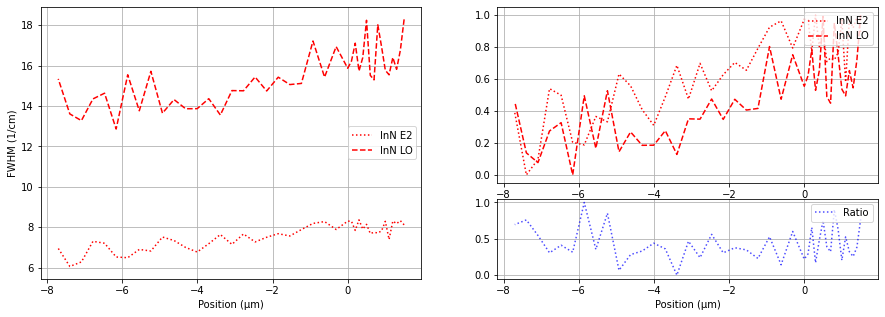

In [25]:
# Halbwärtsbreiten fwhm nach Positionen
 
#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_Saphir_418_fwhm=[]
Peak_Saphir_575_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
    #Peak_Saphir_575_fwhm.append(Saphir_575_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
    
   



#Plotten
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position (\u03bcm)')
plt.ylabel('FWHM (1/cm)')
plt.grid(True)
plt.legend(loc='center right')

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm)-0.5,s='InN')
#ax1.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Peak_InN_E2_fwhm)-0.5,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
#ax1.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen A-Plane D1")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax2.text(x=fitParams_G_E2[2],y=0,s='InN')
#ax2.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
#ax2.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen Normiert A-Plane D1")

ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Ratio') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position (\u03bcm)')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.text(x=fitParams_G_E2[2],y=0,s='InN')
#ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')
#plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.savefig('Bilder_Graphen_532nm/A-Plane Halbwärtsbreite fwhm Peaks nach Positionen D1 532nm')

plt.show()

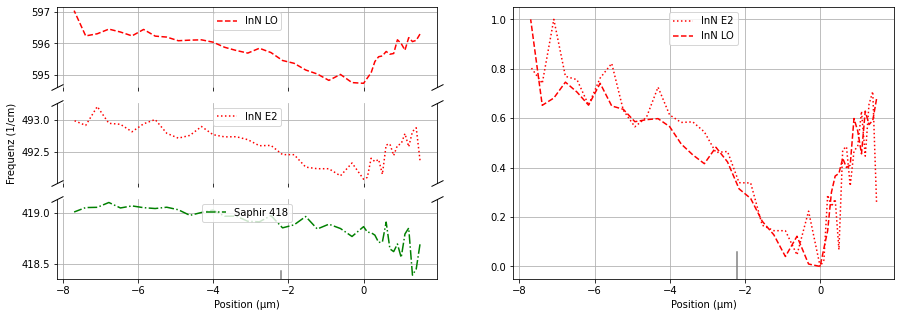

In [23]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_Saphir_418_w=[]
Peak_Saphir_575_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
    #Peak_Saphir_575_w.append(Saphir_575_Peaks_Liste[i][1][1])
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
   
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_Saphir_418_w,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')#
#ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_w),s='InN')
#ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Peak_Saphir_418_w),s='Saphir')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz (1/cm)')
ax3.set_xlabel('Position (\u03bcm)')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
#ax1.set_title("Raman-Frequenz 532nm Peaks nach Positionen A-Plane D1")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_w),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position (\u03bcm)')
#plt.ylabel('Frequenz in 1/cm')
plt.grid(True)
plt.legend(loc='upper center')
#ax4.set_title("Raman-Frequenz 532nm Peaks nach Positionen Normiert A-Plane D1")
#ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax4.text(x=fitParams_G_E2[2],y=0,s='InN')
#ax4.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.savefig('Bilder_Graphen_532nm/A-Plane Raman-Frequenz Peaks nach Positionen D1 532nm')
plt.show()



# Filename to write
filename = "frequenz_data_A-plane_Positionen.txt"
# Open the file with writing permission
myfile = open(filename, 'w')
# Write a line to the file
for pos in Positionen:
    myfile.write(str(pos)+"\n")#Peak_InN_E2_w
# Close the file
myfile.close()


# Filename to write
filename = "frequenz_data_A-plane.txt"
# Open the file with writing permission
myfile = open(filename, 'w')
# Write a line to the file
for w in Peak_InN_E2_w:
    myfile.write(str(w)+"\n")#Peak_InN_E2_w
# Close the file
myfile.close()

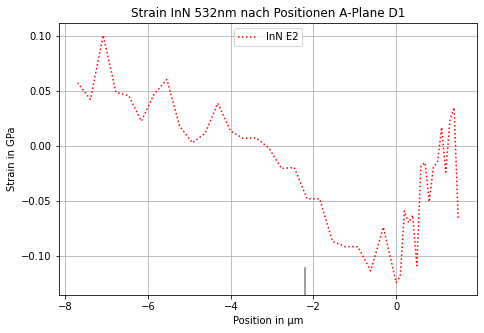

In [24]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain InN 532nm nach Positionen A-Plane D1')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')
#plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Strain_InN_E2_Liste),s='Saphir')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_532nm/A-Plane Strain nach Positionen D1 532nm')
plt.show()

# MBE Auswertung D1

Probenoberfläche vor Messung
<img src="Daten/MBE_InN_Oberfläche_1a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten/MBE_InN_Oberfläche_1b.jpg" style="width:300px;"/>

## Datenladen

In [50]:
#Path zu daten definieren
path = "./Daten//"  

In [51]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "InN_MBE_Bild1_D1_2x60s.txt") as f1:
        data_MBE_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MBE_array_str = np.array(data_MBE_txt)               #in np array umwandeln um listen von listen zu entkommen
data_MBE_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MBE_array_float = data_MBE_array_str.astype(float)   #str zu float in Arrayform
print(data_MBE_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_MBE_array_float[0])):
    data_MBE_array_float[0][k]=data_MBE_array_float[0][k]-Verschiebung_A_plane
print(data_MBE_array_float)

[[  0.      795.45685 794.98438 ... 294.03482 293.52521 293.01349]
 [ -5.        2.88288   2.87006 ...   6.23137   6.27322   6.3108 ]
 [ -5.1       3.63092   3.65913 ...   8.43583   8.39958   8.35755]
 ...
 [-10.8       4.91458   4.90866 ...   8.96969   8.97068   8.97864]
 [-10.9       4.88388   4.84702 ...   8.43157   8.42714   8.65273]
 [-11.        4.50282   4.48649 ...   7.89678   7.87044   7.83874]]
[[ -7.90178564 787.55506436 787.08259436 ... 286.13303436 285.62342436
  285.11170436]
 [ -5.           2.88288      2.87006    ...   6.23137      6.27322
    6.3108    ]
 [ -5.1          3.63092      3.65913    ...   8.43583      8.39958
    8.35755   ]
 ...
 [-10.8          4.91458      4.90866    ...   8.96969      8.97068
    8.97864   ]
 [-10.9          4.88388      4.84702    ...   8.43157      8.42714
    8.65273   ]
 [-11.           4.50282      4.48649    ...   7.89678      7.87044
    7.83874   ]]


## Fitten und Plotten

Position: -5.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.88288 2.87006 2.85804 ... 6.23137 6.27322 6.3108 ]
Fitparameter 480: [0.19544668022690098, 64.98026567021095, 481.66249696696343]
Fitparameter InN E2: [5.466101372343239, 3.769743093638666, 493.14615054979896]
Fitparameter InN LO: [1.0004463761406013, 10.517954412041606, 596.5329773594926]
Fitparameter GaN E2:  [1.2081486182725438, 3.05565908637133, 570.5801773916003]


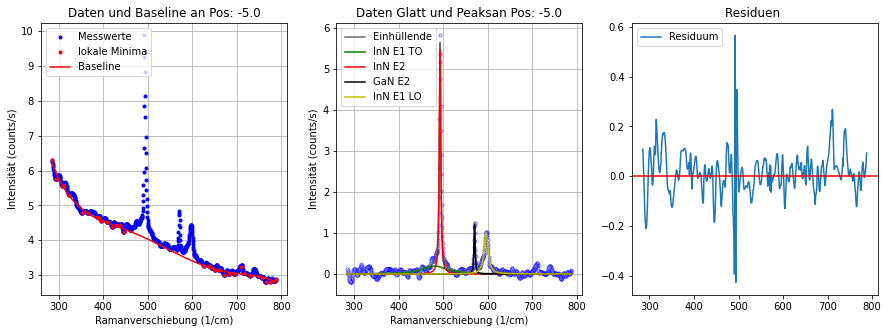

----------------------------------------------------------------------------------------------------
Position: -5.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.63092 3.65913 3.67276 ... 8.43583 8.39958 8.35755]
Fitparameter 480: [0.10248643743474915, 1259.9458383331582, 470.00000000000006]
Fitparameter InN E2: [5.644605175503964, 3.700907891750895, 493.1823732801277]
Fitparameter InN LO: [0.9407787562110287, 10.016820568264773, 595.9624246313563]
Fitparameter GaN E2:  [1.2669135792238209, 2.98493049564391, 570.5931825498701]
BILD an Pos:  -5.1


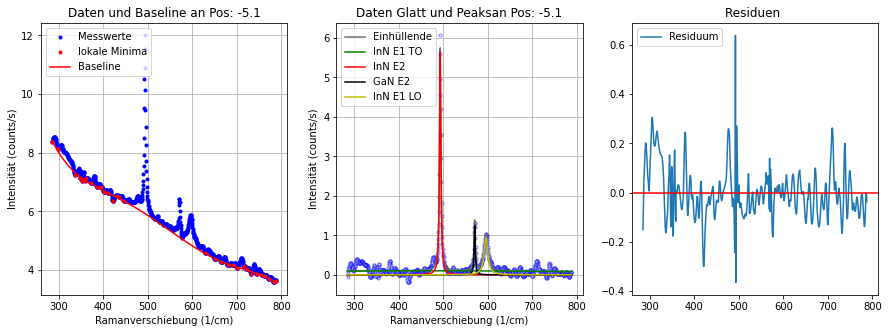

----------------------------------------------------------------------------------------------------
Position: -5.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.62801 2.7426  2.80303 ... 8.27665 8.33493 8.40692]
Fitparameter 480: [0.06663205223909861, 2124.206494422727, 470.0000000014183]
Fitparameter InN E2: [6.096901928253439, 3.673743012128217, 493.15499521869117]
Fitparameter InN LO: [0.9740556156909358, 11.207123362120358, 595.6661361298897]
Fitparameter GaN E2:  [1.3327848981526145, 2.9150676978528147, 570.616533218023]


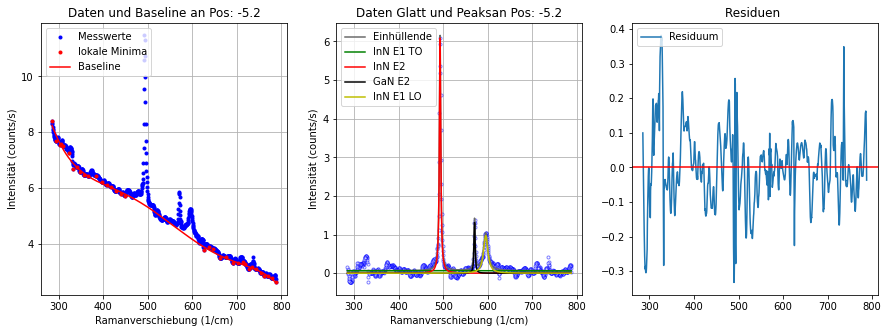

----------------------------------------------------------------------------------------------------
Position: -5.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.26169 2.23864 2.20984 ... 4.68605 4.63864 4.58859]
Fitparameter 480: [0.26119499496795967, 57.31227331872946, 482.95472553936406]
Fitparameter InN E2: [6.52982043911688, 3.442466007391955, 493.1521871383129]
Fitparameter InN LO: [1.0143649304115836, 13.013052085264453, 595.3343536657319]
Fitparameter GaN E2:  [1.3999885050293193, 2.5202932097373067, 570.7519626650038]


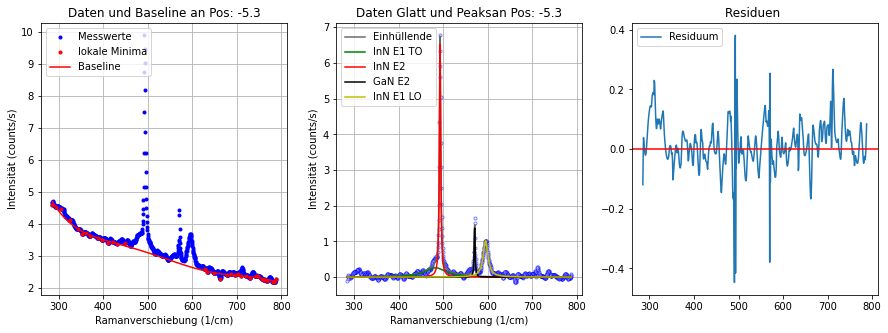

----------------------------------------------------------------------------------------------------
Position: -5.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.15624 2.17831 2.18426 ... 3.82807 3.85024 3.8637 ]
Fitparameter 480: [0.28662077582408857, 12.36072501712747, 476.09178260576255]
Fitparameter InN E2: [6.510619757394347, 3.941502944657899, 493.1737345651189]
Fitparameter InN LO: [1.1070792031865309, 13.666210614033966, 595.3199351646816]
Fitparameter GaN E2:  [1.4652037109098157, 2.4940729432923856, 570.5905026437293]


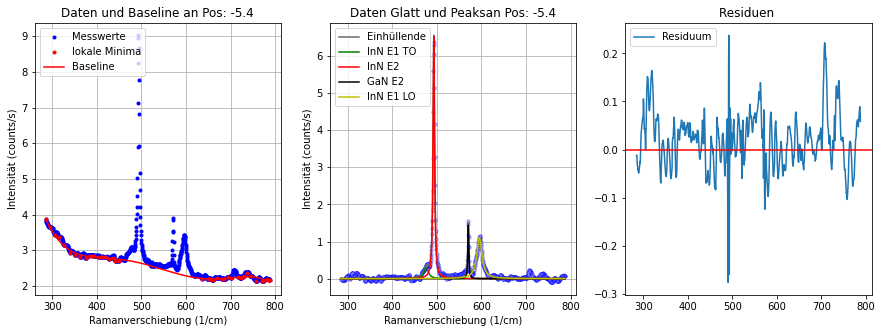

----------------------------------------------------------------------------------------------------
Position: -5.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.20575 2.22835 2.23496 ... 3.85894 3.87238 3.8828 ]
Fitparameter 480: [0.28018709147719184, 18.42075935231056, 475.58979754643667]
Fitparameter InN E2: [7.167504512869993, 3.563703578549588, 493.16265279559127]
Fitparameter InN LO: [1.15627446291129, 11.418320548246802, 595.7567558485991]
Fitparameter GaN E2:  [1.5950691706255473, 2.676555985054083, 570.6808357105712]


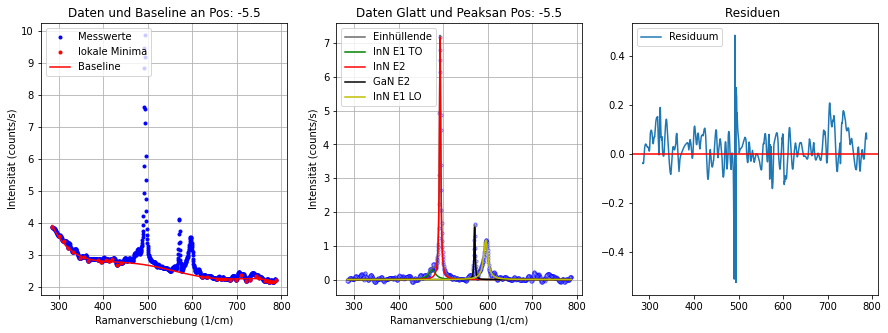

----------------------------------------------------------------------------------------------------
Position: -5.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.34473 2.36529 2.38047 ... 4.22049 4.23348 4.20755]
Fitparameter 480: [0.26021703676422425, 24.699941129051126, 475.2046796838444]
Fitparameter InN E2: [7.355380989006735, 3.6238106161426153, 493.0870808645914]
Fitparameter InN LO: [1.2370780800575187, 10.993283848985456, 595.9031833699704]
Fitparameter GaN E2:  [1.9472955436624984, 1.9071109428571988, 570.723758687214]


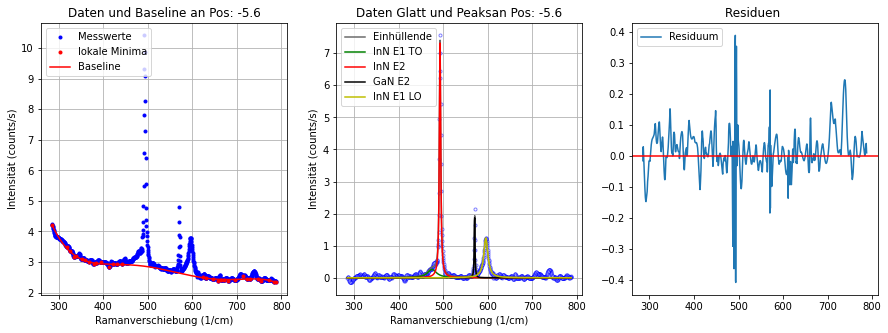

----------------------------------------------------------------------------------------------------
Position: -5.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.58861 2.57077 2.56248 ... 4.3206  4.34509 4.33938]
Fitparameter 480: [0.037123022523110775, 258621.23279631365, 470.0000000000001]
Fitparameter InN E2: [7.9270531321630795, 3.749364332424679, 493.06613278221]
Fitparameter InN LO: [1.314913304838808, 10.085434400558904, 595.7971329334441]
Fitparameter GaN E2:  [1.7985573254238783, 2.485443661343831, 570.694373019935]


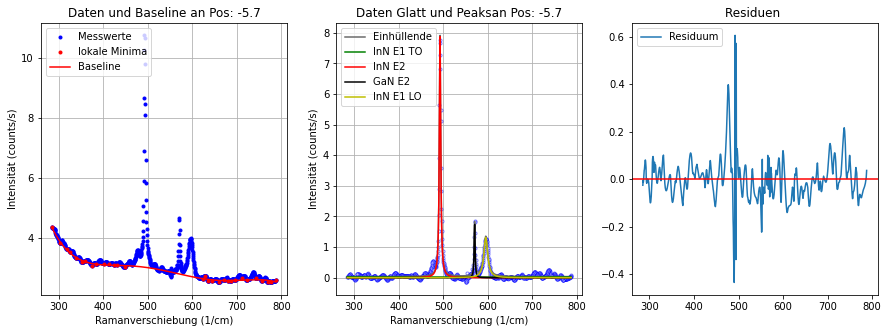

----------------------------------------------------------------------------------------------------
Position: -5.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.69139 2.58749 2.58871 ... 4.55341 4.52828 4.49756]
Fitparameter 480: [0.04783497121997489, 2161.6296646990136, 470.00000000000006]
Fitparameter InN E2: [8.51454709002679, 3.6374199972960404, 493.10561801513865]
Fitparameter InN LO: [1.3382613426158192, 9.736261110728567, 595.6538568289243]
Fitparameter GaN E2:  [1.8492772741350634, 2.3411520577262506, 570.6959287247348]


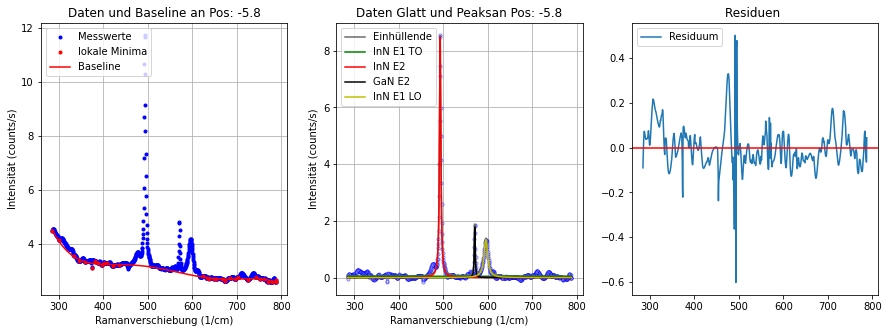

----------------------------------------------------------------------------------------------------
Position: -5.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.67248 2.6416  2.6484  ... 4.49768 4.48659 4.47043]
Fitparameter 480: [0.05467415565252287, 740.8189714489243, 489.9999999869108]
Fitparameter InN E2: [8.97406818198976, 3.604693059799094, 493.1511500650373]
Fitparameter InN LO: [1.4928925374766586, 10.645972321031518, 595.6683237629024]
Fitparameter GaN E2:  [1.9285423256986691, 2.3460731349963266, 570.7149005027369]


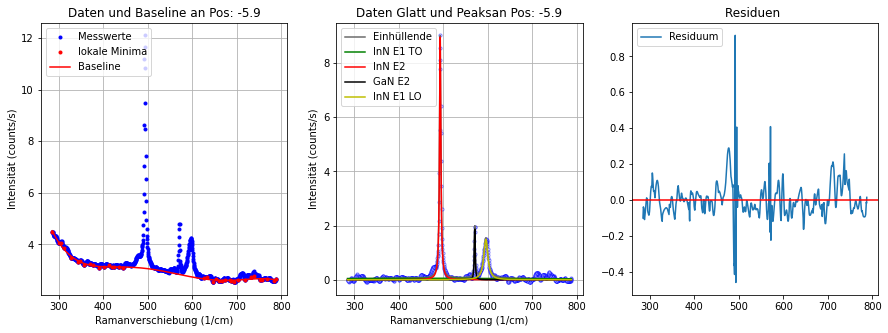

----------------------------------------------------------------------------------------------------
Position: -6.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [2.83    2.81724 2.80805 ... 4.66388 4.67514 4.6392 ]
Fitparameter 480: [0.05655448740092361, 464036.3112130016, 489.99999999999994]
Fitparameter InN E2: [9.727209631343603, 3.633358448707035, 493.1076336428098]
Fitparameter InN LO: [1.5485079059825302, 11.324154125577778, 595.4645917375565]
Fitparameter GaN E2:  [2.064377190103255, 2.4861732019825578, 570.492062443738]


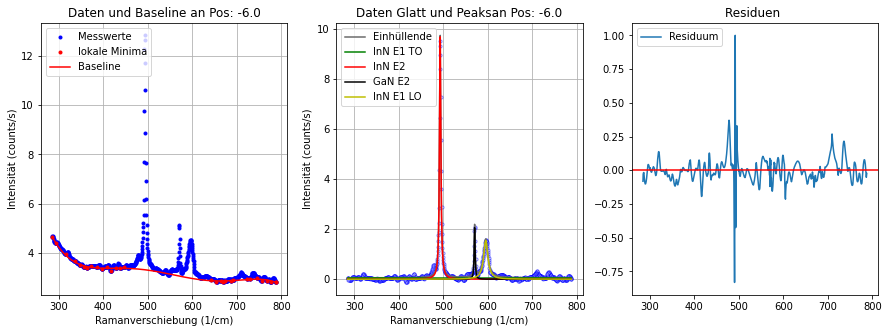

----------------------------------------------------------------------------------------------------
Position: -6.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.07087 3.0006  2.95934 ... 4.74053 4.76444 4.79867]
Fitparameter 480: [0.04540915449749386, 502633.70020371355, 470.0000000000001]
Fitparameter InN E2: [10.79115335033999, 3.617964805423797, 493.0697616806919]
Fitparameter InN LO: [1.6462541437386475, 10.866838508746426, 595.3534950658197]
Fitparameter GaN E2:  [2.3163340466575546, 2.367674706186055, 570.6784453826816]


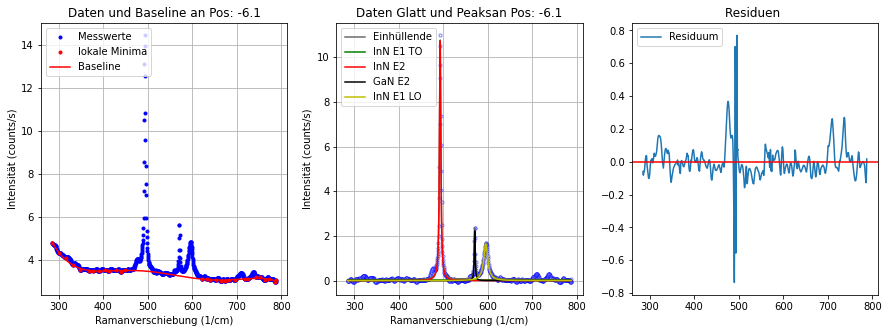

----------------------------------------------------------------------------------------------------
Position: -6.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.2095  3.21976 3.23162 ... 4.77026 4.80729 4.88734]
Fitparameter 480: [0.5273215952524937, 9.566323269536749, 476.98367262272853]
Fitparameter InN E2: [11.377646480891908, 3.7169260789713627, 493.117047707086]
Fitparameter InN LO: [1.9156371192435258, 12.021919497211941, 595.495554325222]
Fitparameter GaN E2:  [2.4292734989472606, 2.4915074678432747, 570.6765816519311]


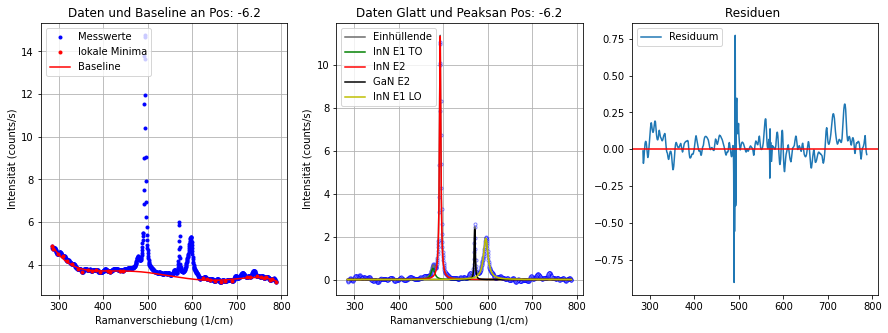

----------------------------------------------------------------------------------------------------
Position: -6.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.76003 3.77943 3.79727 ... 5.20126 5.20822 5.21813]
Fitparameter 480: [0.10104712612716046, 459.32654773047005, 489.99999999999994]
Fitparameter InN E2: [12.250262302630704, 3.8260267252398967, 493.0868987010987]
Fitparameter InN LO: [2.0671986940072418, 12.167491682771416, 595.1224354082242]
Fitparameter GaN E2:  [2.5082932788973125, 2.6521380502597847, 570.5380269417882]


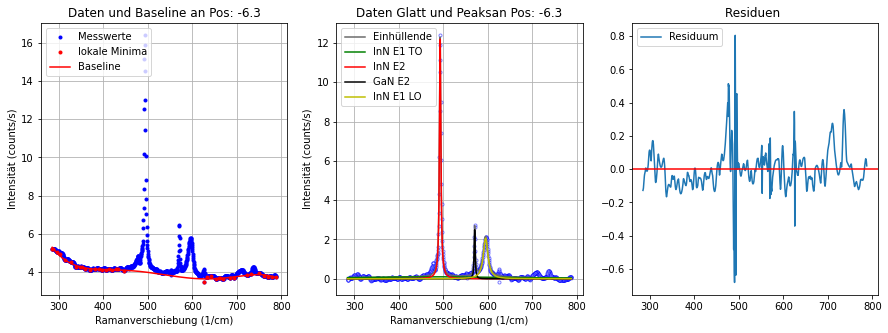

----------------------------------------------------------------------------------------------------
Position: -6.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.60374 3.61492 3.62607 ... 5.01972 4.99409 4.95968]
Fitparameter 480: [0.6275841151014577, 10.1685320276118, 476.8180254488557]
Fitparameter InN E2: [13.175174617635108, 3.718824654975476, 493.09975549599955]
Fitparameter InN LO: [2.2007943084661377, 11.850956802310035, 595.5098641407029]
Fitparameter GaN E2:  [2.7280289705844076, 2.4470174362571147, 570.6392945378967]


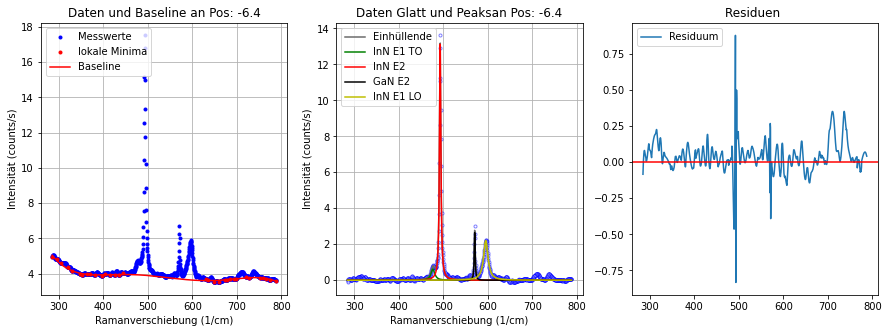

----------------------------------------------------------------------------------------------------
Position: -6.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [3.93805 3.93112 3.92629 ... 4.7771  4.83867 4.88771]
Fitparameter 480: [0.5729214501794314, 12.006517802974844, 477.2452376353688]
Fitparameter InN E2: [14.191531804234879, 3.6043252388541633, 493.1118640372131]
Fitparameter InN LO: [2.2920617472409033, 11.683417866033691, 595.5796481550689]
Fitparameter GaN E2:  [3.202666440840615, 2.241861984964087, 570.650618067803]


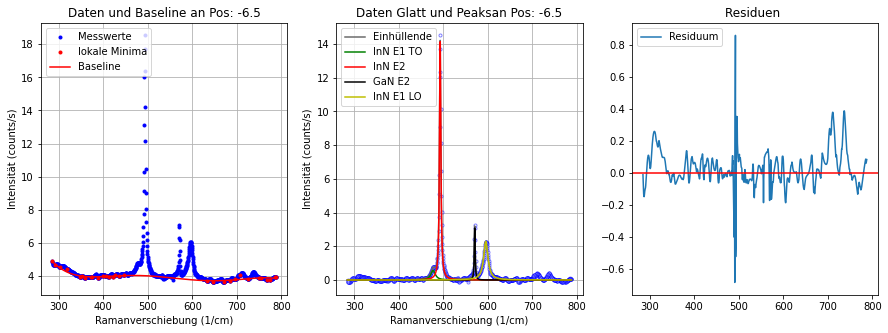

----------------------------------------------------------------------------------------------------
Position: -6.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.24812 4.19688 4.15407 ... 4.90714 4.94675 4.98913]
Fitparameter 480: [0.05815368624528629, 579330.3494321653, 489.9999999999988]
Fitparameter InN E2: [15.737724809936365, 3.6929758445661545, 493.09554190316203]
Fitparameter InN LO: [2.521403460217451, 10.539857614282633, 595.6934683602112]
Fitparameter GaN E2:  [3.5575986330345635, 2.2021852180216435, 570.5612274925658]


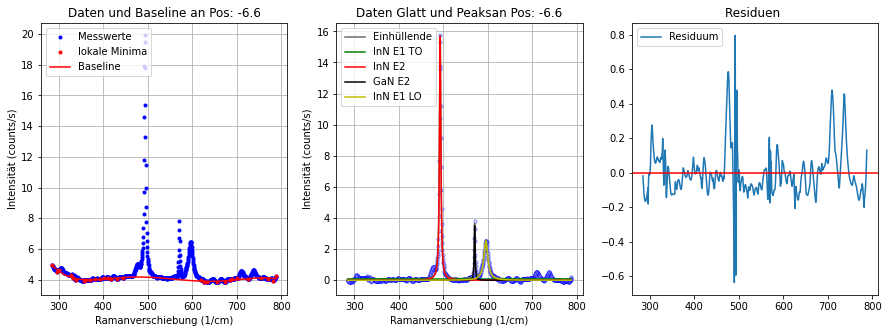

----------------------------------------------------------------------------------------------------
Position: -6.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.5462  4.48086 4.45204 ... 5.00074 5.0193  5.05665]
Fitparameter 480: [0.7360486025671884, 8.67754560927966, 476.65157111013167]
Fitparameter InN E2: [16.492139139867785, 3.7278237252235438, 493.08011685263]
Fitparameter InN LO: [2.7410632139914806, 11.089497244782978, 595.9158143297769]
Fitparameter GaN E2:  [3.9203473042242094, 2.109507943428467, 570.6104624967978]


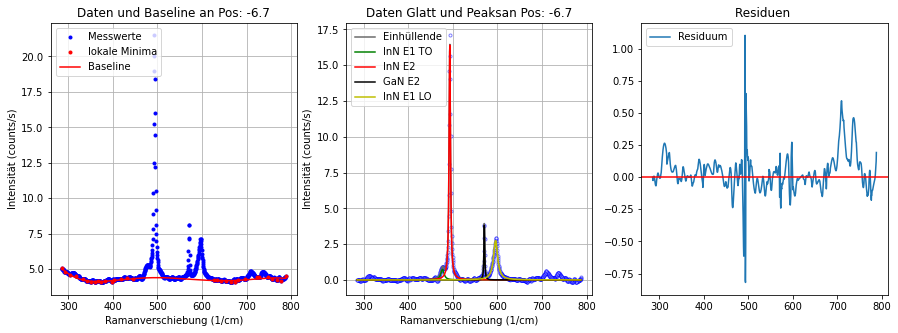

----------------------------------------------------------------------------------------------------
Position: -6.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.63313 4.6258  4.60802 ... 5.04464 5.10083 5.10744]
Fitparameter 480: [0.8718739560512582, 7.795743612254581, 477.12709390750786]
Fitparameter InN E2: [17.81669804755775, 3.779216135053993, 493.13238985667556]
Fitparameter InN LO: [3.0013191944083033, 11.208225485952436, 595.6882189530991]
Fitparameter GaN E2:  [3.9480598702091227, 2.329016384754513, 570.6040796696457]


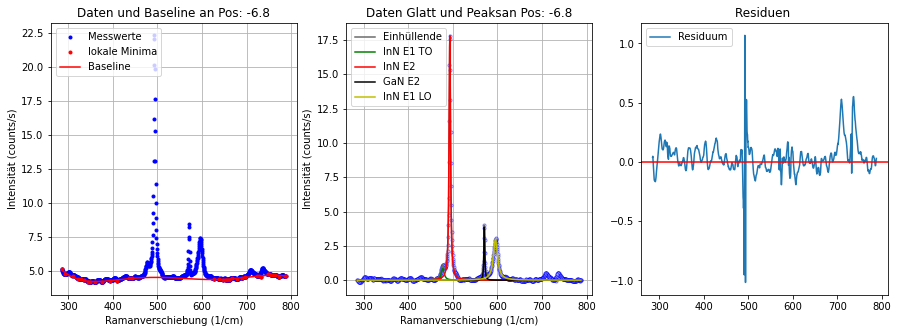

----------------------------------------------------------------------------------------------------
Position: -6.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.87652 4.81487 4.84711 ... 4.94946 4.93205 4.88385]
Fitparameter 480: [0.06922487404843516, 370969.21477110905, 489.99999999999983]
Fitparameter InN E2: [18.688224903884965, 3.8129780372564923, 493.09850876330415]
Fitparameter InN LO: [3.248720291980064, 10.507798830323505, 595.7282326356429]
Fitparameter GaN E2:  [4.2949314624766535, 1.973281551432991, 570.6500391960878]


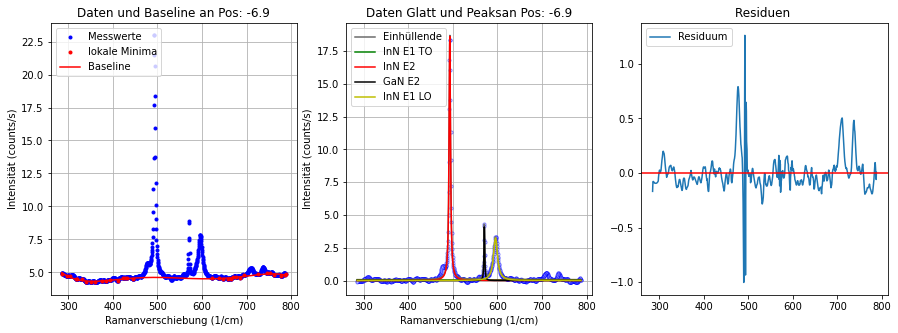

----------------------------------------------------------------------------------------------------
Position: -7.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [5.26982 5.29749 5.29933 ... 5.17016 5.18157 5.22911]
Fitparameter 480: [0.875544408145219, 6.042454370441432, 477.7587296390392]
Fitparameter InN E2: [19.841154985083136, 3.7667130421859594, 493.0979960440355]
Fitparameter InN LO: [3.385405022335275, 11.62094636737432, 595.7658967320954]
Fitparameter GaN E2:  [4.275424200845741, 2.2803727031443293, 570.5525536088779]


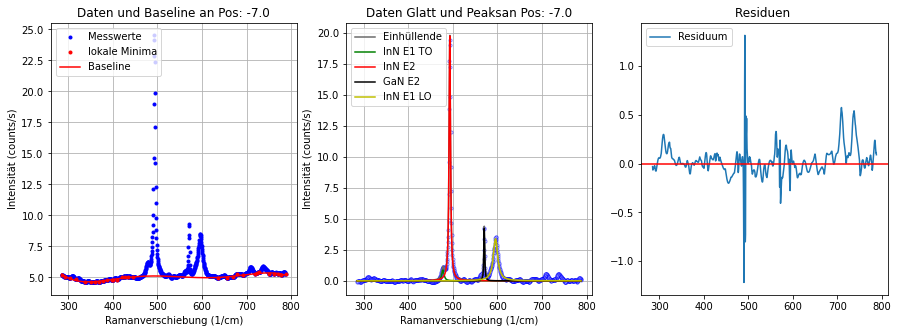

----------------------------------------------------------------------------------------------------
Position: -7.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [6.18666 6.22353 6.23325 ... 5.8254  5.77751 5.73408]
Fitparameter 480: [0.08581141766145184, 2534.275816529017, 489.99999991262234]
Fitparameter InN E2: [21.073407478318437, 3.923550142026481, 493.09103913732645]
Fitparameter InN LO: [3.811370628199855, 10.948243403627888, 595.7987933298703]
Fitparameter GaN E2:  [4.6916211504116605, 2.513362693991145, 570.6055698190811]


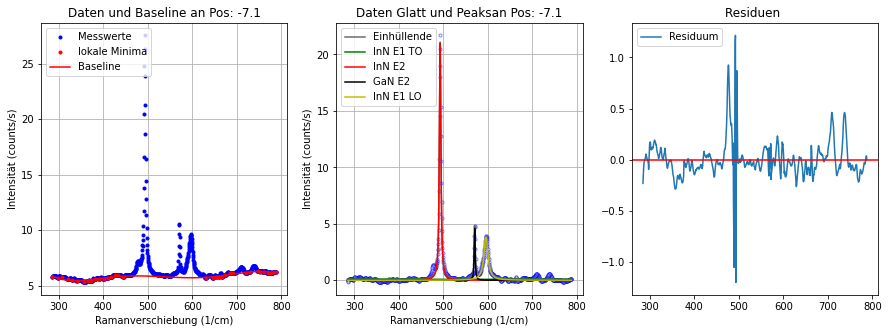

----------------------------------------------------------------------------------------------------
Position: -7.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [6.80834 6.86142 6.9072  ... 5.89898 5.89666 5.89403]
Fitparameter 480: [0.08394951408705854, 773994.0013268123, 489.99999999999943]
Fitparameter InN E2: [22.072004205580793, 3.8953595514900217, 493.12520836187514]
Fitparameter InN LO: [3.8511222553693543, 10.051774042247851, 595.8714683908072]
Fitparameter GaN E2:  [4.988614487319865, 2.237191782105419, 570.5354894806617]


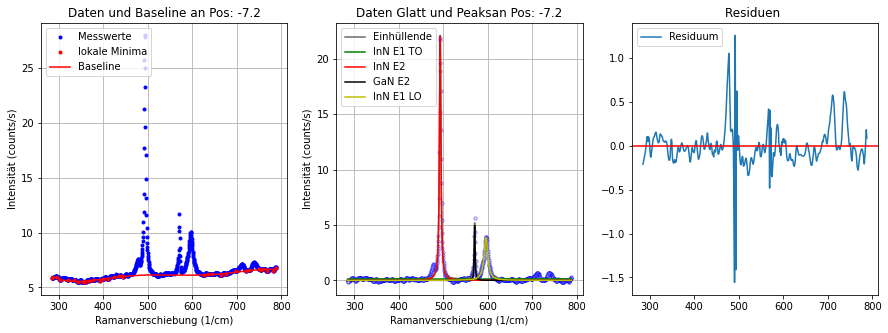

----------------------------------------------------------------------------------------------------
Position: -7.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [8.28178 8.24195 8.2453  ... 7.22045 7.25741 7.306  ]
Fitparameter 480: [1.100329163012124, 9.129111992970952, 476.3612214114086]
Fitparameter InN E2: [23.48344189702304, 3.8381999112283114, 493.10019681421926]
Fitparameter InN LO: [4.052365617732193, 11.1966482251025, 595.765284754297]
Fitparameter GaN E2:  [5.304550895873533, 2.3300865663371724, 570.4635036298945]


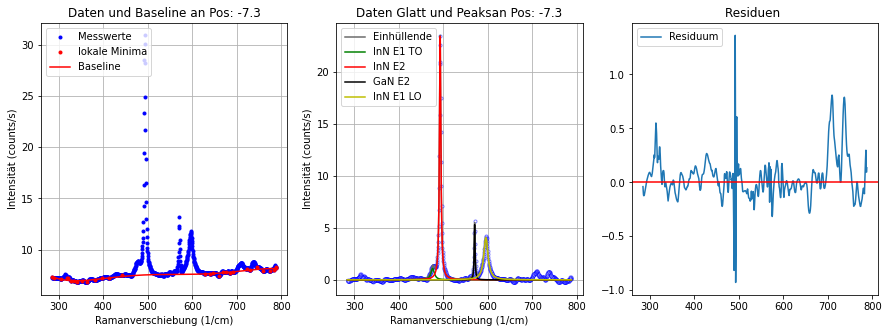

----------------------------------------------------------------------------------------------------
Position: -7.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [9.13422 9.06994 8.9887  ... 7.87107 7.87588 7.87803]
Fitparameter 480: [0.06843126062358341, 741824.9453348704, 489.9999999999918]
Fitparameter InN E2: [24.065972147265654, 3.872521745930208, 493.0887091414873]
Fitparameter InN LO: [4.364684516410974, 10.182913852473853, 595.9132585462172]
Fitparameter GaN E2:  [5.967084291640184, 2.2442135537009857, 570.533505292001]


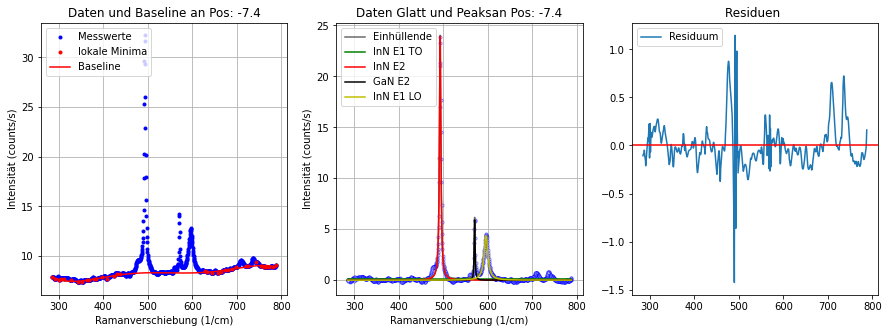

----------------------------------------------------------------------------------------------------
Position: -7.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.6054  10.5735  10.5606  ...  8.99315  8.95396  8.98381]
Fitparameter 480: [0.11406147402247947, 773191.5174276293, 489.99999999999324]
Fitparameter InN E2: [24.90047437528232, 3.943232402573757, 493.06850578830165]
Fitparameter InN LO: [4.601862936168827, 10.404367607444374, 595.7674388059104]
Fitparameter GaN E2:  [5.6183418830862895, 2.470590360920086, 570.6632796937143]


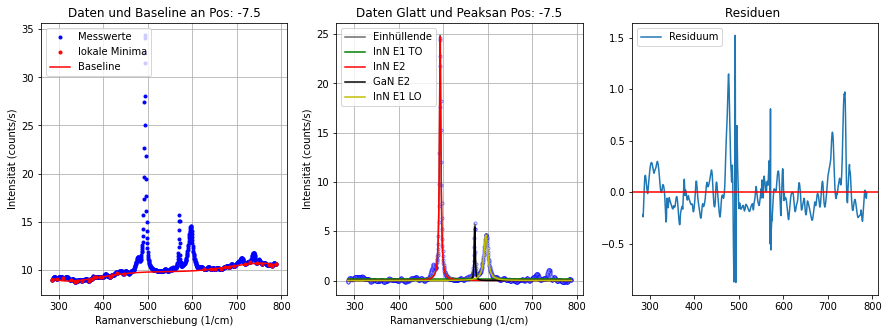

----------------------------------------------------------------------------------------------------
Position: -7.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.3473  11.3102  11.3099  ...  9.53918  9.63474  9.78088]
Fitparameter 480: [0.09418412286324737, 927717.8399226663, 489.99999999999994]
Fitparameter InN E2: [26.370905254294318, 3.8534227470048603, 493.0355528528964]
Fitparameter InN LO: [4.801770002647643, 9.658690658099019, 595.9074913586636]
Fitparameter GaN E2:  [6.374034777103149, 2.232795761096782, 570.5409046020858]


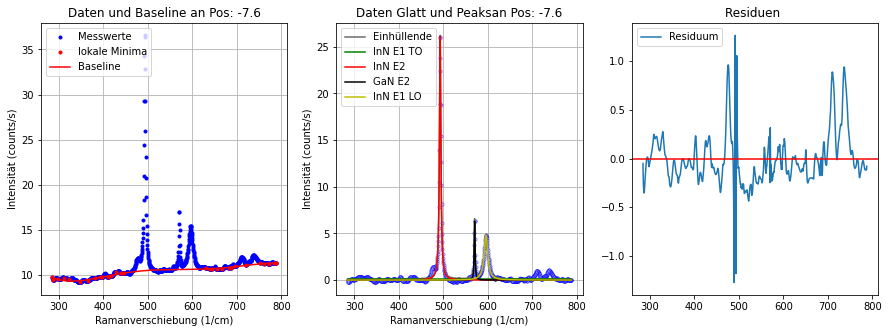

----------------------------------------------------------------------------------------------------
Position: -7.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.4697  11.4793  11.4982  ...  9.88333  9.82509  9.46372]
Fitparameter 480: [1.320063240699135, 9.533972797737801, 477.3443210499715]
Fitparameter InN E2: [27.45745478632118, 3.960331860057501, 493.05826227221684]
Fitparameter InN LO: [5.009744968964076, 11.735930875803136, 595.6743192853866]
Fitparameter GaN E2:  [6.3550527644361825, 2.5093838154903163, 570.5845410042468]


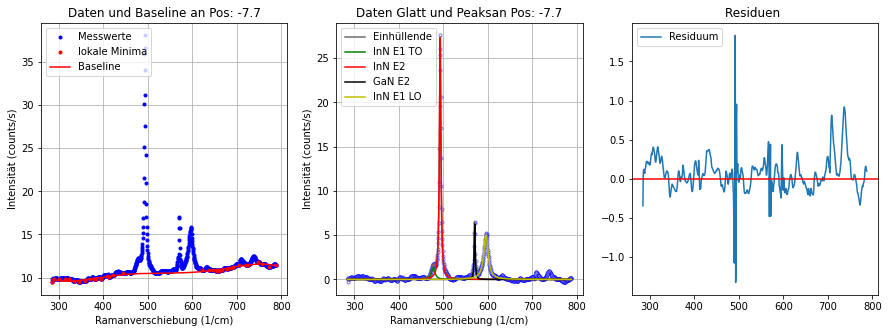

----------------------------------------------------------------------------------------------------
Position: -7.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.679  11.6285 11.6153 ... 10.0441 10.0805 10.1231]
Fitparameter 480: [1.3191680266468797, 7.0772517764875635, 476.6719919241621]
Fitparameter InN E2: [28.155541408178735, 3.972227025223941, 493.06061969296917]
Fitparameter InN LO: [5.3087193393096666, 11.007559147191964, 595.6374383283883]
Fitparameter GaN E2:  [6.81228059363426, 2.503770745899491, 570.5005417908886]


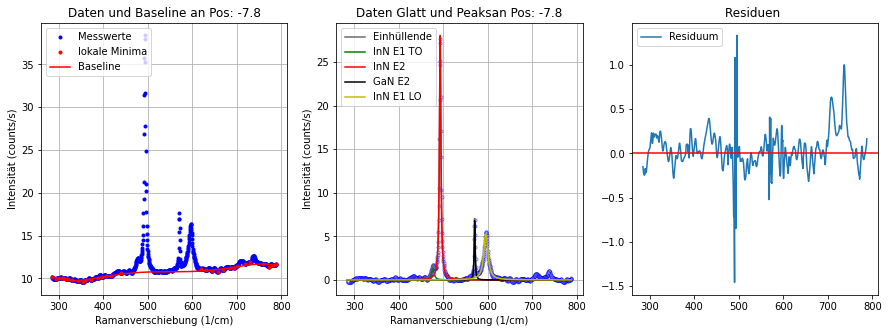

----------------------------------------------------------------------------------------------------
Position: -7.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.9485 11.8929 11.8393 ... 10.0201 10.0323 10.0845]
Fitparameter 480: [0.07768300780438323, 967188.5573755968, 489.99999999999676]
Fitparameter InN E2: [28.515141295164316, 4.044587551846167, 493.049785564179]
Fitparameter InN LO: [5.241801232667222, 10.638360221641129, 595.7331825727271]
Fitparameter GaN E2:  [7.882442102161468, 2.1847780122683687, 570.5901518425148]
BILD an Pos:  -7.9


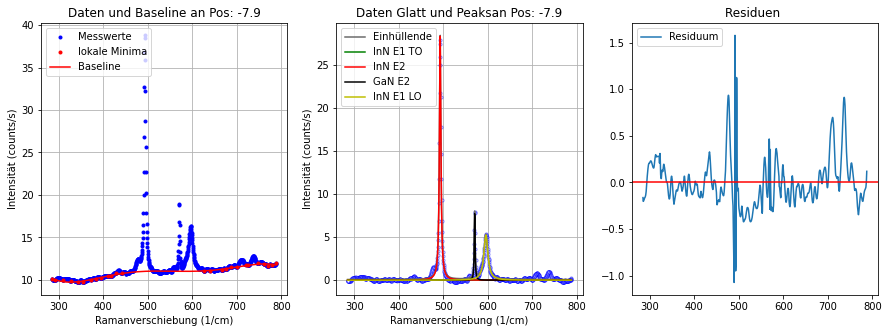

----------------------------------------------------------------------------------------------------
Position: -8.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.7904 11.9722 12.0328 ... 10.2282 10.1769 10.0772]
Fitparameter 480: [0.0701895778098985, 773070.9846439498, 489.9999999999997]
Fitparameter InN E2: [29.77282915563309, 4.00774639989722, 493.0459681609497]
Fitparameter InN LO: [5.651656273153478, 10.68373458357486, 595.618768867307]
Fitparameter GaN E2:  [7.635896573070184, 2.501303414750858, 570.6063633846188]


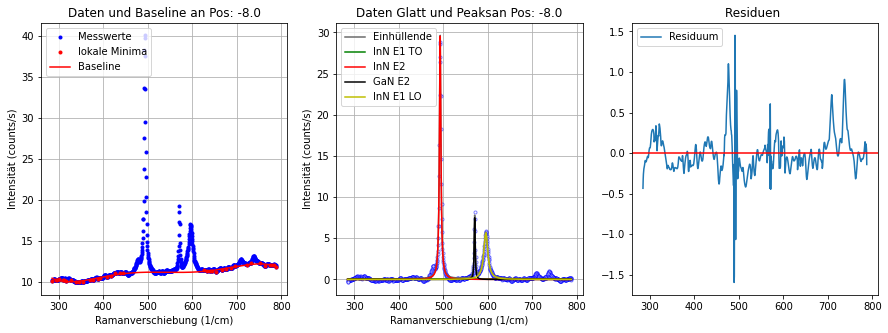

----------------------------------------------------------------------------------------------------
Position: -8.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [12.1641 12.2891 12.3506 ... 10.7047 10.7505 10.8189]
Fitparameter 480: [0.08616029634298786, 1046282.8116722743, 489.9999999999957]
Fitparameter InN E2: [29.836780490736924, 3.9910663756181792, 493.0815669643935]
Fitparameter InN LO: [5.663698600908211, 9.598487419955813, 595.5513706708228]
Fitparameter GaN E2:  [8.290314797791908, 2.1884405110388236, 570.6777403752474]


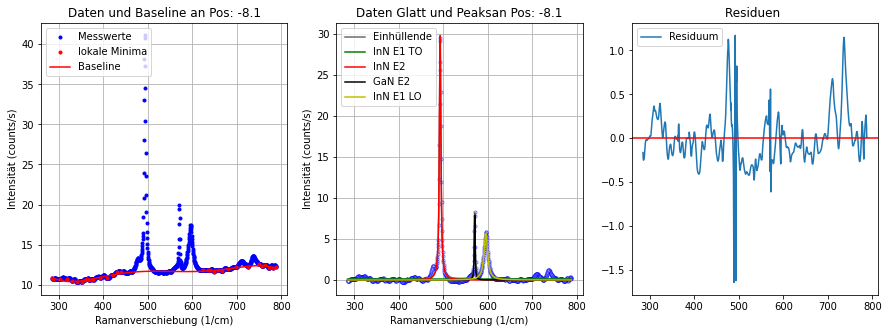

----------------------------------------------------------------------------------------------------
Position: -8.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [12.5282 12.4656 12.455  ... 11.0696 11.0623 11.046 ]
Fitparameter 480: [0.07877394132612422, 693376.6245609197, 470.0000000000045]
Fitparameter InN E2: [30.667570969919772, 3.942997673425976, 493.0626290111457]
Fitparameter InN LO: [5.618926659390918, 10.142458602457511, 595.5784694978518]
Fitparameter GaN E2:  [8.934074853267095, 2.1110399411505236, 570.5579538882076]


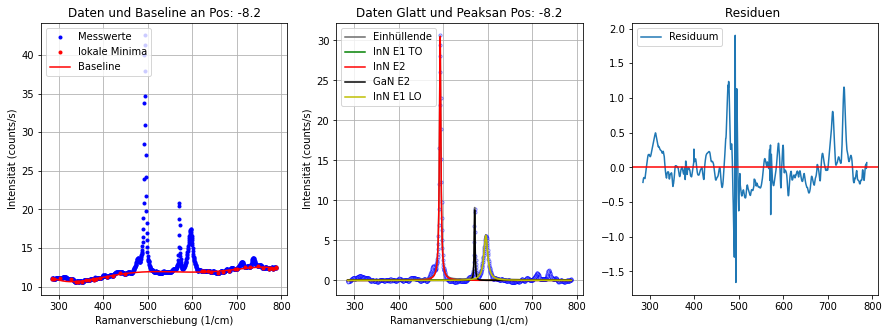

----------------------------------------------------------------------------------------------------
Position: -8.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [12.3458 12.2673 12.1732 ... 11.2121 11.2276 11.2435]
Fitparameter 480: [1.4611163627657766, 8.177244469263806, 477.1007378189693]
Fitparameter InN E2: [31.645583325171685, 4.023285508741493, 493.149907092829]
Fitparameter InN LO: [5.817697991239285, 11.82280328772609, 595.5069145049885]
Fitparameter GaN E2:  [8.7264453524306, 2.485650865597352, 570.6300925624951]


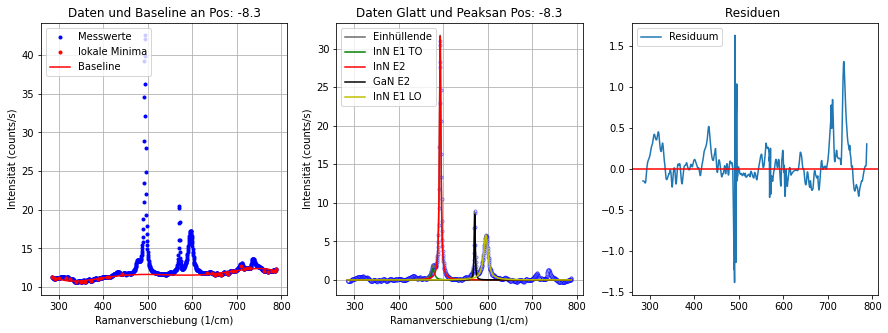

----------------------------------------------------------------------------------------------------
Position: -8.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.673  11.6632 11.6723 ... 10.5261 10.5073 10.4812]
Fitparameter 480: [0.08495548671973126, 744741.1862981439, 489.99999999999926]
Fitparameter InN E2: [32.10015523223349, 3.9308874492647954, 493.12934244862174]
Fitparameter InN LO: [5.535469109455921, 10.87487462321594, 595.5338524110085]
Fitparameter GaN E2:  [8.601465182816233, 2.329644269809657, 570.6870471153754]


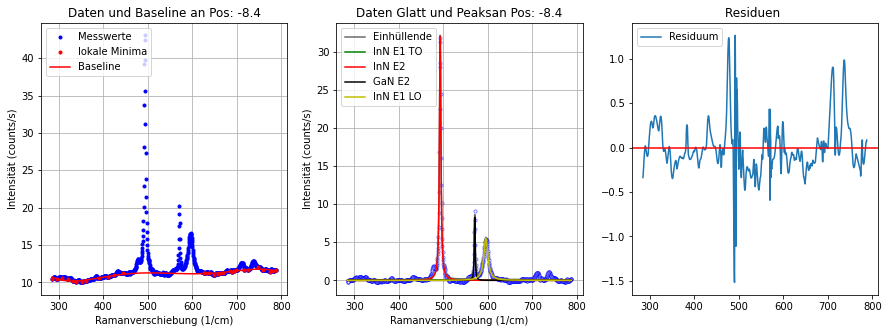

----------------------------------------------------------------------------------------------------
Position: -8.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.7968 11.5603 11.4161 ... 10.4724 10.4752 10.5177]
Fitparameter 480: [0.10464460154681794, 465110.930206848, 489.9999999999998]
Fitparameter InN E2: [32.625051461687036, 3.9891621278146, 493.1766717660769]
Fitparameter InN LO: [5.62882991954991, 10.860853558361631, 595.5411460558645]
Fitparameter GaN E2:  [8.482576121165847, 2.407754645044117, 570.6564671060877]


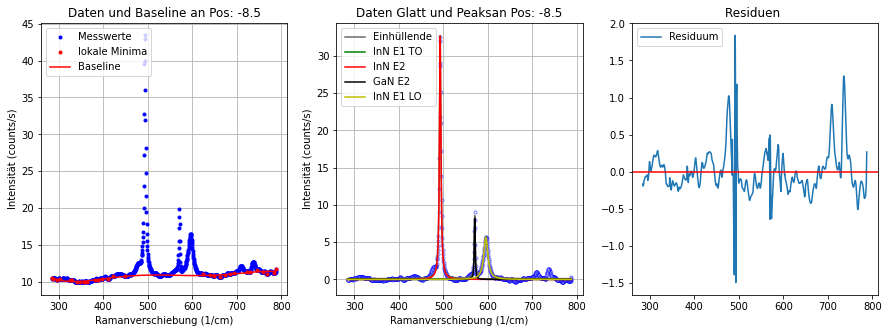

----------------------------------------------------------------------------------------------------
Position: -8.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.3074 10.9002 10.7816 ... 10.4038 10.3987 10.3599]
Fitparameter 480: [0.1120154873767897, 927967.9859975539, 489.9999999999973]
Fitparameter InN E2: [32.67378888537774, 3.9030678823457885, 493.20453024015353]
Fitparameter InN LO: [5.5882925675116875, 9.928765191257446, 595.5952572713236]
Fitparameter GaN E2:  [9.52475013573577, 1.9749967538024706, 570.6274565754743]


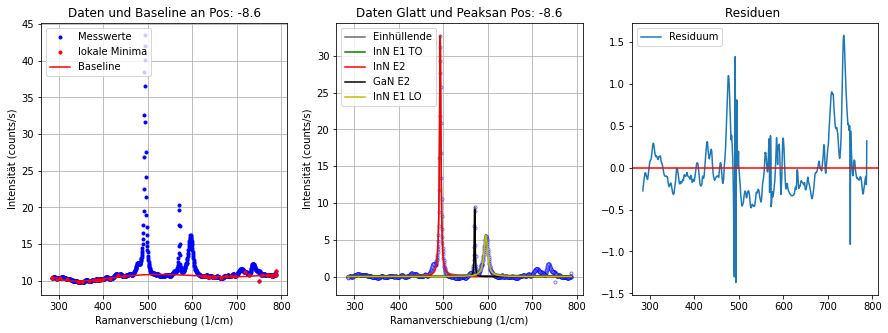

----------------------------------------------------------------------------------------------------
Position: -8.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.5309 10.5723 10.5873 ... 10.8947 10.9996 11.1423]
Fitparameter 480: [1.371689838346604, 7.210671318941454, 477.2677740944458]
Fitparameter InN E2: [32.521223901243566, 3.9338898487208103, 493.24671881865027]
Fitparameter InN LO: [5.775700201875766, 10.86888696685057, 595.6990164930799]
Fitparameter GaN E2:  [9.54460259817684, 2.3913695895371703, 570.6450209764675]


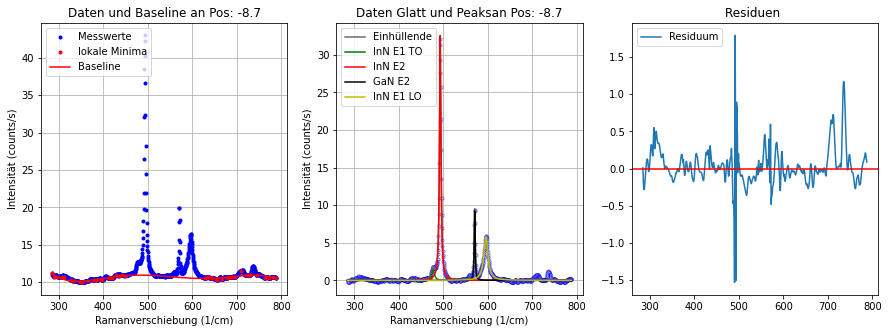

----------------------------------------------------------------------------------------------------
Position: -8.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.2175 10.1712 10.1297 ... 11.0567 11.1119 11.1313]
Fitparameter 480: [0.10180572879565244, 773261.427034575, 470.00000000000335]
Fitparameter InN E2: [32.19573278440171, 3.9894128315913617, 493.2124345544582]
Fitparameter InN LO: [5.509490145446196, 10.695356342957274, 595.6938098581653]
Fitparameter GaN E2:  [9.394008970740327, 2.346722991086402, 570.6906710603812]


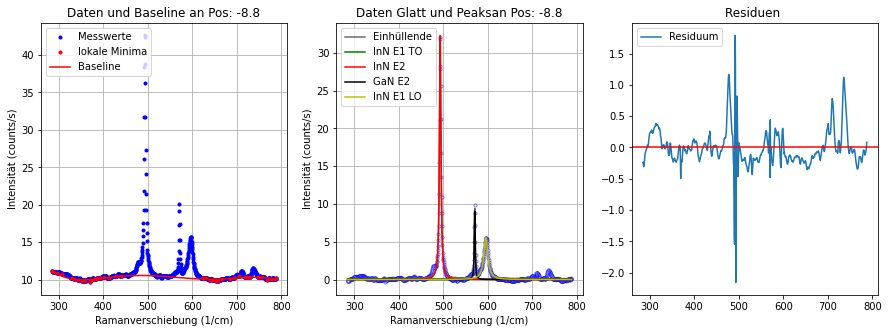

----------------------------------------------------------------------------------------------------
Position: -8.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.2513 10.2063 10.144  ... 11.7401 11.815  11.9266]
Fitparameter 480: [0.10579711432895227, 927960.8050555764, 489.9999999999991]
Fitparameter InN E2: [31.49342811088038, 3.9629875049436554, 493.275582057407]
Fitparameter InN LO: [5.749153019963059, 10.244036590614485, 595.7421641659905]
Fitparameter GaN E2:  [10.009119476610064, 2.1478481850265716, 570.6862709012714]


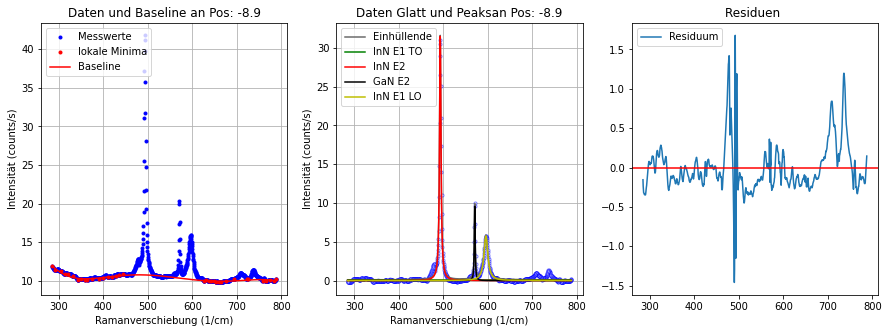

----------------------------------------------------------------------------------------------------
Position: -9.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 9.9144 10.0157 10.0433 ... 12.0125 12.0173 12.0365]
Fitparameter 480: [0.1545769179779189, 231546.48253223626, 470.0000000000001]
Fitparameter InN E2: [31.2815554587692, 3.9382599878501665, 493.28804953355086]
Fitparameter InN LO: [5.526443547693256, 10.849773539240987, 595.7046148937051]
Fitparameter GaN E2:  [9.425452926868072, 2.40523824062065, 570.6900668581866]


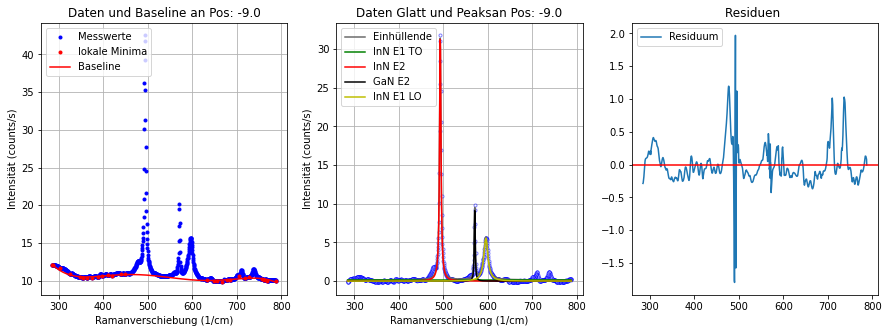

----------------------------------------------------------------------------------------------------
Position: -9.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [12.8792 12.7527 12.6987 ... 17.2872 17.3392 17.4337]
Fitparameter 480: [0.14208622918988492, 997336.6251493231, 489.99999999999983]
Fitparameter InN E2: [30.905751434560255, 3.902354071546446, 493.33410486457564]
Fitparameter InN LO: [5.2573387761029355, 9.698577409787282, 596.0407151843319]
Fitparameter GaN E2:  [9.734103019795311, 2.170506405550868, 570.7123412366077]


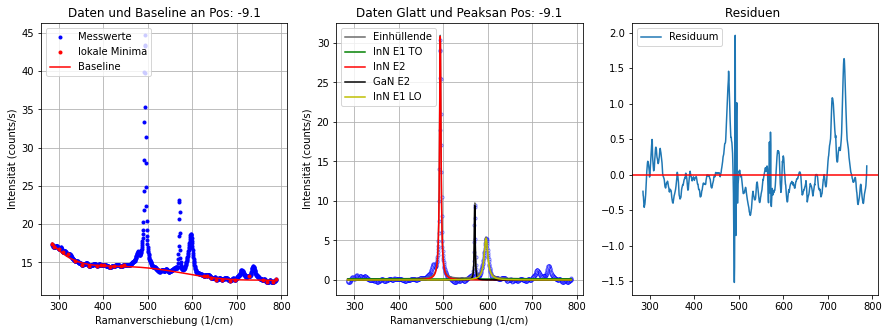

----------------------------------------------------------------------------------------------------
Position: -9.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [13.1053 13.0891 13.0708 ... 20.0731 20.0561 20.0308]
Fitparameter 480: [0.17479442426910918, 3378.7608773091447, 470.0000000355998]
Fitparameter InN E2: [30.053054143894776, 3.892979633380703, 493.3361398543685]
Fitparameter InN LO: [5.109330638054946, 10.184738504975376, 596.0001854734144]
Fitparameter GaN E2:  [8.98972619197364, 2.3462210465357343, 570.7614266537443]


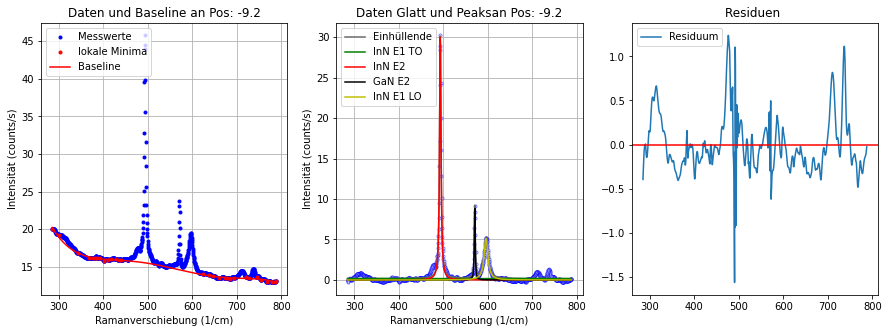

----------------------------------------------------------------------------------------------------
Position: -9.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [13.0106 12.9858 12.9586 ... 19.9863 20.0921 20.2103]
Fitparameter 480: [0.14365064996249327, 773114.4925793855, 470.00000000000057]
Fitparameter InN E2: [28.201966684992662, 4.129513482274587, 493.30247789744215]
Fitparameter InN LO: [4.84023070776516, 9.3644943760598, 596.1164494709433]
Fitparameter GaN E2:  [8.819032872731317, 2.114882615055472, 570.7910635774963]


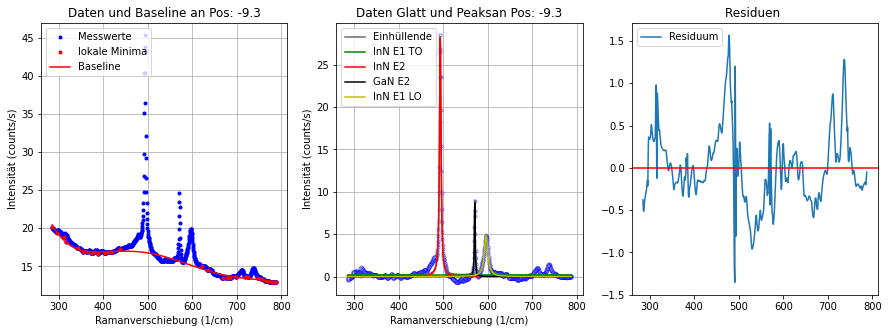

----------------------------------------------------------------------------------------------------
Position: -9.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [11.5938 11.6381 11.6719 ... 18.1696 18.1585 18.2265]
Fitparameter 480: [1.880043559326334, 19.065491879221373, 476.8434522253402]
Fitparameter InN E2: [27.461535531597473, 3.912979135694193, 493.34005364386604]
Fitparameter InN LO: [4.608519187155386, 10.360188832872598, 596.0742512221602]
Fitparameter GaN E2:  [8.857644549185052, 2.1356033467735442, 570.6842993527445]


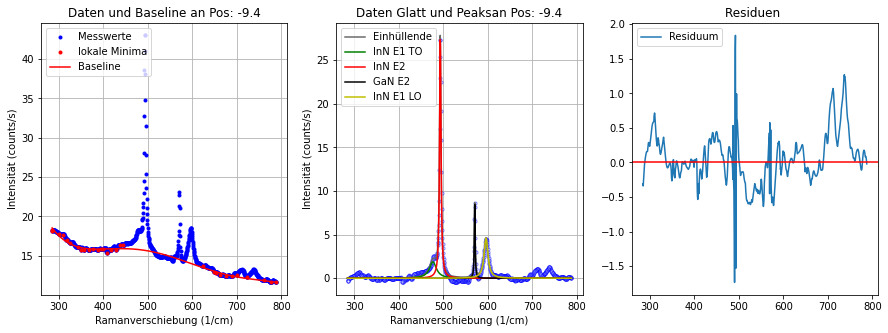

----------------------------------------------------------------------------------------------------
Position: -9.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.9742 11.0464 11.1135 ... 16.796  16.8642 16.8959]
Fitparameter 480: [1.6447545130992187, 52.03691510696652, 482.2116410299969]
Fitparameter InN E2: [26.133183990621976, 3.7889539091400093, 493.4024835144643]
Fitparameter InN LO: [4.456751918830724, 13.770441701115226, 595.7572049997032]
Fitparameter GaN E2:  [9.163912401394581, 2.538174734496213, 570.6509985090398]


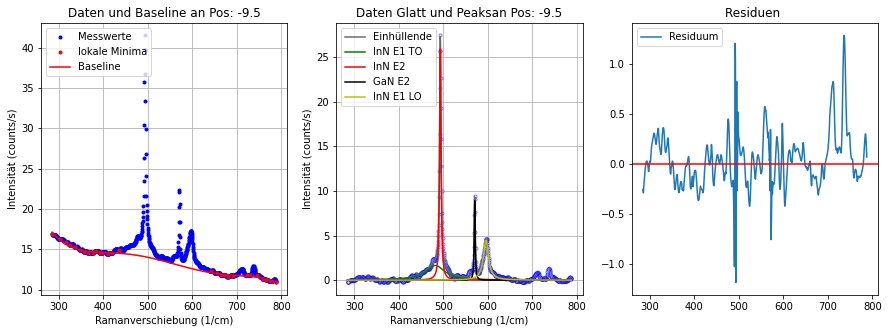

----------------------------------------------------------------------------------------------------
Position: -9.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.614  10.6679 10.712  ... 16.3144 16.2698 16.1808]
Fitparameter 480: [1.289343525219383, 16.407035893974722, 475.7008907556349]
Fitparameter InN E2: [25.592992238904497, 3.914537988992809, 493.3363807759553]
Fitparameter InN LO: [4.408193533878283, 10.326517806715264, 595.7764004556722]
Fitparameter GaN E2:  [8.555935554692622, 2.291865675380262, 570.7047869922721]


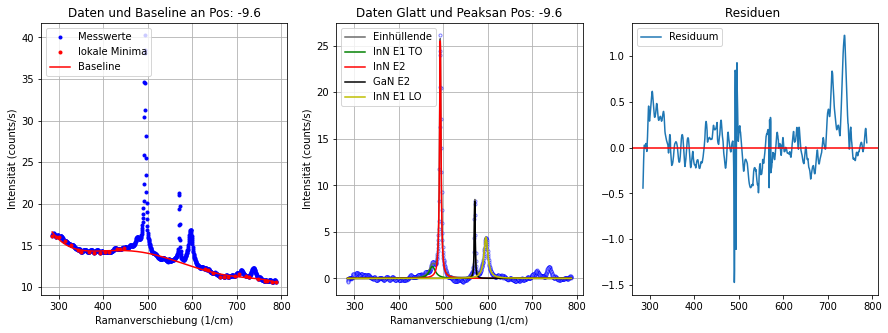

----------------------------------------------------------------------------------------------------
Position: -9.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [10.079  10.1914 10.2264 ... 15.6152 15.5749 15.529 ]
Fitparameter 480: [1.158053186499727, 28.186178423571405, 475.8013295271278]
Fitparameter InN E2: [23.02972408215971, 4.038762521546966, 493.3854123063755]
Fitparameter InN LO: [4.2441786093148055, 11.358571715291095, 596.1552153956674]
Fitparameter GaN E2:  [8.630355505626806, 2.4961893210747834, 570.6843710246425]


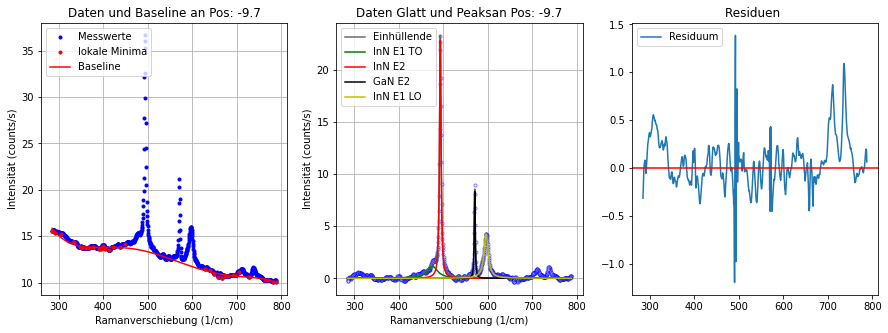

----------------------------------------------------------------------------------------------------
Position: -9.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 9.87066  9.86709  9.89931 ... 15.6619  15.7322  15.8279 ]
Fitparameter 480: [0.12532899964774927, 463465.6036201644, 489.99999999999926]
Fitparameter InN E2: [22.320878348710693, 4.032543364028723, 493.3621975139253]
Fitparameter InN LO: [3.8937643796983386, 10.087339246591897, 595.9184813045957]
Fitparameter GaN E2:  [8.505274126409537, 2.279065336825444, 570.7293272966025]


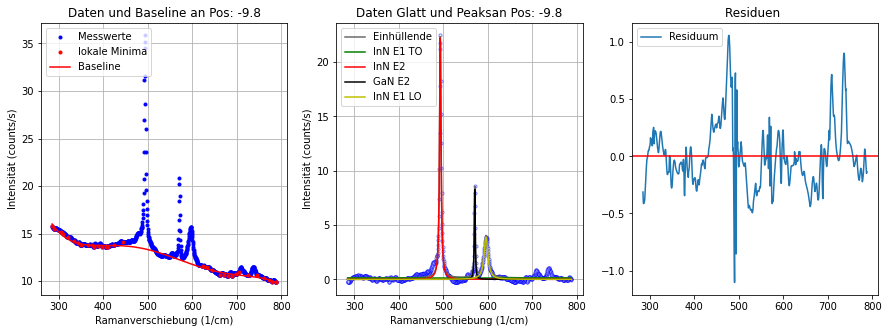

----------------------------------------------------------------------------------------------------
Position: -9.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 9.59853  9.56295  9.52681 ... 15.0151  14.9924  14.8642 ]
Fitparameter 480: [0.13164964547483846, 1363230.5491700466, 489.9999999999755]
Fitparameter InN E2: [21.410097843302417, 3.888465138994607, 493.3257602246654]
Fitparameter InN LO: [3.45425611949655, 9.818781113150955, 595.7049028385617]
Fitparameter GaN E2:  [7.637942322771804, 2.0567588892241, 570.7288015527752]


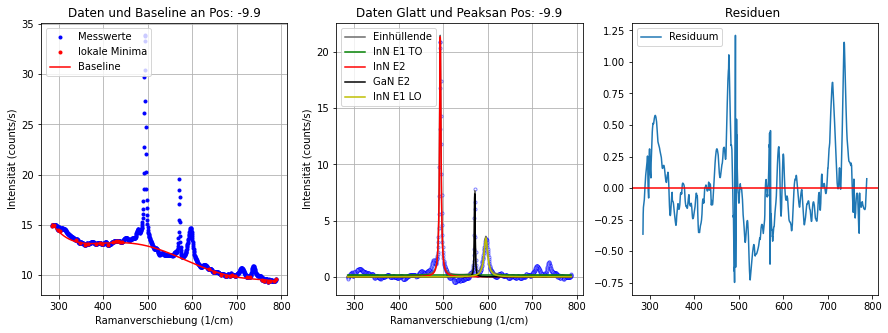

----------------------------------------------------------------------------------------------------
Position: -10.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 9.25729  9.22923  9.19583 ... 14.7335  14.7293  14.7232 ]
Fitparameter 480: [1.0990418757223996, 26.374164637549335, 477.072029427098]
Fitparameter InN E2: [20.183246191419677, 3.878484568129844, 493.3834882877798]
Fitparameter InN LO: [3.557785358348577, 12.328736360075633, 596.007663876103]
Fitparameter GaN E2:  [7.674091667555764, 2.4456799300107592, 570.7259544021846]


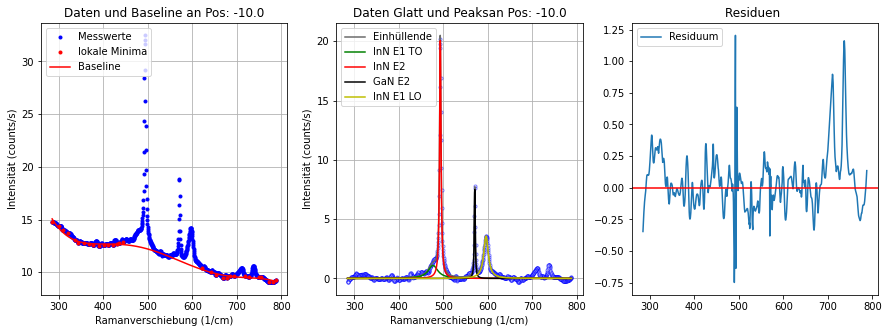

----------------------------------------------------------------------------------------------------
Position: -10.1
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 8.7016   8.62364  8.5832  ... 13.9811  13.9899  13.9723 ]
Fitparameter 480: [0.8931889929566523, 31.87458886636381, 477.34509554433987]
Fitparameter InN E2: [18.74561392085718, 3.862074871627915, 493.3786252569185]
Fitparameter InN LO: [3.3625185677877325, 11.502506501265824, 595.873089246849]
Fitparameter GaN E2:  [7.505809447353046, 2.297784890703832, 570.7101979431749]


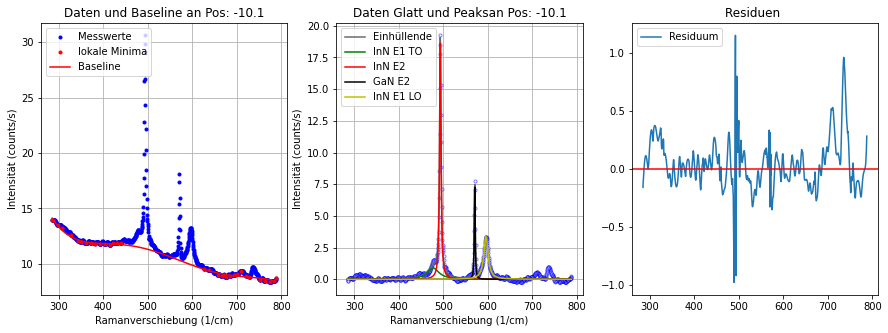

----------------------------------------------------------------------------------------------------
Position: -10.2
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 7.99157  7.9853   7.94773 ... 13.3301  13.3298  13.2742 ]
Fitparameter 480: [0.8061669451534531, 39.80267736450271, 477.27209266854715]
Fitparameter InN E2: [16.84257045631833, 3.766760298776747, 493.39101099535145]
Fitparameter InN LO: [3.0550833080400412, 12.99662769337631, 596.3924367004118]
Fitparameter GaN E2:  [7.075475768817474, 2.2525744403613985, 570.742607987051]


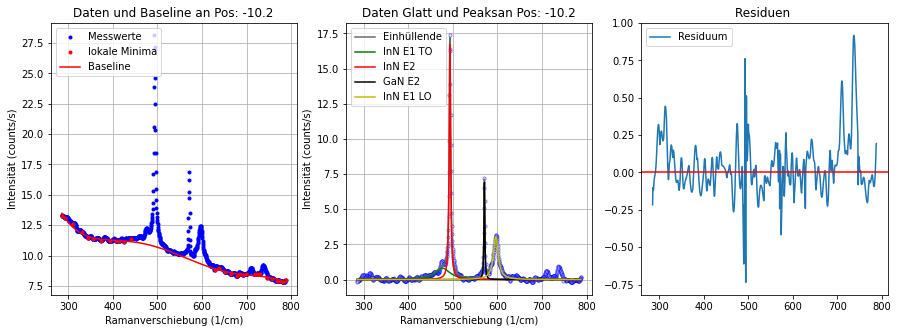

----------------------------------------------------------------------------------------------------
Position: -10.3
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 7.30625  7.32804  7.34915 ... 12.1679  12.1059  12.0482 ]
Fitparameter 480: [0.7991367446051894, 41.50076848695294, 476.4746175838624]
Fitparameter InN E2: [16.41880474060154, 3.685040903579851, 493.34239131713394]
Fitparameter InN LO: [2.7146584397003632, 12.409242366842214, 595.8878633890815]
Fitparameter GaN E2:  [6.687367732936694, 2.450778422884576, 570.7039944871121]


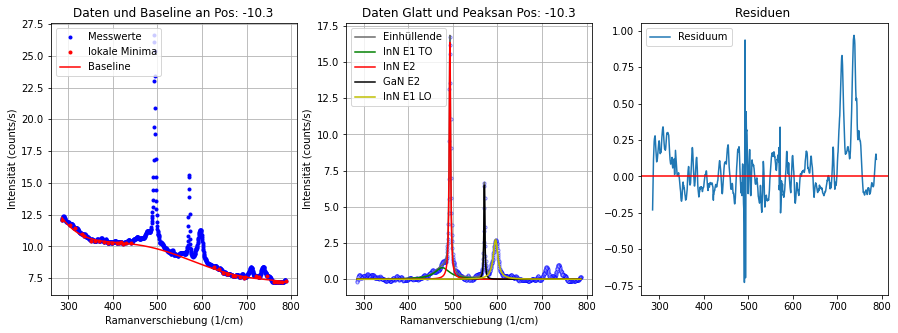

----------------------------------------------------------------------------------------------------
Position: -10.4
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 6.70746  6.71378  6.74436 ... 11.3434  11.2955  11.227  ]
Fitparameter 480: [0.9268008424398492, 41.29980568002708, 480.27042528201196]
Fitparameter InN E2: [14.901895038459017, 3.7160029958670293, 493.39379409299534]
Fitparameter InN LO: [2.707201843053985, 12.100127051724797, 595.9621100747388]
Fitparameter GaN E2:  [6.5039411347994704, 2.366796400792835, 570.7739032121777]


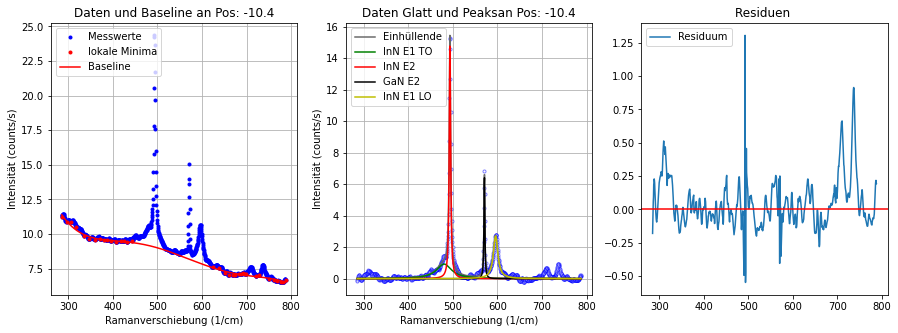

----------------------------------------------------------------------------------------------------
Position: -10.5
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [ 5.93418  5.94387  5.95298 ... 10.4663  10.495   10.5429 ]
Fitparameter 480: [0.5888613788480744, 18.54262666932535, 475.01553236089455]
Fitparameter InN E2: [13.39723621122911, 3.990017952684353, 493.3238354264057]
Fitparameter InN LO: [2.358056053124308, 11.784244432305998, 595.4979950713418]
Fitparameter GaN E2:  [6.08893653558693, 2.1730158800701496, 570.7652895230322]


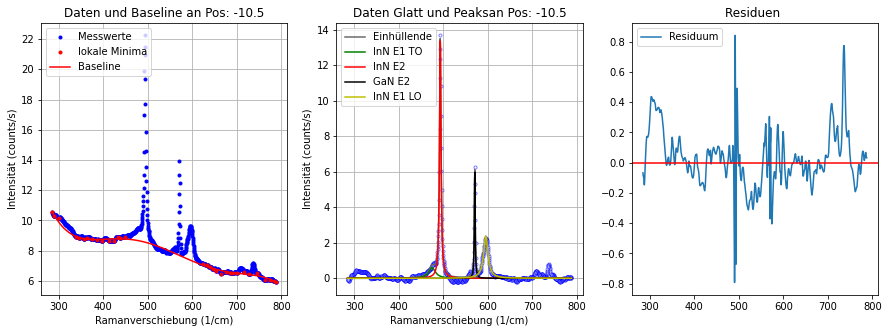

----------------------------------------------------------------------------------------------------
Position: -10.6
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [5.70075 5.68583 5.6726  ... 9.87975 9.87403 9.85597]
Fitparameter 480: [0.5974517984110987, 32.27870849945332, 477.9188294436099]
Fitparameter InN E2: [12.147579184436497, 4.015258022549611, 493.3393955287244]
Fitparameter InN LO: [2.179978013521848, 11.148074127079193, 596.0366882899287]
Fitparameter GaN E2:  [5.540119389867577, 2.2354954923679284, 570.7843660469857]


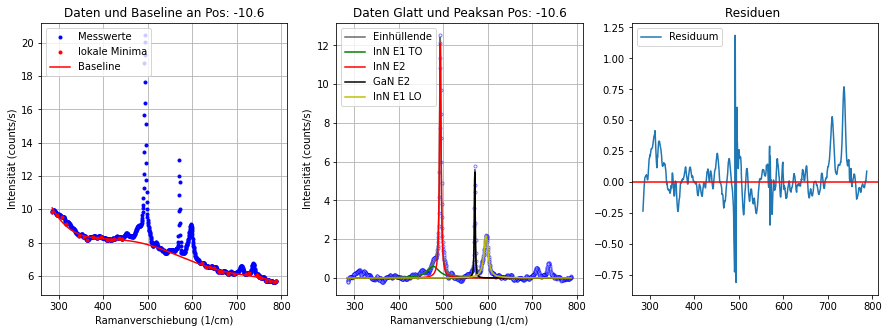

----------------------------------------------------------------------------------------------------
Position: -10.7
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [5.31639 5.35375 5.36808 ... 9.31473 9.29042 9.26505]
Fitparameter 480: [0.5772976740306102, 37.441481590881125, 478.63639369331815]
Fitparameter InN E2: [11.877336747933906, 3.643096857269422, 493.32078350230415]
Fitparameter InN LO: [1.98896976105445, 12.595420586875873, 595.5525496669096]
Fitparameter GaN E2:  [5.23869169570073, 2.2128198538587767, 570.7265134883019]


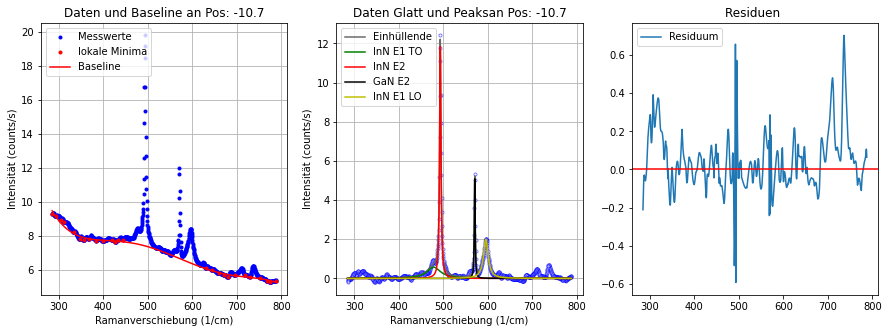

----------------------------------------------------------------------------------------------------
Position: -10.8
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.91458 4.90866 4.89891 ... 8.96969 8.97068 8.97864]
Fitparameter 480: [0.5170948047072889, 30.25962761526627, 477.9701995065463]
Fitparameter InN E2: [10.458390645156783, 3.8685047860805915, 493.38160167982863]
Fitparameter InN LO: [1.8947434000944812, 10.614506812725564, 596.0038713228813]
Fitparameter GaN E2:  [4.657215677812146, 2.359190409954458, 570.7346594945727]


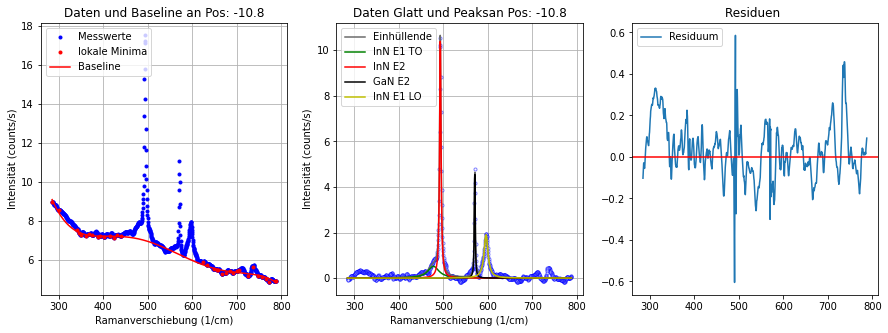

----------------------------------------------------------------------------------------------------
Position: -10.9
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.88388 4.84702 4.82415 ... 8.43157 8.42714 8.65273]
Fitparameter 480: [0.5007204310708738, 40.319313777286254, 478.1076002001292]
Fitparameter InN E2: [9.645363518936097, 3.784614976889213, 493.33806116470436]
Fitparameter InN LO: [1.6998613259575925, 11.128950827565616, 595.7204680076669]
Fitparameter GaN E2:  [4.480521581681562, 2.3542372924106076, 570.7432607488837]


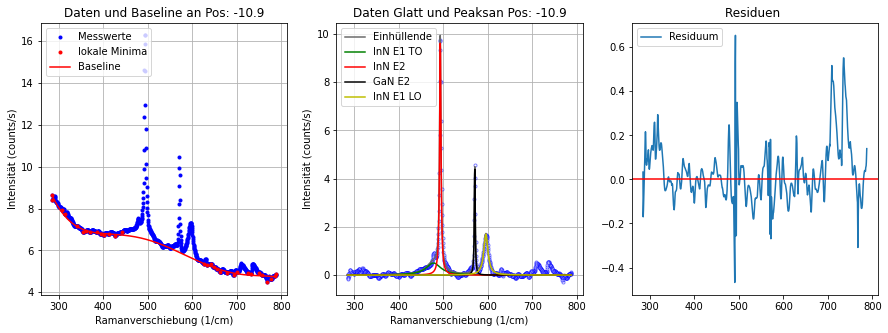

----------------------------------------------------------------------------------------------------
Position: -11.0
x-Daten: [787.55506436 787.08259436 786.61206436 ... 286.13303436 285.62342436
 285.11170436]
y-Daten: [4.50282 4.48649 4.47057 ... 7.89678 7.87044 7.83874]
Fitparameter 480: [0.5328193362784625, 29.10459899145167, 480.70746738822123]
Fitparameter InN E2: [9.202301736973578, 3.750988135864745, 493.3633926371461]
Fitparameter InN LO: [1.5485903214755632, 10.755977026237613, 596.3081610971508]
Fitparameter GaN E2:  [4.131948977487572, 2.3605228898059587, 570.722203438656]
BILD an Pos:  -11.0


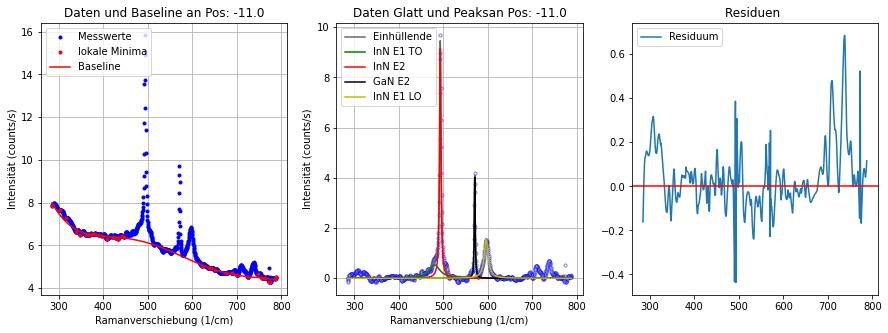

----------------------------------------------------------------------------------------------------


In [52]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Peaks_Liste_480=[]
GaN_E2_Peaks_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_MBE_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_MBE_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_MBE_array_float[0],[0])
        y=np.delete(data_MBE_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=4)[0]]
        xzw=x[argrelextrema(y, np.less,order=4)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for j in range(len(xzw)):
            if xzw[j]<=450 or xzw[j]>=620:
                xmin.append(xzw[j])
                ymin.append(yzw[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1]) 
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])

        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        #fitten 4 lorentz in 480, InN E2 498, GaN E2 570, InN LO 595
        #L_x4(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4)
        init_vals_L_x4 = [1,1,475, 5,1,498, 1,1,570, 1,1,595]
        param_bounds_L_x4= ([0,0,470, 0,0,485, 0,0,560, 0,0,585],[np.inf,np.inf,490, np.inf,10,505, np.inf,30,585, np.inf,50,605])
        fitParams_L_x4, cov_L_x4 = curve_fit(f=L_x4, xdata=x, ydata=y_glatt, p0=init_vals_L_x4, bounds=param_bounds_L_x4)
        fitParams_L_480=[fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2]]
        fitParams_L_InN_E2=[fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5]]
        fitParams_L_GaN_E2=[fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8]]
        fitParams_L_InN_LO=[fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]]
        print("Fitparameter 480:",fitParams_L_480)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter GaN E2: ", fitParams_L_GaN_E2)
        
        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2], fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8],fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), color='dimgray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,Lorentz(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2]), color='g'  ,markersize=3, label='InN E1 TO')
        plt.plot(x,Lorentz(x, fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5]), color='r'  ,markersize=3, label='InN E2')
        plt.plot(x,Lorentz(x, fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8]), color='black'  ,markersize=3, label='GaN E2')
        plt.plot(x,Lorentz(x, fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), color='y'  ,markersize=3, label='InN E1 LO')
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        plt.plot(x,y_glatt-L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2], fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8],fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
        
        if i == data_MBE_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MBE Auswertung D1 532nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MBE Auswertung D1 532nm Position '+ str(position) + '.png')
        if i == data_MBE_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/MBE Auswertung D1 532nm Position '+ str(position) + '.png')
            
        plt.show()
     
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Peaks_Liste_480.append([position, fitParams_L_480])
        GaN_E2_Peaks_Liste.append([position, fitParams_L_GaN_E2])
        Baseline_Liste.append([position,fitParams_base])
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

In [53]:
# Verhalten Asymmetrischer Gauß und Baseline

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]#
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
#    Base_Para_3.append(Baseline_Liste[k][1][2])
#    Base_Para_4.append(Baseline_Liste[k][1][3])
#    Base_Para_5.append(Baseline_Liste[k][1][4])
#    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [22.55019741  1.83165219 -9.55262863  1.2217524   3.24308493]
Asym Gauß LO Parameter Amp-R: [ 4.58821863  1.46939054 -7.90848054 -0.59825219  0.74260176]
Asym Gauß GaN Parameter Amp-R: [ 7.50922737  1.64800126 -9.70501042  0.70557235  1.01475553]
Gauß E2 Parameter Amp-R: [37.80084509 -4.11782349 -8.51395254 -5.156359  ]
Gauß LO Parameter Amp-R: [ 6.86138312 -4.04748122 -8.49249071 -1.02660639]
Gauß GaN Parameter Amp-R: [11.09326416  4.2733283  -8.98275141 -1.49209718]


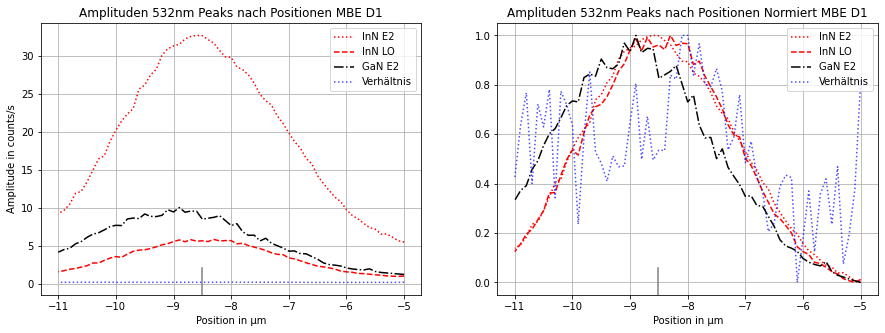

In [54]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_480_Amp=[]
Peak_GaN_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_480_Amp.append(Peaks_Liste_480[i][1][0])
    Peak_GaN_E2_Amp.append(GaN_E2_Peaks_Liste[i][1][0])
 
    
Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    
    
    
#Fitten Asym Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,-9,0,10]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,-9,0,1]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 

init_vals_AG_GaN = [1,1,-9,0,5]
param_bounds_AG_GaN= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_GaN, cov_AG_GaN = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_GaN_E2_Amp, p0=init_vals_AG_GaN, bounds=param_bounds_AG_GaN)
print("Asym Gauß GaN Parameter Amp-R:",fitParams_AG_GaN) 


#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,-9,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,-9,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 
    
init_vals_G_GaN = [1,1,-9,5]
param_bounds_G_GaN= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_GaN, cov_G_GaN = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_GaN_E2_Amp, p0=init_vals_G_GaN, bounds=param_bounds_G_GaN)
print("Gauß GaN Parameter Amp-R:",fitParams_G_GaN) 
    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden 532nm Peaks nach Positionen MBE D1')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_GaN_E2_Amp,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp,':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_480_Amp, '-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='InN E2 Fitt Asym')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='InN LO Fitt Asym')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_GaN[0],fitParams_AG_GaN[1],fitParams_AG_GaN[2],fitParams_AG_GaN[3],fitParams_AG_GaN[4]),'-.', color='black'  ,markersize=2, label='GaN Fitt Asym')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')
#plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_GaN[0],fitParams_G_GaN[1],fitParams_G_GaN[2],fitParams_G_GaN[3]),'-*', color='y'  ,markersize=4, label='InN LO Lorentz')

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=0,s='InN')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden 532nm Peaks nach Positionen Normiert MBE D1')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_GaN_E2_Amp),'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_480_Amp), '-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5

#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_532nm/MBE Amplituden Peaks nach Positionen D1 532nm')
plt.show()



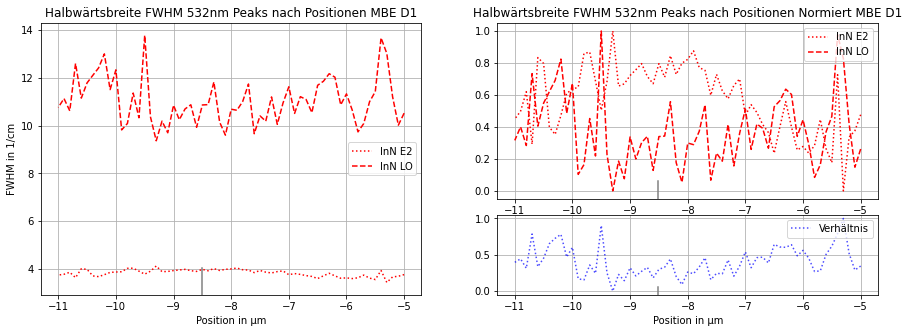

In [55]:
# Halbwärtsbreiten fwhm nach Positionen
 
#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_480_fwhm=[]
Peak_GaN_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_480_fwhm.append(Peaks_Liste_480[i][1][1])
    Peak_GaN_E2_fwhm.append(GaN_E2_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
#Plotten
#fig = plt.figure(figsize=(15,5))

#plt.subplot(1, 2, 1) 
#plt.title('Halbwärtsbreite fwhm 532nm Peaks nach Positionen MBE D1')
#plt.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_480_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_GaN_E2_fwhm,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_fwhm, ':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
   
#plt.xlabel('Position')
#plt.ylabel('Halbwärtsbreite fwhm')
#plt.grid(True)
#plt.legend(loc='upper right')

#plt.subplot(1, 2, 2) 
#plt.title('Halbwärtsbreite fwhm 532nm Peaks nach Positionen Normiert MBE D1')
#plt.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_480_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen,  NormalizeData(Peak_GaN_E2_fwhm),'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.xlabel('Position')
#plt.ylabel('Amplitude')
#plt.grid(True)
#plt.legend(loc='upper right')


#Plotten
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='center right')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm),s='InN')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
ax1.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen MBE D1")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax2.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')
ax2.set_title("Halbwärtsbreite FWHM 532nm Peaks nach Positionen Normiert MBE D1")


ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position in \u03bcm')
#plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
#ax3.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=0.1, color='gray')

plt.savefig('Bilder_Graphen_532nm/MBE Halbwärtsbreite fwhm Peaks nach Positionen D1 532nm')
plt.show()

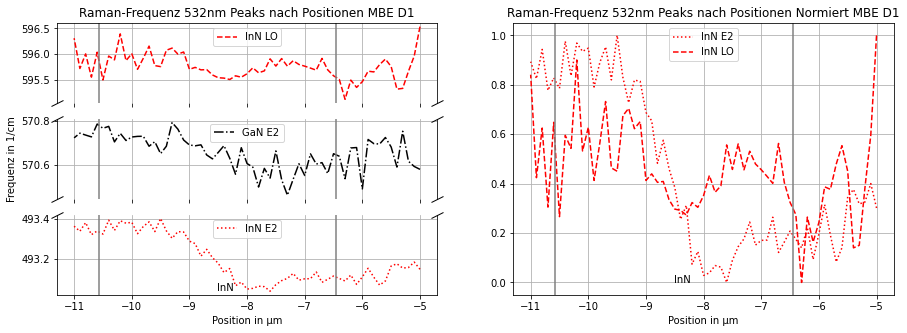

In [56]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_480_w=[]
Peak_GaN_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_480_w.append(Peaks_Liste_480[i][1][2])
    Peak_GaN_E2_w.append(GaN_E2_Peaks_Liste[i][1][2])
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_GaN_E2_w,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_w),s='InN')
#ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_Saphir_418_w),s='Saphir')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz in 1/cm')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 532nm Peaks nach Positionen MBE D1")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_GaN_E2_w),'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz 532nm Peaks nach Positionen Normiert MBE D1")
ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2],y=0,s='InN')

plt.savefig('Bilder_Graphen_532nm/MBE Raman-Frequenz Peaks nach Positionen D1 532nm')
plt.show()

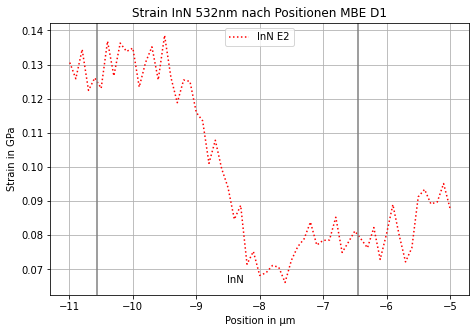

In [57]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain InN 532nm nach Positionen MBE D1')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_532nm/MBE Strain nach Positionen D1 532nm')
plt.show()

# GaN Dotiert mit Ge

Probenoberfläche vor Messung
<img src="Daten/Ga_Oberfläche_2a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten/Ga_Oberfläche_2b.jpg" style="width:300px;"/>

## Datenladen

In [58]:
#Path zu daten definieren
path = "./Daten//"  

In [59]:
#wegen verwechslung wird im folgendem GaN mit Ge abgekürtzt zur identifikation (zu faul um zu ändern gerade)

#öffnen und einlesen der Daten aus der txt datei
with open(path + "Ge MD9299_Bild2_D1_2x60s.txt") as f1:
        data_GaN_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_GaN_array_str = np.array(data_GaN_txt)               #in np array umwandeln um listen von listen zu entkommen
data_GaN_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_GaN_array_float = data_GaN_array_str.astype(float)   #str zu float in Arrayform
print(data_GaN_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_GaN_array_float[0])):
    data_GaN_array_float[0][k]=data_GaN_array_float[0][k]-Verschiebung_A_plane
print(data_GaN_array_float)

[[  0.      776.10089 775.62744 ... 273.35651 272.84366 272.33289]
 [ -8.       11.7829   11.7693  ...  11.0318   11.1156   11.2372 ]
 [ -8.1      11.5444   11.494   ...  10.9496   10.9743   10.9983 ]
 ...
 [-15.8       8.16212   8.05015 ...   7.03791   6.97325   6.92372]
 [-15.9       7.82882   7.76048 ...   6.49999   6.44161   6.38841]
 [-16.        7.34379   7.71955 ...   6.72715   6.75112   6.7958 ]]
[[ -7.90178564 768.19910436 767.72565436 ... 265.45472436 264.94187436
  264.43110436]
 [ -8.          11.7829      11.7693     ...  11.0318      11.1156
   11.2372    ]
 [ -8.1         11.5444      11.494      ...  10.9496      10.9743
   10.9983    ]
 ...
 [-15.8          8.16212      8.05015    ...   7.03791      6.97325
    6.92372   ]
 [-15.9          7.82882      7.76048    ...   6.49999      6.44161
    6.38841   ]
 [-16.           7.34379      7.71955    ...   6.72715      6.75112
    6.7958    ]]


## Fitten und Plotten

In [60]:
#for i in range(data_Ge_array_float.shape[0]):
#    if i==0: pass
#    else:
#        x=np.delete(data_Ge_array_float[0],[0])
#        y=np.delete(data_Ge_array_float[i],[0])
#        position = data_Ge_array_float[i][0]
#        fig = plt.figure(figsize=(15,5))
#            # Plot 1 für Daten roh und baseline
#        plt.title('Daten und Baseline an Pos: '+str(position))
#        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
#        plt.xlabel('Ramanverschiebung (1/cm)')
#        plt.ylabel('Intensität (counts/s)')
#        plt.grid(True)
#        plt.legend()
#        plt.show()

Position: -8.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.7829 11.7693 11.7605 ... 11.0318 11.1156 11.2372]
(1024,)
Hintergrund Parameter:  [ 1.24046809e-12 -3.43971420e-09  3.61496927e-06 -1.81329901e-03
  4.42892189e-01 -3.11228057e+01]
Fitparameter Saphir 418: [1.337515641987669, 4.451600723047833, 418.470328372745]
Fitparameter GaN A1 LPP 531: [8.557045673492901, 19.508174039619913, 526.439612881844]
Fitparameter GaN E2 568: [101.98980058227129, 3.0134469941097333, 571.0383725355073]
Fitparameter Saphir 650: [0.2775559775432378, 4.999999999854675, 645.0000000005255]
Fitparameter GaN 650: [1.0366498523903176, 35.70057990205438, 661.4360774318166]
Fitparameter GaN LO 741: [4.5684983148033576, 6.070225019150106, 736.5065353052523]


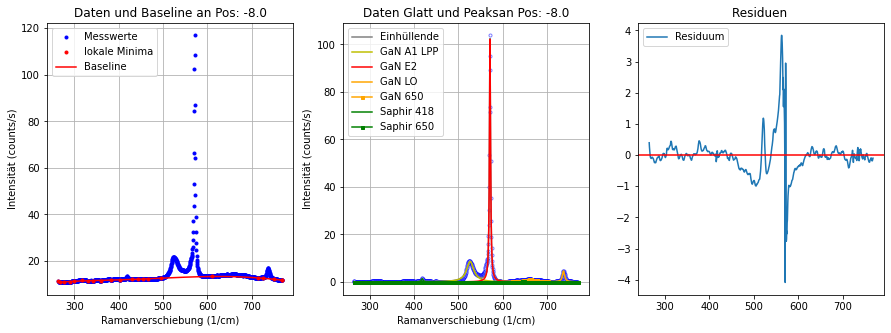

----------------------------------------------------------------------------------------------------
Position: -8.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.5444 11.494  11.4525 ... 10.9496 10.9743 10.9983]
(1024,)
Hintergrund Parameter:  [-1.83594130e-14 -3.67555093e-10  7.21449116e-07 -4.99637508e-04
  1.54497197e-01 -6.61717174e+00]
Fitparameter Saphir 418: [1.552224335114065, 3.9786914208001156, 418.4215805403607]
Fitparameter GaN A1 LPP 531: [9.00500512259984, 19.924854932879544, 526.446462232662]
Fitparameter GaN E2 568: [105.80870130503253, 3.0403118062045476, 571.0294054667955]
Fitparameter Saphir 650: [0.19268671342960014, 4.999999999993452, 645.0000000018636]
Fitparameter GaN 650: [1.0674000182516579, 33.05695984978883, 658.2558681652398]
Fitparameter GaN LO 741: [4.441798209791536, 5.7814300642395295, 736.682751062693]
BILD an Pos:  -8.1


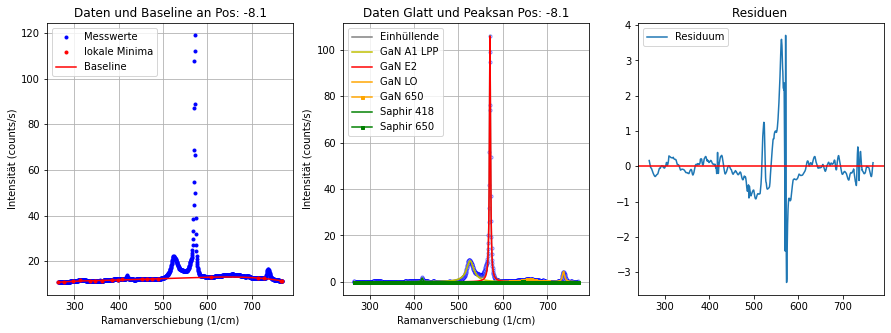

----------------------------------------------------------------------------------------------------
Position: -8.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.8951 10.9405 11.0003 ... 10.7785 10.7385 10.6868]
(1024,)
Hintergrund Parameter:  [ 4.01218777e-13 -1.35090105e-09  1.58736029e-06 -8.57119285e-04
  2.24164383e-01 -1.20085760e+01]
Fitparameter Saphir 418: [1.5884377744964748, 3.6034339270182008, 418.3200911399383]
Fitparameter GaN A1 LPP 531: [9.497851808511228, 18.815584949251345, 526.4351330900123]
Fitparameter GaN E2 568: [110.07543305990386, 3.044749710293214, 571.0343759496777]
Fitparameter Saphir 650: [3.8757759081462124, 0.041941171785399814, 647.5155692201032]
Fitparameter GaN 650: [1.2381871656283203, 34.82353635269836, 659.5438220779115]
Fitparameter GaN LO 741: [5.282995838775899, 6.098200927373063, 736.6365483863075]


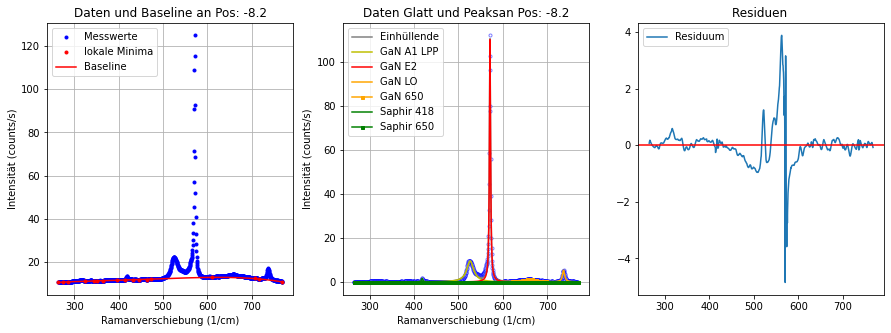

----------------------------------------------------------------------------------------------------
Position: -8.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.8302 10.8636 10.9111 ... 10.7512 10.7826 10.8268]
(1024,)
Hintergrund Parameter:  [ 2.35933237e-12 -6.41876106e-09  6.67381036e-06 -3.32377415e-03
  7.99999956e-01 -6.36008333e+01]
Fitparameter Saphir 418: [1.359164252742658, 6.068145433162662, 418.575112865022]
Fitparameter GaN A1 LPP 531: [9.914916621621575, 18.728782399662382, 526.298763912957]
Fitparameter GaN E2 568: [115.94939378271019, 3.041188013285268, 571.0296298658878]
Fitparameter Saphir 650: [0.40022624065041457, 4.999999999999999, 645.0000000355082]
Fitparameter GaN 650: [1.1413410517801645, 34.89085146709109, 662.7169077466848]
Fitparameter GaN LO 741: [5.317963496688865, 6.434348704461763, 736.7702476138262]


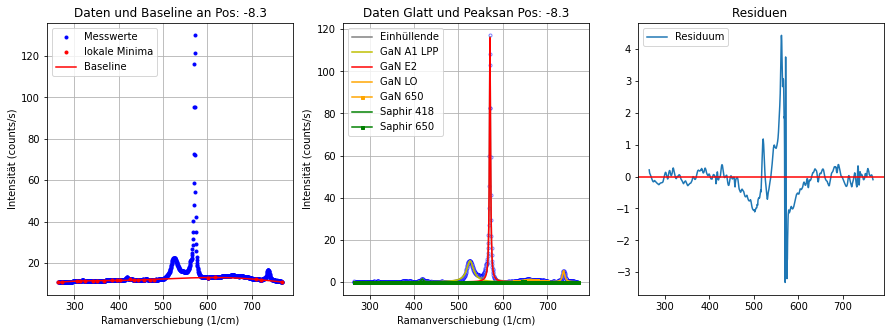

----------------------------------------------------------------------------------------------------
Position: -8.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.8925 10.8211 10.8057 ... 10.7151 10.6948 10.7094]
(1024,)
Hintergrund Parameter:  [ 9.45791336e-13 -2.99170528e-09  3.48794924e-06 -1.91100379e-03
  5.02415647e-01 -3.97527527e+01]
Fitparameter Saphir 418: [1.8361344663473445, 2.8231246332805604, 418.4034252169274]
Fitparameter GaN A1 LPP 531: [10.911913677908146, 19.089844542092848, 526.2537596544794]
Fitparameter GaN E2 568: [123.50478780767837, 3.057004679734804, 571.0272653818643]
Fitparameter Saphir 650: [517.6444933463303, 0.0017442347237725511, 645.0369753902326]
Fitparameter GaN 650: [1.2084251049918862, 33.50303986516617, 659.8423996384815]
Fitparameter GaN LO 741: [5.0065828001016035, 6.118941122640555, 736.5749606859405]


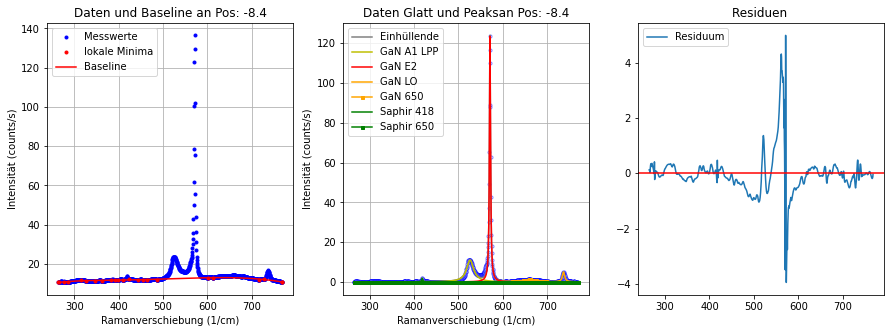

----------------------------------------------------------------------------------------------------
Position: -8.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.7907 10.7753 10.7883 ... 11.0001 10.898  10.7314]
(1024,)
Hintergrund Parameter:  [-2.28864682e-12  2.97377146e-09  1.63128579e-07 -1.69934816e-03
  8.00385268e-01 -9.90040369e+01]
Fitparameter Saphir 418: [1.2266566542433843, 2.2828201286784484, 418.03926846750716]
Fitparameter GaN A1 LPP 531: [11.992773873152455, 27.267577600923147, 527.2004548356429]
Fitparameter GaN E2 568: [130.4239281115072, 3.158037979483865, 571.0229999534306]
Fitparameter Saphir 650: [0.7999961747003694, 4.999999998251833, 654.9999999962743]
Fitparameter GaN 650: [0.5927104237656727, 26.691665714332185, 640.0000000000001]
Fitparameter GaN LO 741: [5.066458948485448, 3.4512044311895926, 736.4543757121755]


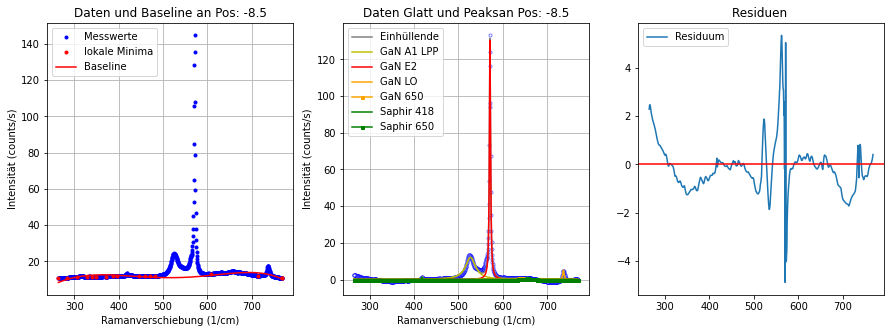

----------------------------------------------------------------------------------------------------
Position: -8.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.534  10.65   10.7403 ... 10.9768 11.0277 11.1647]
(1024,)
Hintergrund Parameter:  [ 1.14419118e-13 -8.98980677e-10  1.40563478e-06 -8.85005353e-04
  2.52098455e-01 -1.56439302e+01]
Fitparameter Saphir 418: [1.3570550191712536, 5.835856874646394, 418.4173026655043]
Fitparameter GaN A1 LPP 531: [11.888042836521697, 19.46610032196912, 526.2563804093013]
Fitparameter GaN E2 568: [135.36699975524877, 3.070973990371592, 571.025990704474]
Fitparameter Saphir 650: [0.18324358086748269, 3.1049308387387318, 654.9722448289789]
Fitparameter GaN 650: [1.1871877125500627, 26.292862188624124, 659.7647649438595]
Fitparameter GaN LO 741: [5.685360244457744, 5.538447408008875, 736.5555615831258]


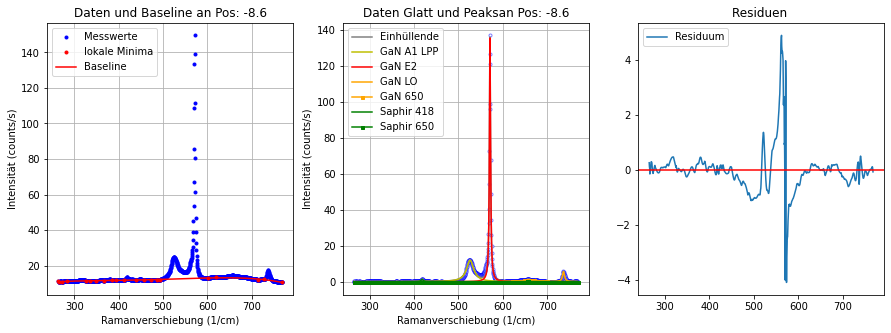

----------------------------------------------------------------------------------------------------
Position: -8.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.9008 10.5468 10.4819 ... 11.0799 11.052  11.0066]
(1024,)
Hintergrund Parameter:  [ 1.57676856e-12 -4.49531968e-09  4.83061400e-06 -2.46269910e-03
  6.03467854e-01 -4.58303059e+01]
Fitparameter Saphir 418: [1.5186867203320826, 5.5227291751485215, 418.2861896046248]
Fitparameter GaN A1 LPP 531: [12.63324713966051, 18.900972981009684, 526.209660388194]
Fitparameter GaN E2 568: [141.04300354402724, 3.0895524681737894, 571.0243270015827]
Fitparameter Saphir 650: [6.869241479829128, 0.04587312011485114, 651.8855854574571]
Fitparameter GaN 650: [1.4942091707756968, 33.056594287773365, 660.8004561167522]
Fitparameter GaN LO 741: [5.911034315123738, 5.874749006772654, 736.7073813395416]


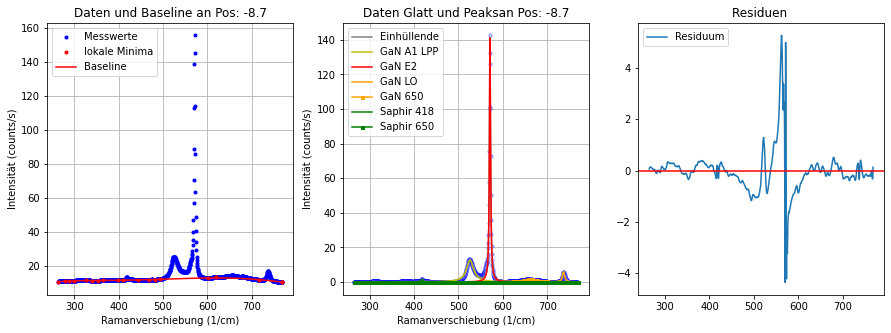

----------------------------------------------------------------------------------------------------
Position: -8.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.7173 10.7499 10.7827 ... 11.4215 11.4244 11.4203]
(1024,)
Hintergrund Parameter:  [ 1.14114292e-12 -3.42853955e-09  3.79788806e-06 -1.96892287e-03
  4.87416747e-01 -3.49233018e+01]
Fitparameter Saphir 418: [1.3719067885441467, 6.592678117804197, 418.6401134031815]
Fitparameter GaN A1 LPP 531: [13.428064184745063, 18.732879378271967, 526.3045738983612]
Fitparameter GaN E2 568: [149.83218086536016, 3.087390901324528, 571.0213439686862]
Fitparameter Saphir 650: [0.3765217779133536, 4.999999999863245, 649.3326926787255]
Fitparameter GaN 650: [1.3794714971174857, 27.631964328239036, 663.7823774730061]
Fitparameter GaN LO 741: [5.92582108213952, 5.7516562005842164, 736.6714587417126]


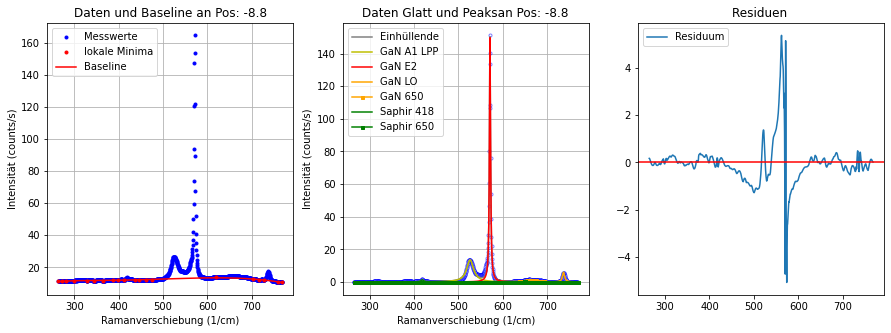

----------------------------------------------------------------------------------------------------
Position: -8.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.974  10.9601 10.9619 ... 11.7656 11.7397 11.7108]
(1024,)
Hintergrund Parameter:  [ 1.77380087e-12 -5.01718190e-09  5.35108388e-06 -2.70691068e-03
  6.57131334e-01 -4.96207362e+01]
Fitparameter Saphir 418: [1.516379448448279, 6.922133041992587, 418.3874967404522]
Fitparameter GaN A1 LPP 531: [14.716111158714227, 18.862923830995502, 526.2304612619016]
Fitparameter GaN E2 568: [162.58472048530592, 3.092636312311141, 571.019801387797]
Fitparameter Saphir 650: [0.5014694725605837, 4.999999999999999, 646.3708522671739]
Fitparameter GaN 650: [1.6514446922148662, 36.79349471473765, 664.7494630401789]
Fitparameter GaN LO 741: [6.710087431247625, 5.5849546138427035, 736.6430116590119]


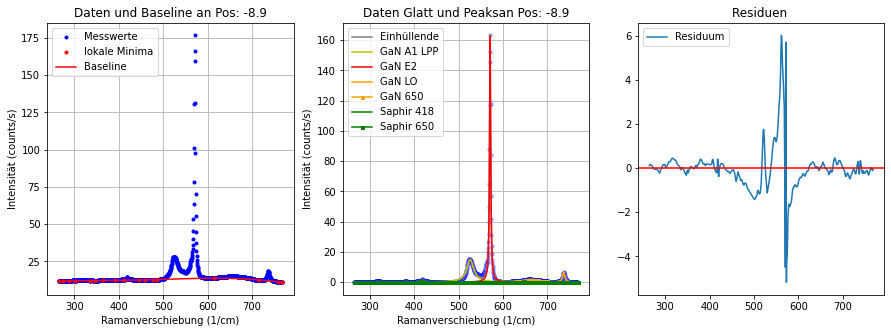

----------------------------------------------------------------------------------------------------
Position: -9.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.2591 11.2488 11.2355 ... 12.1935 12.2039 12.2594]
(1024,)
Hintergrund Parameter:  [ 2.13391210e-12 -5.91663983e-09  6.18933386e-06 -3.06647403e-03
  7.26967569e-01 -5.39382956e+01]
Fitparameter Saphir 418: [1.367030379394491, 7.799798576576191, 418.911596314895]
Fitparameter GaN A1 LPP 531: [15.919439864574963, 18.3651998660593, 526.2422779660153]
Fitparameter GaN E2 568: [172.68887230359005, 3.1114931089343476, 571.025836556615]
Fitparameter Saphir 650: [1.9080616855497303, 0.01575406144096899, 650.2692795540778]
Fitparameter GaN 650: [1.78903627200597, 30.414987200455755, 661.786002816852]
Fitparameter GaN LO 741: [6.896204184378986, 5.583649049674852, 736.6587084552655]


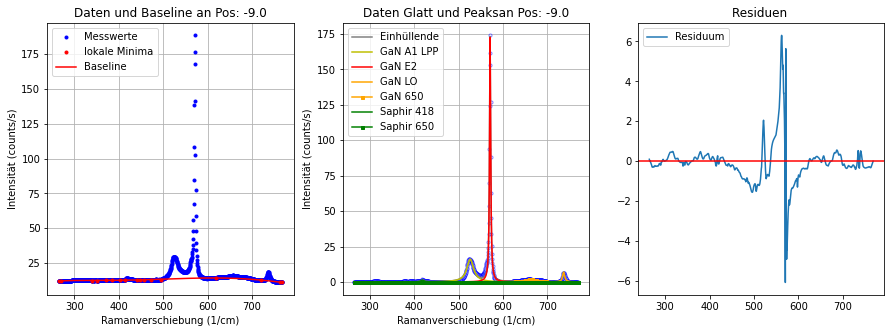

----------------------------------------------------------------------------------------------------
Position: -9.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.5517 11.49   11.4407 ... 12.684  12.7295 12.7796]
(1024,)
Hintergrund Parameter:  [ 2.96539414e-12 -8.14396371e-09  8.49755186e-06 -4.21556175e-03
  9.99656191e-01 -7.82303583e+01]
Fitparameter Saphir 418: [1.5180129776758224, 10.116788158811767, 418.71690652482704]
Fitparameter GaN A1 LPP 531: [16.99035485101388, 18.906078499190247, 526.2414995071819]
Fitparameter GaN E2 568: [182.98554237441513, 3.0804149675342147, 571.023010982825]
Fitparameter Saphir 650: [6.738664828935891, 0.07800571709254855, 653.8118945388169]
Fitparameter GaN 650: [1.9317048974375934, 32.700932471971406, 662.6329342665454]
Fitparameter GaN LO 741: [7.025681333707775, 5.692301883436319, 736.6587260040999]


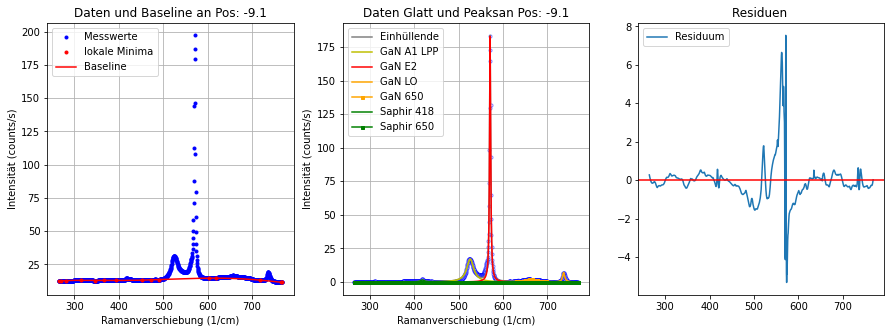

----------------------------------------------------------------------------------------------------
Position: -9.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.2627 11.2449 11.2892 ... 12.7928 12.739  12.6807]
(1024,)
Hintergrund Parameter:  [ 9.83781248e-13 -3.31874861e-09  3.97148497e-06 -2.18244403e-03
  5.64950434e-01 -4.27331784e+01]
Fitparameter Saphir 418: [1.4565526595276408, 7.222758472189437, 419.2953865345223]
Fitparameter GaN A1 LPP 531: [18.263140250157946, 18.527766033235142, 526.2555104795271]
Fitparameter GaN E2 568: [192.134692617046, 3.126563433748389, 571.0183380307989]
Fitparameter Saphir 650: [9.030402273269338, 0.05961032240896274, 649.9296037962881]
Fitparameter GaN 650: [1.9872125846553301, 31.640794570149286, 661.6700089321439]
Fitparameter GaN LO 741: [7.331110846529797, 5.387949265542054, 736.7111421419089]


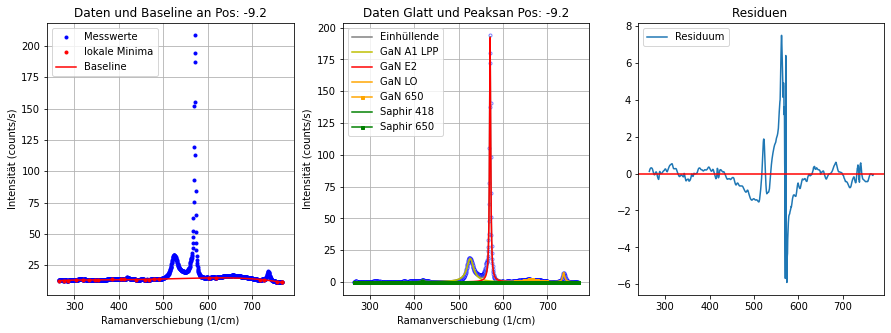

----------------------------------------------------------------------------------------------------
Position: -9.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.7195 11.7552 11.8012 ... 13.5294 13.5555 13.623 ]
(1024,)
Hintergrund Parameter:  [-6.51073794e-13  9.19186388e-10 -2.58746615e-07 -1.51977160e-04
  9.47810174e-02 -4.26639485e-05]
Fitparameter Saphir 418: [1.9100147673868284, 4.601935786134242, 418.1158925015965]
Fitparameter GaN A1 LPP 531: [19.821526337883064, 19.998929946538176, 526.4489890515683]
Fitparameter GaN E2 568: [206.77942464321447, 3.176520916959764, 571.0087331340623]
Fitparameter Saphir 650: [2.4364423954367878, 3.3227993738712343e-07, 653.8675666949085]
Fitparameter GaN 650: [2.5386793393124916, 42.77644061473935, 659.5414462518576]
Fitparameter GaN LO 741: [7.528538326282656, 4.998326121702042, 736.6273754957182]


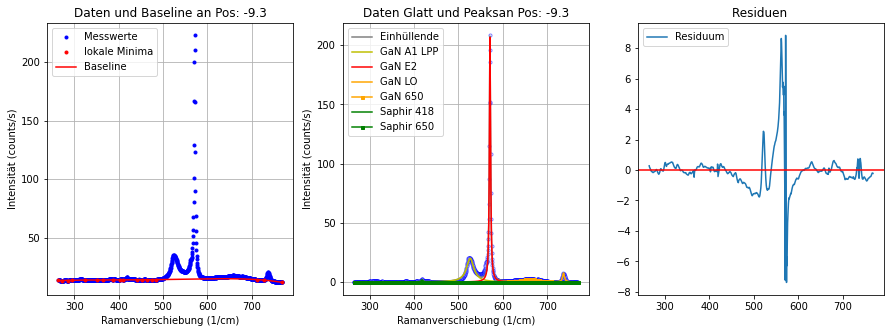

----------------------------------------------------------------------------------------------------
Position: -9.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [12.0859 12.1504 12.2051 ... 14.2312 14.1967 14.2051]
(1024,)
Hintergrund Parameter:  [ 1.11012110e-12 -3.87802535e-09  4.71383766e-06 -2.59965649e-03
  6.68082543e-01 -5.04397318e+01]
Fitparameter Saphir 418: [1.96919178413483, 6.054527367217142, 418.39724902024557]
Fitparameter GaN A1 LPP 531: [21.92577897325075, 18.570570337051414, 526.2149971139869]
Fitparameter GaN E2 568: [225.0811287368788, 3.1535404415306982, 570.9991709735125]
Fitparameter Saphir 650: [0.5722003954962868, 4.999999999999999, 645.1912071508347]
Fitparameter GaN 650: [1.997654806898337, 23.87603950247158, 661.8203527245182]
Fitparameter GaN LO 741: [7.884296915497095, 4.933583355553803, 736.7990934942803]


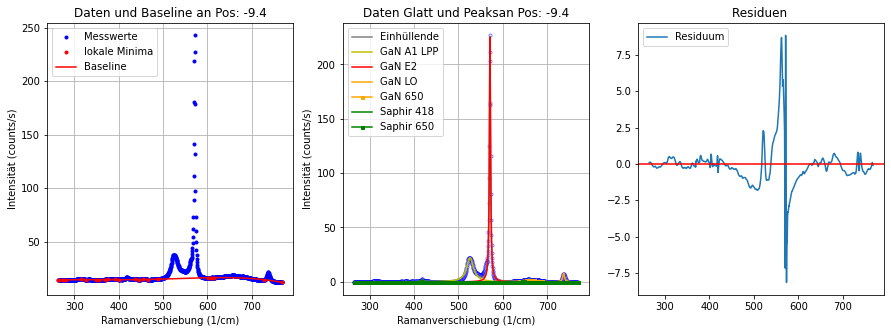

----------------------------------------------------------------------------------------------------
Position: -9.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [12.8106 12.5587 12.5164 ... 14.9801 14.9156 14.8008]
(1024,)
Hintergrund Parameter:  [ 2.38250475e-12 -7.04517001e-09  7.77708662e-06 -4.04256820e-03
  9.99999997e-01 -7.94736765e+01]
Fitparameter Saphir 418: [1.8223405096249417, 7.7162814197323275, 418.60724189021323]
Fitparameter GaN A1 LPP 531: [23.924109267879796, 18.678275208722386, 526.2531842868779]
Fitparameter GaN E2 568: [242.74864242532786, 3.191451615313772, 570.9989736716219]
Fitparameter Saphir 650: [0.8506668476759245, 4.999999999999999, 645.00000000487]
Fitparameter GaN 650: [2.6206665836421776, 31.872582879536814, 665.7395620638212]
Fitparameter GaN LO 741: [8.68764020766927, 5.221930038774043, 736.6113207571564]


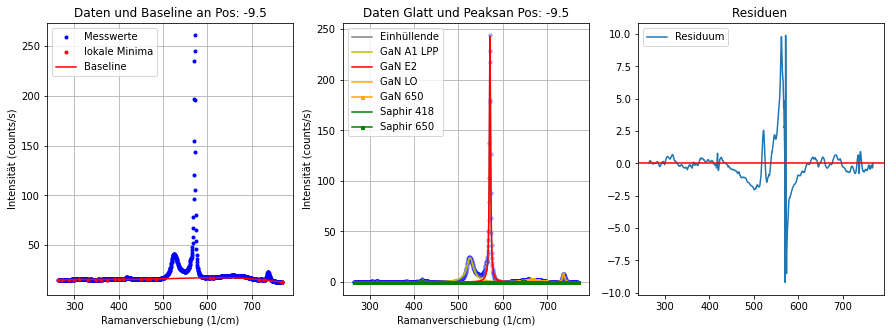

----------------------------------------------------------------------------------------------------
Position: -9.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [13.2044 13.1808 13.1517 ... 15.7118 15.7441 15.8183]
(1024,)
Hintergrund Parameter:  [ 1.01964823e-12 -3.53868456e-09  4.27371222e-06 -2.34563578e-03
  6.01295988e-01 -4.24678636e+01]
Fitparameter Saphir 418: [1.9512063659062524, 5.369021952976441, 418.7117716955034]
Fitparameter GaN A1 LPP 531: [25.732226008047533, 18.62437026481379, 526.2386375043221]
Fitparameter GaN E2 568: [257.599821702933, 3.196224270696814, 570.9901662842826]
Fitparameter Saphir 650: [12.613541323532493, 1.653409863323663e-05, 650.3606964310882]
Fitparameter GaN 650: [2.8885399455839162, 32.31997940613097, 661.3023622820223]
Fitparameter GaN LO 741: [8.415314452972156, 4.924903942815938, 736.706233521605]


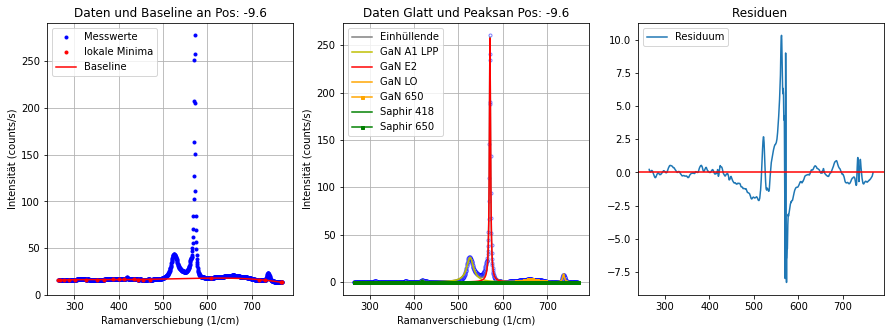

----------------------------------------------------------------------------------------------------
Position: -9.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [13.7287 13.7758 13.7863 ... 16.6735 16.7395 16.8317]
(1024,)
Hintergrund Parameter:  [-1.08188519e-12  1.75840046e-09 -8.20340201e-07 -2.21260530e-05
  9.87019487e-02 -5.87039799e-08]
Fitparameter Saphir 418: [2.202026821156666, 3.5320446577832834, 418.34124564658873]
Fitparameter GaN A1 LPP 531: [28.54631255057658, 19.566291487593613, 526.3752993123361]
Fitparameter GaN E2 568: [279.9839176648845, 3.2197202287856213, 570.9788866797346]
Fitparameter Saphir 650: [0.8538825965035488, 0.0537752871032372, 647.8711349180401]
Fitparameter GaN 650: [3.872495669685237, 46.25327542049775, 659.8509804237056]
Fitparameter GaN LO 741: [9.019159411464656, 4.904723264292288, 736.5854925942841]


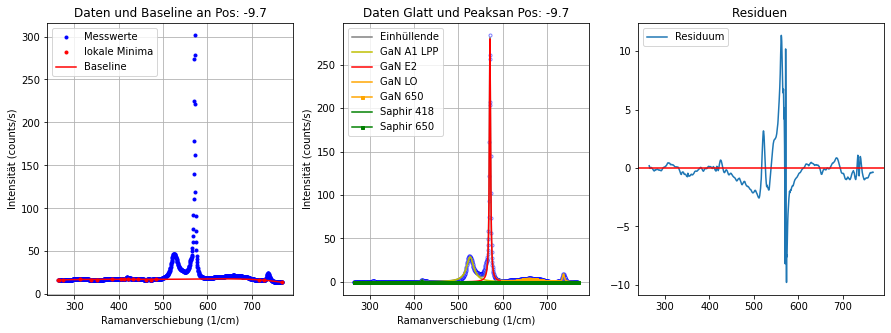

----------------------------------------------------------------------------------------------------
Position: -9.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [14.5326 14.5706 14.6171 ... 18.2729 18.3711 18.5029]
(1024,)
Hintergrund Parameter:  [ 7.87327142e-13 -3.52404873e-09  4.84813074e-06 -2.91083633e-03
  7.99999999e-01 -6.38246514e+01]
Fitparameter Saphir 418: [2.186335307984793, 4.193630870086887, 418.51111016164054]
Fitparameter GaN A1 LPP 531: [31.53506911042362, 18.947667278430483, 526.3234128828614]
Fitparameter GaN E2 568: [305.9109166221284, 3.2419348278923854, 570.9767495682095]
Fitparameter Saphir 650: [0.5133661982614138, 4.999999999988875, 653.5083458554907]
Fitparameter GaN 650: [3.3209307927042384, 35.74230272808117, 663.0035510321118]
Fitparameter GaN LO 741: [9.698538322270952, 4.825688623890036, 736.7473696526041]


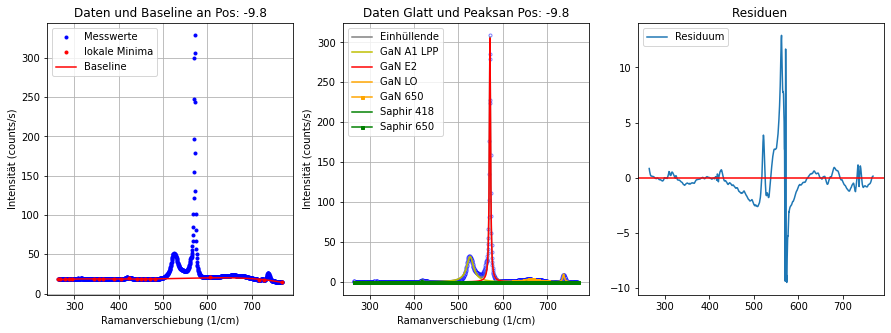

----------------------------------------------------------------------------------------------------
Position: -9.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [15.8342 15.7353 15.6632 ... 19.4506 19.4114 19.2769]
(1024,)
Hintergrund Parameter:  [ 2.34603068e-12 -7.09912849e-09  7.89352579e-06 -4.08881730e-03
  9.99999999e-01 -7.36177925e+01]
Fitparameter Saphir 418: [2.329309889949569, 8.75083721752279, 418.8912958000124]
Fitparameter GaN A1 LPP 531: [35.888483370699326, 18.396299104540695, 526.2081931108318]
Fitparameter GaN E2 568: [339.5503115111649, 3.2560266048068818, 570.9673085429088]
Fitparameter Saphir 650: [1.2473683358519094, 4.999999999999999, 645.0000000000022]
Fitparameter GaN 650: [4.0904118673946455, 34.17414808844338, 664.8838554956287]
Fitparameter GaN LO 741: [10.363687829418895, 4.867862010022912, 736.6625374739049]


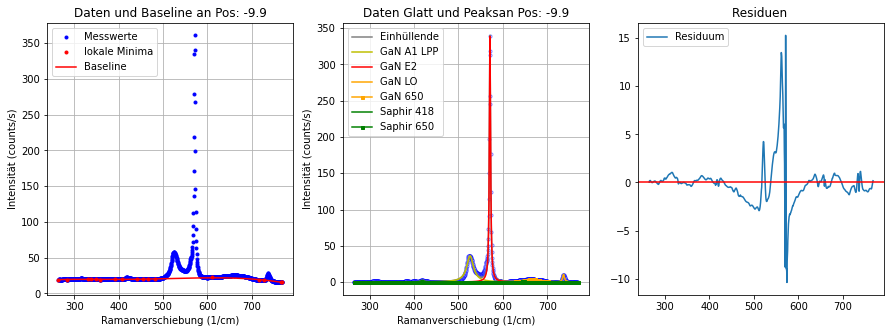

----------------------------------------------------------------------------------------------------
Position: -10.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [16.2911 16.168  16.1094 ... 20.6113 20.6164 20.6859]
(1024,)
Hintergrund Parameter:  [ 4.57942827e-13 -2.97413492e-09  4.54477646e-06 -2.85354916e-03
  8.00097602e-01 -6.18746023e+01]
Fitparameter Saphir 418: [2.341686991221724, 6.570862919167558, 418.6671145588867]
Fitparameter GaN A1 LPP 531: [38.496057685026685, 19.100332612910535, 526.2943197750394]
Fitparameter GaN E2 568: [364.3349961954148, 3.2690165872574166, 570.9625683670656]
Fitparameter Saphir 650: [1.045287421210795, 4.999999999999999, 645.0000000002224]
Fitparameter GaN 650: [4.12161583421792, 33.3008523776793, 663.5753375857067]
Fitparameter GaN LO 741: [10.310410106484158, 4.562724793700282, 736.6400032803887]


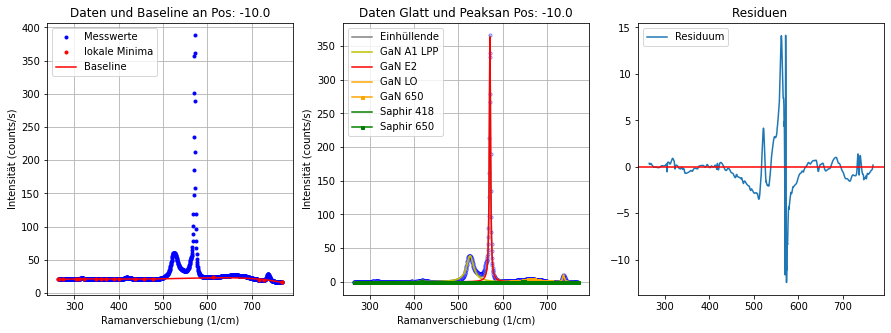

----------------------------------------------------------------------------------------------------
Position: -10.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [16.722  16.7758 16.8197 ... 21.8487 21.8412 21.8559]
(1024,)
Hintergrund Parameter:  [ 2.08939186e-12 -6.68571544e-09  7.67252964e-06 -4.04810731e-03
  9.99999982e-01 -7.16552280e+01]
Fitparameter Saphir 418: [2.3605744389987655, 7.273656845421439, 418.6785203371592]
Fitparameter GaN A1 LPP 531: [41.28599350023893, 18.31765965579675, 526.1947033625335]
Fitparameter GaN E2 568: [386.9997785791928, 3.249800449796127, 570.9721087753854]
Fitparameter Saphir 650: [1.8179184349764177, 0.0157638413777766, 649.8540865988197]
Fitparameter GaN 650: [4.587136885906636, 34.25592523836145, 663.4902140893389]
Fitparameter GaN LO 741: [11.061006437700607, 4.902508675861801, 736.7586900342874]


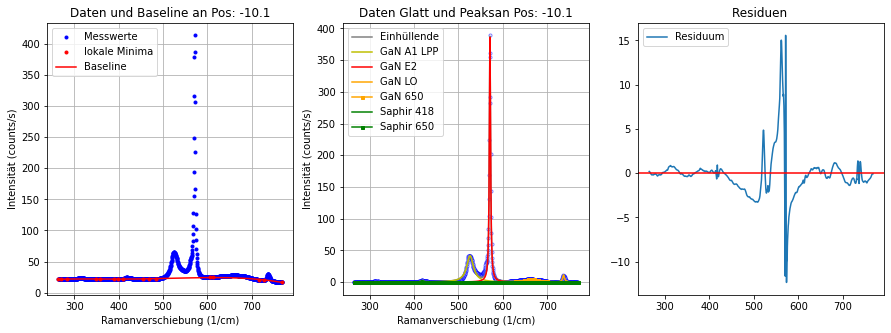

----------------------------------------------------------------------------------------------------
Position: -10.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [17.8144 17.9089 17.974  ... 23.1971 23.1562 23.1125]
(1024,)
Hintergrund Parameter:  [ 1.60215817e-12 -5.76341841e-09  7.07078884e-06 -3.90545197e-03
  9.99999386e-01 -7.28980921e+01]
Fitparameter Saphir 418: [2.350895497935733, 6.618139706264764, 418.766331557706]
Fitparameter GaN A1 LPP 531: [45.05282738199047, 18.211553497174524, 526.1203409501137]
Fitparameter GaN E2 568: [421.1018076789913, 3.2589176745008017, 570.9663492936888]
Fitparameter Saphir 650: [1.5692686762445323, 4.999999999999999, 645.0000000000309]
Fitparameter GaN 650: [4.677229050212167, 31.00947480122814, 665.1888049266339]
Fitparameter GaN LO 741: [11.861567276272716, 4.590666510774735, 736.7002945867317]


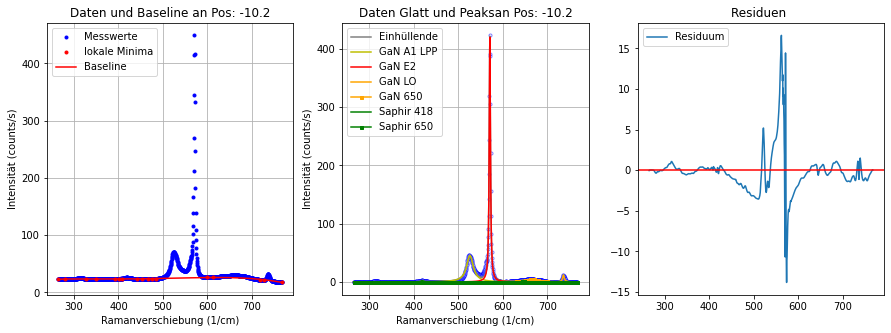

----------------------------------------------------------------------------------------------------
Position: -10.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [19.2081 19.1618 19.0545 ... 25.5191 25.5295 25.4267]
(1024,)
Hintergrund Parameter:  [ 1.75841823e-12 -6.11627841e-09  7.34397677e-06 -3.98225546e-03
  1.00000000e+00 -6.89038854e+01]
Fitparameter Saphir 418: [2.520078916595568, 9.14858622113446, 418.8809514984575]
Fitparameter GaN A1 LPP 531: [49.907575642373494, 18.66079917478601, 526.1782996262963]
Fitparameter GaN E2 568: [463.10706584491106, 3.268522466384397, 570.9580939651083]
Fitparameter Saphir 650: [1.5626495069037125, 4.999999999999999, 645.0000000000642]
Fitparameter GaN 650: [5.579933836907075, 34.11533727718309, 665.4603211627509]
Fitparameter GaN LO 741: [12.573383439339656, 4.677224242718423, 736.6597217289244]


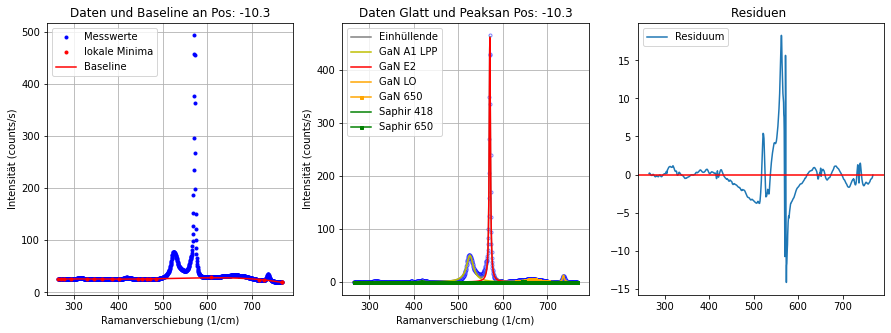

----------------------------------------------------------------------------------------------------
Position: -10.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [20.577  20.5192 20.4566 ... 27.7456 27.6376 27.5258]
(1024,)
Hintergrund Parameter:  [ 1.00512975e-12 -4.33466671e-09  5.64365234e-06 -3.16314285e-03
  8.03743613e-01 -4.84064960e+01]
Fitparameter Saphir 418: [2.594030545246995, 9.461528069680607, 419.30877600440584]
Fitparameter GaN A1 LPP 531: [55.779638576218055, 18.365149648147028, 526.2036782655772]
Fitparameter GaN E2 568: [511.8693544709953, 3.269865092602149, 570.9612188880193]
Fitparameter Saphir 650: [1.9665321195118737, 4.999999999999999, 645.0000000126716]
Fitparameter GaN 650: [5.751474017706779, 30.32947921727257, 664.5036968769128]
Fitparameter GaN LO 741: [13.716746945949652, 4.356043620947431, 736.6637146731624]


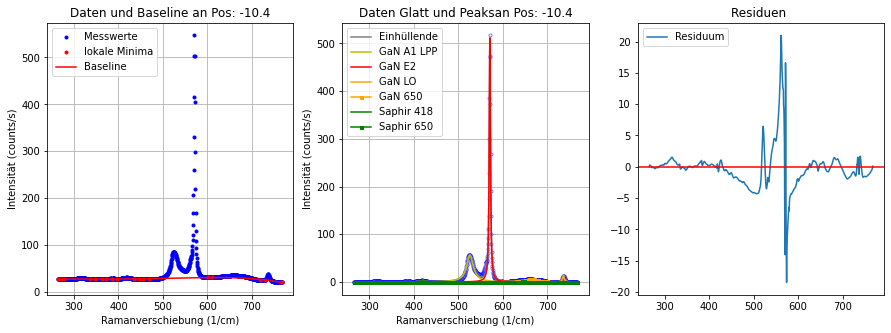

----------------------------------------------------------------------------------------------------
Position: -10.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [21.257  21.3228 21.3726 ... 28.7992 28.7988 28.7983]
(1024,)
Hintergrund Parameter:  [ 1.59061530e-12 -5.84772985e-09  7.19156174e-06 -3.94862029e-03
  9.99997227e-01 -6.62152320e+01]
Fitparameter Saphir 418: [2.7208342307276623, 8.270415527638416, 419.0443042247192]
Fitparameter GaN A1 LPP 531: [59.20667175751621, 18.509734805218812, 526.1557088712309]
Fitparameter GaN E2 568: [542.3860871513772, 3.2592938450827407, 570.966216303363]
Fitparameter Saphir 650: [0.5660269973601724, 4.999999986899274, 654.9999991143692]
Fitparameter GaN 650: [6.540745196821257, 37.09545965771973, 663.5251628525101]
Fitparameter GaN LO 741: [14.623460223180826, 4.538216777857651, 736.6291729521794]


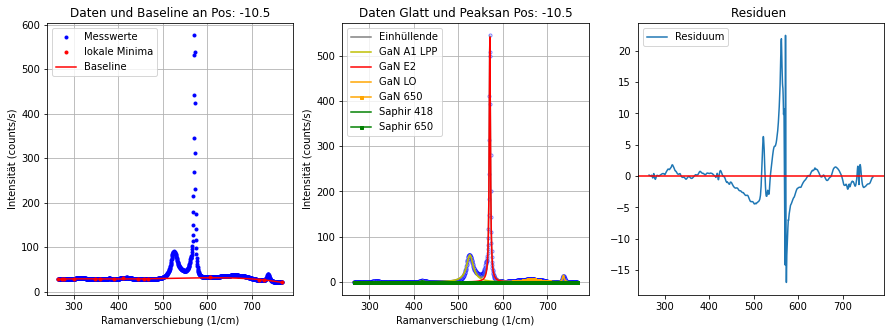

----------------------------------------------------------------------------------------------------
Position: -10.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [23.1668 23.0562 22.9008 ... 31.6238 31.6243 31.5947]
(1024,)
Hintergrund Parameter:  [ 1.04247216e-12 -4.85585135e-09  6.58622480e-06 -3.81884979e-03
  9.99997000e-01 -6.56160785e+01]
Fitparameter Saphir 418: [2.8688050041591753, 8.005854307628162, 418.9041162318986]
Fitparameter GaN A1 LPP 531: [64.77088575151907, 18.680019968325784, 526.1631655452719]
Fitparameter GaN E2 568: [591.1748687593438, 3.2799313613028285, 570.958425268623]
Fitparameter Saphir 650: [3.8009249375169, 0.1097758707915921, 651.3846031633799]
Fitparameter GaN 650: [7.01409080980422, 35.81794985313645, 663.1183569359774]
Fitparameter GaN LO 741: [15.312186420896696, 4.372457423712808, 736.622951585147]


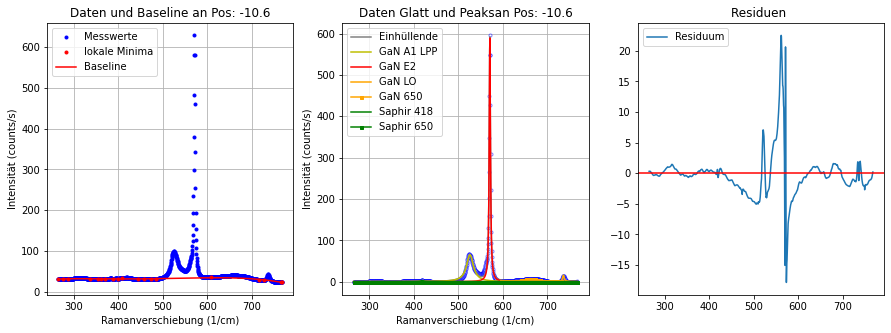

----------------------------------------------------------------------------------------------------
Position: -10.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [23.8989 24.025  24.0746 ... 33.0188 33.0173 33.0545]
(1024,)
Hintergrund Parameter:  [ 4.33906376e-13 -3.31400730e-09  5.04342467e-06 -3.06524114e-03
  8.22871892e-01 -4.80556630e+01]
Fitparameter Saphir 418: [2.966799386749296, 6.8376219801846485, 419.2263475799645]
Fitparameter GaN A1 LPP 531: [68.699421915831, 18.518734806476054, 526.1325730891479]
Fitparameter GaN E2 568: [629.8187351502769, 3.2579222295307484, 570.9756807753845]
Fitparameter Saphir 650: [26.63685154046033, 0.037232544817931035, 652.3585606123333]
Fitparameter GaN 650: [7.3589273815967715, 34.4452729631501, 663.2874572852454]
Fitparameter GaN LO 741: [16.486264121731203, 4.362923027108704, 736.6740003782975]


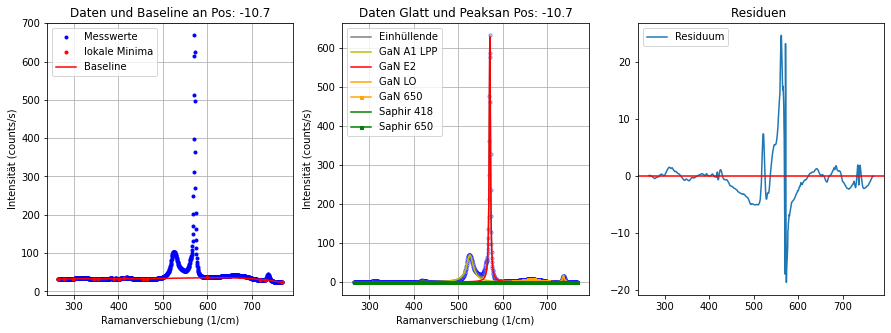

----------------------------------------------------------------------------------------------------
Position: -10.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [24.1528 24.4087 24.6494 ... 34.501  34.3389 34.029 ]
(1024,)
Hintergrund Parameter:  [ 4.59984353e-13 -3.82001504e-09  5.94318757e-06 -3.67022027e-03
  9.99999065e-01 -6.55142408e+01]
Fitparameter Saphir 418: [3.2880516554967136, 8.8842222503734, 419.2216572611686]
Fitparameter GaN A1 LPP 531: [73.85987413865665, 18.629476061671703, 526.153903925253]
Fitparameter GaN E2 568: [674.4971705609794, 3.2600391498622243, 570.9744634948718]
Fitparameter Saphir 650: [2.358478178801105, 4.999999999999999, 645.0000000009454]
Fitparameter GaN 650: [7.618798667137341, 34.91477755917845, 664.836160395619]
Fitparameter GaN LO 741: [17.8807030140476, 4.562035603215399, 736.646960963787]


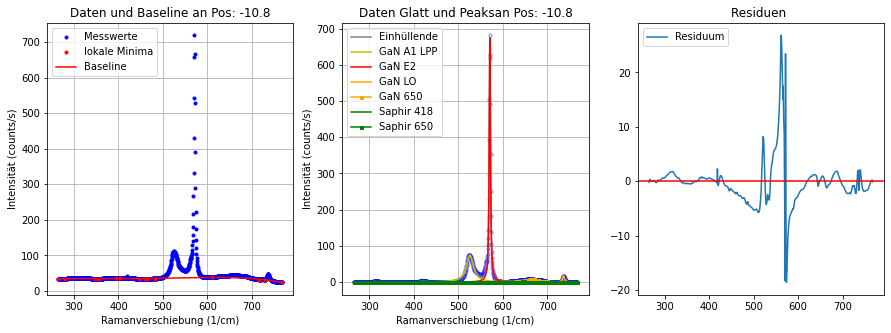

----------------------------------------------------------------------------------------------------
Position: -10.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [26.7636 26.9725 27.093  ... 37.8142 37.7888 37.7721]
(1024,)
Hintergrund Parameter:  [-3.56636363e-13 -1.92437431e-09  4.24511757e-06 -2.93260183e-03
  8.40767969e-01 -4.79162856e+01]
Fitparameter Saphir 418: [3.081554946940902, 7.571031210417547, 419.41431769190905]
Fitparameter GaN A1 LPP 531: [80.66610380804184, 18.73387900252488, 526.1510817484454]
Fitparameter GaN E2 568: [743.9671188550528, 3.253553632647756, 570.9843697871793]
Fitparameter Saphir 650: [2.6397823149016495, 4.999999999999999, 645.0000000000017]
Fitparameter GaN 650: [8.504052159764615, 33.27761151821787, 664.4727859284939]
Fitparameter GaN LO 741: [19.958193646545276, 4.54209965938186, 736.618566846044]


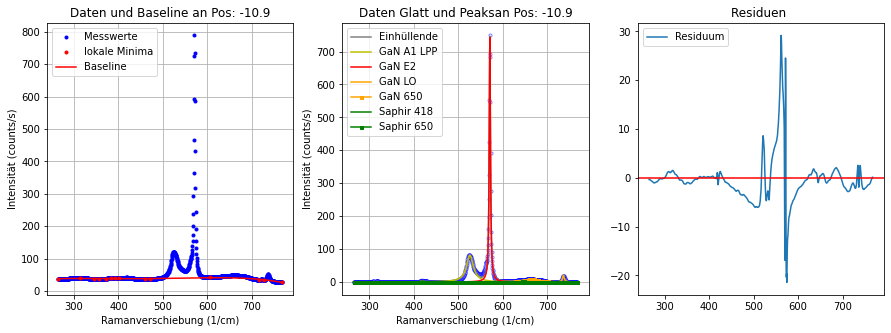

----------------------------------------------------------------------------------------------------
Position: -11.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [27.6408 27.7383 27.8209 ... 39.9164 39.9845 40.0644]
(1024,)
Hintergrund Parameter:  [ 9.55336392e-13 -4.95255998e-09  6.81529019e-06 -3.90903613e-03
  9.99999306e-01 -5.44241072e+01]
Fitparameter Saphir 418: [3.901735439724423, 7.563605906978921, 419.0785071768578]
Fitparameter GaN A1 LPP 531: [85.71861918058627, 18.58841247340781, 526.0825011102193]
Fitparameter GaN E2 568: [796.3074988296005, 3.2421473644325784, 570.9853330049177]
Fitparameter Saphir 650: [2.827223323144888, 4.999999999999999, 645.000000000046]
Fitparameter GaN 650: [8.998769741923255, 33.38783076137835, 664.9432956167558]
Fitparameter GaN LO 741: [21.86099516330638, 4.678737792030885, 736.6263326898163]


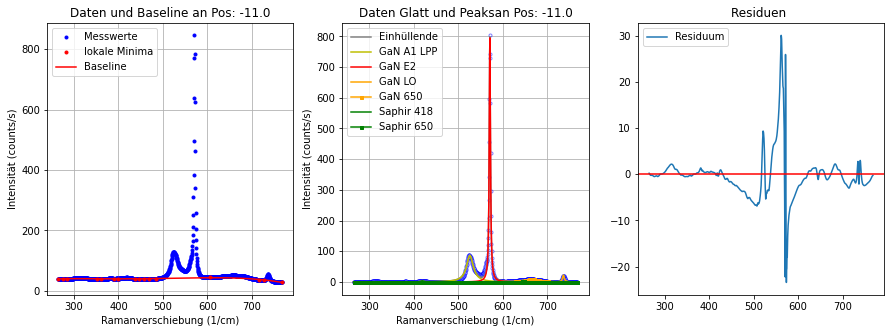

----------------------------------------------------------------------------------------------------
Position: -11.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [29.527  29.5695 29.624  ... 42.5613 42.6696 42.1392]
(1024,)
Hintergrund Parameter:  [ 1.21597641e-12 -5.43036719e-09  7.08209429e-06 -3.95122502e-03
  9.99997566e-01 -5.25034300e+01]
Fitparameter Saphir 418: [3.6138017505584155, 4.657665183808903, 418.8611462361053]
Fitparameter GaN A1 LPP 531: [89.97825276676903, 18.058427897620632, 526.0109016184874]
Fitparameter GaN E2 568: [849.2669134506145, 3.228509594396989, 570.9944748053301]
Fitparameter Saphir 650: [3.4663378951237203, 4.999999999999999, 645.000000000001]
Fitparameter GaN 650: [9.36496967386584, 31.950641107380946, 665.6055080784331]
Fitparameter GaN LO 741: [25.084509559229303, 4.742154892221298, 736.6900935132081]


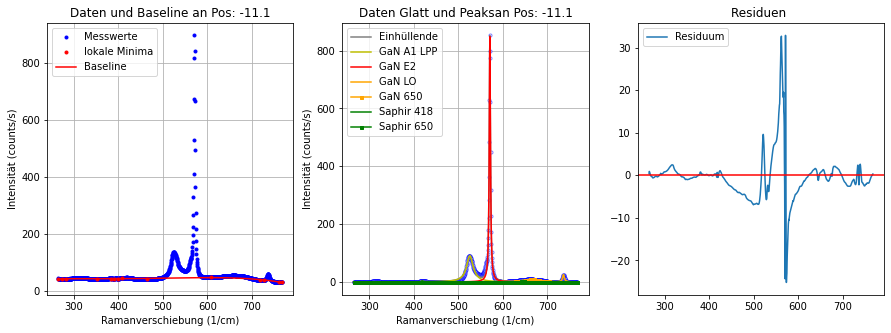

----------------------------------------------------------------------------------------------------
Position: -11.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [30.4002 30.248  30.1503 ... 42.7477 42.767  42.8311]
(1024,)
Hintergrund Parameter:  [ 5.42417957e-13 -4.07630791e-09  6.12816689e-06 -3.67779549e-03
  9.74830184e-01 -5.23530378e+01]
Fitparameter Saphir 418: [3.5828097281970783, 7.658206161148144, 419.5831291077599]
Fitparameter GaN A1 LPP 531: [92.73988526816285, 18.64781756604797, 526.084528511144]
Fitparameter GaN E2 568: [885.3178033343216, 3.219365421159559, 570.9936222562558]
Fitparameter Saphir 650: [2.7154286837654755, 4.999999999999999, 645.0000000078833]
Fitparameter GaN 650: [9.686784128236754, 32.51555579672227, 664.9414817027672]
Fitparameter GaN LO 741: [26.44630336874554, 4.575003127328104, 736.6343304405376]


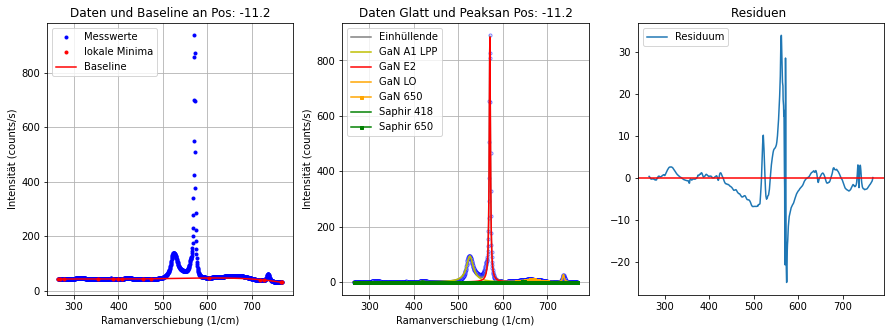

----------------------------------------------------------------------------------------------------
Position: -11.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [31.2318 31.2456 31.2676 ... 44.3046 44.1631 43.9132]
(1024,)
Hintergrund Parameter:  [ 1.58694085e-13 -3.42178448e-09  5.78750255e-06 -3.65385169e-03
  9.99999367e-01 -5.55953550e+01]
Fitparameter Saphir 418: [3.8604102813034187, 6.933842392131091, 418.7856529365528]
Fitparameter GaN A1 LPP 531: [97.15278704629775, 18.724862974960118, 526.032767029938]
Fitparameter GaN E2 568: [940.43322041008, 3.203027981051076, 571.0161911130663]
Fitparameter Saphir 650: [2.5229423453042195, 4.999999999999999, 645.0000000016839]
Fitparameter GaN 650: [9.75228267269846, 30.72199088274925, 664.258489760131]
Fitparameter GaN LO 741: [29.184832914570073, 4.751615874089344, 736.6805490435664]


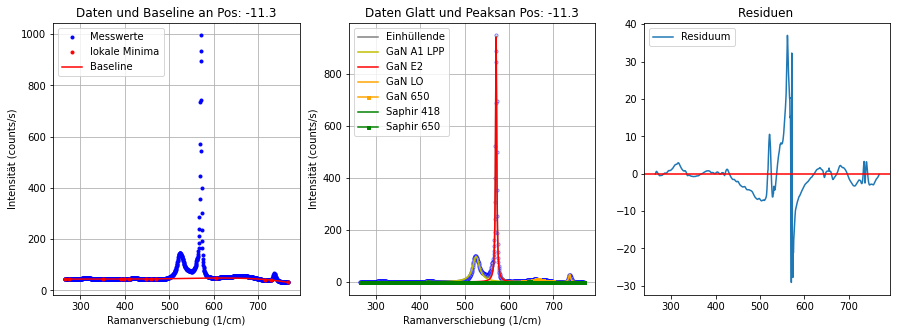

----------------------------------------------------------------------------------------------------
Position: -11.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [32.2518 32.2375 32.2944 ... 46.2878 46.4093 46.7421]
(1024,)
Hintergrund Parameter:  [ 8.17888859e-13 -4.81082312e-09  6.78528342e-06 -3.91075073e-03
  9.99998708e-01 -4.77114489e+01]
Fitparameter Saphir 418: [4.3966351895381965, 6.124258466546339, 418.7408651388378]
Fitparameter GaN A1 LPP 531: [100.5903717947184, 18.727736282919917, 525.9845842545074]
Fitparameter GaN E2 568: [1008.020754228777, 3.1696055286532996, 571.0339780688471]
Fitparameter Saphir 650: [2.155578809262537, 4.999999999999999, 654.237898141373]
Fitparameter GaN 650: [9.862775813402216, 32.11482846272954, 664.6986944345797]
Fitparameter GaN LO 741: [33.82971191566968, 4.939323587742607, 736.6908711192916]


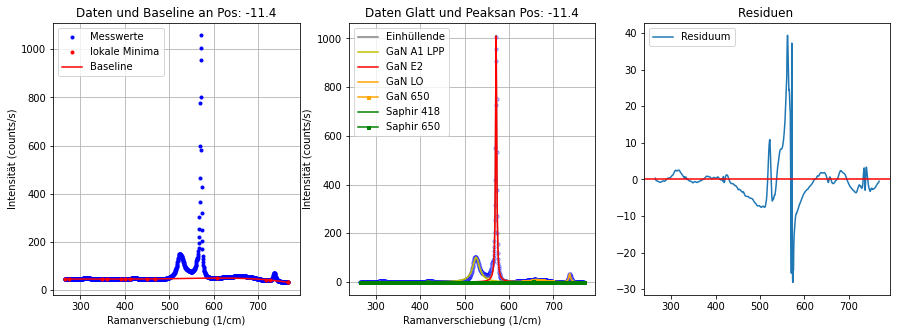

----------------------------------------------------------------------------------------------------
Position: -11.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [33.4025 33.375  33.3632 ... 46.7189 46.7106 47.2534]
(1024,)
Hintergrund Parameter:  [-3.41052320e-14 -3.16288170e-09  5.69997674e-06 -3.65476440e-03
  9.99866391e-01 -5.17997187e+01]
Fitparameter Saphir 418: [4.338484229076256, 8.09151598074753, 419.0334831977892]
Fitparameter GaN A1 LPP 531: [103.29415066544777, 18.96128798034205, 525.9687989391078]
Fitparameter GaN E2 568: [1046.3873933141515, 3.1825437500719973, 571.0552920738518]
Fitparameter Saphir 650: [3.272282914434285, 4.999999999999999, 645.0000000000031]
Fitparameter GaN 650: [10.126294439840951, 28.83076454993984, 663.8064510173722]
Fitparameter GaN LO 741: [37.58355702825858, 4.950073738529414, 736.7179567757966]


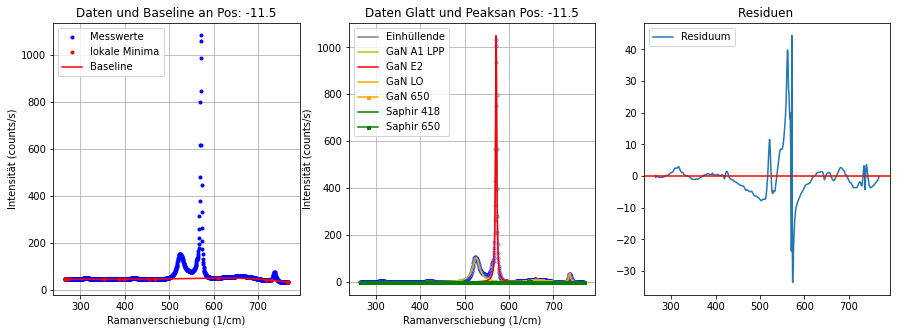

----------------------------------------------------------------------------------------------------
Position: -11.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [33.6456 33.7751 33.8739 ... 48.1167 48.0522 48.0394]
(1024,)
Hintergrund Parameter:  [ 2.04436382e-13 -3.69501782e-09  6.09542310e-06 -3.75872026e-03
  9.99997702e-01 -4.84216542e+01]
Fitparameter Saphir 418: [4.795267733216527, 6.874505338596244, 418.9620379750552]
Fitparameter GaN A1 LPP 531: [104.19934002590193, 18.99773978011861, 525.9470752213488]
Fitparameter GaN E2 568: [1068.2264795493527, 3.235779808230447, 571.0642847035185]
Fitparameter Saphir 650: [2.999564278474615, 4.999999999999999, 645.0001709448383]
Fitparameter GaN 650: [10.313643302978727, 28.437415203991314, 664.0079851084283]
Fitparameter GaN LO 741: [42.642128601129805, 5.376120776918, 736.7342924715106]


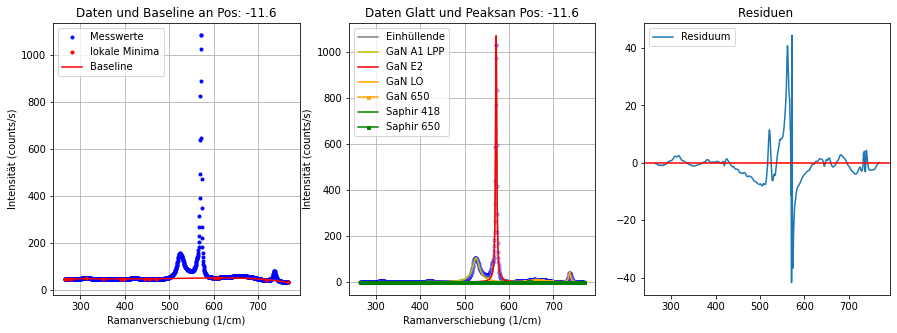

----------------------------------------------------------------------------------------------------
Position: -11.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [34.655  34.5236 34.4239 ... 48.4382 48.5191 48.5038]
(1024,)
Hintergrund Parameter:  [ 2.19757088e-12 -7.43105572e-09  8.44652058e-06 -4.26580049e-03
  9.89432740e-01 -3.79403812e+01]
Fitparameter Saphir 418: [4.620499198814566, 5.48255818395534, 418.78523506830874]
Fitparameter GaN A1 LPP 531: [104.88268718992984, 18.54342798391131, 525.87309180537]
Fitparameter GaN E2 568: [1081.663427664066, 3.2758858319224156, 571.0792140787737]
Fitparameter Saphir 650: [3.2756242285975627, 4.999999999739843, 645.0000000000248]
Fitparameter GaN 650: [11.18160745945198, 31.55565372806972, 664.3425107135787]
Fitparameter GaN LO 741: [47.673691717210026, 5.577438080844204, 736.6847239817158]


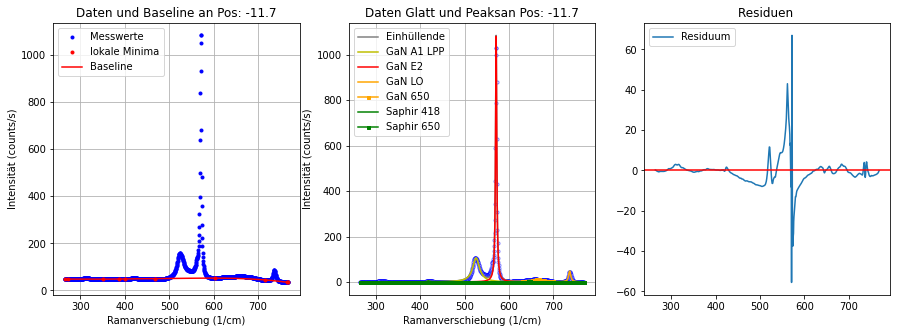

----------------------------------------------------------------------------------------------------
Position: -11.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [34.348  34.3968 34.4744 ... 48.2451 48.3757 48.4103]
(1024,)
Hintergrund Parameter:  [ 1.89273310e-12 -6.94004365e-09  8.22462130e-06 -4.25874011e-03
  9.99998951e-01 -3.91036507e+01]
Fitparameter Saphir 418: [5.018900672480098, 7.661381023497282, 418.87406575256523]
Fitparameter GaN A1 LPP 531: [105.10951092485139, 18.89291255715224, 525.9086361826149]
Fitparameter GaN E2 568: [1097.9415122047392, 3.3331129449279597, 571.0904194598209]
Fitparameter Saphir 650: [3.3070854059927184, 4.999999999999884, 645.0000004536748]
Fitparameter GaN 650: [11.355385168781106, 31.335523915504677, 663.6418702639186]
Fitparameter GaN LO 741: [55.179206012546224, 5.686286375043176, 736.6756520791131]


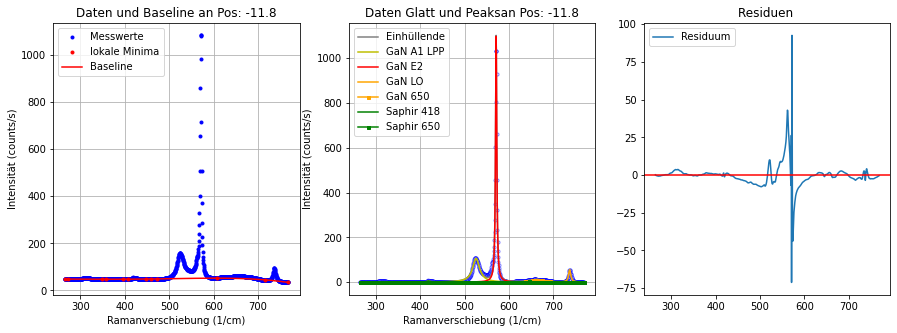

----------------------------------------------------------------------------------------------------
Position: -11.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [34.2633 34.3055 34.3572 ... 47.467  47.4552 47.3775]
(1024,)
Hintergrund Parameter:  [ 3.96456953e-13 -3.85960455e-09  6.05293103e-06 -3.70910688e-03
  9.99997002e-01 -5.15568057e+01]
Fitparameter Saphir 418: [5.383418402758017, 6.847546536506804, 419.16486960967495]
Fitparameter GaN A1 LPP 531: [102.63624167792793, 19.325158896910832, 525.916071641074]
Fitparameter GaN E2 568: [1110.0646919805026, 3.3900542004855647, 571.1323566922164]
Fitparameter Saphir 650: [401.1612196704024, 0.018761298631773417, 648.4864882759869]
Fitparameter GaN 650: [11.287434641146271, 29.10637844927323, 661.4498037625598]
Fitparameter GaN LO 741: [63.70404360487171, 5.859371076840812, 736.7437559494117]
BILD an Pos:  -11.9


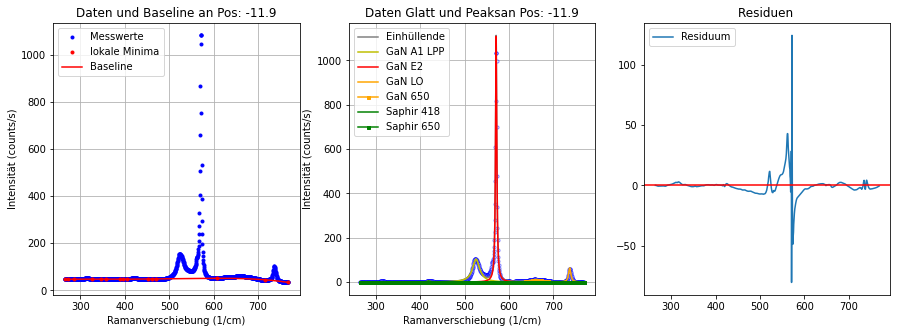

----------------------------------------------------------------------------------------------------
Position: -12.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [34.2466 34.2544 34.3971 ... 46.0598 46.0548 46.9446]
(1024,)
Hintergrund Parameter:  [ 1.20533142e-12 -5.47165599e-09  7.15613049e-06 -3.97962179e-03
  9.99999269e-01 -4.69303136e+01]
Fitparameter Saphir 418: [4.970023989819891, 8.232496431003549, 419.0673381074931]
Fitparameter GaN A1 LPP 531: [100.57465700229075, 19.15947671779242, 525.8258720755308]
Fitparameter GaN E2 568: [1118.2294549512355, 3.420679806791622, 571.1612653784919]
Fitparameter Saphir 650: [20.722836766991083, 0.07591608069797054, 650.9081279941008]
Fitparameter GaN 650: [10.828376261284005, 27.965728202474594, 661.450624081357]
Fitparameter GaN LO 741: [72.07011707226005, 5.918007394211301, 736.7333009873446]


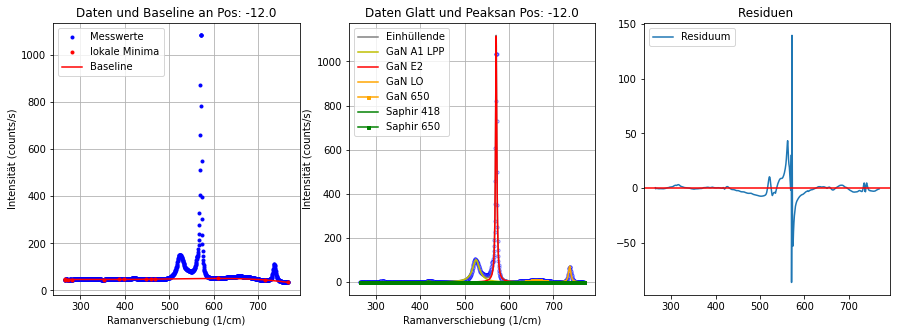

----------------------------------------------------------------------------------------------------
Position: -12.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [34.5511 34.4485 34.3683 ... 45.758  45.637  45.5169]
(1024,)
Hintergrund Parameter:  [ 1.15086107e-12 -5.26874175e-09  6.94547260e-06 -3.90748383e-03
  9.99994513e-01 -5.01058206e+01]
Fitparameter Saphir 418: [5.934572060395961, 5.804649945423287, 418.5595577091177]
Fitparameter GaN A1 LPP 531: [97.64844907572851, 19.206320132897517, 525.8597015256632]
Fitparameter GaN E2 568: [1119.7559924350473, 3.435363124402272, 571.1747779791024]
Fitparameter Saphir 650: [29.742049756481737, 0.055413074398866655, 650.9060582770776]
Fitparameter GaN 650: [11.102395465498962, 26.3878902325577, 660.7074886087916]
Fitparameter GaN LO 741: [77.61727365630894, 6.035940824792306, 736.763411782785]


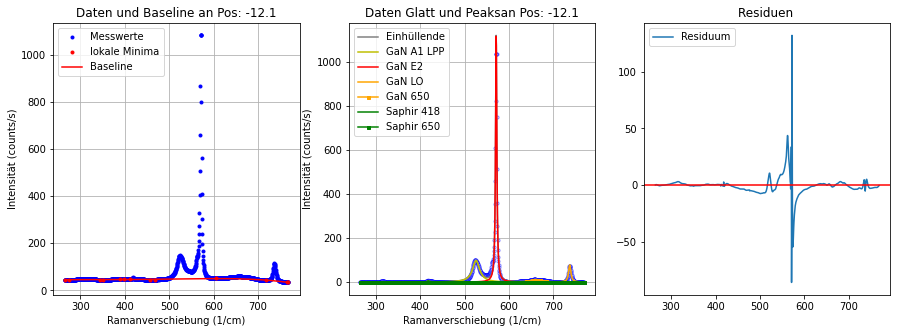

----------------------------------------------------------------------------------------------------
Position: -12.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [34.045  34.1068 34.1719 ... 44.9948 45.0986 45.1801]
(1024,)
Hintergrund Parameter:  [ 1.21789382e-12 -5.39427962e-09  7.02357481e-06 -3.91277870e-03
  9.88866969e-01 -4.83045987e+01]
Fitparameter Saphir 418: [5.793333997199481, 7.389188166212633, 418.8319464696872]
Fitparameter GaN A1 LPP 531: [94.60771372564871, 19.554781655628076, 525.8852920045265]
Fitparameter GaN E2 568: [1121.982744043925, 3.4506517393677214, 571.1938556366065]
Fitparameter Saphir 650: [2.5848660099551486, 4.9999999999994325, 654.8189818247798]
Fitparameter GaN 650: [9.896465151188098, 26.69514957877597, 661.7835442213716]
Fitparameter GaN LO 741: [83.30734775924401, 6.094225540638609, 736.751564541757]


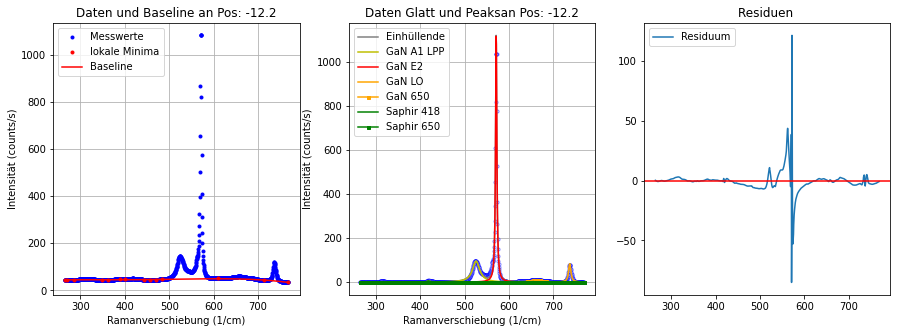

----------------------------------------------------------------------------------------------------
Position: -12.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [33.2538 33.3272 33.3859 ... 43.277  43.4276 43.6053]
(1024,)
Hintergrund Parameter:  [ 1.35589683e-12 -5.76216927e-09  7.34942803e-06 -4.02273030e-03
  9.99507194e-01 -4.90370752e+01]
Fitparameter Saphir 418: [5.795500672274622, 8.062647188514973, 418.98178274507234]
Fitparameter GaN A1 LPP 531: [90.77979146565622, 19.245229065324644, 525.7991423424093]
Fitparameter GaN E2 568: [1124.708019649799, 3.4501592453498855, 571.2251305571865]
Fitparameter Saphir 650: [20.435911340822642, 0.07728600434163245, 653.8121662593826]
Fitparameter GaN 650: [10.119253403358835, 20.70004212783508, 659.5715995656903]
Fitparameter GaN LO 741: [91.01767973994122, 6.1493286872249735, 736.7530521373136]


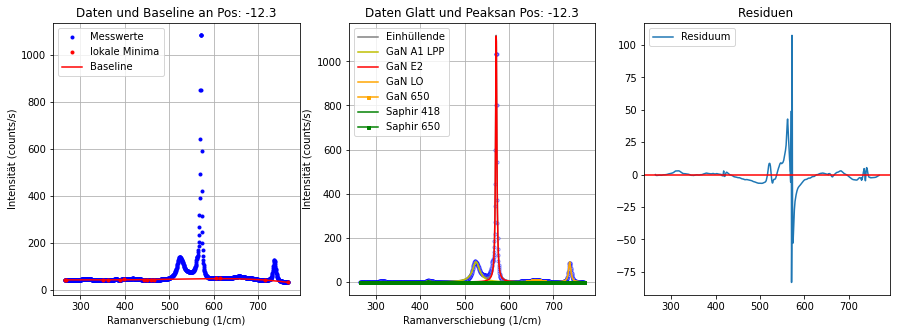

----------------------------------------------------------------------------------------------------
Position: -12.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [32.6236 32.4752 32.3733 ... 41.635  41.6131 41.6498]
(1024,)
Hintergrund Parameter:  [ 1.59082950e-12 -6.01124058e-09  7.37314689e-06 -3.99593714e-03
  9.99993978e-01 -5.25957524e+01]
Fitparameter Saphir 418: [6.438338299976973, 7.246405307477232, 418.94639742471816]
Fitparameter GaN A1 LPP 531: [85.40364613656274, 19.62897620937428, 525.8887685360564]
Fitparameter GaN E2 568: [1128.8778128351732, 3.4495791304118764, 571.2635422661472]
Fitparameter Saphir 650: [1.9634913626621504, 4.999999978294499, 645.0000004007394]
Fitparameter GaN 650: [10.618657583627858, 21.7850585271256, 659.9655294538339]
Fitparameter GaN LO 741: [98.9682403320372, 6.368612496074339, 736.8187278075116]


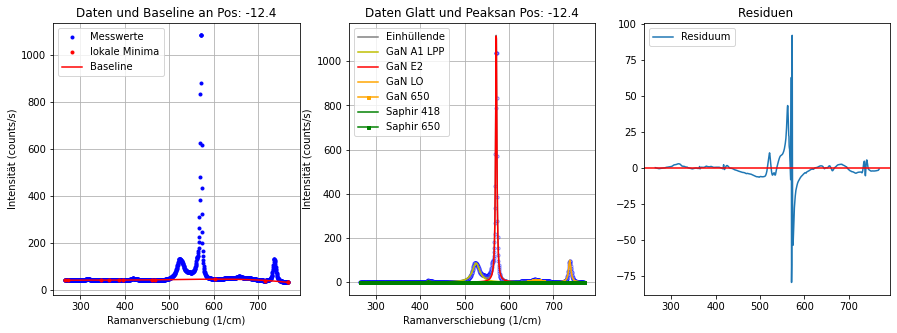

----------------------------------------------------------------------------------------------------
Position: -12.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [32.2978 32.235  32.2042 ... 40.0515 40.0304 40.1504]
(1024,)
Hintergrund Parameter:  [ 2.15442978e-12 -7.04057211e-09  8.01424543e-06 -4.13846971e-03
  9.99999712e-01 -5.16481538e+01]
Fitparameter Saphir 418: [6.126383694457241, 7.276318993246035, 418.48323580658246]
Fitparameter GaN A1 LPP 531: [79.90600691230637, 19.70958099363767, 525.9058049530076]
Fitparameter GaN E2 568: [1132.728333290247, 3.4232825212465774, 571.2944562198875]
Fitparameter Saphir 650: [4.14900676301567, 4.999999999999999, 654.9999999999355]
Fitparameter GaN 650: [9.134963323288353, 22.608522259950274, 661.1740896014304]
Fitparameter GaN LO 741: [105.67447750063094, 6.388297637811519, 736.8171202897341]


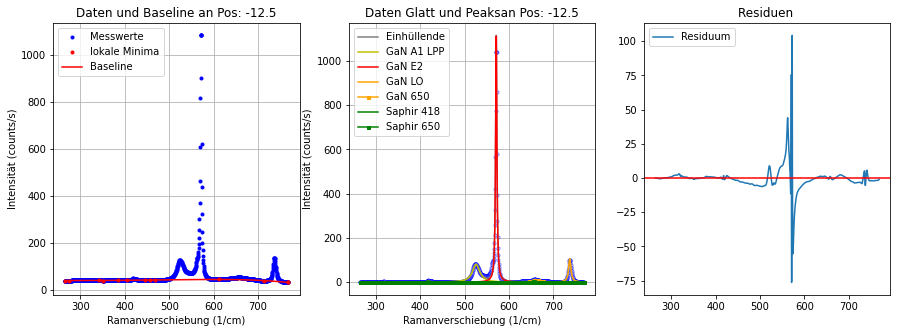

----------------------------------------------------------------------------------------------------
Position: -12.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [31.7014 31.6941 31.7027 ... 38.8385 38.9133 38.9982]
(1024,)
Hintergrund Parameter:  [ 2.78265525e-12 -8.13849944e-09  8.60123913e-06 -4.19373355e-03
  9.68420427e-01 -4.69830367e+01]
Fitparameter Saphir 418: [7.435518171805949, 5.059765773632156, 418.39086737394075]
Fitparameter GaN A1 LPP 531: [75.17931110970879, 19.12039859582847, 525.8488601940174]
Fitparameter GaN E2 568: [1132.858199453848, 3.395621717189985, 571.3277222669188]
Fitparameter Saphir 650: [5.307328552207936, 4.999999999999999, 654.9999999999999]
Fitparameter GaN 650: [8.523360574247732, 21.02952566976098, 661.6115690390205]
Fitparameter GaN LO 741: [110.36780576570023, 6.479676927082053, 736.8597693577217]


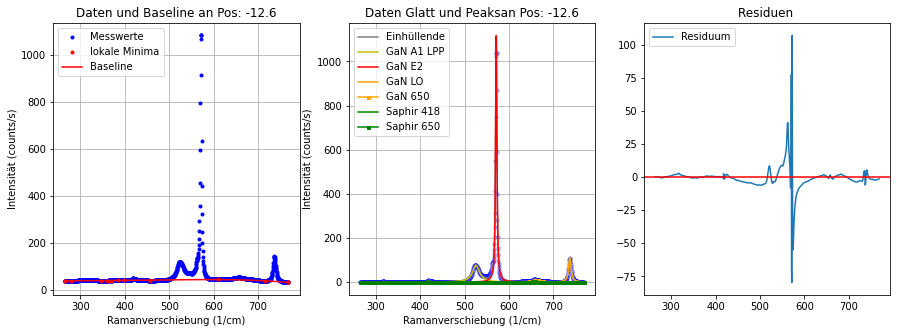

----------------------------------------------------------------------------------------------------
Position: -12.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [31.202  31.1629 31.1355 ... 37.171  37.1892 37.293 ]
(1024,)
Hintergrund Parameter:  [ 1.96011319e-12 -6.53859116e-09  7.59798769e-06 -4.01910042e-03
  9.99930262e-01 -5.71682470e+01]
Fitparameter Saphir 418: [7.047993574743574, 6.1721850643784615, 418.69204466576696]
Fitparameter GaN A1 LPP 531: [70.79008101453752, 20.1213690740239, 525.9737574775738]
Fitparameter GaN E2 568: [1131.480859805318, 3.366576519671011, 571.3585628663425]
Fitparameter Saphir 650: [3.1994330793315986, 4.999999999999238, 654.9999999999999]
Fitparameter GaN 650: [9.601510038897787, 19.07460371350026, 659.6201095230307]
Fitparameter GaN LO 741: [111.76202974616822, 6.533349559332261, 736.8471958393498]


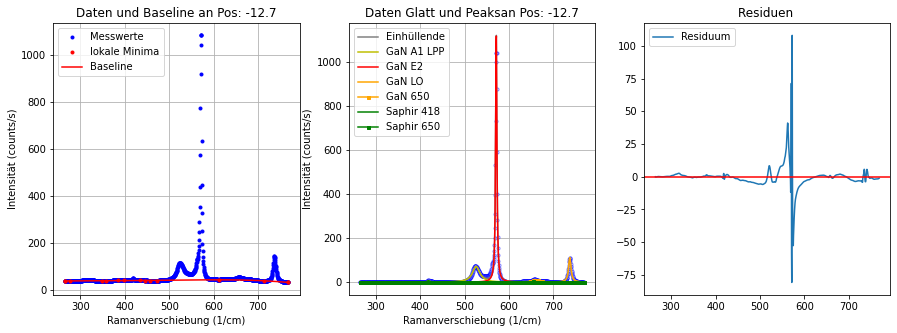

----------------------------------------------------------------------------------------------------
Position: -12.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [30.629  30.7668 30.9234 ... 35.9704 35.9919 35.7856]
(1024,)
Hintergrund Parameter:  [ 1.49989478e-12 -5.26854854e-09  6.26526502e-06 -3.36757109e-03
  8.57272083e-01 -4.78784254e+01]
Fitparameter Saphir 418: [7.7192881168741705, 4.318536673646586, 418.33539397925597]
Fitparameter GaN A1 LPP 531: [65.28798488493547, 19.676300641774834, 525.8925561277343]
Fitparameter GaN E2 568: [1129.4476407705506, 3.3111011143485496, 571.394182888208]
Fitparameter Saphir 650: [4.547150982412765, 0.08886248233948399, 654.8100615218523]
Fitparameter GaN 650: [11.3531066665821, 13.838506261323412, 657.9854895080473]
Fitparameter GaN LO 741: [113.79425335102565, 6.583926637245935, 736.8584835345592]


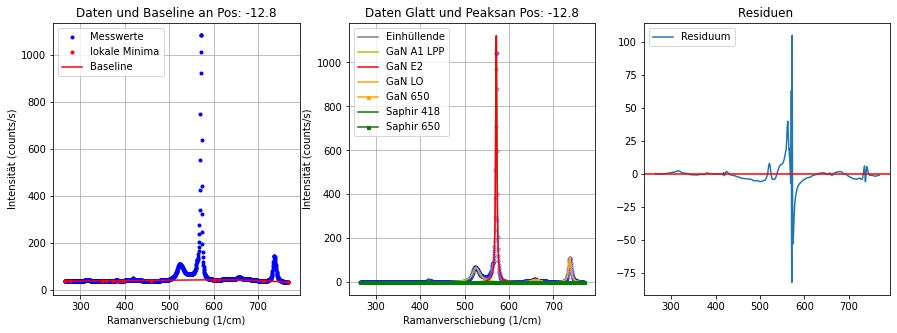

----------------------------------------------------------------------------------------------------
Position: -12.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [30.411  30.2858 30.2399 ... 33.7578 33.6732 33.5618]
(1024,)
Hintergrund Parameter:  [ 1.46963543e-12 -5.07098482e-09  6.03128474e-06 -3.25649524e-03
  8.29207935e-01 -4.66873655e+01]
Fitparameter Saphir 418: [8.729025244999615, 5.068072649787759, 418.47703368802706]
Fitparameter GaN A1 LPP 531: [58.06543580541984, 20.992782646357778, 526.1355438090899]
Fitparameter GaN E2 568: [1125.9213904082267, 3.2074232774133487, 571.4392138662964]
Fitparameter Saphir 650: [1.9638313216300167, 0.14331624882737468, 647.4902743742934]
Fitparameter GaN 650: [12.363852882251612, 13.381833955364833, 657.978247364293]
Fitparameter GaN LO 741: [113.51435830400072, 6.627948734641972, 736.8741636511124]


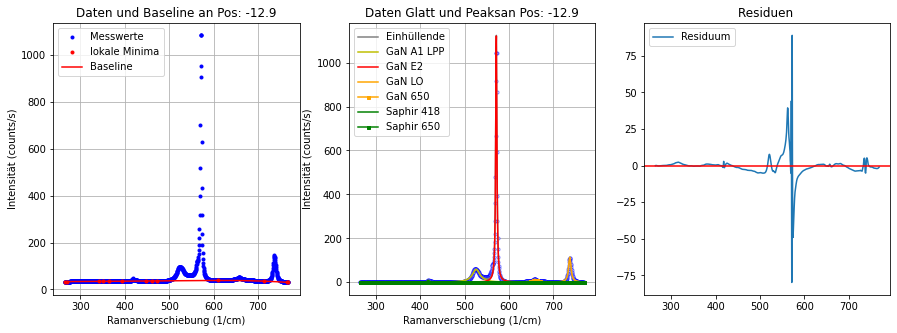

----------------------------------------------------------------------------------------------------
Position: -13.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [29.6705 29.5918 29.5469 ... 32.3125 32.3434 32.4742]
(1024,)
Hintergrund Parameter:  [ 1.66678376e-12 -5.44334104e-09  6.27503100e-06 -3.31963311e-03
  8.34769423e-01 -4.79121806e+01]
Fitparameter Saphir 418: [9.788216609860823, 3.7766513938431796, 418.2725534279342]
Fitparameter GaN A1 LPP 531: [52.98888611568055, 20.73803713563633, 526.1717924803792]
Fitparameter GaN E2 568: [1123.9385103473887, 3.1149414586537336, 571.4677074297972]
Fitparameter Saphir 650: [0.9494645199644922, 4.999999999961081, 645.0000000073849]
Fitparameter GaN 650: [12.499324298111707, 10.881838771198565, 657.5373360928527]
Fitparameter GaN LO 741: [112.22440943381675, 6.651032282689199, 736.8739135171548]


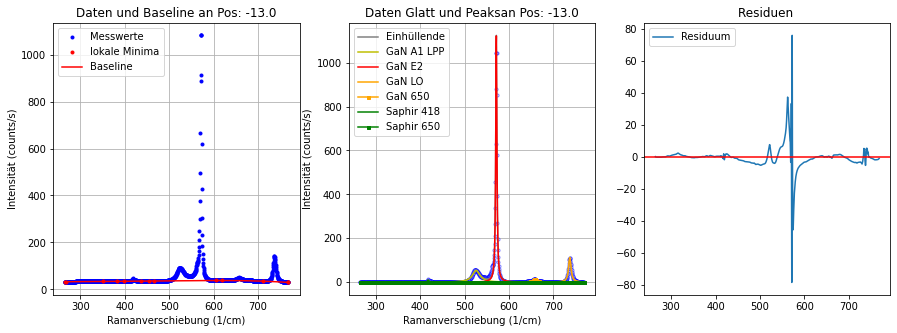

----------------------------------------------------------------------------------------------------
Position: -13.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [28.7453 28.8103 28.8895 ... 31.2251 31.1955 31.1511]
(1024,)
Hintergrund Parameter:  [ 2.71139293e-12 -7.79394650e-09  8.31077695e-06 -4.16354561e-03
  9.99993807e-01 -6.13541185e+01]
Fitparameter Saphir 418: [9.037439410691594, 5.297437611164649, 418.5422949353405]
Fitparameter GaN A1 LPP 531: [49.51885073848729, 21.378737283571688, 526.242265871862]
Fitparameter GaN E2 568: [1120.7697447072665, 3.0335181648712606, 571.4906800967132]
Fitparameter Saphir 650: [0.9516870793956892, 4.999999523682715, 645.0000000000001]
Fitparameter GaN 650: [13.109892539982203, 12.194923714488707, 657.7642512155536]
Fitparameter GaN LO 741: [110.49060842833939, 6.748778309729314, 736.9039919600194]


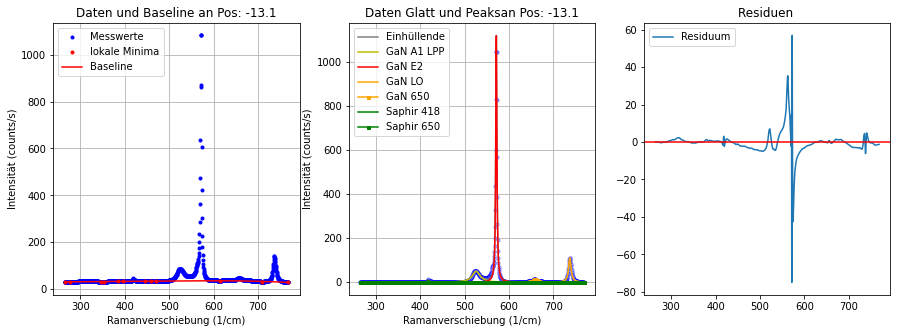

----------------------------------------------------------------------------------------------------
Position: -13.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [28.3217 28.1273 28.0976 ... 29.8244 30.0129 30.2632]
(1024,)
Hintergrund Parameter:  [ 1.84171247e-12 -5.78136869e-09  6.51688677e-06 -3.38418823e-03
  8.32787302e-01 -4.83999427e+01]
Fitparameter Saphir 418: [10.137961440328636, 4.646842283596442, 418.4191857747883]
Fitparameter GaN A1 LPP 531: [45.09057074714145, 21.956616932231583, 526.3772274654673]
Fitparameter GaN E2 568: [1120.881349727719, 2.9233712688677302, 571.5066115113206]
Fitparameter Saphir 650: [0.17712653345679422, 0.01016468910515654, 650.6705503125245]
Fitparameter GaN 650: [12.720142691721245, 10.45815943318739, 657.6430435473503]
Fitparameter GaN LO 741: [107.19776619702286, 6.688198207607355, 736.8971450372823]


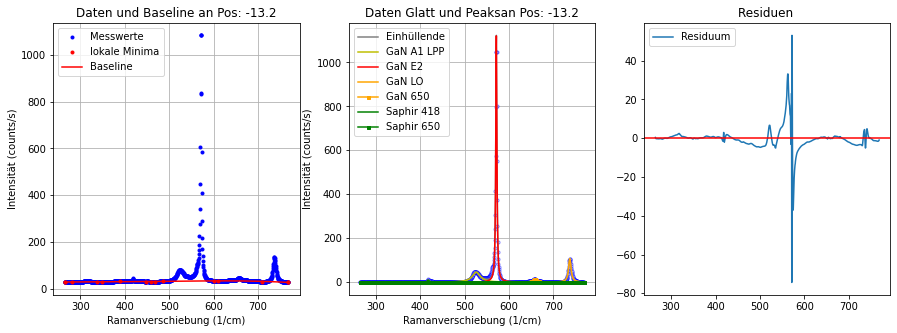

----------------------------------------------------------------------------------------------------
Position: -13.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [27.9732 27.9719 27.9207 ... 28.0679 27.8598 27.6152]
(1024,)
Hintergrund Parameter:  [ 2.15367550e-12 -6.55535020e-09  7.39840668e-06 -3.92824742e-03
  9.99993845e-01 -6.95044239e+01]
Fitparameter Saphir 418: [12.183374881979425, 3.387308440988872, 418.277136246252]
Fitparameter GaN A1 LPP 531: [40.92539894022429, 23.620668355165215, 526.7582828970958]
Fitparameter GaN E2 568: [1106.0607485191292, 2.8210883859071973, 571.538702651539]
Fitparameter Saphir 650: [0.0827212804801514, 1.0086035022794368, 654.9999999999999]
Fitparameter GaN 650: [13.005159707470483, 12.187116539810397, 657.5354473144907]
Fitparameter GaN LO 741: [104.00758043239057, 6.7787239829657, 736.9170387676697]


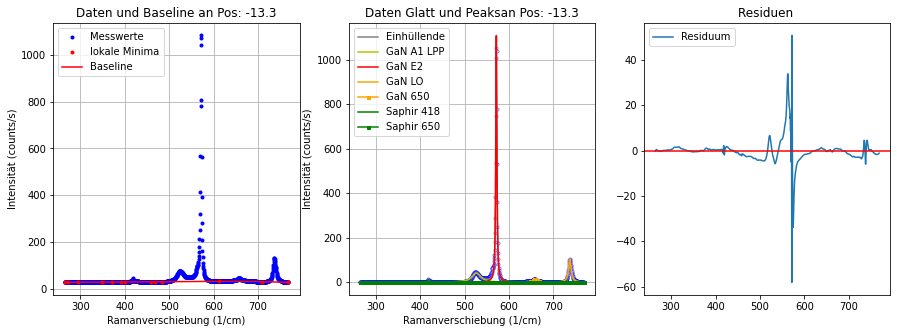

----------------------------------------------------------------------------------------------------
Position: -13.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [26.7939 26.8463 26.8896 ... 27.0923 27.0366 26.842 ]
(1024,)
Hintergrund Parameter:  [ 2.21281151e-12 -6.33049162e-09  6.73965493e-06 -3.37280295e-03
  8.10534654e-01 -4.84011023e+01]
Fitparameter Saphir 418: [12.213697912442939, 3.2468404567105726, 418.25076065095556]
Fitparameter GaN A1 LPP 531: [36.201903258186626, 23.5549084806317, 526.722103340081]
Fitparameter GaN E2 568: [1066.001817468767, 2.7356196625923372, 571.5506518023175]
Fitparameter Saphir 650: [0.7033474939624079, 4.999999994646952, 645.0000000000001]
Fitparameter GaN 650: [13.020049153268697, 10.367149523374463, 657.6297349907704]
Fitparameter GaN LO 741: [98.53857503414974, 6.8398868237389205, 736.9151666525756]


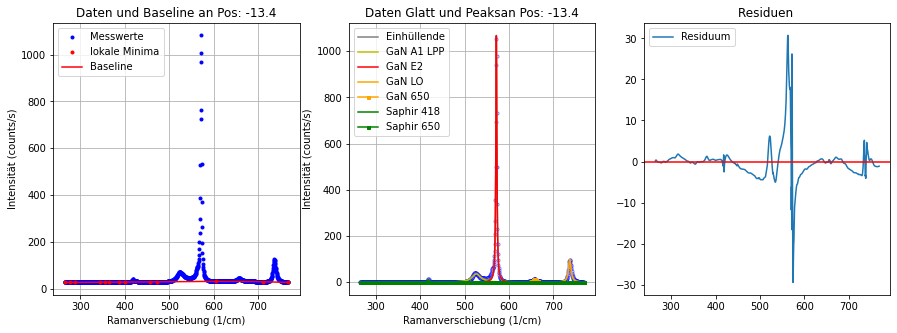

----------------------------------------------------------------------------------------------------
Position: -13.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [25.9907 25.9602 25.9413 ... 25.5685 25.6012 25.6489]
(1024,)
Hintergrund Parameter:  [ 2.74128959e-12 -7.77868301e-09  8.27681102e-06 -4.15520935e-03
  9.99996651e-01 -6.69637373e+01]
Fitparameter Saphir 418: [13.280982851064287, 3.0663222576530043, 418.2889113462339]
Fitparameter GaN A1 LPP 531: [33.85739771647369, 23.977027931744097, 526.8175572290223]
Fitparameter GaN E2 568: [1030.06949880795, 2.6972819886412505, 571.5559996811975]
Fitparameter Saphir 650: [0.8810935229257697, 4.9999989681510035, 654.9759315689969]
Fitparameter GaN 650: [12.338397125469887, 10.209758679139432, 657.5105770454005]
Fitparameter GaN LO 741: [94.20087770486651, 6.859537744139646, 736.9240010714514]


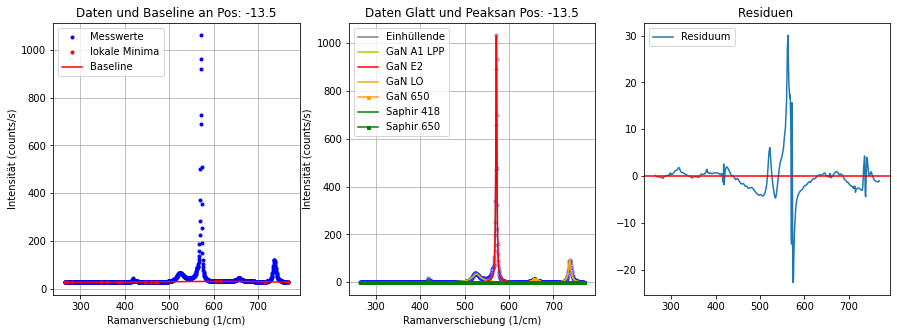

----------------------------------------------------------------------------------------------------
Position: -13.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [25.0811 25.0738 25.0916 ... 24.3619 24.3477 24.7201]
(1024,)
Hintergrund Parameter:  [ 1.81972324e-12 -5.50294619e-09  6.20228295e-06 -3.29751429e-03
  8.41441522e-01 -5.76340114e+01]
Fitparameter Saphir 418: [14.370514910109994, 2.742059530985057, 418.3250680549269]
Fitparameter GaN A1 LPP 531: [31.118881994600265, 26.035787898949877, 527.3711711126076]
Fitparameter GaN E2 568: [990.474558226629, 2.6840959563315256, 571.5601451067166]
Fitparameter Saphir 650: [0.7429412546552707, 4.999999911134191, 645.0000000000001]
Fitparameter GaN 650: [13.039038655469573, 10.916630302986547, 657.5109347106014]
Fitparameter GaN LO 741: [90.4987210361269, 6.934946087153712, 736.9050652022969]


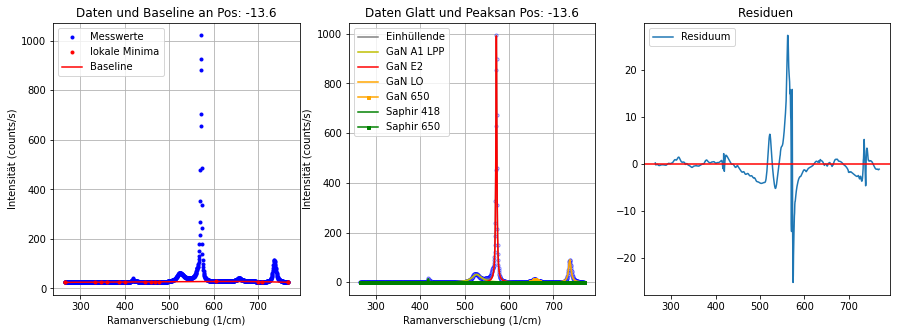

----------------------------------------------------------------------------------------------------
Position: -13.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [24.1494 24.3162 24.4375 ... 23.3129 23.3124 23.3169]
(1024,)
Hintergrund Parameter:  [ 2.98401209e-12 -8.22647203e-09  8.55558594e-06 -4.21599837e-03
  9.99999500e-01 -6.82671043e+01]
Fitparameter Saphir 418: [14.646360747414171, 2.8039877974879808, 418.32159342570935]
Fitparameter GaN A1 LPP 531: [28.85254898194285, 23.024217075284653, 526.7632319225078]
Fitparameter GaN E2 568: [919.3433989540846, 2.6955617444293507, 571.5596830348064]
Fitparameter Saphir 650: [2.123056809819518, 4.9990455986415565, 654.9999999999368]
Fitparameter GaN 650: [10.527366567696184, 10.000000000000002, 658.0683028268554]
Fitparameter GaN LO 741: [84.85917339585617, 6.878488058084958, 736.9216327925758]


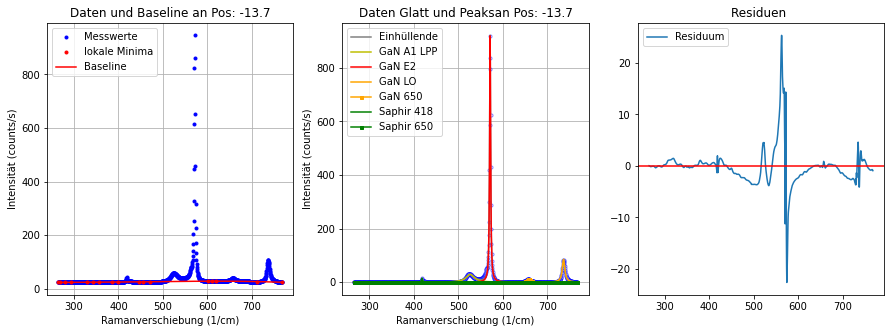

----------------------------------------------------------------------------------------------------
Position: -13.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [19.4381 19.6426 19.8087 ... 18.8206 18.8962 18.9761]
(1024,)
Hintergrund Parameter:  [ 1.65277356e-12 -5.55283275e-09  6.72917803e-06 -3.77164855e-03
  9.98999547e-01 -8.17162715e+01]
Fitparameter Saphir 418: [16.109833984155433, 2.401869381199989, 418.28464274525487]
Fitparameter GaN A1 LPP 531: [25.812054218873815, 25.324660683921, 527.2164053222631]
Fitparameter GaN E2 568: [844.2026860648028, 2.690451143666864, 571.566345314727]
Fitparameter Saphir 650: [3.5689761710759154, 4.999999888257867, 654.9999999999387]
Fitparameter GaN 650: [8.967156492022053, 10.000000000000002, 658.1659129647185]
Fitparameter GaN LO 741: [77.3316852285249, 6.979497964403214, 736.9133141469714]


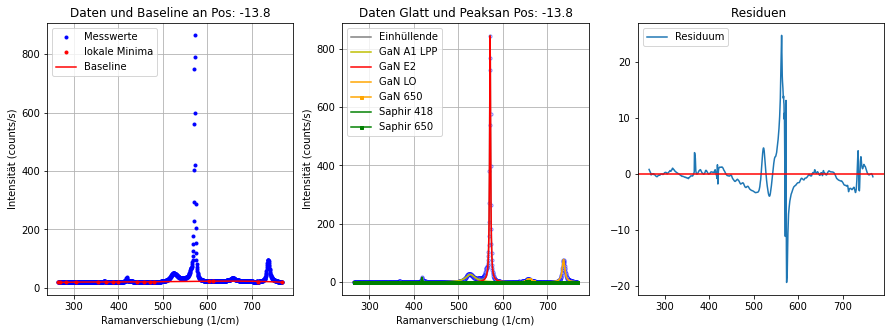

----------------------------------------------------------------------------------------------------
Position: -13.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [22.2892 22.3356 22.269  ... 20.2633 20.3301 20.3869]
(1024,)
Hintergrund Parameter:  [ 3.28291603e-12 -8.61830002e-09  8.66120484e-06 -4.16983849e-03
  9.73019071e-01 -6.79622343e+01]
Fitparameter Saphir 418: [17.608480262544845, 2.3329021124854594, 418.3164652067238]
Fitparameter GaN A1 LPP 531: [22.470550316219768, 24.382800951000178, 527.1263883354244]
Fitparameter GaN E2 568: [756.8771421743941, 2.6804703708103994, 571.5611160916594]
Fitparameter Saphir 650: [0.4285868729884564, 0.024585910490518538, 654.975114508895]
Fitparameter GaN 650: [11.385850800242832, 10.000000000000002, 657.4086377918337]
Fitparameter GaN LO 741: [69.43702598103224, 6.958784536603553, 736.9256415102608]


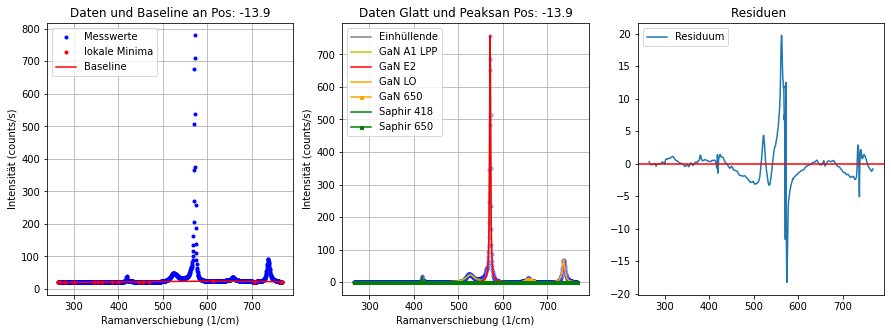

----------------------------------------------------------------------------------------------------
Position: -14.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [21.1075 21.125  21.1125 ... 19.1647 19.1167 19.035 ]
(1024,)
Hintergrund Parameter:  [ 2.03645579e-12 -5.75430093e-09  6.21013771e-06 -3.20854351e-03
  8.03081961e-01 -5.86730443e+01]
Fitparameter Saphir 418: [17.265111673862677, 2.3654060541533637, 418.33584046200565]
Fitparameter GaN A1 LPP 531: [20.272457406111222, 25.85452710089302, 527.4467875801258]
Fitparameter GaN E2 568: [686.0169806271771, 2.6835639273124605, 571.5589960327698]
Fitparameter Saphir 650: [0.3589532977854362, 4.9999999974386276, 645.0000000000001]
Fitparameter GaN 650: [10.642499073048098, 10.000000000000002, 657.4031617646862]
Fitparameter GaN LO 741: [62.82967627139856, 6.917646129906339, 736.9153903743718]


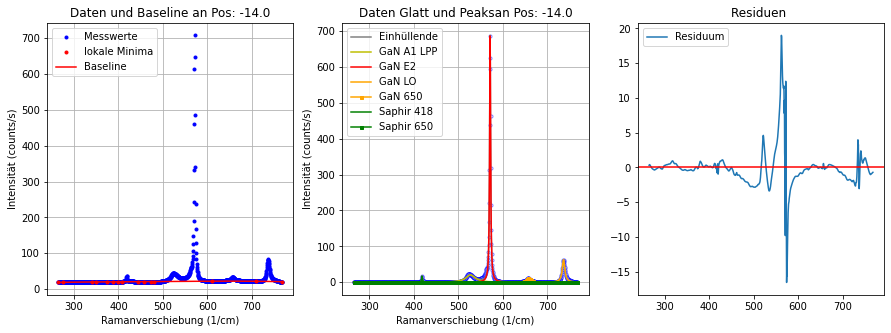

----------------------------------------------------------------------------------------------------
Position: -14.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [20.061  20.118  20.1412 ... 18.1309 18.1972 18.2244]
(1024,)
Hintergrund Parameter:  [ 3.33879059e-12 -8.80848869e-09  8.88151836e-06 -4.28386836e-03
  9.99998851e-01 -7.22279986e+01]
Fitparameter Saphir 418: [17.746892689310613, 2.322705506476559, 418.347124178862]
Fitparameter GaN A1 LPP 531: [18.769626906866304, 22.954276351304564, 527.0574304025644]
Fitparameter GaN E2 568: [640.122967550565, 2.675875081696625, 571.5491931359892]
Fitparameter Saphir 650: [0.0003793911363409036, 3.574481424597226e-07, 654.9685903348299]
Fitparameter GaN 650: [9.540656963122819, 10.000000257922869, 657.3202546419609]
Fitparameter GaN LO 741: [58.19818569395609, 7.165721801362867, 736.9239768710734]


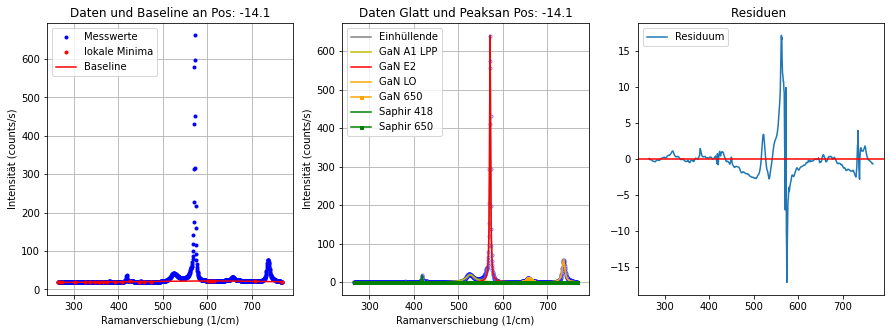

----------------------------------------------------------------------------------------------------
Position: -14.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [19.1565 19.3611 19.4669 ... 17.3334 17.3634 17.4101]
(1024,)
Hintergrund Parameter:  [ 2.99966203e-12 -8.16430605e-09  8.47523791e-06 -4.19593865e-03
  9.99998616e-01 -7.44615777e+01]
Fitparameter Saphir 418: [19.043493953226562, 2.2722644187713947, 418.32725610609793]
Fitparameter GaN A1 LPP 531: [17.738955741150303, 24.11995885216492, 527.1401718069147]
Fitparameter GaN E2 568: [602.1957666051125, 2.6634132082257125, 571.5428923690894]
Fitparameter Saphir 650: [1.9846060462056134, 0.04491350500300742, 645.002017728132]
Fitparameter GaN 650: [8.939922870699418, 10.000000000000002, 657.3333240795389]
Fitparameter GaN LO 741: [53.92963537502782, 7.1648991025019395, 736.9236836038334]


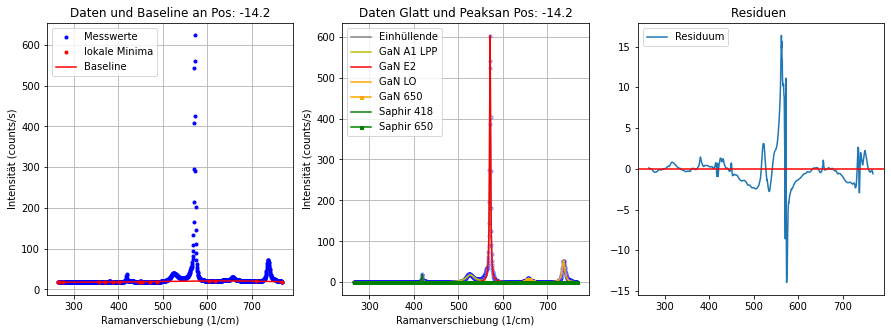

----------------------------------------------------------------------------------------------------
Position: -14.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [18.3195 18.3288 18.3451 ... 16.4158 16.378  16.1956]
(1024,)
Hintergrund Parameter:  [ 1.29991255e-12 -4.31069358e-09  5.23558966e-06 -2.96673884e-03
  8.00049675e-01 -6.58817188e+01]
Fitparameter Saphir 418: [19.92312798563293, 2.1536777731632513, 418.339854465393]
Fitparameter GaN A1 LPP 531: [16.15674489852487, 25.87942061464672, 527.5443659921797]
Fitparameter GaN E2 568: [549.9366592633853, 2.672379680806641, 571.5387232942435]
Fitparameter Saphir 650: [1.9489137481833632, 4.730270291381502, 654.9999999789435]
Fitparameter GaN 650: [6.972207154711882, 10.000000000000002, 657.830869499697]
Fitparameter GaN LO 741: [49.165698021450915, 6.974768263094897, 736.9145312596094]


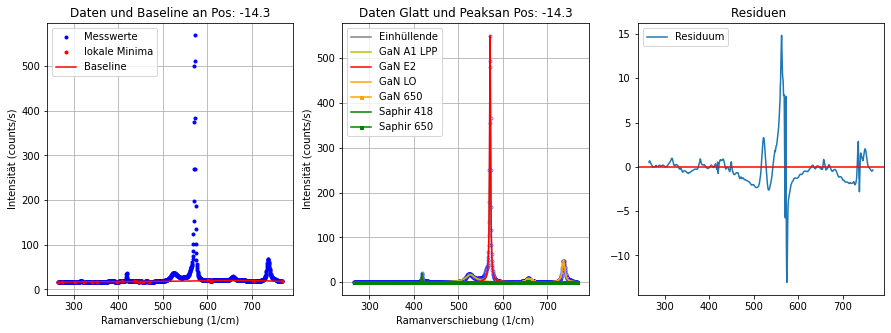

----------------------------------------------------------------------------------------------------
Position: -14.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [17.2291 17.2861 17.3451 ... 15.1584 15.1178 15.0934]
(1024,)
Hintergrund Parameter:  [ 3.09645376e-12 -8.27286413e-09  8.48967066e-06 -4.18406973e-03
  9.98995502e-01 -7.71636442e+01]
Fitparameter Saphir 418: [20.329796559859165, 2.168740462353046, 418.36569873412935]
Fitparameter GaN A1 LPP 531: [15.015411853713047, 23.293915816538565, 527.0761129999951]
Fitparameter GaN E2 568: [494.40138646301233, 2.682332819948805, 571.5305746744829]
Fitparameter Saphir 650: [0.20329664843036982, 0.36624251069615615, 646.0621387101055]
Fitparameter GaN 650: [7.891532607505434, 10.000000000002292, 657.2861757826462]
Fitparameter GaN LO 741: [44.08936661122877, 7.194991163752131, 736.9114585808936]


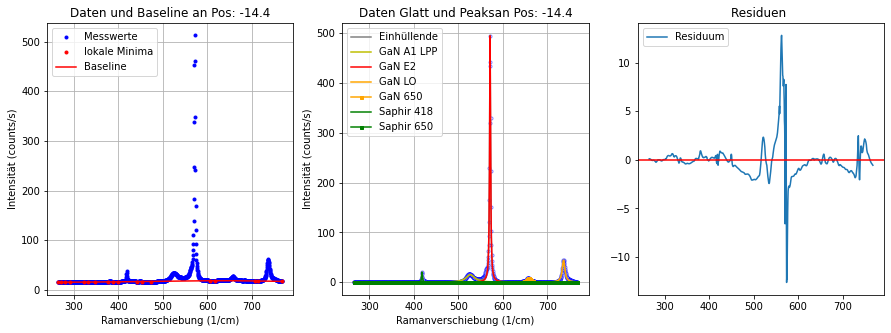

----------------------------------------------------------------------------------------------------
Position: -14.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [16.1262 16.1196 16.1343 ... 14.2347 14.2855 14.3151]
(1024,)
Hintergrund Parameter:  [ 1.20902395e-12 -3.41648699e-09  3.66830588e-06 -1.87998589e-03
  4.68565684e-01 -3.10635823e+01]
Fitparameter Saphir 418: [20.876263074450506, 2.082065551034173, 418.3425717113242]
Fitparameter GaN A1 LPP 531: [13.59946552968624, 25.16448310063589, 527.5296657595112]
Fitparameter GaN E2 568: [452.216362718783, 2.676233789915203, 571.5239177308703]
Fitparameter Saphir 650: [7.9397025530293, 0.05702858138453298, 646.5251199194827]
Fitparameter GaN 650: [7.399111506724862, 10.449568656295261, 657.2762453889746]
Fitparameter GaN LO 741: [39.71877222952411, 7.212262694900702, 736.9054876423729]


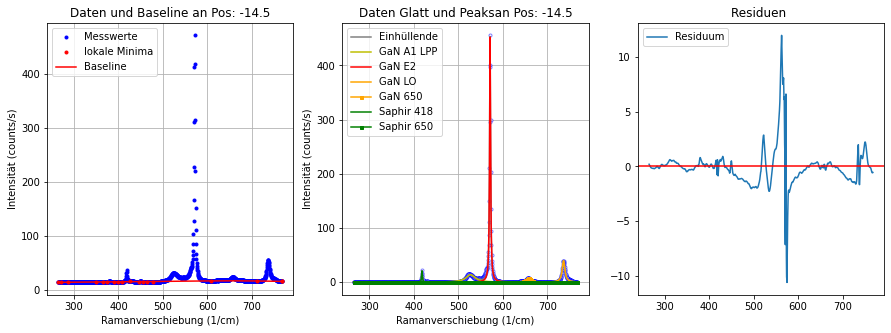

----------------------------------------------------------------------------------------------------
Position: -14.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [15.5277 15.6046 15.6257 ... 13.4249 13.4783 13.5995]
(1024,)
Hintergrund Parameter:  [ 3.22831639e-12 -8.54120189e-09  8.68821139e-06 -4.24151367e-03
  1.00000000e+00 -7.75370500e+01]
Fitparameter Saphir 418: [21.915064506105093, 2.1141554627081223, 418.3523106076385]
Fitparameter GaN A1 LPP 531: [12.96053157971393, 25.4183141816274, 527.4889766359644]
Fitparameter GaN E2 568: [418.57513532626484, 2.6725837859577073, 571.5131632793519]
Fitparameter Saphir 650: [2.9894144837242353, 0.06874766957430754, 647.4851804519066]
Fitparameter GaN 650: [7.014937715139767, 10.000000000000002, 657.2115271792196]
Fitparameter GaN LO 741: [36.73084516929853, 7.304745725065896, 736.9104230430903]


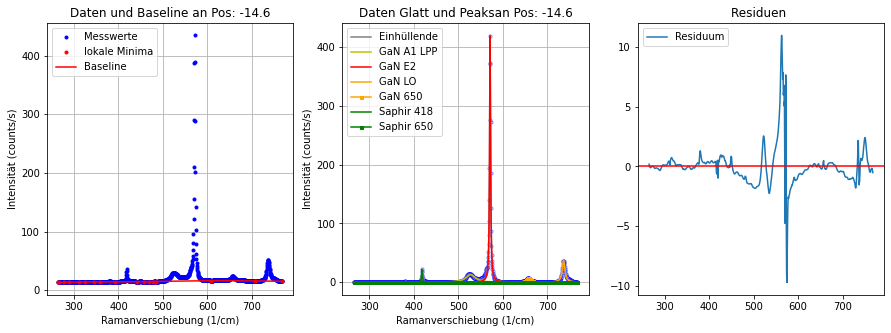

----------------------------------------------------------------------------------------------------
Position: -14.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [14.6884 14.6922 14.7    ... 12.828  12.9643 13.0545]
(1024,)
Hintergrund Parameter:  [ 1.38682296e-12 -3.65215668e-09  3.66698480e-06 -1.75982965e-03
  4.12138020e-01 -2.49472372e+01]
Fitparameter Saphir 418: [21.906785596059276, 2.0216811367614107, 418.38984358786627]
Fitparameter GaN A1 LPP 531: [12.198041281862395, 23.601464799350893, 527.2077418799339]
Fitparameter GaN E2 568: [393.38975150561475, 2.6728191718403593, 571.5099736262456]
Fitparameter Saphir 650: [1.476130906403319, 0.12550862935902737, 654.7439236531225]
Fitparameter GaN 650: [6.642473278781856, 10.00000000017417, 657.3490652831678]
Fitparameter GaN LO 741: [34.02332095807852, 7.302822918016566, 736.9106281430466]


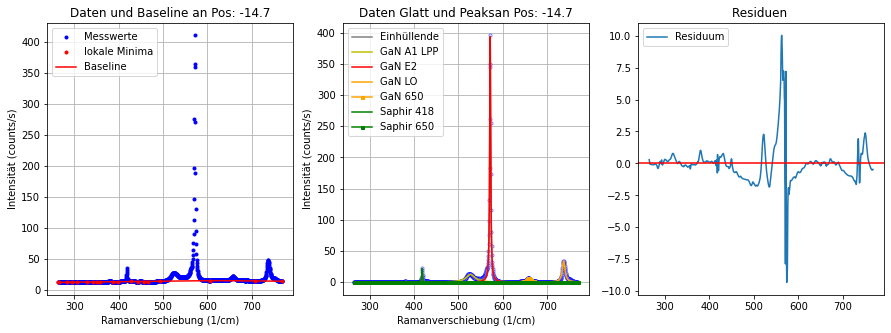

----------------------------------------------------------------------------------------------------
Position: -14.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [13.5496 13.7088 13.8245 ... 11.9921 11.9376 11.8637]
(1024,)
Hintergrund Parameter:  [ 2.31622406e-12 -6.27315550e-09  6.53552943e-06 -3.27901318e-03
  8.00000234e-01 -6.38320523e+01]
Fitparameter Saphir 418: [22.314861203402653, 2.011929708171421, 418.37547244192706]
Fitparameter GaN A1 LPP 531: [11.220274959041006, 22.958440687552972, 526.995694885271]
Fitparameter GaN E2 568: [354.23970817610865, 2.675463714799928, 571.4993052860837]
Fitparameter Saphir 650: [0.09016160369960037, 1.341516804492748, 645.0000001250286]
Fitparameter GaN 650: [5.90280232243545, 10.000000000000002, 657.5660346123632]
Fitparameter GaN LO 741: [30.661006547241524, 7.4432030336415504, 736.9214208571966]


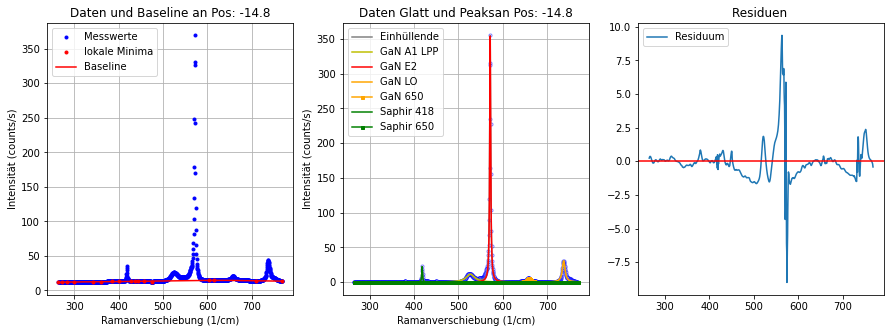

----------------------------------------------------------------------------------------------------
Position: -14.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [12.573  12.6723 12.7089 ... 11.0352 10.9968 10.9445]
(1024,)
Hintergrund Parameter:  [ 1.62146042e-12 -4.47102957e-09  4.74393125e-06 -2.42200749e-03
  6.00034530e-01 -4.64742822e+01]
Fitparameter Saphir 418: [23.23389684109231, 1.9960484495768833, 418.3458679795341]
Fitparameter GaN A1 LPP 531: [10.158292041250466, 25.955931957536762, 527.5547173434492]
Fitparameter GaN E2 568: [316.68976358437556, 2.6647983971131572, 571.4922164347408]
Fitparameter Saphir 650: [0.33804733993583774, 4.9999999983386045, 645.0000000000001]
Fitparameter GaN 650: [5.486651880041372, 10.000030116305817, 657.5975250107668]
Fitparameter GaN LO 741: [26.763823730615986, 7.525559839689465, 736.9603980123043]


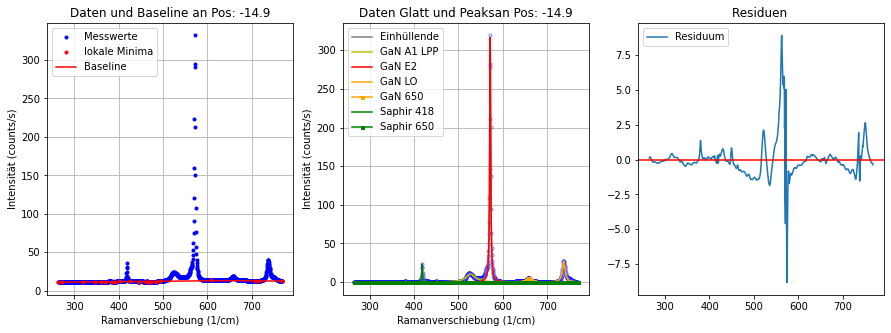

----------------------------------------------------------------------------------------------------
Position: -15.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [12.2354 12.1705 12.1247 ... 10.4047 10.4731 10.5318]
(1024,)
Hintergrund Parameter:  [ 1.12471601e-12 -2.82994843e-09  2.72148729e-06 -1.25318069e-03
  2.83149034e-01 -1.49411467e+01]
Fitparameter Saphir 418: [23.050986713945502, 2.0012954579147677, 418.35641069348236]
Fitparameter GaN A1 LPP 531: [9.520865944444381, 23.839622911165463, 527.4649182882004]
Fitparameter GaN E2 568: [289.2555582910911, 2.694990535156056, 571.4790957259996]
Fitparameter Saphir 650: [0.14203829087333664, 0.43638607895992876, 654.2823635027784]
Fitparameter GaN 650: [4.9186906889480175, 10.54156255959941, 657.363351738158]
Fitparameter GaN LO 741: [24.85435580851719, 7.333030461669303, 736.956472049315]


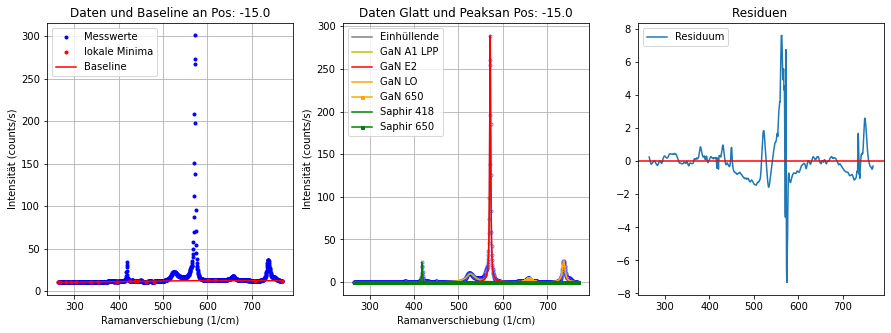

----------------------------------------------------------------------------------------------------
Position: -15.1
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [11.2933  11.3187  11.3722  ...  9.86077  9.88869  9.93538]
(1024,)
Hintergrund Parameter:  [ 1.31724730e-12 -3.51319928e-09  3.58584642e-06 -1.75428958e-03
  4.17492496e-01 -2.87557376e+01]
Fitparameter Saphir 418: [22.88305506954979, 2.026300768563765, 418.3508276767108]
Fitparameter GaN A1 LPP 531: [9.202757039369768, 23.463055483585602, 527.1760157292861]
Fitparameter GaN E2 568: [273.37110498679544, 2.6853074808465944, 571.469952182468]
Fitparameter Saphir 650: [0.21467484610927481, 4.999999999981693, 645.0000000000001]
Fitparameter GaN 650: [4.42348661183099, 10.617972588882123, 657.4958275547602]
Fitparameter GaN LO 741: [22.899506290900035, 7.652055621396986, 736.9937592418074]


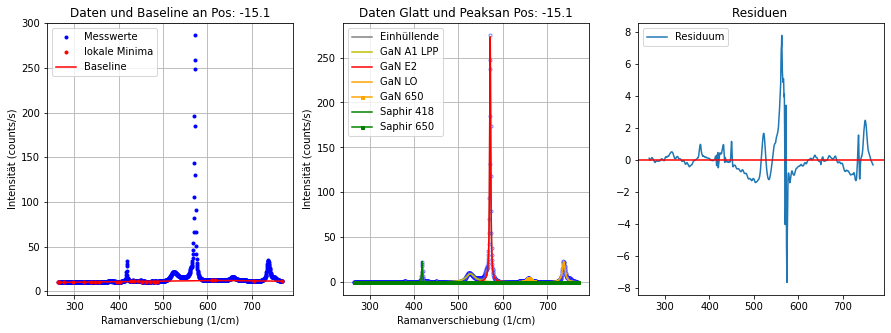

----------------------------------------------------------------------------------------------------
Position: -15.2
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.9784  10.9755  10.973   ...  9.15618  9.11339  9.08376]
(1024,)
Hintergrund Parameter:  [ 2.58982467e-12 -6.78961802e-09  6.87447692e-06 -3.36248654e-03
  8.01065928e-01 -6.49208535e+01]
Fitparameter Saphir 418: [22.974426003907695, 2.061941412480989, 418.3651805787184]
Fitparameter GaN A1 LPP 531: [8.499346829360707, 23.198950045011195, 527.4639793129727]
Fitparameter GaN E2 568: [258.31814951998706, 2.6673135713599327, 571.4696190681361]
Fitparameter Saphir 650: [426.7884851049084, 0.008693984947755147, 646.5383137910828]
Fitparameter GaN 650: [4.28026282845505, 10.000000000000185, 657.3223564114646]
Fitparameter GaN LO 741: [21.325974172500505, 7.791698173942185, 737.0190672177849]


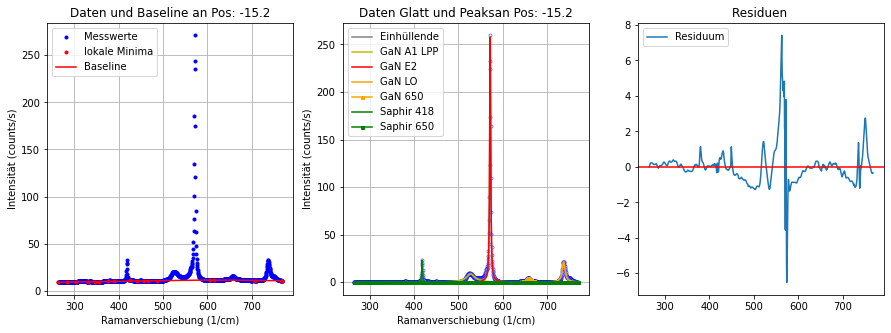

----------------------------------------------------------------------------------------------------
Position: -15.3
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [10.4235  10.4591  10.5007  ...  9.10165  9.12249  9.10126]
(1024,)
Hintergrund Parameter:  [ 2.56180877e-12 -6.65876249e-09  6.67462601e-06 -3.22120063e-03
  7.52511323e-01 -5.90147152e+01]
Fitparameter Saphir 418: [23.113854361270043, 2.0277113987022997, 418.3820952479172]
Fitparameter GaN A1 LPP 531: [8.294620419948092, 24.75739837305566, 527.4344894814695]
Fitparameter GaN E2 568: [241.94692991089357, 2.667310990841732, 571.4539020133552]
Fitparameter Saphir 650: [210.3099053576253, 0.014183638336620157, 645.1044666873971]
Fitparameter GaN 650: [3.7666308644093047, 11.109259348845576, 657.4699747114466]
Fitparameter GaN LO 741: [19.796772609329977, 7.929943310270555, 737.0113016509606]


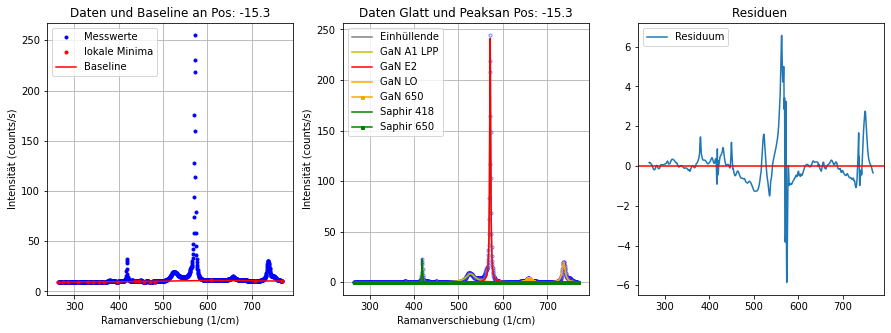

----------------------------------------------------------------------------------------------------
Position: -15.4
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [9.81598 9.79465 9.78179 ... 8.66941 8.71344 8.70051]
(1024,)
Hintergrund Parameter:  [-1.00078297e-12  1.89590751e-09 -1.20321692e-06  2.52770338e-04
  1.86801193e-02 -1.75121112e-06]
Fitparameter Saphir 418: [24.1452021494097, 1.9179261395894676, 418.3471990177097]
Fitparameter GaN A1 LPP 531: [8.01154581197922, 25.593459960154078, 527.4362603810453]
Fitparameter GaN E2 568: [221.29348823407972, 2.7038942747591506, 571.4411259430466]
Fitparameter Saphir 650: [1.3605947801683158, 4.3239404197109605, 654.9999999969409]
Fitparameter GaN 650: [1.6882727215411772, 10.000000000000002, 658.0865151701729]
Fitparameter GaN LO 741: [17.931166321590297, 6.389821155966774, 736.9056666812775]


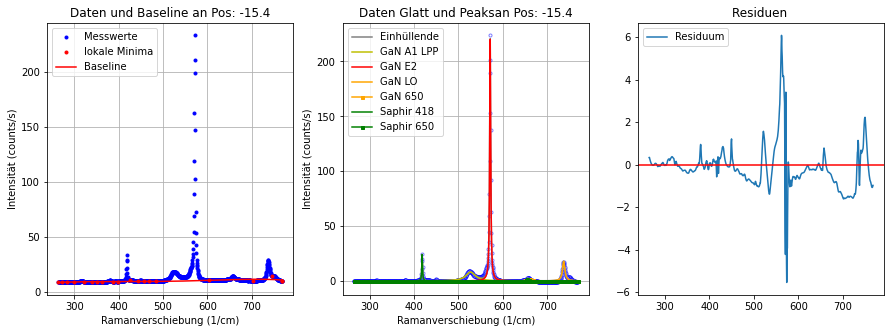

----------------------------------------------------------------------------------------------------
Position: -15.5
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [9.06279 9.15427 9.23262 ... 8.19216 8.1413  8.06588]
(1024,)
Hintergrund Parameter:  [-4.69014131e-13 -5.66418949e-10  2.56155788e-06 -2.30002391e-03
  8.05081009e-01 -8.95901020e+01]
Fitparameter Saphir 418: [24.084447596808424, 1.9343376392023348, 418.35742956507585]
Fitparameter GaN A1 LPP 531: [8.660355292137698, 29.999999999999996, 528.2924858993398]
Fitparameter GaN E2 568: [210.15963281291445, 2.73041670595353, 571.4466344749452]
Fitparameter Saphir 650: [0.4209140622270527, 4.99999999999707, 645.0000000000001]
Fitparameter GaN 650: [2.7452947688563527, 10.000000000000002, 657.135662548681]
Fitparameter GaN LO 741: [16.53824439165949, 6.352226001960222, 737.0242932268181]


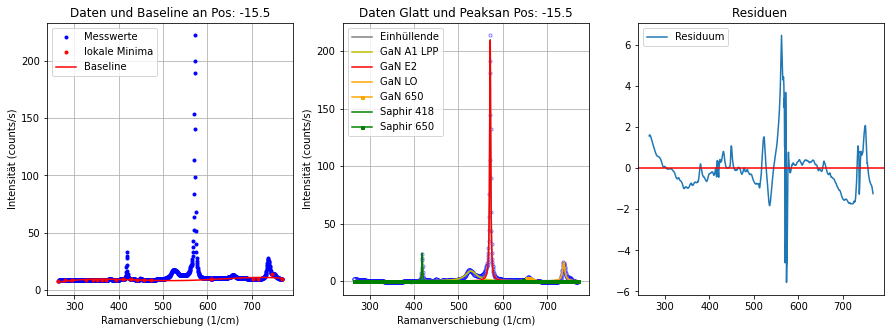

----------------------------------------------------------------------------------------------------
Position: -15.6
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [9.12184 9.13842 9.15301 ... 7.78521 7.85447 7.95264]
(1024,)
Hintergrund Parameter:  [ 1.65479977e-12 -4.27543287e-09  4.25720699e-06 -2.04110561e-03
  4.75197035e-01 -3.51754089e+01]
Fitparameter Saphir 418: [23.934331717426414, 2.0089098538377836, 418.3663760839087]
Fitparameter GaN A1 LPP 531: [7.018612721539375, 23.550470884734263, 527.1167692672042]
Fitparameter GaN E2 568: [197.75392705731062, 2.679363511409038, 571.4348713248492]
Fitparameter Saphir 650: [0.31566506873994077, 4.999999960548958, 645.0000003729374]
Fitparameter GaN 650: [3.0804451608162178, 10.00000000002659, 657.5527011818803]
Fitparameter GaN LO 741: [15.766656347462463, 8.092411113259713, 736.9689396858873]


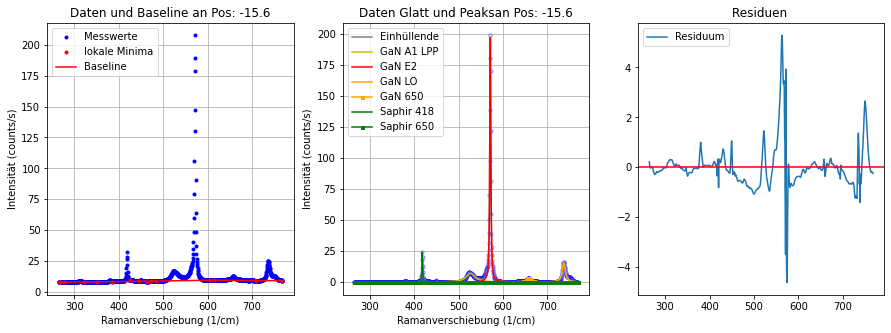

----------------------------------------------------------------------------------------------------
Position: -15.7
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [8.59801 8.59288 8.58007 ... 7.42157 7.42223 7.42534]
(1024,)
Hintergrund Parameter:  [ 2.39226154e-12 -6.23063190e-09  6.25545283e-06 -3.02184503e-03
  7.05861767e-01 -5.63749965e+01]
Fitparameter Saphir 418: [23.95899931468835, 2.0458851565501757, 418.37380205363394]
Fitparameter GaN A1 LPP 531: [6.835980467005618, 22.697058406175287, 526.9932046738824]
Fitparameter GaN E2 568: [184.74009915586305, 2.69179620077343, 571.4259310393036]
Fitparameter Saphir 650: [0.15280685518883763, 0.005114879888902482, 649.7164872269067]
Fitparameter GaN 650: [2.7910727541311924, 10.541533505979574, 657.6332868611973]
Fitparameter GaN LO 741: [15.013799190187635, 8.301626922220946, 737.0037118492065]


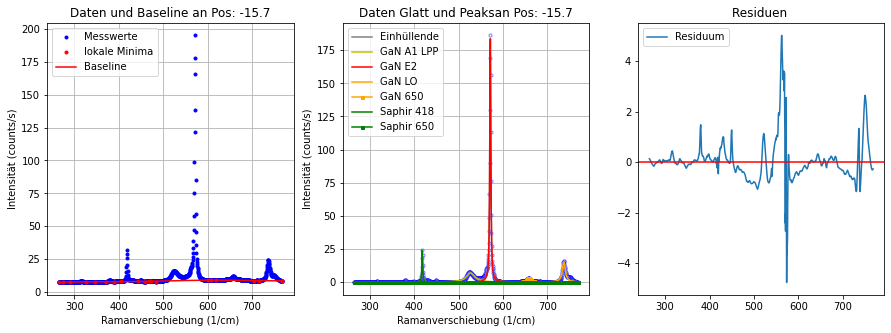

----------------------------------------------------------------------------------------------------
Position: -15.8
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [8.16212 8.05015 8.02907 ... 7.03791 6.97325 6.92372]
(1024,)
Hintergrund Parameter:  [-5.25001714e-13  9.96483097e-10 -6.16994107e-07  1.06326642e-04
  2.50004408e-02 -1.83884307e-06]
Fitparameter Saphir 418: [24.556875304891296, 1.8924516624878225, 418.3654196376794]
Fitparameter GaN A1 LPP 531: [6.446814042422396, 25.85641738749124, 527.6621221487421]
Fitparameter GaN E2 568: [171.26648540071042, 2.7102777851738438, 571.4225573675518]
Fitparameter Saphir 650: [26.430945495756664, 0.056521956720239665, 646.1191853825898]
Fitparameter GaN 650: [2.1343693372827897, 10.000000000000002, 657.1598406683348]
Fitparameter GaN LO 741: [13.453730244396121, 7.055090748708183, 737.0414678183923]


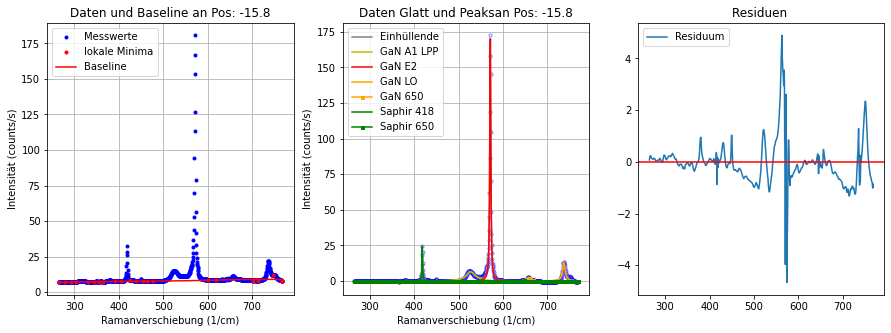

----------------------------------------------------------------------------------------------------
Position: -15.9
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [7.82882 7.76048 7.74614 ... 6.49999 6.44161 6.38841]
(1024,)
Hintergrund Parameter:  [-5.79932859e-13  1.12138358e-09 -7.25617027e-07  1.50729100e-04
  1.69127898e-02 -7.05898786e-06]
Fitparameter Saphir 418: [24.219047036424172, 1.9310522407223947, 418.37867513795624]
Fitparameter GaN A1 LPP 531: [6.092298080995055, 24.745359843111906, 527.3260208961976]
Fitparameter GaN E2 568: [160.06899998129714, 2.6979134426593547, 571.404901508607]
Fitparameter Saphir 650: [1.039132517481101, 4.875166918090351, 654.9999999992586]
Fitparameter GaN 650: [1.182903646584943, 10.000000000000002, 658.0581033093481]
Fitparameter GaN LO 741: [12.490458759778546, 6.857626844449407, 737.0714967386596]


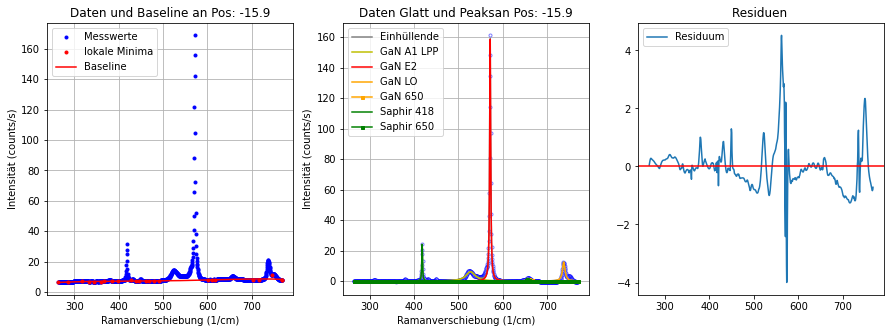

----------------------------------------------------------------------------------------------------
Position: -16.0
x-Daten: [768.19910436 767.72565436 767.25409436 ... 265.45472436 264.94187436
 264.43110436]
(1024,)
y-Daten: [7.34379 7.71955 7.78944 ... 6.72715 6.75112 6.7958 ]
(1024,)
Hintergrund Parameter:  [-7.73243234e-13  1.49269816e-09 -9.67799334e-07  2.11937891e-04
  1.19717568e-02 -7.57820435e-05]
Fitparameter Saphir 418: [24.72326485682432, 1.9174434625557213, 418.3711331016267]
Fitparameter GaN A1 LPP 531: [5.839797087881008, 26.574340037754716, 527.514360939857]
Fitparameter GaN E2 568: [152.58483510514282, 2.671233048572507, 571.4167689777023]
Fitparameter Saphir 650: [0.9911714382331136, 4.666407462379971, 654.9999999999999]
Fitparameter GaN 650: [0.739119057917141, 10.000000000000002, 658.2003205674322]
Fitparameter GaN LO 741: [11.556575802354208, 6.196404472107366, 736.9685228156808]
BILD an Pos:  -16.0


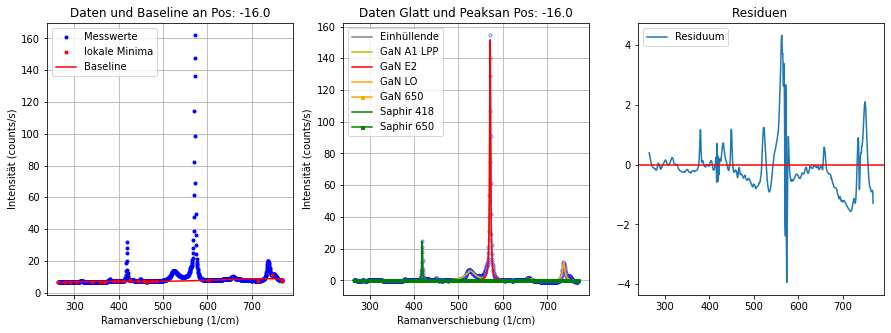

----------------------------------------------------------------------------------------------------


In [61]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
GaN_A1_Peaks_Liste=[]
GaN_E2_Peaks_Liste=[]
GaN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Saphir_650_Peaks_Liste=[]
GaN_650_Peaks_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_GaN_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_GaN_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_GaN_array_float[0],[0])
        y=np.delete(data_GaN_array_float[i],[0])
        print("x-Daten:", x)
        print(x.shape)
        print("y-Daten:", y)
        print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=10)[0]]
        xzw=x[argrelextrema(y, np.less,order=10)[0]]
        #print(yzw)
        #print(xzw)
        
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin2=[]
        ymin2=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for k in range(len(xzw)):
            if xzw[k]<=620 or xzw[k]>=700:
                xmin2.append(xzw[k])
                ymin2.append(yzw[k])
        for j in range(len(xmin2)):
            if xmin2[j]<=500 or xmin2[j]>=600:
                xmin.append(xmin2[j])
                ymin.append(ymin2[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1])        
        #print("xmin:", xmin)
        #print("ymin:",ymin)
        
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.8, -66]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf,0,-np.inf],[np.inf,np.inf,np.inf,np.inf,1,0])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        #fitten 4 lorentz in Saphir 418, GaN A1 LPP 531, GaN_ E2 568, GaN LO 741
        #L_x4(x,A1,D1,W1, A2,D2,W2, A3,D3,W3)
        #init_vals_L_x4 = [1,1,426, 9,17,531, 115,3,578, 5,5,741]
        #param_bounds_L_x4= ([0,0,415, 0,0,520, 0,0,562, 0,0,730],[np.inf,20,430, 2000,30,540, 2000,30,585, 2000,30,750])
        #fitParams_L_x4, cov_L_x4 = curve_fit(f=L_x4, xdata=x, ydata=y_glatt, p0=init_vals_L_x4, bounds=param_bounds_L_x4)
        #fitParams_L_Saphir_418=[fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2]]
        #fitParams_L_GaN_A1=[fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5]]
        #fitParams_L_GaN_E2=[fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8]]
        #fitParams_L_GaN_LO=[fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]]
        #print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        #print("Fitparameter GaN A1 LPP 534:",fitParams_L_GaN_A1)
        #print("Fitparameter GaN E2 571:",fitParams_L_GaN_E2)
        #print("Fitparameter GaN LO 744:",fitParams_L_GaN_LO)
        
        
        
        #fitten 6 lorentz in Saphir 418, GaN A1 LPP 531, GaN_ E2 568, Saphir schmal 650, GaN 650 breit ,GaN LO 741
        #L_x7(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6):
        # 7 Lorentzpeaks
        #return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + Lorentz(x,A6,D6,W6)
        init_vals_L_x6 = [1,1,426, 9,17,531, 115,3,568, 10,0.1,650, 1,20,650, 5,5,741]
        param_bounds_L_x6= ([0,0,415, 0,0,520, 0,0,562, 0,0,645, 0,10,640, 0,0,730],
                            [np.inf,20,430, 2000,30,540, 2000,30,575, 2000,5,655, 2000,50,670, 2000,30,750])
        fitParams_L_x6, cov_L_x6 = curve_fit(f=L_x6, xdata=x, ydata=y_glatt, p0=init_vals_L_x6, bounds=param_bounds_L_x6)
        fitParams_L_Saphir_418=[fitParams_L_x6[0],fitParams_L_x6[1],fitParams_L_x6[2]]
        fitParams_L_GaN_A1=[fitParams_L_x6[3],fitParams_L_x6[4],fitParams_L_x6[5]]
        fitParams_L_GaN_E2=[fitParams_L_x6[6],fitParams_L_x6[7],fitParams_L_x6[8]]
        fitParams_L_Saphir_650=[fitParams_L_x6[9],fitParams_L_x6[10],fitParams_L_x6[11]]
        fitParams_L_GaN_650=[fitParams_L_x6[12],fitParams_L_x6[13],fitParams_L_x6[14]]
        fitParams_L_GaN_LO=[fitParams_L_x6[15],fitParams_L_x6[16],fitParams_L_x6[17]]
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter GaN A1 LPP 531:",fitParams_L_GaN_A1)
        print("Fitparameter GaN E2 568:",fitParams_L_GaN_E2)
        print("Fitparameter Saphir 650:",fitParams_L_Saphir_650)
        print("Fitparameter GaN 650:",fitParams_L_GaN_650)
        print("Fitparameter GaN LO 741:",fitParams_L_GaN_LO)
        
        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot für Daten glatt und peaks        
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x6(x, fitParams_L_x6[0],fitParams_L_x6[1],fitParams_L_x6[2],fitParams_L_x6[3],fitParams_L_x6[4],fitParams_L_x6[5],fitParams_L_x6[6],fitParams_L_x6[7],fitParams_L_x6[8],fitParams_L_x6[9],fitParams_L_x6[10],fitParams_L_x6[11],fitParams_L_x6[12],fitParams_L_x6[13],fitParams_L_x6[14],fitParams_L_x6[15],fitParams_L_x6[16],fitParams_L_x6[17]), color='gray'  ,markersize=2, label='Einhüllende')
        #plt.plot(x,L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2],fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8],fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), color='gray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_A1[0],fitParams_L_GaN_A1[1],fitParams_L_GaN_A1[2]), color='y'  ,markersize=3, label='GaN A1 LPP')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_E2[0],fitParams_L_GaN_E2[1],fitParams_L_GaN_E2[2]), color='r'  ,markersize=3, label='GaN E2')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_LO[0],fitParams_L_GaN_LO[1],fitParams_L_GaN_LO[2]), color='orange'  ,markersize=3, label='GaN LO')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_650[0],fitParams_L_GaN_650[1],fitParams_L_GaN_650[2]),'-s', color='orange'  ,markersize=3, label='GaN 650')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]), color='g'  ,markersize=3, label='Saphir 418')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_650[0],fitParams_L_Saphir_650[1],fitParams_L_Saphir_650[2]),'-s', color='g'  ,markersize=3, label='Saphir 650')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]), '--', color='g'  ,markersize=3, label='Saphir 578')
        
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        plt.plot(x,y_glatt-L_x6(x, fitParams_L_x6[0],fitParams_L_x6[1],fitParams_L_x6[2],fitParams_L_x6[3],fitParams_L_x6[4],fitParams_L_x6[5],fitParams_L_x6[6],fitParams_L_x6[7],fitParams_L_x6[8],fitParams_L_x6[9],fitParams_L_x6[10],fitParams_L_x6[11],fitParams_L_x6[12],fitParams_L_x6[13],fitParams_L_x6[14],fitParams_L_x6[15],fitParams_L_x6[16],fitParams_L_x6[17]), label=("Residuum"))
        #plt.plot(x,y_glatt-L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2],fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8],fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), label=("a-plane Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
        
        if i == data_GaN_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/GaN Auswertung D1 532nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/GaN Auswertung D1 532nm Position '+ str(position) + '.png')
        if i == data_GaN_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_532nm/GaN Auswertung D1 532nm Position '+ str(position) + '.png')
        
        plt.show()
     
        #speichern der Peakdaten
        GaN_A1_Peaks_Liste.append([position, fitParams_L_GaN_A1])
        GaN_E2_Peaks_Liste.append([position, fitParams_L_GaN_E2])
        GaN_LO_Peaks_Liste.append([position, fitParams_L_GaN_LO])
        Saphir_418_Peaks_Liste.append([position, fitParams_L_Saphir_418])
        Saphir_650_Peaks_Liste.append([position, fitParams_L_Saphir_650])
        GaN_650_Peaks_Liste.append([position, fitParams_L_GaN_650])
        Baseline_Liste.append([position,fitParams_base])
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

In [62]:
# Verhalten Asymmetrischer Gauß und Baseline

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
 #   Base_Para_3.append(Baseline_Liste[k][1][2])
 #   Base_Para_4.append(Baseline_Liste[k][1][3])
 #   Base_Para_5.append(Baseline_Liste[k][1][4])
 #   Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [ 9.38259331e+02  1.76243122e+00 -1.33325265e+01  9.04543110e-01
  7.87247971e+01]
Asym Gauß LO Parameter Amp-R: [ 77.03102431   1.30149773 -12.19415408  -1.41317387   8.8020596 ]
Asym Gauß A1 Parameter Amp-R: [ 82.59992749   1.25148301 -12.26822575   0.7348231    9.17337652]
Gauß E2 Parameter Amp-R: [1452.01635544   -4.29433922  -12.42690216 -244.65742021]
Gauß LO Parameter Amp-R: [121.00994896   2.2950474  -12.95884024  -4.17069892]
Gauß A1 Parameter Amp-R: [114.02811178  -2.78046344 -11.69745752  -7.3371103 ]


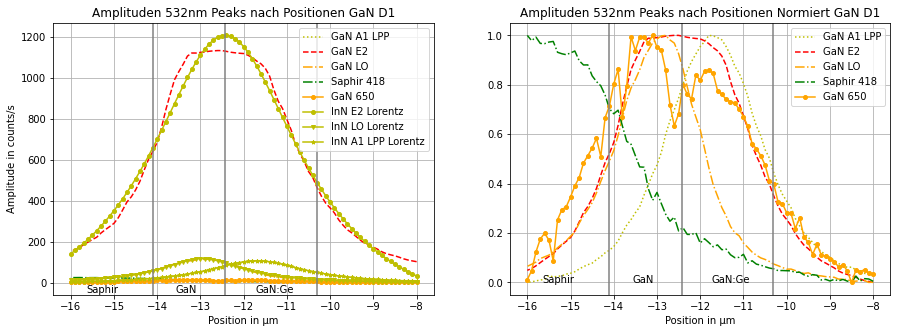

In [63]:
# Amplituden nach Positionen GaN

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
GaN_A1_Amp=[]
GaN_E2_Amp=[]
GaN_LO_Amp=[]
Peak_Saphir_418_Amp=[]
Peak_Saphir_650_Amp=[]
GaN_650_Amp=[]
for i in range(len(GaN_A1_Peaks_Liste)):
    Positionen.append(GaN_A1_Peaks_Liste[i][0])
    GaN_A1_Amp.append(GaN_A1_Peaks_Liste[i][1][0])
    GaN_E2_Amp.append(GaN_E2_Peaks_Liste[i][1][0])
    GaN_LO_Amp.append(GaN_LO_Peaks_Liste[i][1][0])
    Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])
    Peak_Saphir_650_Amp.append(Saphir_650_Peaks_Liste[i][1][0])
    GaN_650_Amp.append(GaN_650_Peaks_Liste[i][1][0])
    
    
#Fitten Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,-12,0,180]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,250])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata=  GaN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,-11.5,0,40]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,100])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= GaN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 

init_vals_AG_A1 = [1,1,-12.5,0,40]
param_bounds_AG_A1= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,100])
fitParams_AG_A1, cov_AG_A1 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= GaN_A1_Amp, p0=init_vals_AG_A1, bounds=param_bounds_AG_A1)
print("Asym Gauß A1 Parameter Amp-R:",fitParams_AG_A1) 


    
#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,-12,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= GaN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,-12,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= GaN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 
    
init_vals_G_A1 = [1,1,-12,5]
param_bounds_G_A1= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_A1, cov_G_A1 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= GaN_A1_Amp, p0=init_vals_G_A1, bounds=param_bounds_G_A1)
print("Gauß A1 Parameter Amp-R:",fitParams_G_A1) 
    
  

#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden 532nm Peaks nach Positionen GaN D1')
plt.plot(Positionen, GaN_A1_Amp, ':', color='y'  ,markersize=3, label='GaN A1 LPP') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_E2_Amp, '--', color='r'  ,markersize=3, label='GaN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_LO_Amp, '-.', color='orange'  ,markersize=3, label='GaN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_Amp,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_650_Amp,'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_650_Amp, '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

#plt.plot(Positionen, Peak_Saphir_578_Amp,'--', color='g'  ,markersize=2, label='Saphir 571') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='GaN E2 Fitt Asym')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='GaN LO Fitt Asym')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_A1[0],fitParams_AG_A1[1],fitParams_AG_A1[2],fitParams_AG_A1[3],fitParams_AG_A1[4]),'-.', color='r'  ,markersize=2, label='GaN A1 Fitt Asym')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_A1[0],fitParams_G_A1[1],fitParams_G_A1[2],fitParams_G_A1[3]),'-*', color='y'  ,markersize=4, label='InN A1 LPP Lorentz')
         
plt.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=-50,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=-50,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-50,s='Saphir')
  
plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden 532nm Peaks nach Positionen Normiert GaN D1')
plt.plot(Positionen, NormalizeData(GaN_A1_Amp), ':', color='y'  ,markersize=3, label='GaN A1 LPP') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_E2_Amp), '--', color='r'  ,markersize=3, label='GaN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_LO_Amp), '-.', color='orange'  ,markersize=3, label='GaN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_578_Amp),'--', color='g'  ,markersize=2, label='Saphir 571') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen,  NormalizeData(Peak_Saphir_650_Amp),'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen,  NormalizeData(GaN_650_Amp), '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=0,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=0,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=0,s='Saphir')
  
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_532nm/GaN Amplituden Peaks nach Positionen D1 532nm')
plt.show()



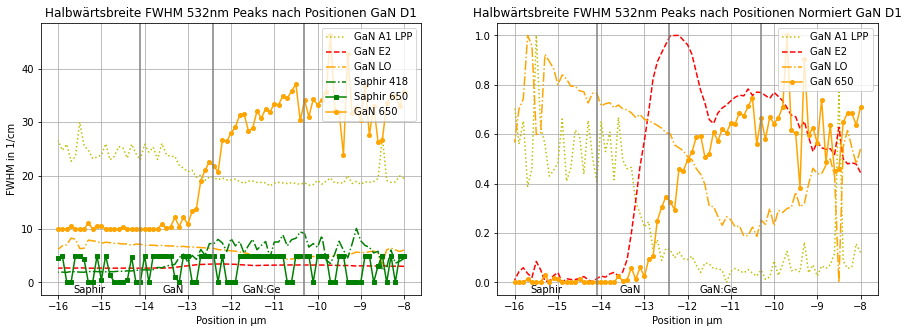

In [64]:
# Halbwärtsbreiten fwhm nach Positionen
 
#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
GaN_A1_fwhm=[]
GaN_E2_fwhm=[]
GaN_LO_fwhm=[]
Peak_Saphir_418_fwhm=[]
Peak_Saphir_650_fwhm=[]
GaN_650_fwhm=[]

#Peak_Saphir_578_fwhm=[] 
for i in range(len(GaN_A1_Peaks_Liste)):
    Positionen.append(GaN_A1_Peaks_Liste[i][0])
    GaN_A1_fwhm.append(GaN_A1_Peaks_Liste[i][1][1])
    GaN_E2_fwhm.append(GaN_E2_Peaks_Liste[i][1][1])
    GaN_LO_fwhm.append(GaN_LO_Peaks_Liste[i][1][1])
    Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
    #Peak_Saphir_578_fwhm.append(Saphir_578_Peaks_Liste[i][1][1])
    Peak_Saphir_650_fwhm.append(Saphir_650_Peaks_Liste[i][1][1])
    GaN_650_fwhm.append(GaN_650_Peaks_Liste[i][1][1])

    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Halbwärtsbreite FWHM 532nm Peaks nach Positionen GaN D1')
plt.plot(Positionen, GaN_A1_fwhm, ':', color='y'  ,markersize=3, label='GaN A1 LPP') # 534 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_E2_fwhm, '--', color='r'  ,markersize=3, label='GaN E2') # 571 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_LO_fwhm, '-.', color='orange'  ,markersize=3, label='GaN LO') #744 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_578_fwhm,'--', color='g'  ,markersize=2, label='Saphir 578') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_650_fwhm,'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_650_fwhm, '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5
    
plt.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=-2,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=-2,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-2,s='Saphir')
  
plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Halbwärtsbreite FWHM 532nm Peaks nach Positionen Normiert GaN D1')
plt.plot(Positionen, NormalizeData(GaN_A1_fwhm), ':', color='y'  ,markersize=3, label='GaN A1 LPP') # 534 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_E2_fwhm), '--', color='r'  ,markersize=3, label='GaN E2') #571 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_LO_fwhm), '-.', color='orange'  ,markersize=3, label='GaN LO') # 744 cmE-1, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp), color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_578_fwhm),'--', color='g'  ,markersize=2, label='Saphir 578') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen,  NormalizeData(Peak_Saphir_650_fwhm),'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen,  NormalizeData(GaN_650_fwhm), '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=-0.04,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=-0.04,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-0.04,s='Saphir')
  
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_532nm/GaN Halbwärtsbreite fwhm Peaks nach Positionen D1 532nm')
plt.show()

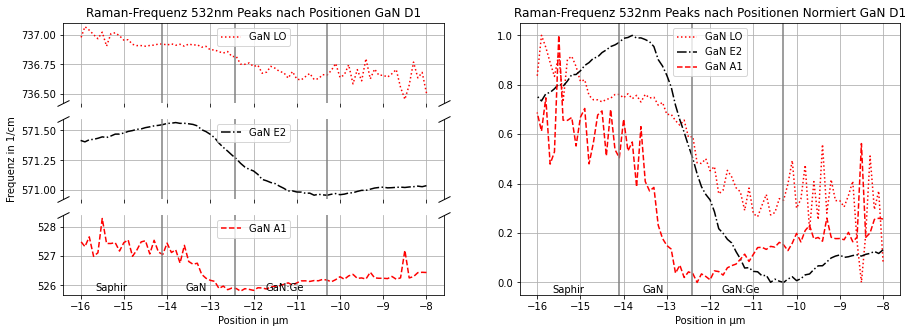

In [65]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
 
Positionen=[]
GaN_A1_w=[]
GaN_E2_w=[]
GaN_LO_w=[]
Peak_Saphir_418_w=[]
Peak_Saphir_650_w=[]
GaN_650_w=[]


#Peak_Saphir_578_w=[] 
for i in range(len(GaN_A1_Peaks_Liste)):
    Positionen.append(GaN_A1_Peaks_Liste[i][0])
    GaN_A1_w.append(GaN_A1_Peaks_Liste[i][1][2])
    GaN_E2_w.append(GaN_E2_Peaks_Liste[i][1][2])
    GaN_LO_w.append(GaN_LO_Peaks_Liste[i][1][2])
    Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
    #Peak_Saphir_578_w.append(Saphir_578_Peaks_Liste[i][1][2])
    Peak_Saphir_650_w.append(Saphir_650_Peaks_Liste[i][1][2])
    GaN_650_w.append(GaN_650_Peaks_Liste[i][1][2])

    
   
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, GaN_LO_w, ':', color='r'  ,markersize=2, label='GaN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, GaN_650_w, '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, GaN_E2_w,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, GaN_A1_w, '--', color='r'  ,markersize=2, label='GaN A1') #, markerfacecolor='w', alpha=0.5

ax1.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=min(GaN_A1_w),s='GaN:Ge')
ax3.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=min(GaN_A1_w),s='GaN')
ax3.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=min(GaN_A1_w),s='Saphir')
  
# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz in 1/cm')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 532nm Peaks nach Positionen GaN D1")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(GaN_LO_w), ':' , color='r'  ,markersize=2, label='GaN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_E2_w), '-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_A1_w), '--', color='r'  ,markersize=2, label='GaN A1') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_650_w),'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(GaN_650_w), '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Frequenz in 1/cm')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz 532nm Peaks nach Positionen Normiert GaN D1")

ax4.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=-0.04,s='GaN:Ge')
ax4.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=-0.04,s='GaN')
ax4.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-0.04,s='Saphir')


plt.savefig('Bilder_Graphen_532nm/GaN Raman-Frequenz Peaks nach Positionen D1 532nm')
plt.show()

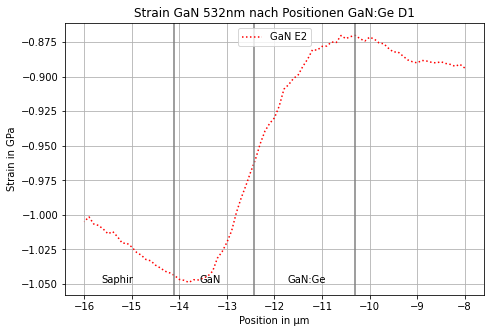

In [66]:
#Aus I. R. Ahmad, N. Faleev_2004_Dependence of the stress-temperature coefficient on dislocation density in epitaxial GaN grown on alpha-Al2O3 and 6H-SiC substrates
w_0_GaN_E2 = 568 # +/- 0.4 1/cm

w_per_P_GaN_E2 = -3.4 # +/- 0.3 1/cm/GPa für E2 high 

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle I. R. Ahmad, N. Faleev_2004_Dependence of the stress-temperature coefficient on dislocation density in epitaxial GaN grown on alpha-Al2O3 and 6H-SiC substrates
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_GaN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(GaN_E2_w)):
    Strain_GaN_E2_Liste.append(Druck_in_Probe(GaN_E2_w[i], w_0_GaN_E2, w_per_P_GaN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain GaN 532nm nach Positionen GaN:Ge D1')

plt.plot(Positionen, Strain_GaN_E2_Liste, ':', color='r'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_A1[2]-(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]-(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_A1[1]/4),y=min(Strain_GaN_E2_Liste),s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]-(fitParams_G_LO[1]/2),y=min(Strain_GaN_E2_Liste),s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=min(Strain_GaN_E2_Liste),s='Saphir')
  
plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_532nm/GaN Strain nach Positionen D1 532nm')
plt.show()